# Neural SINDy, v8

In [ ]:
!pip install torchdiffeq # Neural ODE library

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
import math
import scipy

from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [10, 10]
plt.rc('font', size=20)

import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision import datasets, transforms

import copy
# from scipy.integrate import solve_ivp # ODE solver in Python

import os
import argparse
import time
from tqdm import tqdm # Loading bar

import torchdiffeq # Neural ODE

import networkx as nx

Compute number of parameters needed for SINDy vs SINDy-NN:

In [ ]:
# def choose(n, k):
#   return np.math.factorial(n) / (np.math.factorial(k)*np.math.factorial(n-k))

# p_max = 5
# n_max = 15
# for p in np.arange(p_max)+2:
#   sum = np.zeros(n_max)+1
#   params = np.zeros(n_max)
#   for n in np.arange(n_max)+1:
#     for k in np.arange(p)+1:
#       sum[n-1] += choose(n+k-1,k)

#     params[n-1] = n*(n+1)*p

#   print("p =",p)
#   plt.figure()
#   plt.plot(np.arange(n_max)+1,sum,'b')
#   plt.plot(np.arange(n_max)+1,params, 'r')
#   plt.grid()

## Neural ODE Functionality

In [ ]:
parser = argparse.ArgumentParser('SINDy NN')
parser.add_argument('--method', type=str, choices=['dopri5', 'adams'], default='dopri5') # ODE solver (Default: dopri)
parser.add_argument('--data_size', type=int, default=1500) # Data size (Default: 1000)
parser.add_argument('--batch_time', type=int, default=3) # Number of time steps at which to compute loss (Default: 10)
parser.add_argument('--batch_size', type=int, default=20) # Batch size (of training data)
parser.add_argument('--niters', type=int, default=200) # Number of training iterations per epoch (Default: 1000)
parser.add_argument('--test_freq', type=int, default=20) # Frequency with which to test validation loss (in terms of iterations)
parser.add_argument('--viz', action='store_true')
# parser.add_argument('--gpu', type=int, default=0) # (Default: 0)
parser.add_argument('--device', type=int) # CPU or GPU
parser.add_argument('--adjoint', action='store_true')
parser.add_argument('--dt', default=0.01)
parser.add_argument('--training_mode', default=0) # 0 for one-step lookahead, 1 for Neural ODE
parser.add_argument('--batch_mode', default=0) # 0 for random batch, 1 for batch = full trajectory
# args = parser.parse_args()
args = parser.parse_args(args=[])
args.adjoint = True # (Default: False)
num_iters = args.niters

In [ ]:
# Print whether we're using GPU or CPU and adjoint sensitivity method
if args.adjoint:
    from torchdiffeq import odeint_adjoint as odeint
    print('Using adjoint method')
else:
    from torchdiffeq import odeint
    print('NOT using adjoint method')

args.device = torch.device('cuda:' + str(args.gpu) if torch.cuda.is_available() else 'cpu')
args.device

Using adjoint method


device(type='cpu')

In [ ]:
def f_get_batch(model,y_true,itr,args):
  """Get a batch of training data"""

  # Indices of batch:
  if args.batch_mode == 0: # Draw batch randomly
    s = torch.from_numpy(np.random.choice(np.arange(args.data_size - args.batch_time, dtype=np.int64), args.batch_size, replace=False))
  else: # Sequentially sample portion of entire simulated trajectory
    s = torch.tensor(itr*args.batch_size + np.arange(args.batch_size))

  batch_y0 = y_true[s].to(args.device) # Batch of inputs
  if args.training_mode == 0: # If using one-step look ahead
    batch_t = [] # Don't need batch_t
    batch_y = y_true[s+1].to(args.device) # Ground-truth of output
  else: # If using Neural ODE
    batch_t = t[:args.batch_time].to(args.device) # Array of time steps, starting from zero
    batch_y = torch.stack([y_true[s + i] for i in range(args.batch_time)], dim=0).to(args.device) # Ground-truth of outputs

  # batch_y0, model.std_dev = f_batchnorm(batch_y0,eps=1e-05,layer=0)
  # batch_y = f_batchnorm2(batch_y,model.std_dev,eps=1e-05)

  # f_update_weights(self,eps=1e-05)
  # self.prev_std_dev = self.std_dev
  # inputs, self.std_dev = f_batchnorm(inputs,eps=1e-05,layer=0)

  return batch_y0, batch_t, batch_y

In [ ]:
# def f_batchnorm(sample,eps=1e-05):
#     # mu = torch.mean(sample,axis=0)
#     mu = 0
#     var = torch.var(sample,axis=0)
#     return (sample-mu)/torch.sqrt(var+eps), var

# s = torch.tensor(1*args.batch_size + np.arange(args.batch_size))
# sample = y_true[s]
# sample.size()

# sample
# f_batchnorm(sample)
# sample[:,:,1:3]

## Neural Network Functionality

### Custom Layer Types

In [ ]:
class MultiplicativeLayer(nn.Module):
  """Neural network layer that takes two input scalars and multiplies them"""

  def __init__(self):
    super(MultiplicativeLayer, self).__init__()

  def forward(self, inputs):
    # Array to hold output for each element of the batch:
    output = torch.ones(inputs.size()[:-1]).unsqueeze(2)
    for j in np.arange(inputs.size()[0]): # For each batch
      batch_i = 0 # Batch number
      for k in inputs[j]: # For each sample in the batch
      # Output for this batch is the product of all features:
        output[j,batch_i,0] = torch.prod(k)
        batch_i += 1
    return output

In [ ]:
class HadamardLayer(nn.Module):
  """ Element-wise multiply every input to the layer with a set of learnable parameters """
  def __init__(self, size_in, size_out, use_bias=False):
    super().__init__()

    self.use_bias = use_bias
    if self.use_bias == True:
      # self.bias = nn.Parameter(torch.Tensor((1,1)))
      # self.bias.data = nn.parameter.Parameter(torch.tensor([[0.]]))
      size_in += 1
      # size_out += 1

    self.register_buffer('mask', torch.ones((size_out, size_in), dtype=torch.bool))

    self.size_in, self.size_out = size_in, size_out
    weight = torch.Tensor(size_out, size_in)
    self.weight = nn.Parameter(weight)  # nn.Parameter is a Tensor that's a module parameter.
    # init_array = torch.ones((size_out, size_in))
    # self.weight.data = nn.parameter.Parameter(init_array)
    torch.nn.init.kaiming_uniform_(self.weight, a=1, mode='fan_in', nonlinearity='leaky_relu')
    # nn.init.normal_(self.weight, mean=1, std=1)

  def forward(self, x):

    if self.use_bias == True:
      x = torch.cat((x,torch.ones((x.size()[0],x.size()[1],1))),dim=2)

    hx = x * self.weight * self.mask
    return hx

  # Compute mask
  def compute_mask(self,idx):
    "Set mask[idx] to False"
    self.mask[idx] = False # Set mask term to zero
    with torch.no_grad(): # (zeroing out weight isn't differentiable)
      self.weight[idx] = 0 # Set weight term to zero

Reference for building masked layers: https://julianstier.com/posts/2021/06/pruning-neural-networks-with-pytorch/

In [ ]:
# Masked Linear Layer
class MaskedLinearLayer(torch.nn.Linear):
    """
    Class of linear layers, with option to mask out weights
    Adapted from: https://julianstier.com/posts/2021/06/pruning-neural-networks-with-pytorch/
    """

    def __init__(self, size_in: int, size_out: int, use_bias=False, keep_layer_input=False):
        """
        :param size_in: Number of input features
        :param size_out: Output features in analogy to torch.nn.Linear
        :param use_bias: Iff each neuron in the layer should have a bias unit as well.
        """
        super().__init__(size_in, size_out, use_bias)

        # self.use_bias = use_bias
        # if self.use_bias == True:
        #   size_in += 1

        self.register_buffer('mask', torch.ones((size_out, size_in), dtype=torch.bool))
        self.keep_layer_input = keep_layer_input
        self.layer_input = None
        # weight = torch.Tensor(size_out, size_in)
        # self.weight = nn.Parameter(weight)  # nn.Parameter is a Tensor that's a module parameter.

    def forward(self, input):
        x = input.float()  # In case we get a double-tensor passed, force it to be float for multiplications to work

        # if self.use_bias == True:
        #     x = torch.cat((x,torch.ones((x.size()[0],x.size()[1],1))),dim=2)

        # Possibly store the layer input
        if self.keep_layer_input:
            self.layer_input = x.data

        return F.linear(x, self.weight * self.mask, self.bias)

    # def layer_norm(self,input,eps=1e-3):
    #     mu = torch.mean(input,axis=2,keepdims=True)
    #     var = torch.var(input,axis=2,keepdims=True)
    #     return (input - mu)/torch.sqrt(var+epsilon)

    # Compute mask
    def compute_mask(self,idx):
        "Set mask[idx] to False"
        self.mask[idx] = False # Set mask term to zero
        with torch.no_grad(): # (zeroing out weight isn't differentiable)
            self.weight[idx] = 0 # Set weight term to zero

In [ ]:
# Masked Linear Layer 2
class MaskedLinearLayer2(torch.nn.Linear):
    """Class of linear layers, with option to mask out weights"""

    def __init__(self, size_in: int, size_out: int, use_bias=False, keep_layer_input=False, act=False):
        """
        :param size_in: Number of input features
        :param size_out: Output features in analogy to torch.nn.Linear
        :param bias: Iff each neuron in the layer should have a bias unit as well.
        """
        super().__init__(size_in, size_out, use_bias)

        self.use_bias = use_bias
        if self.use_bias == True:
          # self.bias = nn.Parameter(torch.Tensor((1,1)))
          # self.bias.data = nn.parameter.Parameter(torch.tensor([[0.]]))
          size_in += 1
          # size_out += 1

        self.register_buffer('mask', torch.ones((size_out, size_in), dtype=torch.bool))
        self.keep_layer_input = keep_layer_input
        self.layer_input = None

        weight = torch.Tensor(size_out, size_in)
        self.weight = nn.Parameter(weight) # nn.Parameter is a Tensor that's a module parameter.
        # init_array = torch.ones((size_out, size_in))
        # self.weight.data = nn.parameter.Parameter(init_array)

        # torch.nn.init.kaiming_uniform_(self.weight, a=0, mode='fan_in', nonlinearity='leaky_relu')
        nn.init.normal_(self.weight, mean=1, std=1)

        self.act = act

    def forward(self, input):
        x = input.float()  # In case we get a double-tensor passed, force it to be float for multiplications to work

        # if self.use_bias == True:
        #   x = torch.cat((x,torch.ones((x.size()[0],x.size()[1],1))),dim=2)

        # Possibly store the layer input
        if self.keep_layer_input:
            self.layer_input = x.data

        # return F.linear(x, self.weight * self.mask, self.bias)

        if self.act == False:
          wx = x * self.weight * self.mask
        elif self.act == 'sigmoid':
          wx = x * torch.sigmoid(self.weight) * self.mask
        elif self.act == 'abs':
          wx = x * torch.abs(self.weight) * self.mask

        out = torch.sum(wx,2)

        # if self.use_bias == True:
        #   out += self.bias

        return out[:,None,:]

    # def layer_norm(self,input,eps=1e-3):
    #     mu = torch.mean(input,axis=2,keepdims=True)
    #     var = torch.var(input,axis=2,keepdims=True)
    #     return (input - mu)/torch.sqrt(var+epsilon)

    # Compute mask
    def compute_mask(self,idx):
        "Set mask[idx] to False"
        self.mask[idx] = False # Set mask term to zero
        with torch.no_grad(): # (zeroing out weight isn't differentiable)
            self.weight[idx] = 0 # Set weight term to zero

In [ ]:
class MaskedHadamardLinearLayer(nn.Module):
  """ Masked Hadamard linear layer """
  def __init__(self,size_in,size_out,use_bias=False):
    super().__init__()
    self.size_in = size_in
    self.h = HadamardLayer(size_in, size_out,use_bias=use_bias)
    self.l = MaskedLinearLayer2(size_in, size_out,use_bias=use_bias)

  def forward(self, x):
    # x = x.view(-1, self.size_in)
    hx = self.h(x)
    # hx = f_layer_norm(hx)
    lx = self.l(hx)
    return lx

In [ ]:
# # Power Layer
# # (Takes each component of input vector to a power of a learnable parameter)
# class Power(nn.Module):
#   def __init__(self):
#     super(Power, self).__init__()
#     self.b = torch.nn.Parameter(torch.randn(()))

#   def forward(self, inputs):
#     output = torch.ones(inputs.size()[0],1)
#     i = 0
#     for t in inputs:
#       # output[i] = torch.exp(self.b*torch.log(t))
#       output[i] = torch.pow(inputs,self.b)
#       i += 1
#     return output

In [ ]:
torch.manual_seed(0)
m = MaskedLinearLayer2(1,1,use_bias=False)
# m(y_true)
h = HadamardLayer(1,1,use_bias=False)

x = torch.tensor([[[8]]])
h1 = h(x)
# # h1.size()
m(h1)

# x = torch.cat((x,torch.ones((x.size()[0],x.size()[1],1))),dim=2)

tensor([[[4.4857]]], grad_fn=<SliceBackward0>)

In [ ]:
# Divide layer
def f_smooth_divide(x,eps=1e-5):
  return torch.tanh(x/eps)/(torch.abs(x)+eps)

In [ ]:
# def f_get_linear_layers(model):
  # """Get list of linear layers in model"""
  # linear_layers = []
  # for layer in model.children():
  #   if(type(layer)==MaskedLinearLayer):
  #     linear_layers.append(layer)
  # return linear_layers

def f_get_linear_layers(model):
  """Get list of linear layers in model"""
  linear_layers = []
  for layer in model.modules():
    if type(layer)==MaskedLinearLayer or type(layer)==MaskedLinearLayer2:
      linear_layers.append(layer)
  return linear_layers

In [ ]:
def f_get_Hadamard_layers(model):
  """Get list of Hadamard layers in model"""
  hadamard_layers = []
  for layer in model.modules():
    if(type(layer)==HadamardLayer):
      hadamard_layers.append(layer)
  return hadamard_layers

In [ ]:
# L1 loss:
def f_L1_loss(model,l1_weight=1):
    # Get model parameters:
    parameters = []
    for parameter in model.parameters():
      parameters.append(parameter.view(-1))
    return l1_weight*torch.abs(torch.cat(parameters)).sum()

# L1 loss on linear weights:
def f_linear_L1_loss(model,l1_weight=0):
    # Get model parameters:
    weights = []
    linear_layers = f_get_linear_layers(model)
    for layer in linear_layers:
      weights.append(layer.weight.view(-1))
    return l1_weight*torch.abs(torch.cat(weights)).sum()

# L1 loss on Hadamard weights:
def f_Hadamard_L1_loss(model,l1_weight=0):
    # Get model parameters:
    weights = []
    hadamard_layers = f_get_Hadamard_layers(model)
    for layer in hadamard_layers:
      weights.append(layer.weight.view(-1))
    return l1_weight*torch.abs(torch.cat(weights)).sum()

# # L2 loss:
# def f_L2_loss(w,l2_weight=1):
#   # Get model parameters:
#   parameters = []
#   for parameter in model.parameters():
#     parameters.append(parameter.view(-1))
#   return l2_weight*torch.square(torch.cat(parameters)).sum()

# # Thresholded L1 loss:
# def f_Thresholded_L1_loss(model,l1_weight=1):
#   # Get model parameters:
#   parameters = []
#   for parameter in model.parameters():
#     parameters.append(parameter.view(-1))
#   abs_vals = torch.abs(torch.cat(parameters))
#   idx = torch.where(abs_vals > 0)
#   threshold = 2*torch.min(abs_vals[idx])*len(idx[0])
#   idx2 = torch.where(abs_vals > threshold)
#   abs_vals[idx2] = threshold
#   return l1_weight*abs_vals.sum()

In [ ]:
def f_layer_norm(input,eps=1e-5):
    mu = torch.mean(input,axis=2,keepdims=True)
    # var = torch.var(input,axis=2,keepdims=True)
    # return (input - mu)/torch.sqrt(var+eps)
    return input - mu

### Network Architectures

In [ ]:
# class AC_Net3(torch.nn.Module):

#   # Initialize the network and specify input/output dimensions:
#   def __init__(self, num_in, num_out, w1):
#     super(AC_Net3, self).__init__()

#     self.h1 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
#     self.h2 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
#     self.h3 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear
#     self.m1 = MultiplicativeLayer() # Multiplicative layer
#     self.m2 = MultiplicativeLayer() # Multiplicative layer
#     self.m3 = MultiplicativeLayer() # Multiplicative layer

#   # Build the network:
#   def forward(self, inputs):
#     a1 = self.h1(inputs) # Linear activation
#     a2 = self.m1(a1) # Multiplicative layer
#     a3 = self.h2(inputs) # Linear activation
#     a4 = self.m2(a3) # Multiplicative layer
#     a5 = self.h3(inputs) # Linear activation
#     a6 = self.m3(a5) # Multiplicative layer
#     return torch.hstack((a2,a4,a6))

#   def initialize_const(self,init_array,num_in, num_out):
#     for param in self.parameters():
#       # param.data = nn.parameter.Parameter(torch.zeros_like(param))
#       param.data = nn.parameter.Parameter(init_array)

In [ ]:
def f_batchnorm(batch,eps=1e-05,layer=1):
    if layer == 0:
      batch = batch[:,:,1:]
    # mu = torch.mean(batch,axis=0)
    mu = 0

    var = torch.var(batch,axis=0)[0]

    std_dev = torch.sqrt(var+eps)

    batch_norm = (batch-mu)/std_dev

    if layer == 0:
      batch_norm = torch.cat((batch[:,:,0:1],batch_norm),2)
      std_dev = torch.cat((torch.tensor([1]),std_dev))

    return batch_norm, std_dev

def f_batchnorm2(batch,std_dev,eps=1e-05):

    mu = 0
    batch_norm = (batch-mu)/std_dev

    return batch_norm

In [ ]:
# batch_norm, var = f_batchnorm(y_true,layer=0)
# # var
# batch_norm

# return torch.cat((ones,x),2).to(args.device)

def f_update_weights(model,eps):
  """Get model weights"""

  linear_layers = f_get_linear_layers(model)
  # print(" ")
  # print("WEIGHTS:")
  # print("Linear Layers:")
  i = 0
  for layer in linear_layers:
    # print("Layer:",i)
    # print("Weights:",layer.weight)
    with torch.no_grad():
      layer.weight *= model.std_dev/model.prev_std_dev
    # print(layer.weight)

    i+=1

  hadamard_layers = f_get_Hadamard_layers(model)
  # print("Hadamard Layers:")
  i = 0
  for layer in hadamard_layers:
    # print("Layer:",i)
    # print("Weights:",layer.weight)
    with torch.no_grad():
      layer.weight *= model.std_dev/model.prev_std_dev
    # print(layer.weight)

    i+=1

# f_update_weights(model)

In [ ]:
# AC Net:
class AC_Net_2D(torch.nn.Module):
  """
  Arithemtic circuit (network with alternating layers of addition and multipication)
  Two input and output channels
  """

  # Initialize the network and specify input/output dimensions:
  def __init__(self, num_in, num_out, w1):
    """
    :param num_in: Number of input features
    :param num_out: Number of output features
    :w1: Width of hidden layer 1
    """
    super(AC_Net_2D, self).__init__()

    self.h1 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
    self.h2 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
    # self.h3 = MaskedLinearLayer(size_in=num_in, size_out=1) # Masked linear layer
    # self.h4 = MaskedLinearLayer(size_in=num_in, size_out=1) # Masked linear layer
    self.m1 = MultiplicativeLayer() # Multiplicative layer
    self.m2 = MultiplicativeLayer() # Multiplicative layer

    self.best_model = {}
    self.best_epoch = 0

    self.prev_std_dev = 1
    self.std_dev = 1

  # Build the network:
  def forward(self, t, inputs):

    # f_update_weights(self,eps=1e-05)
    # self.prev_std_dev = self.std_dev
    # inputs, self.std_dev = f_batchnorm(inputs,eps=1e-05,layer=0)

    a1 = self.h1(inputs) # Linear activation
    a2 = self.m1(a1) # Multiplicative layer
    a3 = self.h2(inputs) # Linear activation
    a4 = self.m2(a3) # Multiplicative layer
    a5 = torch.zeros_like(a2) # Column of zeros

    # Residual connections:
    # r1 = self.h3(inputs) # Linear activation
    # r2 = self.h4(inputs) # Linear activation

    return torch.cat((a5,a2,a4),2).to(args.device)

  # Initialize weights to constant (input by user)
  def initialize_const(self,init_array,num_in, num_out):
    for param in self.parameters():
      param.data = nn.parameter.Parameter(init_array)

  # Initialize weights to random normal
  def initialize_rand_normal(self,mean=0,std=0.1):
    layers = f_get_linear_layers(self)
    for layer in layers:
      nn.init.normal_(layer.weight, mean=mean, std=std)
      nn.init.constant_(layer.bias, val=0)

In [ ]:
# AC Net:
class AC_Net_3D(torch.nn.Module):
  """
  Arithemtic circuit (network with alternating layers of addition and multipication)
  Three input and output channels
  """

  # Initialize the network and specify input/output dimensions:
  def __init__(self, num_in, num_out, w1):
    """
    :param num_in: Number of input features
    :param num_out: Number of output features
    :w1: Width of hidden layer 1
    """
    super(AC_Net_3D, self).__init__()

    self.h1 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
    self.h2 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
    self.h3 = MaskedLinearLayer(size_in=num_in, size_out=w1) # Masked linear layer
    self.h4 = MaskedLinearLayer(size_in=num_in, size_out=1) # Masked linear layer
    self.h5 = MaskedLinearLayer(size_in=num_in, size_out=1) # Masked linear layer
    self.h6 = MaskedLinearLayer(size_in=num_in, size_out=1) # Masked linear layer
    self.m1 = MultiplicativeLayer() # Multiplicative layer

    self.best_model = {}
    self.best_epoch = 0

  # Build the network:
  def forward(self, t, inputs):
    a1 = self.h1(inputs) # Linear activation
    a2 = self.m1(a1) # Multiplicative layer
    a3 = self.h2(inputs) # Linear activation
    a4 = self.m1(a3) # Multiplicative layer
    a5 = self.h3(inputs) # Linear activation
    a6 = self.m1(a5) # Multiplicative layer
    a7 = torch.zeros_like(a2) # Column of zeros

    # Residual connections:
    r1 = self.h4(inputs) # Linear activation
    r2 = self.h5(inputs) # Linear activation
    r3 = self.h6(inputs) # Linear activation

    return torch.cat((a7,a2+r1,a4+r2,a6+r3),2).to(args.device)

  # Initialize weights to constant (input by user)
  def initialize_const(self,init_array,num_in,num_out):
    for param in self.parameters():
      param.data = nn.parameter.Parameter(init_array)

  # Initialize weights to random normal
  def initialize_rand_normal(self,mean=0,std=0.1):
    layers = f_get_linear_layers(self)
    for layer in layers:
      nn.init.normal_(layer.weight, mean=mean, std=std)
      nn.init.constant_(layer.bias, val=0)

In [ ]:
# Second-Order Sine-AC Network:
class Sin_AC_Net_2(torch.nn.Module):
  """
  Neural network with linear and product layers and sinusoidal activations
  Includes up to second-order terms
  """

  # Initialize the network and specify input/output dimensions:
  def __init__(self, num_in, num_out, W):
    super(Sin_AC_Net_2, self).__init__()
    self.h1 = MaskedLinearLayer(size_in=num_in, size_out=W[0]) # Masked linear layer
    self.m1 = MultiplicativeLayer() # Multiplicative layer

    self.h2 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    self.h3 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    self.h4 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    # self.h5 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    # self.h6 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer

    self.h7 = MaskedLinearLayer(size_in=W[1], size_out=W[1])
    self.h8 = MaskedLinearLayer(size_in=W[1], size_out=W[1])
    self.h9 = MaskedLinearLayer(size_in=W[1], size_out=W[1])
    # self.h10 = MaskedLinearLayer(size_in=W[1], size_out=W[1])
    # self.h11 = MaskedLinearLayer(size_in=W[1], size_out=W[1])

    self.best_weights = {}
    self.best_epoch = 0

  # Build the network:
  def forward(self, inputs):
    a1 = self.h1(inputs) # Linear activation

    a2 = torch.sin(self.h2(inputs))
    a3 = torch.sin(self.h3(inputs))
    a4 = torch.sin(self.h4(inputs))
    # a5 = torch.sin(self.h5(inputs))
    # a6 = torch.sin(self.h6(inputs))

    a7 = self.h7(a2)
    a8 = self.h8(a3)
    a9 = self.h9(a4)
    # a10 = self.h10(a5)
    # a11 = self.h11(a6)

    a12 = self.m1(a1) # Multiplicative layer

    return a12 + a7 + a8 + a9
    # return a12 + a7 + a8 + a9 + a10 + a11

  def initialize_const(self,init_array,num_in, num_out):
    for param in self.parameters():
      # param.data = nn.parameter.Parameter(torch.zeros_like(param))
      param.data = nn.parameter.Parameter(init_array)

In [ ]:
# Depth-4 Sine-Product Network:
class Sin_AC_Net_4(torch.nn.Module):
  """
  Neural network with linear and product layers and sinusoidal activations
  Includes up to fourth-order terms
  """

  # Initialize the network and specify input/output dimensions:
  def __init__(self, num_in, num_out, W):
    super(Sin_AC_Net_4, self).__init__()

    self.hA0_0 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    self.m0 = MultiplicativeLayer() # Multiplicative layer

    self.hB0_0 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    self.hB1_0 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer
    self.hB2_0 = MaskedLinearLayer(size_in=num_in, size_out=W[1]) # Masked linear layer

    self.hB0_1 = MaskedLinearLayer(size_in=1, size_out=1) # Masked linear layer
    self.hB1_1 = MaskedLinearLayer(size_in=1, size_out=1) # Masked linear layer
    self.hB2_1 = MaskedLinearLayer(size_in=1, size_out=1) # Masked linear layer`

    self.hC0_0 = MaskedLinearLayer(size_in=num_in, size_out=W[0])
    # self.hC0_3 = MaskedLinearLayer(size_in=1, size_out=1)
    self.m1 = MultiplicativeLayer() # Multiplicative layer

    self.hD0_0 = MaskedLinearLayer(size_in=num_in, size_out=W[0]) # Masked linear layer
    # self.hD0_3 = MaskedLinearLayer(size_in=1, size_out=1)
    self.m2 = MultiplicativeLayer() # Multiplicative layer

    self.hE0_0 = MaskedLinearLayer(size_in=num_in, size_out=W[0]) # Masked linear layer
    self.m3 = MultiplicativeLayer() # Multiplicative layer

    self.hF0_1 = MaskedLinearLayer(size_in=W[0], size_out=W[1]) # Masked linear layer

    self.m4 = MultiplicativeLayer() # Multiplicative layer
    self.m5 = MultiplicativeLayer() # Multiplicative layer

    self.hG0_0 = MaskedLinearLayer(size_in=num_in, size_out=W[2]) # Masked linear layer
    self.m6 = MultiplicativeLayer() # Multiplicative layer

  # Build the network:
  def forward(self, inputs):
    aA0_0 = self.hA0_0(inputs) # Linear activation

    aB0_0 = torch.sin(self.hB0_0(inputs))
    aB1_0 = torch.sin(self.hB1_0(inputs))
    aB2_0 = torch.sin(self.hB2_0(inputs))

    aC0_0 = self.hC0_0(inputs) # Linear activation
    aC0_1 = self.m1(aC0_0) # Multiplicative layer
    aC0_2 = torch.sin(aC0_1)

    aD0_0 = self.hD0_0(inputs) # Linear activation
    aD0_1 = self.m2(aD0_0) # Multiplicative layer
    aD0_2 = torch.sin(aD0_1)

    aE0_0 = self.hE0_0(inputs) # Linear activation
    aE0_1 = self.m3(aE0_0) # Multiplicative layer

    aC0_2_aD0_2 = torch.hstack((aC0_2,aD0_2))
    aF0_1 = self.hF0_1(aC0_2_aD0_2) # Linear activation

    aG0_0 = self.hG0_0(inputs) # Linear activation

    aO1 = self.m0(aA0_0) # Multiplicative layer
    aO2 = self.hB0_1(aB0_0)
    aO3 = self.hB1_1(aB1_0)
    aO4 = self.hB2_1(aB2_0)
    aO5 = aF0_1
    aO6 = self.m4(torch.hstack((aO1,aF0_1)))
    aO7 = self.m5(aC0_2_aD0_2)
    aO8 = torch.sin(aF0_1)
    aO9 = self.m6(aG0_0)

    return aO1 + aO2 + aO3 + aO4 + aO5 + aO6 + aO7 + aO8 + aO9

  def initialize_const(self,init_array,num_in, num_out):
    for param in self.parameters():
      # param.data = nn.parameter.Parameter(torch.zeros_like(param))
      param.data = nn.parameter.Parameter(init_array)

In [ ]:
# HLM Net:
class HLM_Net_2D(torch.nn.Module):
  """
  Hadamard - Linear - Multiply
  Two input and output channels
  """

  # Initialize the network and specify input/output dimensions:
  def __init__(self, num_in, num_out, w1):
    """
    :param num_in: Number of input features
    :param num_out: Number of output features
    :w1: Width of hidden layer 1
    """
    super(HLM_Net_2D, self).__init__()

    self.h1 = MaskedHadamardLinearLayer(size_in=num_in, size_out=w1)
    self.h2 = MaskedHadamardLinearLayer(size_in=num_in, size_out=w1)
    self.m1 = MultiplicativeLayer()
    self.m2 = MultiplicativeLayer()

    self.best_model = {}
    self.best_epoch = 0

  # Build the network:
  def forward(self, t, inputs):

    a1 = self.h1(inputs)
    a2 = self.m1(a1)

    b1 = self.h2(inputs)
    b2 = self.m2(b1)

    c1 = torch.zeros_like(a2) # Column of zeros

    # # Residual connections:
    # r1 = self.l3(inputs)
    # r2 = self.l4(inputs)

    return torch.cat((c1,a2,b2),2).to(args.device)

  # Initialize weights to constant (input by user)
  def initialize_const(self,init_array,num_in, num_out):
    for param in self.parameters():
      param.data = nn.parameter.Parameter(init_array)

  # Initialize weights to random normal
  def initialize_rand_normal(self,mean=0,std=0.1):
    layers = f_get_linear_layers(self)
    for layer in layers:
      nn.init.normal_(layer.weight, mean=mean, std=std)
      nn.init.constant_(layer.bias, val=0)

In [ ]:
# HLMSD Net:
class HLMSD_Net_2D(torch.nn.Module):
  """
  Hadamard - Linear - Multiply
  Hadamard - Linear - Sine
  Hadamard - Linear - Sine - Divide
  Two input and output channels
  """

  # Initialize the network and specify input/output dimensions:
  def __init__(self, num_in, num_out, w1):
    """
    :param num_in: Number of input features
    :param num_out: Number of output features
    :w1: Width of hidden layer 1
    """
    super(HLMSD_Net_2D, self).__init__()

    self.ha1 = MaskedLinearLayer2(size_in=num_in, size_out=w1)
    self.hb1 = MaskedLinearLayer2(size_in=num_in, size_out=w1)
    self.m = MultiplicativeLayer()

    self.ha2 = MaskedLinearLayer2(size_in=num_in, size_out=1)
    self.ha3 = MaskedLinearLayer2(size_in=1, size_out=1)
    self.ha4 = MaskedLinearLayer2(size_in=1, size_out=1)

    self.hb2 = MaskedLinearLayer2(size_in=num_in, size_out=1)
    self.hb3 = MaskedLinearLayer2(size_in=1, size_out=1)
    self.hb4 = MaskedLinearLayer2(size_in=1, size_out=1)

    self.hb5 = MaskedLinearLayer2(size_in=num_in, size_out=1)
    self.hb6 = MaskedLinearLayer2(size_in=1, size_out=1)
    self.hb7 = MaskedLinearLayer2(size_in=1, size_out=1)

    self.hb8 = MaskedLinearLayer2(size_in=num_in, size_out=1)

    self.best_model = {}
    self.best_epoch = 0

  # Build the network:
  def forward(self, t, inputs):

    eps = 1e-2

    a1 = self.ha1(inputs)
    a2 = self.m(a1)

    a3 = self.ha2(inputs)
    a4 = torch.sin(a3)
    a5 = (torch.abs(self.ha3(torch.tensor([[[1.]]]))) + 1. + eps) + a4
    # a6 = f_smooth_divide(a5)
    a6 = 1/a5
    a7 = self.ha4(a6)

    # a8 = self.ha5(inputs)
    # a9 = torch.sin(a8)
    # a10 = (torch.abs(self.ha6(torch.tensor([[[1.]]]))) + 1. + eps) + a9
    # a11 = 1/a10
    # a12 = self.ha7(a11)

    b1 = self.hb1(inputs)
    b2 = self.m(b1)

    b3 = self.hb2(inputs)
    b4 = torch.sin(b3)
    b5 = (torch.abs(self.hb3(torch.tensor([[[1.]]]))) + 1. + eps) + b4
    # b6 = f_smooth_divide(b5)
    b6 = 1/b5
    b7 = self.hb4(b6)

    b8 = self.hb5(inputs)
    b9 = torch.sin(b8)
    b10 = (torch.abs(self.hb6(torch.tensor([[[1.]]]))) + 1. + eps) + b9
    b11 = 1/b10
    b12 = self.hb7(b11)

    b13 = self.hb8(inputs)
    b14 = b7*b13
    b15 = b12*b13

    # b7 = self.hb4(inputs)
    # b8 = torch.sin(b7)
    # b9 = self.hb5(b8)
    # b10 = f_smooth_divide(b9)

    c1 = torch.zeros_like(a2) # Column of zeros

    # # Residual connections:
    # r1 = self.l3(inputs)
    # r2 = self.l4(inputs)

    return torch.cat((c1,a2+a7,b2+b14+b15),2).to(args.device)

  # Initialize weights to constant (input by user)
  def initialize_const(self,init_array,num_in, num_out):
    for param in self.parameters():
      param.data = nn.parameter.Parameter(init_array)

  # Initialize weights to random normal
  def initialize_rand_normal(self,mean=0,std=0.1):
    layers = f_get_linear_layers(self)
    for layer in layers:
      nn.init.normal_(layer.weight, mean=mean, std=std)
      nn.init.constant_(layer.bias, val=0)

### Weight Pruning Functionality

In [ ]:
def f_second_smallest(numbers):
  """Get second-smallest number in an array"""
  m1 = m2 = float('inf')
  for x in numbers:
      if x <= m1:
          m1, m2 = x, m1
      elif x < m2:
          m2 = x
  return m2

In [ ]:
# def f_get_linear_layers(model):
#   """Get list of linear layers in model"""
#   linear_layers = []
#   for layer in model.children():
#     if(type(layer)==MaskedLinearLayer):
#       linear_layers.append(layer)
#   return linear_layers

In [ ]:
def f_prune_by_L1(model):
  """Find layer and weight index of the weight with the smallest L1 norm"""

  # Get model parameters and store them in W:
  W = []
  for param in model.parameters():
    W.append(param.data.cpu().detach().numpy())

  min_weights_per_layer = [] # Array of minimum weight in each layer
  for w_layer_i_t in W: # For each layer
    w_layer_i = abs(np.array(w_layer_i_t)) # Get absolute value of weights for each layer and convert to numpy
    num_nonzero = np.sum(w_layer_i>0) # Number of nonzero weights in given layer
    # If there is a nonzero weight in this layer:
    # if num_nonzero > 1:
    if num_nonzero > 0:
      # Append the minimum absolute-value weight in the layer to min_weights_per_layer
      min_weights_per_layer.append(np.min(w_layer_i[np.where(w_layer_i>0)]))
    else:
      # Else, append np.Infinity
      min_weights_per_layer.append(np.Infinity)

  # if np.min(min_weights_per_layer) == np.Infinity:
  if f_second_smallest(min_weights_per_layer) == np.Infinity:
    # If every layer has 0 connections, the second smallest element of nonzero_weights is np.Infinity
    layer_idx = np.Infinity # Return np.Infinity, as a stopping condition (don't prune anything)
  else:
    # Else, return the index of the layer containing the minimum absolute-value weight
    layer_idx = np.argmin(np.array(min_weights_per_layer))

  prune_layer = f_get_linear_layers(model)[layer_idx] # Get layer to prune
  # prune_layer = f_get_Hadamard_layers(model)[layer_idx] # Get layer to prune
  mask = prune_layer.mask.cpu().detach().numpy() # Convert mask to numpy
  weight = prune_layer.weight.cpu().detach().numpy() # Convert weight array to numpy
  mask_idx = np.where(mask == True) # Indices of nonzeros in mask
  weight_idx = np.argmin(abs(weight[mask_idx]))
  weight_idx = tuple(np.vstack(mask_idx)[:,weight_idx]) # Index of minimum absolute-value weight

  return layer_idx, weight_idx # Return layer containing minimum weight

In [ ]:
def f_trigger_pruning(log_mean_loss,min_log_mean_loss,epochs_no_improve,n_epochs_stop,epoch_dec=0.999):
  """Pause training and trigger pruning"""

  # Log of the mean loss for each training epoch
  # If the log-mean loss has decreased by at least a factor of epoch_dec:
  if log_mean_loss <= epoch_dec*min_log_mean_loss:
    epochs_no_improve = 0 # Reset counter of epochs without improvement
    min_log_mean_loss = log_mean_loss # Update the min log-mean loss
  else:
    epochs_no_improve += 1 # Increment the counter of epochs without improvement

  # If n_epochs_stop have elapsed without improvement:
  if epochs_no_improve == n_epochs_stop:
    trigger_prune = True # Set early-stop indicator to True
  else:
    trigger_prune = False # Set early-stop indicator to False

  return epochs_no_improve, min_log_mean_loss, trigger_prune

In [ ]:
def f_test_pruned_model(pruned_model,loss,y_true,args):
  """Test pruned model against ground truth"""

  tot_loss = 0 # Total loss
  num_itr = f_get_num_iters(args) # Get number of iterations
  for itr in np.arange(num_itr): # For number of iterations in an epoch
    batch_y0, batch_t, batch_y = f_get_batch(pruned_model,y_true,itr,args) # Get training data batch
    pred_y = f_get_prediction(pruned_model,batch_y0,batch_t,args) # Get predicted trajectory
    cur_loss = loss(pred_y, batch_y) # Compute loss at this iteration
    tot_loss += cur_loss # Add to total loss so far

  return tot_loss/num_itr # Return average loss per iteration

In [ ]:
def f_prune_by_effect(model,y_true,args):
  """
  Prune the edge that, when pruned, results in the highest loss
  (The original version of this function pruned the edge with the least
  effect on the output of the network)
  """

  loss_every_layer = [] # Array to hold losses due to all edge prunings
  modelB = copy.deepcopy(model) # Make a copy of the neural network
  layers = f_get_linear_layers(modelB) # Get the linear layers of model B
  # layers = f_get_Hadamard_layers(modelB) # Get the linear layers of model B

  for layer in layers: # For all linear layers
    loss_per_layer = [] # Array to hold all losses for this layer
    mask = layer.mask.cpu().detach().numpy() # Get mask
    indices = np.where(mask>0) # Indices where mask is nonzero
    if np.shape(indices)[1] > 0: # If there is more than one unpruned edge in this layer
      for i in np.arange(len(indices[0])): # For every (unpruned) edge in the layer
        layer.mask[indices[0][i],indices[1][i]] = 0 # Drop the ith edge
        # loss_i = f_test_loss(modelB,loss).detach().numpy()
        # loss_i = f_compare_models(model,modelB,loss).detach().numpy()

        # Test the pruned model against ground truth:
        loss_i = f_test_pruned_model(modelB,loss,y_true,args).cpu().detach().numpy()
        loss_per_layer.append(loss_i) # Append loss to array
        # modelB = copy.deepcopy(model)
        layer.mask[indices[0][i],indices[1][i]] = 1 # Reset the ith edge to value 1
    else: # If there are no unpruned edges
      loss_per_layer.append(np.Infinity) # Set the loss for this layer to np.Infinity

    loss_per_layer = np.array(loss_per_layer) # Convert to numpy array
    # idx = np.argmin(loss_per_layer)
    # Append array of losses for this layer to loss_every_layer:
    loss_every_layer.append(loss_per_layer)

  # Convert loss_every_layer to dtype object
  # so that we can iterate through the array:
  loss_every_layer = np.array(loss_every_layer,dtype='object')
  # Append min losses for each layer to array:
  min_layer_losses = []
  for layer_losses in loss_every_layer:
    min_layer_losses.append(np.min(layer_losses))

  # If the min loss is np.Infinity, set layer_idx and weight_idx to np.Infinity
  # This will cause pruning to stop
  if np.min(np.concatenate(loss_every_layer)) == np.Infinity:
    layer_idx = np.Infinity
    weight_idx = np.Infinity
  else:
    # Get the index of the layer with min loss:
    layer_idx = np.argmin(min_layer_losses)
    # Get the index of the edge with min loss in this layer:
    nonzero_idx = np.argmin(loss_every_layer[layer_idx])

    print('layer_idx =',layer_idx) # Print index of layer with min loss
    print('index of pruned edge =',nonzero_idx) # Print index of pruned (min-loss) edge in this layer
    # print('min loss caused by pruning an edge =',min(loss_every_layer[layer_idx])) # Print min loss caused by pruning an edge

    layer = layers[layer_idx] # Layer with min loss
    mask = layer.mask.cpu().detach().numpy() # Mask for this layer
    indices = np.where(mask>0) # Nonzero indices
    # print("mask =",mask)
    # print("Nonzero indices =",indices)

    # Index of the minimum-loss weight:
    weight_idx = tuple((indices[0][nonzero_idx],indices[1][nonzero_idx]))

  return layer_idx, weight_idx

 ### Training Functionality

In [ ]:
def f_get_prediction(model,batch_y0,batch_t,args):
  """Predict trajectory"""

  if args.training_mode == 0: # If using one-step lookahead
    pred_v = model.forward([], batch_y0).to(args.device) # Get velocity prediction
    pred_y = batch_y0 + pred_v*args.dt # Predict next position using Euler approx
  else: # If using Neural ODE
    pred_y = odeint(model, batch_y0, batch_t).to(args.device) # Predict next position using Neural ODE

  return pred_y

In [ ]:
def f_get_num_iters(args):
  """Get number of iterations per epoch"""
  if args.batch_mode == 1: # If using full trajectory for batch
    if args.training_mode == 0: # If using one-step lookahead
      num_iters = int(np.floor(args.data_size/args.batch_size)) - 1 # Compute batch size
    else: # If using Neural ODE
      num_iters = int(np.floor((args.data_size - args.batch_time + 1)/args.batch_size)) - 1 # Compute batch size
  else: # If using random batch
    num_iters = args.niters # Batch size = prespecified number
  return num_iters

In [ ]:
def f_running_avg(input,avg,momentum=0.9):
  """Compute running average"""
  return avg*momentum + input*(1-momentum)

In [ ]:
def f_train(model,losses,loss,optimizer,y_true,args):
  """Train the model for one epoch"""

  model.train() # Training mode
  epoch_losses = [] # Array to hold losses for this epoch

  num_itr = f_get_num_iters(args) # Get number of iterations
  for itr in np.arange(num_itr):
    optimizer.zero_grad() # Zero out gradients

    # Get training data batch:
    batch_y0, batch_t, batch_y = f_get_batch(model,y_true,itr,args)
    pred_y = f_get_prediction(model,batch_y0,batch_t,args) # Predict trajectory
    cur_loss = loss(batch_y,pred_y) # Compute loss at current iteration
    # cur_loss += f_linear_L1_loss(model,l1_weight=0.00005)
    # cur_loss += f_Hadamard_L1_loss(model,l1_weight=0.00005)

    cur_loss.backward() # Backprop
    optimizer.step() # Step of optimizer

    cur_loss_np = cur_loss.cpu().detach().numpy()
    losses.append(cur_loss_np) # Array of losses
    epoch_losses.append(cur_loss_np) # Array of epoch losses

  return losses, epoch_losses

In [ ]:
def f_display_weights(model):
  """Print model weights"""

  eps = 1e-05

  linear_layers = f_get_linear_layers(model)
  print(" ")
  print("WEIGHTS:")
  print("Linear Layers:")
  i = 0
  for layer in linear_layers:
    print("Layer:",i)
    # print("Weights:",layer.weight)
    print("Weights:", layer.weight/model.std_dev)

    i+=1

  hadamard_layers = f_get_Hadamard_layers(model)
  print(" ")
  print("Hadamard Layers:")
  i = 0
  for layer in hadamard_layers:
    print("Layer:",i)
    print("Weights:",layer.weight)

    i+=1

In [ ]:
def f_number_of_edges(model):
  """
  Get the total number of (pruneable) edges in the model
  (i.e. those in the linear layers)
  """

  num_edges = 0
  linear_layers = f_get_linear_layers(model)
  for layer in linear_layers:
    num_edges += torch.numel(layer.weight)

  return num_edges

In [ ]:
def f_col_ones(x,args):
  """Concatenate column of ones to the coordinate matrix x"""
  ones = torch.ones(args.data_size).reshape(args.data_size,1,1)
  return torch.cat((ones,x),2).to(args.device)

In [ ]:
def f_plot_velocities(model,y_true):
  """Predict true and predicted velocities"""

  with torch.no_grad():
    v_pred = model.forward([],y_true[:-1]).detach().cpu().numpy().squeeze().T[1:] # Get predictions

  v_euler = ((y_true[1:] - y_true[:-1])/args.dt).detach().cpu().numpy().squeeze().T[1:] # Euler approx of velocity

  # Plot velocities in all dimensions
  for i in np.arange(np.shape(v_euler)[0]):
    fig = plt.figure()
    plt.plot(v_euler[i])
    plt.plot(v_pred[i],'k--')
    plt.legend(["Ground Truth", "Prediction"], loc ="lower right")
    plt.grid()
    plt.show()

In [ ]:
def f_plot_trajectories(model,y_true,t):
  """Plot ground truth and predicted trajectories"""

  y0 = y_true[0].reshape(1,1,len(y_true.T)) # Initial position
  with torch.no_grad():
    y_pred = odeint(model, y0, t) # Get predictions

  # Reformat for plotting:
  y_true_np = y_true.detach().cpu().numpy().squeeze()
  y_pred_np = y_pred.detach().cpu().numpy().squeeze()

  # Generate 2D plot:
  if len(y_true.T) - 1 == 2:
    fig = plt.figure()
    plt.plot(y_true_np.T[1], y_true_np.T[2])
    plt.plot(y_pred_np.T[1], y_pred_np.T[2],'k--')
    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    plt.legend(["Ground Truth", "Prediction"], loc ="lower right")
    plt.grid()
    plt.show()
  # Generate 3D plot:
  elif len(y_true.T) - 1 == 3:
    fig = plt.figure()
    ax = plt.axes(projection ='3d')
    ax.plot3D(y_true_np.T[1], y_true_np.T[2], y_true_np.T[3])
    ax.plot3D(y_pred_np.T[1], y_pred_np.T[2], y_pred_np.T[3])
    plt.xticks(fontsize = 20)
    plt.yticks(fontsize = 20)
    plt.legend(["Ground Truth", "Prediction"], loc ="lower right")
    plt.grid()
    plt.show()
  else:
    print("Data needs to be 2 or 3 dimensional dummy!")

In [ ]:
# def f_plot_weights(model):
#   parameters = []
#   for parameter in model.parameters():
#     parameters.append(parameter.view(-1))
#   params = torch.concat(parameters).detach().cpu().numpy()
#   sorted_params = np.sort(params)
#   abs_params = np.abs(params)
#   sorted_abs_params = np.sort(abs_params)

#   # plt.yscale("log")
#   # plt.scatter(np.arange(len(params)),sorted_abs_params)

#   plt.scatter(np.arange(len(params)),sorted_abs_params)
#   plt.grid()
#   plt.show()

def f_plot_weights(model):

  l_weights = []
  h_weights = []

  for layer in f_get_linear_layers(model):
    l_weights.append(layer.weight.view(-1))

  for layer in f_get_Hadamard_layers(model):
    h_weights.append(layer.weight.view(-1))

  if l_weights != []:
    l_weights = torch.concat(l_weights).detach().cpu().numpy()
    plt.scatter(np.arange(len(l_weights)),np.abs(l_weights),c='b')
  if h_weights != []:
    h_weights = torch.concat(h_weights).detach().cpu().numpy()
    plt.scatter(np.arange(len(h_weights)),np.abs(h_weights),c='r',marker='x')
  plt.grid()
  plt.show()

In [ ]:
def f_plot(input,xlabel='Iteration',ylabel='Loss',title='Training Loss',color="black"):
  """General plotting function"""
  plt.plot(input, '-', color = color)
  plt.title(title)
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)
  plt.grid()
  # plt.show()

In [ ]:
def f_train_model(y_true,y_valid,t,model,loss,opt,w,args,max_epochs=500,lr=2e-3,n_epochs_stop=4,epoch_dec=1,num_to_prune=1):
  """
  This function trains the neural network model until it nears convergence.
  It then prunes the weight with the minimum norm and trains the pruned model.
  Note that the pruned model is NOT trained from scratch.
  Rather, it uses the weights of the unpruned model.
  We continue to train and prune models until there is only one nonzero weight per layer.
  The model with the best performance is saved.
  Optionally, we after 1-step lookahead training levels out, we switch to Neural ODE, for more accurate training.

  y_true: ground truth trajectory
  model: neural network model
  loss: loss type
  opt: optimization type
  w: width of hidden layer
  training_mode: 0 for 1-step lookahead, 1 for Neural ODE
  max_epochs: max number of epochs to train
  lr: learning rate
  n_epochs_stop: number of epochs of non-improvement before triggering pruning
  epoch_dec: pruning is triggered unless log_mean_epoch_loss < epoch_decay*best_log_mean*epoch_loss
  num_to_prune: number of edges to prune at a time
  """

  # _, std_true = f_batchnorm(y_true,eps=1e-05)
  # # y_valid, var_valid = f_batchnorm(y_valid,eps=1e-05)
  # y_valid = y_valid/std_true

  y_true = f_col_ones(y_true,args) # Training data
  y_valid = f_col_ones(y_valid,args) # Validation data

  losses = [] # Array of training losses per iteration
  mean_losses = [] # Array of mean training losses per epoch
  smoothed_log_mean_losses = [] # Array of running-average losses

  num_edges = f_number_of_edges(model) # Get total number of edges in unpruned model

  layer_idx = 0
  trigger_prune = False # Indicator for whether to stop training and trigger pruning
  stop_training = False # Indicator for whether to break out of the training loop
  epochs_no_improve = 0 # Number of epochs without log-mean loss improving
  min_smoothed_log_mean_loss = np.Infinity # Initialize min of log-mean loss to np.Infinity
  best_smoothed_log_mean_loss = np.Infinity # Initialize best log-mean loss to np.Infinity
  num_pruned = 0 # Initialize counter for number of edges pruned
  prune_epochs = [] # Array of epochs in which pruning occurs

  # Train for a maximum of max_epochs:
  for epoch in tqdm(np.arange(max_epochs)+1, desc="Training progress..."):

    losses, epoch_losses = f_train(model,losses,loss,opt,y_true,args) # Train the model for an epoch
    mean_loss = np.mean(epoch_losses) # Get mean loss for the epoch
    mean_losses.append(mean_loss) # Append mean epoch loss to array

    log_mean_loss = np.log(mean_loss) # Compute log-mean-epoch-loss

    if smoothed_log_mean_losses == []:
      smoothed_log_mean_loss = log_mean_loss
    else:
      smoothed_log_mean_loss = smoothed_log_mean_losses[-1]
    smoothed_log_mean_loss = f_running_avg(log_mean_loss,smoothed_log_mean_loss)
    smoothed_log_mean_losses.append(smoothed_log_mean_loss) # Array of running average of losses

    # Determine whether to trigger pruning:
    # epochs_no_improve, min_smoothed_log_mean_loss, trigger_prune = f_trigger_pruning(log_mean_loss,min_smoothed_log_mean_loss,epochs_no_improve,n_epochs_stop,epoch_dec)
    epochs_no_improve, min_smoothed_log_mean_loss, trigger_prune = f_trigger_pruning(smoothed_log_mean_loss,min_smoothed_log_mean_loss,epochs_no_improve,n_epochs_stop,epoch_dec)

    if smoothed_log_mean_loss <= best_smoothed_log_mean_loss: # If it is lower than the best so far
      best_smoothed_log_mean_loss = smoothed_log_mean_loss # Update the best smoothed_log-mean-loss so far
      model.best_weights = copy.deepcopy(model.state_dict())
      # model.best_model = copy.deepcopy(model) # Copy the current model
      # model.best_model = model # Copy the current model
      model.best_epoch = epoch # Update the best epoch so far

    if trigger_prune == False:
      pass
    else: # Trigger pruning

      # Reset min_log_mean_loss to np.Infinity so that the pruned model will
      # only compare its history of losses to itself and not to previous models:
      min_log_mean_loss = np.Infinity
      epochs_no_improve = 0 # Reset epochs_no_improve

      if args.training_mode == 1: # If using one-step lookahead (this should normally be 0; set to 1 to only use one-step lookahead)
        args.training_mode = 1 # Switch to Neural ODE
      else: # If using Neural ODE
        # Predict and plot the velocities (true and predicted):
        f_plot_velocities(model,y_valid)

        # Predict and plot the full trajectory (true and predicted):
        # f_plot_trajectories(model,y_valid,t)

        f_plot_weights(model)

        prune_epochs.append(epoch)
        print("Epoch:", epoch) # Print epoch
        # print("Iteration:", len(losses)) # Print iteration
        print(" ")
        f_display_weights(model) # Display model weights

        # Prune network:
        for prune_i in np.arange(num_to_prune):
          num_pruned += 1

          # layer_idx, weight_idx = f_prune_by_L1(model) # Prune weight with min L1 norm
          # Prune weight which, when removed, moves the model output the least from the correct output:
          layer_idx, weight_idx = f_prune_by_effect(model,y_valid,args)

          # If network is fully pruned, indicate that training can be stopped:
          if layer_idx == np.Infinity:
            break
          # Update mask:
          linear_layers = f_get_linear_layers(model)
          # Hadamard_layers = f_get_Hadamard_layers(model)
          (linear_layers[layer_idx]).compute_mask(weight_idx)
          # (Hadamard_layers[layer_idx]).compute_mask(weight_idx)

        print("Pruned edges: ", num_pruned) # Print number of pruned edges
        print("Unpruned edges: ", num_edges - num_pruned) # Print number of remaining unpruned edges

        # # Print linear layer masks:
        # print(" ")
        # print('MASKS:')
        # i = 0
        # linear_layers = f_get_linear_layers(model)
        # for layer in linear_layers:
        #   print('Layer:', i)
        #   print(layer.mask.cpu().detach().numpy()) # Mask for this layer
        #   i += 1

        args.training_mode = 0 # Switch back to one-step-lookahead training

      print("Training mode:", args.training_mode) # Print current training mode

      print('----------------------------------------------')
      print('----------------------------------------------')

      # lr *= 0.99 # Every time we prune, decrease the learning rate???? Probably not a good idea.
      opt = torch.optim.Adam(model.parameters(), lr=lr) # Reset optimizer (to clear momentum terms)

    # If network is fully pruned, break out of training loop:
    if layer_idx == np.Infinity:
      break

  return losses, mean_losses, smoothed_log_mean_losses, prune_epochs

## Experiments

### Multiplicative Network (AC-Net) with 2D System

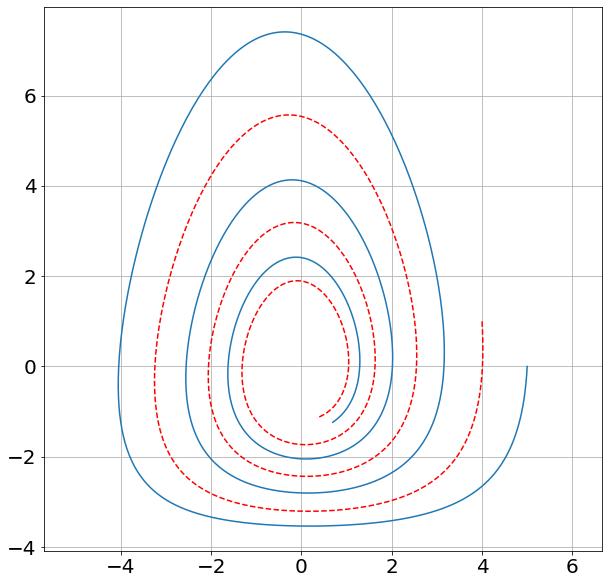

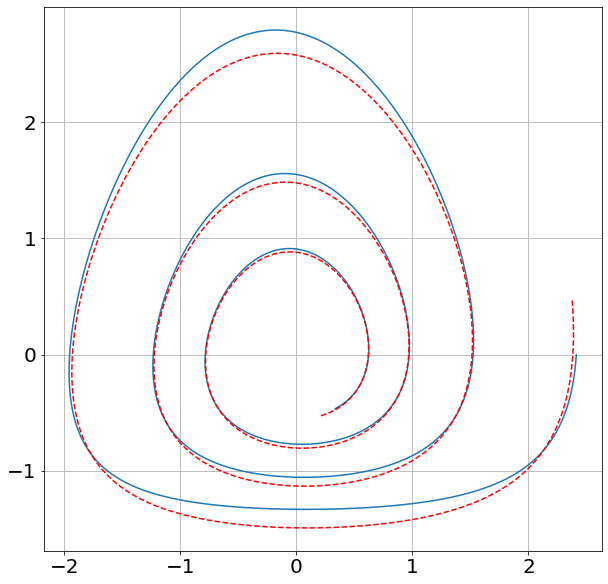

In [ ]:
# Simulate a simple 2D ODE:

y0 = torch.tensor([[5., 0.]]).to(args.device) # Initial position
y0_2 = torch.tensor([[4., 1.]]).to(args.device) # Initial position

t0 = 0 # Start time
tf = 15 # End time
args.dt = 0.01 # Time step

args.data_size = int((tf-t0)/args.dt) # Number of data points in simulation

t = torch.linspace(t0, tf, args.data_size).to(args.device) # Array of timesteps

# System model:
class Lambda(nn.Module):

  def forward(self, t, y):
    # return torch.tensor([-0.1*y[0][0] + y[0][1], -2*y[0][0] - 0.1*y[0][1] - 0.5*y[0][0]*y[0][1]]).to(args.device)
    return torch.tensor([-0.1*y[0][0] + y[0][1], -2*y[0][0] - 0.1*y[0][1] - 0.5*y[0][0]*y[0][1] - 0.025*y[0][1]**2]).to(args.device)
    # return torch.tensor([-0.1*y[0][0] + y[0][1], -2*y[0][0] - 0.1*y[0][1] - 1/(torch.sin(y[0][0])+1.2)]).to(args.device)
    # return torch.tensor([-0.1*y[0][0] + y[0][1], -y[0][0]/(torch.sin(y[0][0])+1.2)]).to(args.device)

class Lambda2(nn.Module):

  def forward(self, t, y):
      return torch.tensor([-0.1*y[0][0] + y[0][1], -2*y[0][0] - 0.1*y[0][1] - 0.5*y[0][0]*y[0][1]]).to(args.device)
      # return torch.tensor([-0.1*y[0][0] + y[0][1], -2*y[0][0] - 0.1*y[0][1] - y[0][1]*f_smooth_divide(torch.sin(y[0][0])+1.3)]).to(args.device)

# Simulate the system:
with torch.no_grad():
  y_true = odeint(Lambda().to(args.device), y0, t, method='dopri5').to(args.device)
  y_valid = odeint(Lambda().to(args.device), y0_2, t, method='dopri5').to(args.device)
  # y_valid = odeint(Lambda2().to(args.device), y0, t, method='dopri5').to(args.device)

# y_true += torch.from_numpy(np.random.normal(0, 0.05, (args.data_size,1,2)))

y_true_plt = y_true.cpu().detach().numpy().squeeze().T
y_valid_plt = y_valid.cpu().detach().numpy().squeeze().T

plt.plot(y_true_plt[0], y_true_plt[1])
plt.plot(y_valid_plt[0], y_valid_plt[1],'r--')
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.grid()
plt.axis('equal')
plt.show()

mu_y0 = np.mean(y_true_plt[0])
mu_y1 = np.mean(y_true_plt[1])
# rescale_y0 = np.mean(np.abs(y_true_plt[0]-mu_y0))
# rescale_y1 = np.mean(np.abs(y_true_plt[1]-mu_y1))
rescale_y0 = np.sqrt(np.var(y_true_plt[0]))
rescale_y1 = np.sqrt(np.var(y_true_plt[1]))

mu_y0v = np.mean(y_valid_plt[0])
mu_y1v = np.mean(y_valid_plt[1])
# rescale_y0v = np.mean(np.abs(y_valid_plt[0]-mu_y0))
# rescale_y1v = np.mean(np.abs(y_valid_plt[1]-mu_y1))
rescale_y0v = np.sqrt(np.var(y_valid_plt[0]))
rescale_y1v = np.sqrt(np.var(y_valid_plt[1]))

plt.plot(y_true_plt[0]/rescale_y0, y_true_plt[1]/rescale_y1)
plt.plot(y_valid_plt[0]/rescale_y0v, y_valid_plt[1]/rescale_y1v,'r--')
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.grid()
plt.axis('equal')
plt.show()

In [ ]:
# mu = torch.mean(true_y,axis=2,keepdims=True)
# print(true_y-mu)
# sigma = torch.var(true_y,axis=2,keepdims=True)
# epsilon = 10e-3
# (true_y-mu)/torch.sqrt(sigma+epsilon)

model.std_dev

1

Training progress...:  23%|██▎       | 68/300 [00:20<01:04,  3.62it/s]

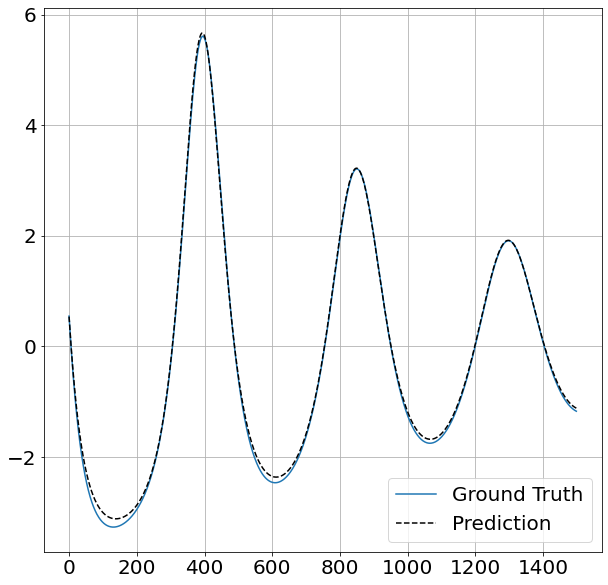

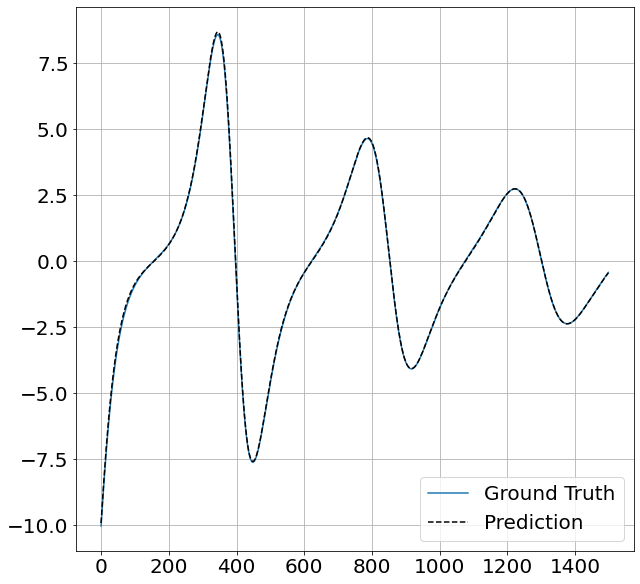

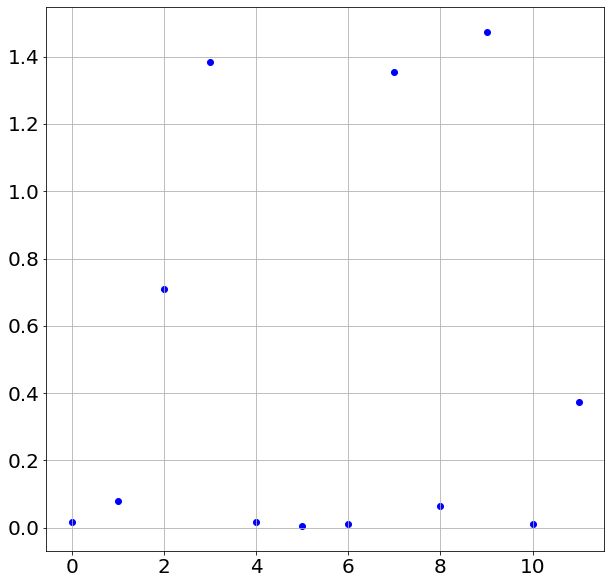

Epoch: 69
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: tensor([[ 0.0182, -0.0792,  0.7088],
        [ 1.3841, -0.0179,  0.0049]], grad_fn=<DivBackward0>)
Layer: 1
Weights: tensor([[ 0.0113,  1.3553,  0.0661],
        [-1.4733,  0.0107, -0.3724]], grad_fn=<DivBackward0>)
 
Hadamard Layers:


Training progress...:  23%|██▎       | 69/300 [00:22<03:16,  1.18it/s]

layer_idx = 0
index of pruned edge = 0
Pruned edges:  1
Unpruned edges:  11
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  30%|██▉       | 89/300 [00:28<01:00,  3.51it/s]

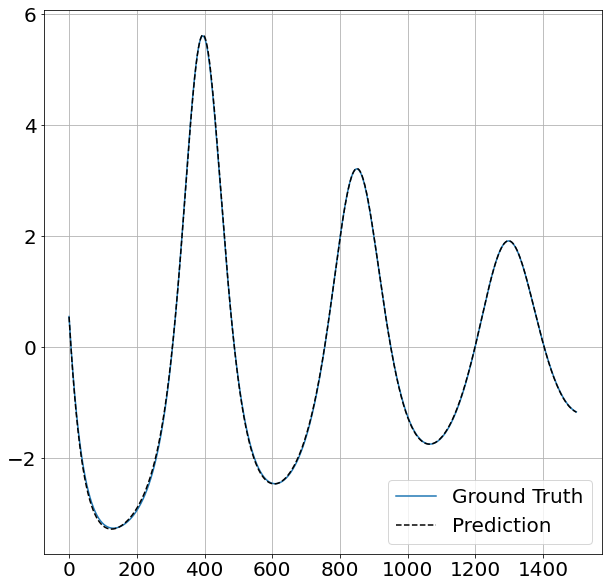

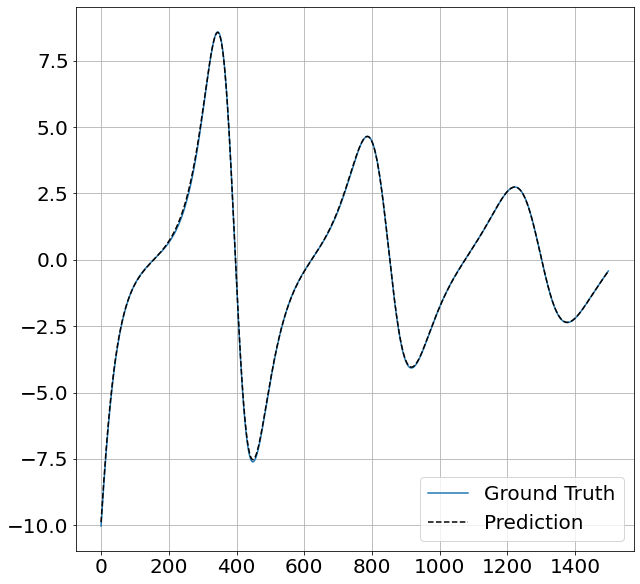

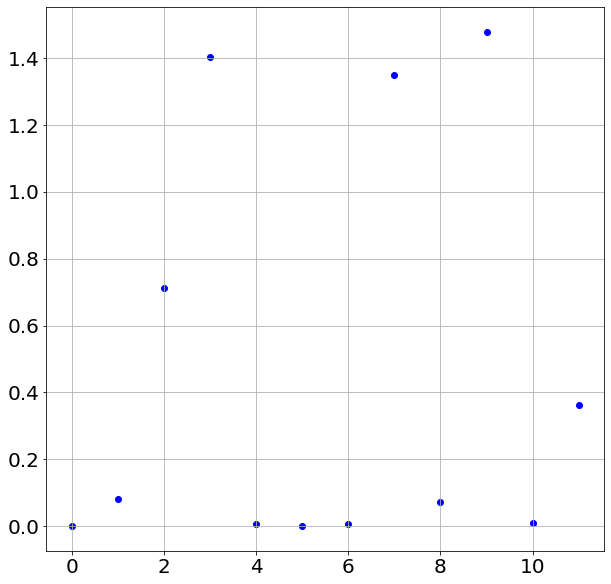

Epoch: 90
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: tensor([[ 0.0000e+00, -8.2529e-02,  7.1217e-01],
        [ 1.4032e+00,  5.2901e-03,  1.2213e-03]], grad_fn=<DivBackward0>)
Layer: 1
Weights: tensor([[ 0.0048,  1.3503,  0.0715],
        [-1.4788,  0.0094, -0.3635]], grad_fn=<DivBackward0>)
 
Hadamard Layers:


Training progress...:  30%|███       | 90/300 [00:31<03:05,  1.13it/s]

layer_idx = 0
index of pruned edge = 3
Pruned edges:  2
Unpruned edges:  10
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  33%|███▎      | 99/300 [00:33<01:00,  3.31it/s]

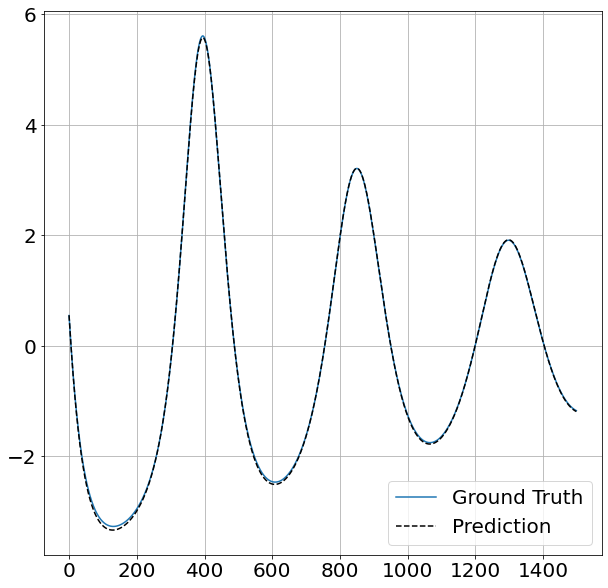

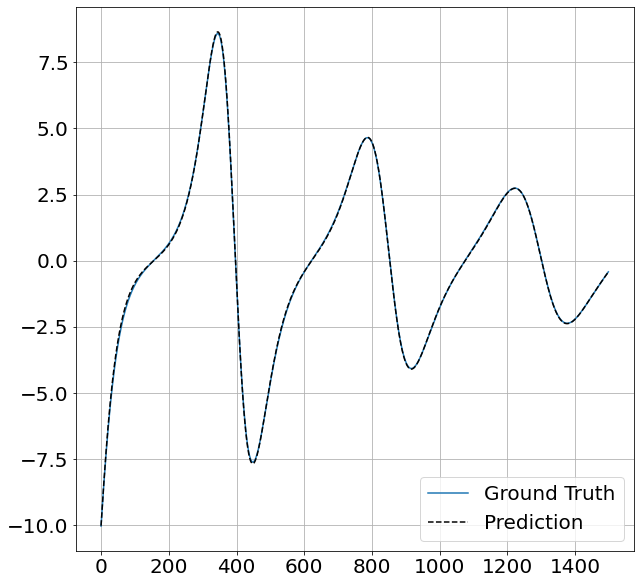

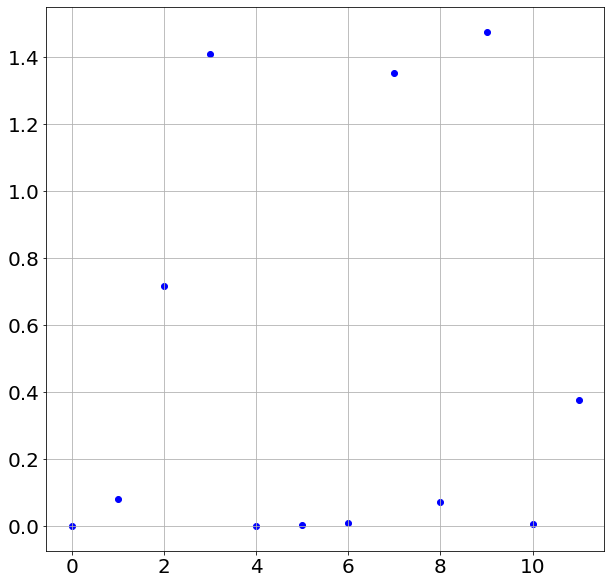

Epoch: 100
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: tensor([[ 0.0000, -0.0802,  0.7162],
        [ 1.4086,  0.0000, -0.0037]], grad_fn=<DivBackward0>)
Layer: 1
Weights: tensor([[ 0.0097,  1.3525,  0.0717],
        [-1.4750,  0.0069, -0.3768]], grad_fn=<DivBackward0>)
 
Hadamard Layers:


Training progress...:  33%|███▎      | 100/300 [00:35<02:56,  1.13it/s]

layer_idx = 0
index of pruned edge = 3
Pruned edges:  3
Unpruned edges:  9
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  40%|████      | 121/300 [00:42<01:02,  2.87it/s]


KeyboardInterrupt: ignored

In [ ]:
# Train the model on the 2D system

args.training_mode = 0 # Training mode (0 for one-step, 1 for Neural ODE)
args.batch_mode = 1 # Batch mode (0 for random, 1 for full trajectory)

num_dim = len(y0.T) # Number of dimensions of state space

num_in = num_dim+1 # Number of in dimensions
num_out = num_in # Number of out dimensions
lr = 2e-3 # Learning rate
w1 = 2 # Size of hidden layers
max_epochs = 300 # Maximum number of training epochs
n_epochs_stop = 7

model = AC_Net_2D(num_in, num_out, w1).to(args.device) # 2D AC Network

# loss = nn.MSELoss(reduction='mean') # Mean squared error loss
# loss = nn.HuberLoss(reduction='mean') # Mean squared error loss
loss = nn.L1Loss() # L1 loss
opt = torch.optim.Adam(model.parameters(), lr=lr) # Optimizer

# Train model:
losses, mean_losses, smoothed_log_mean_losses, prune_epochs = f_train_model(y_true=y_true,y_valid=y_valid,t=t,model=model,loss=loss,opt=opt,w=w1,args=args,max_epochs=max_epochs,lr=lr,n_epochs_stop=n_epochs_stop)

# Plots:
f_plot(losses) # Plot loss per iteration
plt.show()

f_plot(np.log(mean_losses),xlabel='Epoch',ylabel='Log of Mean Loss per Epoch',title='Log Mean Losses') # Plot log-mean loss per epoch
for x_e in prune_epochs:
  plt.axvline(x = x_e,color='k',ls='--',label='axvline - full height')
plt.show()

f_plot(smoothed_log_mean_losses,xlabel='Epoch',ylabel='Running Average Log of Mean Loss per Epoch',title='Smoothed Log-Mean Losses') # Plot smoothed log-mean loss per epoch
for x_e in prune_epochs:
  plt.axvline(x = x_e,color='k',ls='--',label='axvline - full height')
plt.show()

In [ ]:
print("Best epoch:", model.best_epoch)
model.best_weights
# best_model = AC_Net_2D(num_in, num_out, w1).to(args.device) # 2D AC Network
# best_model.weights = model.best_weights

f_plot_velocities(model,y_valid)
# f_plot_trajectories(best_model,y_valid,t)
# f_display_weights(best_model)

Best epoch: 299


RuntimeError: ignored

### HLM Net

rand seed = 9654


Training progress...:  33%|███▎      | 165/500 [01:46<03:14,  1.72it/s]

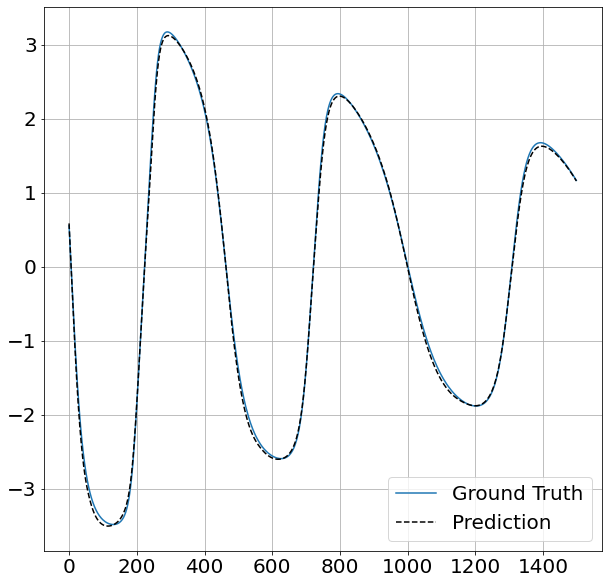

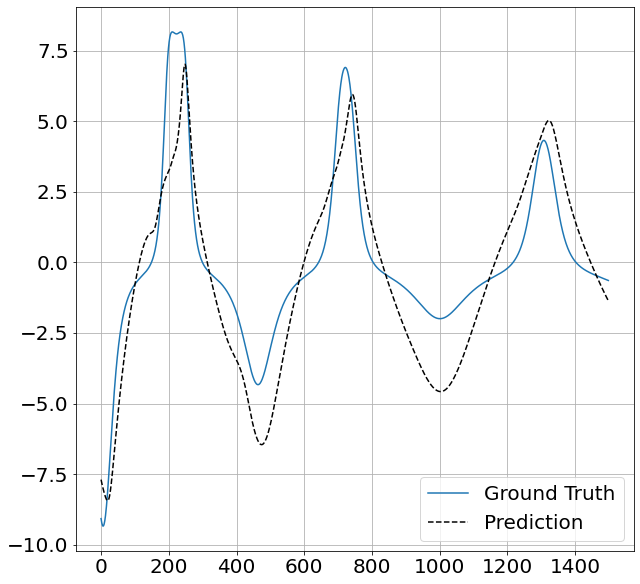

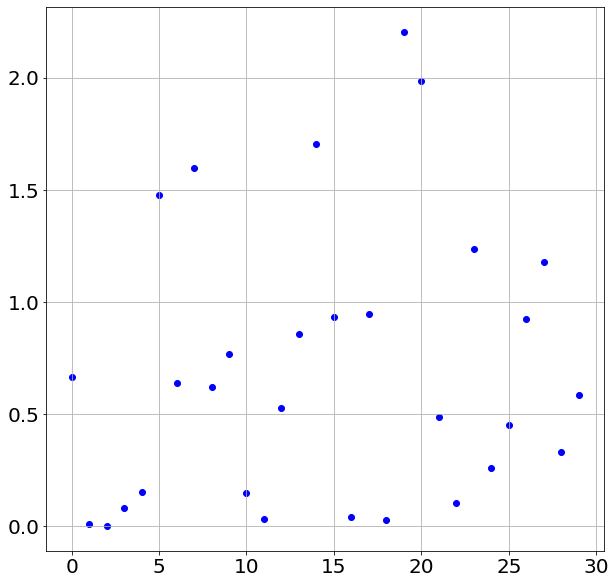

Epoch: 166
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.6677,  0.0113,  0.0017],
        [-0.0803, -0.1554,  1.4794]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[-0.6389,  1.5980,  0.6223],
        [-0.7695, -0.1499,  0.0341]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5298, 0.8583, 1.7074]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.9336]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0437]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.9493, -0.0274,  2.2050]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[1.9839]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.4902]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[-0.1026,  1.2358,  0.2622]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.4529]], requires_grad=True)
Layer

Training progress...:  33%|███▎      | 166/500 [01:55<18:34,  3.34s/it]

layer_idx = 1
index of pruned edge = 4
Pruned edges:  1
Unpruned edges:  29
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  35%|███▍      | 173/500 [02:00<04:28,  1.22it/s]

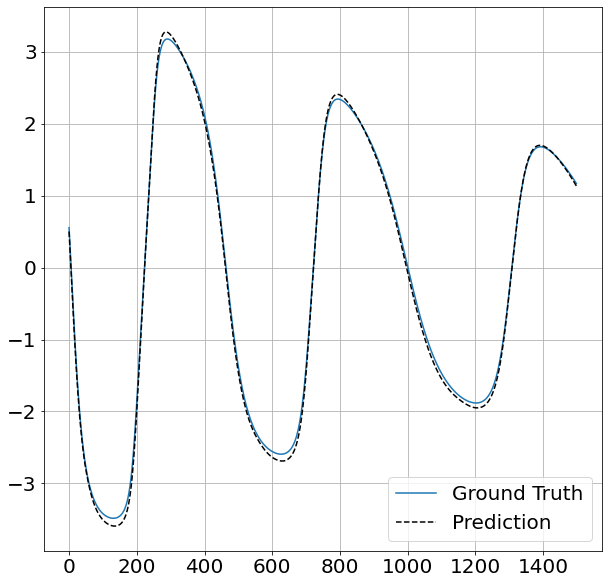

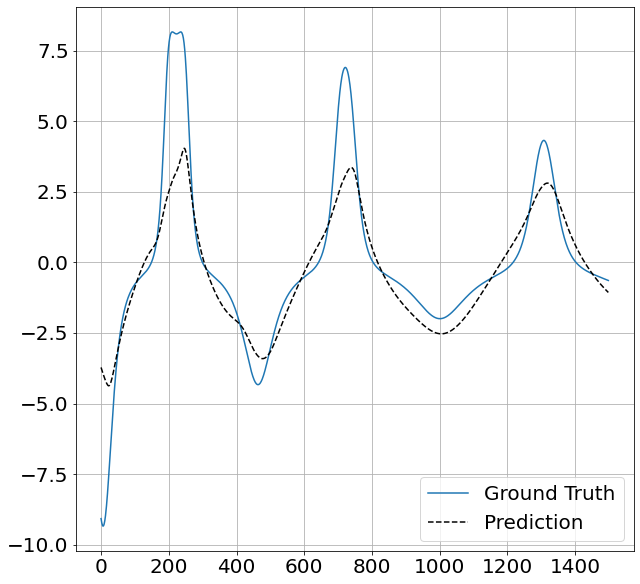

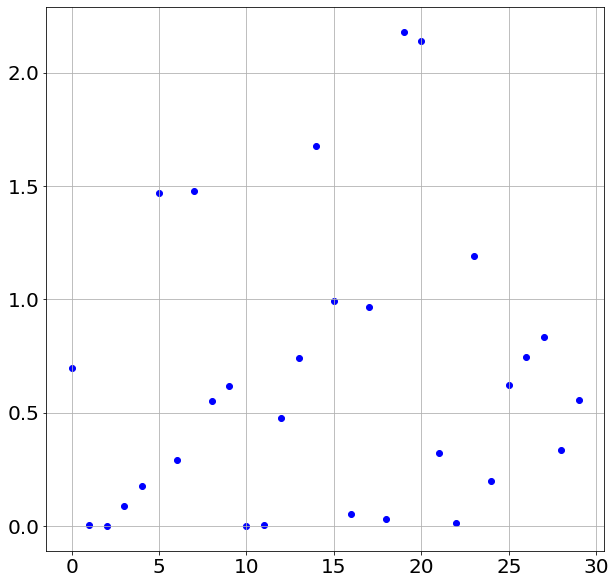

Epoch: 174
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 6.9885e-01, -6.9119e-03,  1.1111e-03],
        [-8.8328e-02, -1.7677e-01,  1.4699e+00]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[-0.2926,  1.4763,  0.5510],
        [-0.6176,  0.0000,  0.0035]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.4788, 0.7426, 1.6773]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.9926]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0521]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.9680, -0.0323,  2.1805]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[2.1420]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.3243]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0127, 1.1926, 0.1987]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.6203]], requ

Training progress...:  35%|███▍      | 174/500 [02:09<18:21,  3.38s/it]

layer_idx = 0
index of pruned edge = 3
Pruned edges:  2
Unpruned edges:  28
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  36%|███▌      | 181/500 [02:13<04:45,  1.12it/s]

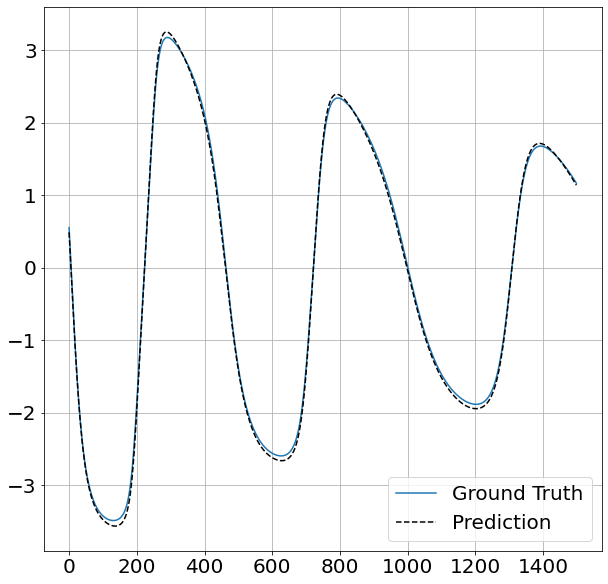

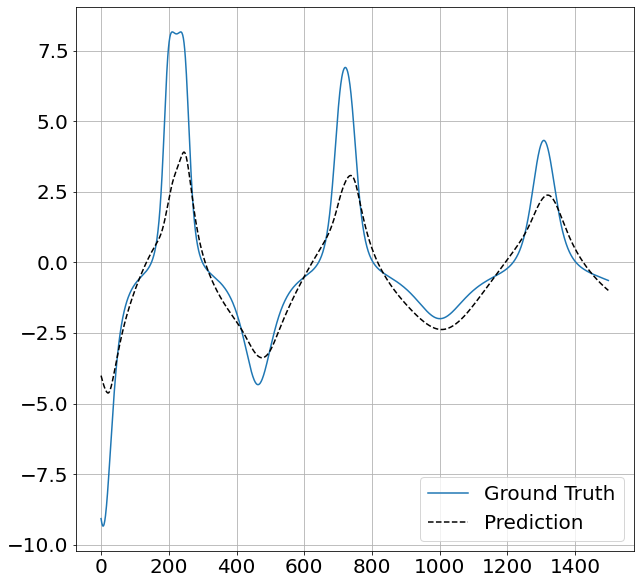

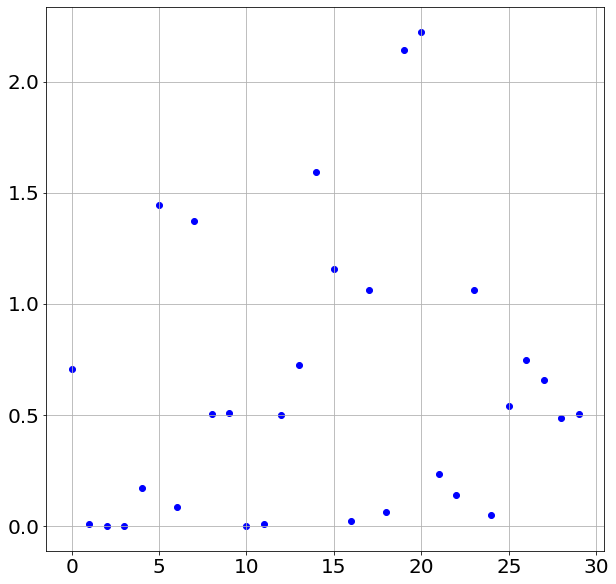

Epoch: 182
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 7.0928e-01, -8.1329e-03,  3.5174e-05],
        [ 0.0000e+00, -1.7276e-01,  1.4437e+00]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[-0.0841,  1.3714,  0.5061],
        [-0.5075,  0.0000,  0.0083]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.0231]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.0646, -0.0617,  2.1451]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[2.2244]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.2323]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.1408, 1.0607, 0.0498]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.5411]], req

Training progress...:  36%|███▋      | 182/500 [02:23<17:50,  3.37s/it]

layer_idx = 4
index of pruned edge = 0
Pruned edges:  3
Unpruned edges:  27
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  38%|███▊      | 189/500 [02:28<05:09,  1.01it/s]

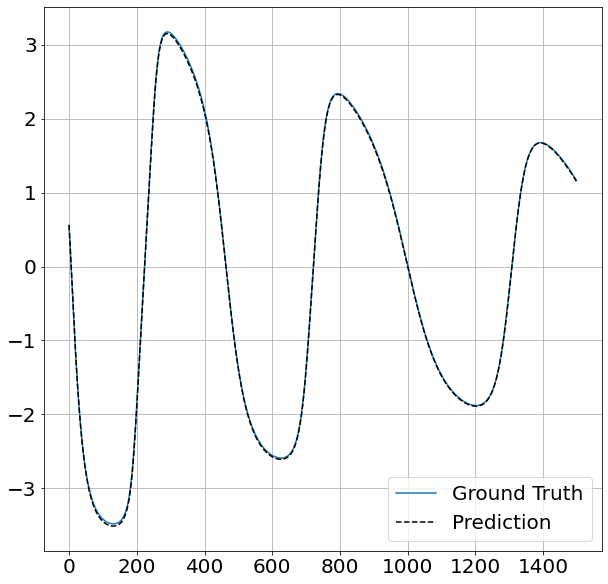

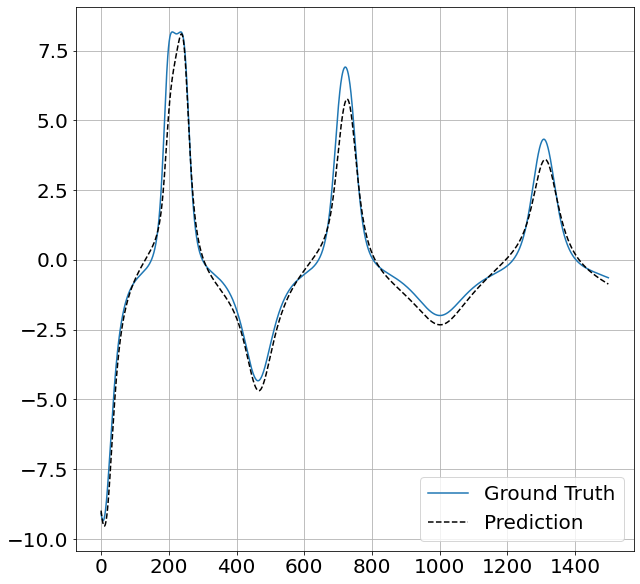

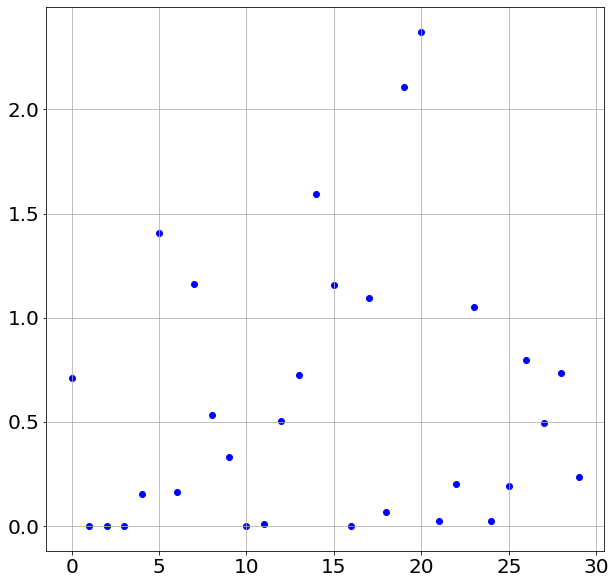

Epoch: 190
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 7.1161e-01, -7.7769e-04, -1.7438e-03],
        [ 0.0000e+00, -1.5185e-01,  1.4055e+00]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.1635,  1.1632,  0.5323],
        [-0.3312,  0.0000,  0.0098]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.0970, -0.0658,  2.1096]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[2.3717]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0259]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.2012, 1.0501, 0.0267]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1913]], require

Training progress...:  38%|███▊      | 190/500 [02:36<16:23,  3.17s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  4
Unpruned edges:  26
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  49%|████▉     | 247/500 [03:12<02:30,  1.68it/s]

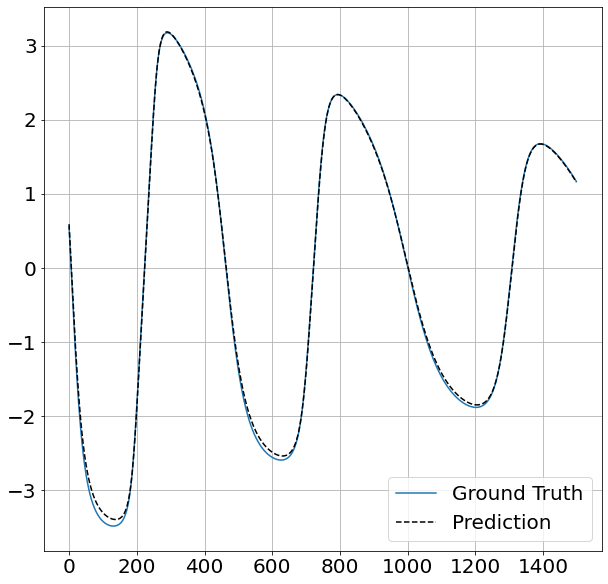

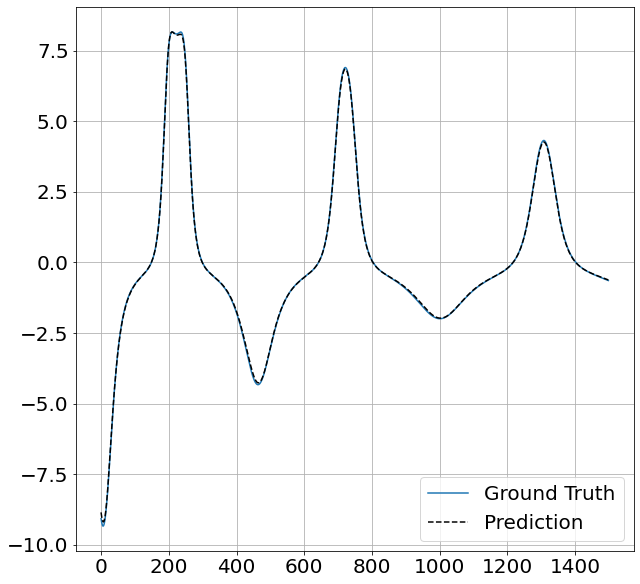

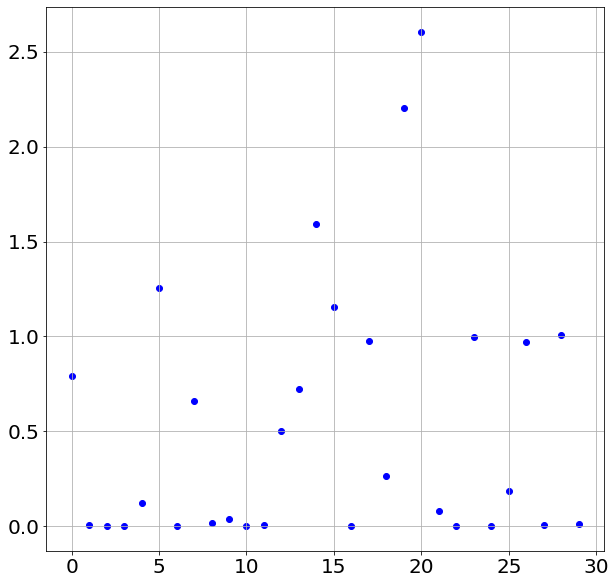

Epoch: 248
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.7900, -0.0053,  0.0028],
        [ 0.0000, -0.1219,  1.2546]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  0.6621,  0.0172],
        [-0.0377,  0.0000,  0.0068]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0.9780, 0.2622, 2.2051]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[2.6054]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0818]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[8.6738e-05, 9.9875e-01, 2.9677e-04]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1866]], requires_grad=True)
La

Training progress...:  50%|████▉     | 248/500 [03:21<12:39,  3.01s/it]

layer_idx = 0
index of pruned edge = 1
Pruned edges:  5
Unpruned edges:  25
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  54%|█████▍    | 272/500 [03:36<02:13,  1.71it/s]

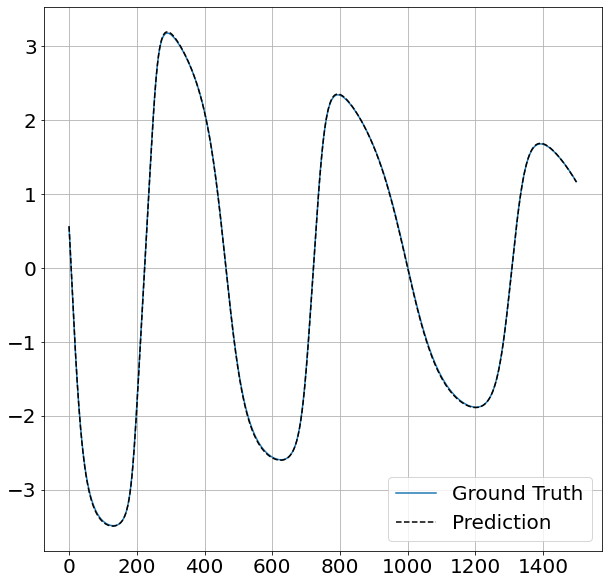

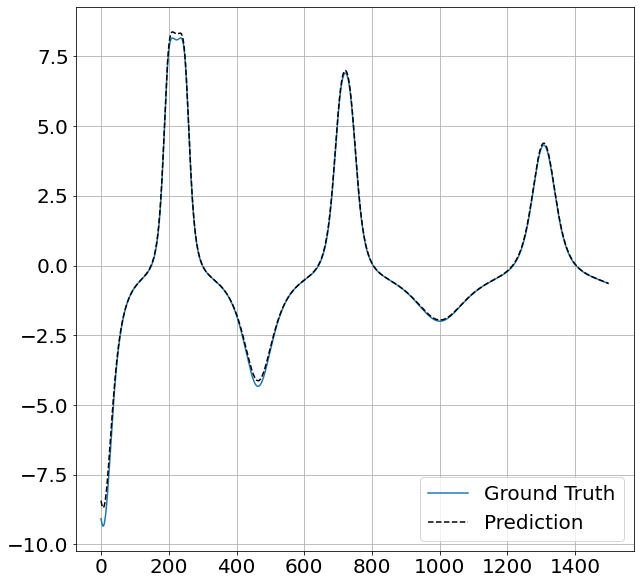

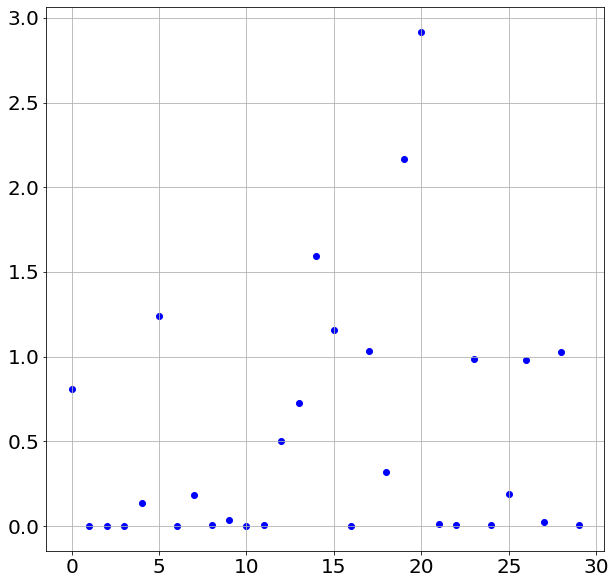

Epoch: 273
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 8.1048e-01,  0.0000e+00,  5.5362e-04],
        [ 0.0000e+00, -1.3469e-01,  1.2372e+00]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  0.1863,  0.0048],
        [-0.0349,  0.0000,  0.0083]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[1.0318, 0.3220, 2.1682]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[2.9172]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0151]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[-0.0066,  0.9888,  0.0037]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1914]], require

Training progress...:  55%|█████▍    | 273/500 [03:44<10:44,  2.84s/it]

layer_idx = 11
index of pruned edge = 0
Pruned edges:  6
Unpruned edges:  24
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  59%|█████▉    | 296/500 [03:58<02:00,  1.69it/s]

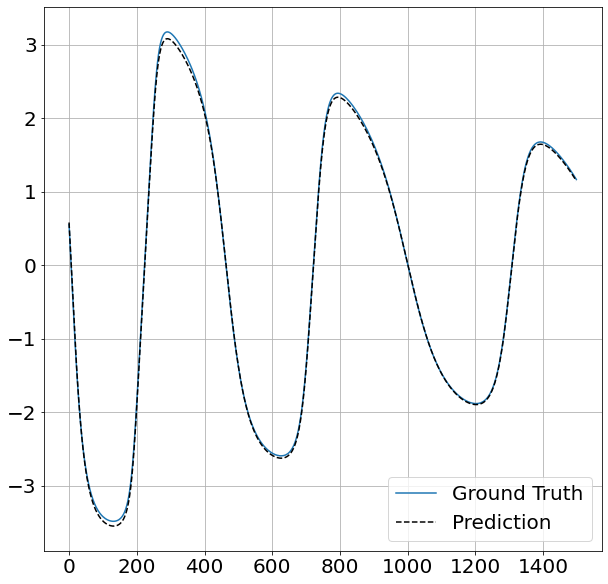

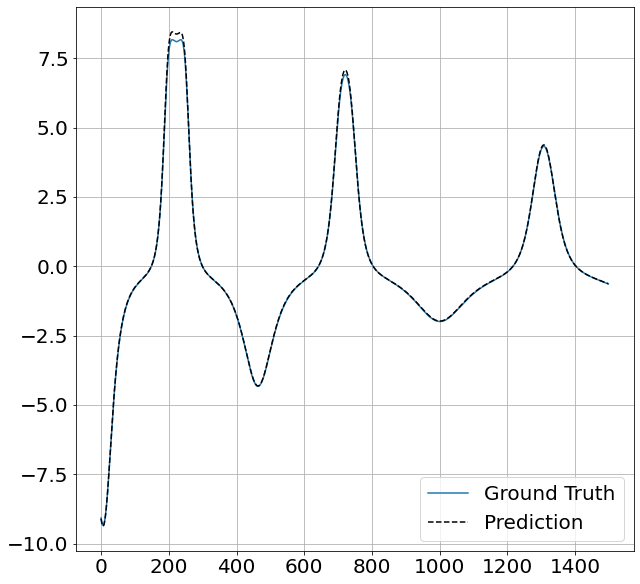

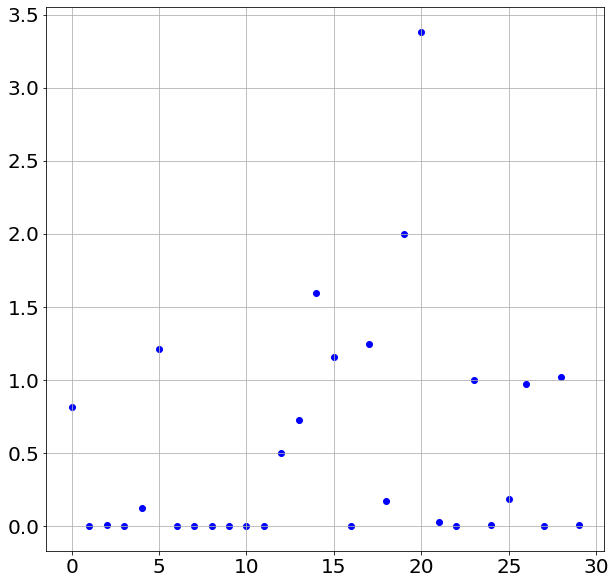

Epoch: 297
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8183,  0.0000, -0.0060],
        [ 0.0000, -0.1244,  1.2148]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  0.0038,  0.0023],
        [ 0.0014,  0.0000, -0.0003]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[1.2437, 0.1716, 1.9980]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[3.3836]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0290]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0037, 0.9972, 0.0056]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1836]], requires_grad=True)
Layer: 10
Weig

Training progress...:  59%|█████▉    | 297/500 [04:06<09:26,  2.79s/it]

layer_idx = 0
index of pruned edge = 1
Pruned edges:  7
Unpruned edges:  23
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  65%|██████▍   | 323/500 [04:22<01:45,  1.67it/s]

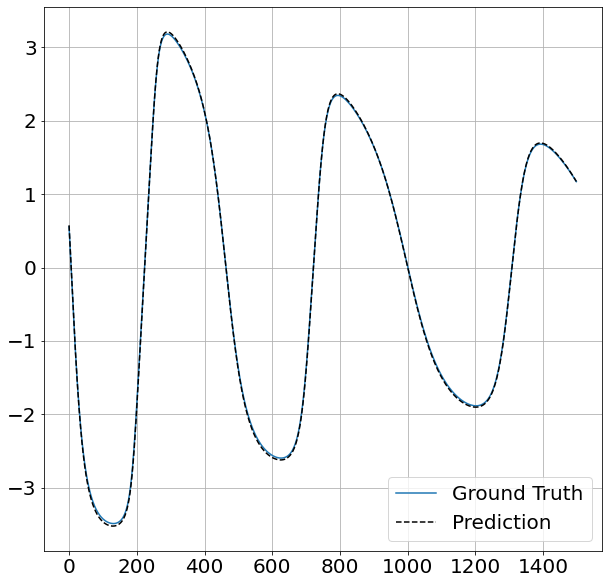

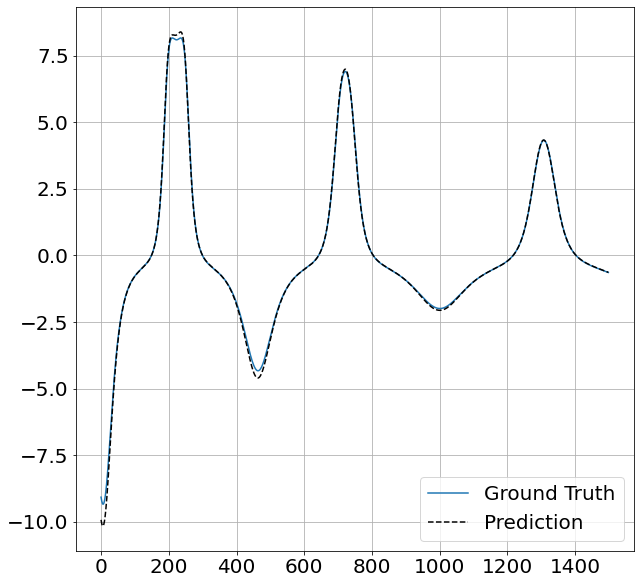

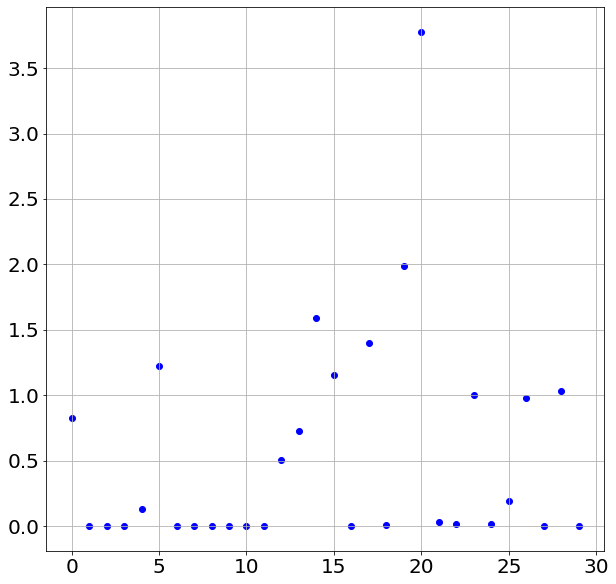

Epoch: 324
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8247,  0.0000,  0.0000],
        [ 0.0000, -0.1318,  1.2235]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0.0000, 0.0010, 0.0006],
        [0.0028, 0.0000, 0.0013]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.4015, -0.0055,  1.9848]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[3.7768]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0348]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0183, 1.0054, 0.0138]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1895]], requires_grad=True)
Layer: 10
Weights

Training progress...:  65%|██████▍   | 324/500 [04:30<08:08,  2.77s/it]

layer_idx = 8
index of pruned edge = 0
Pruned edges:  8
Unpruned edges:  22
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  69%|██████▉   | 344/500 [04:42<01:41,  1.54it/s]

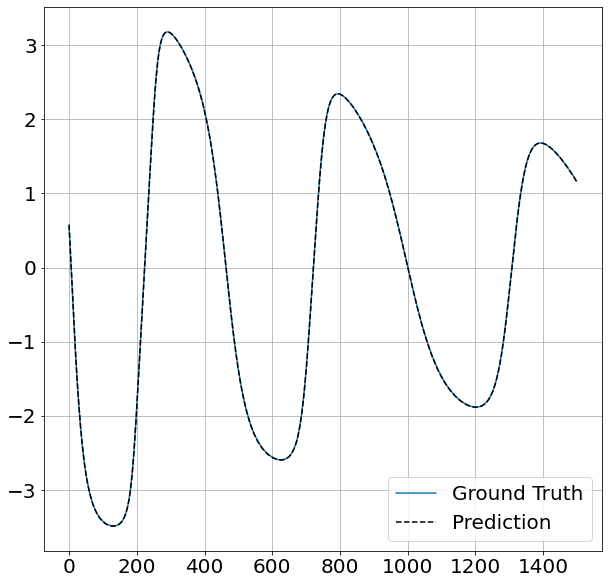

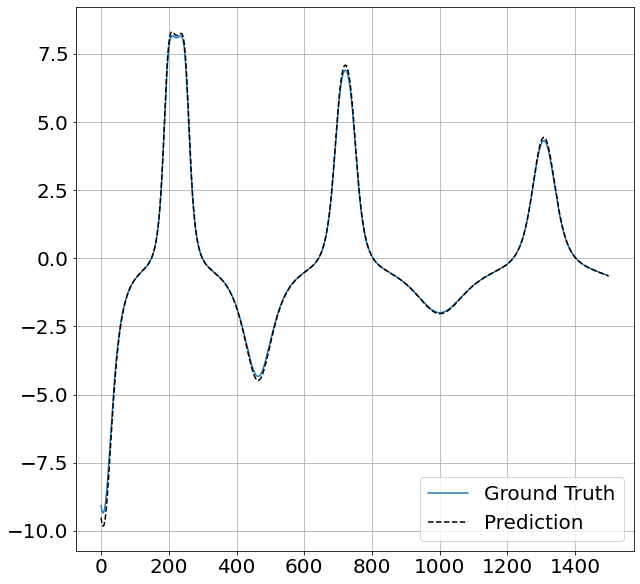

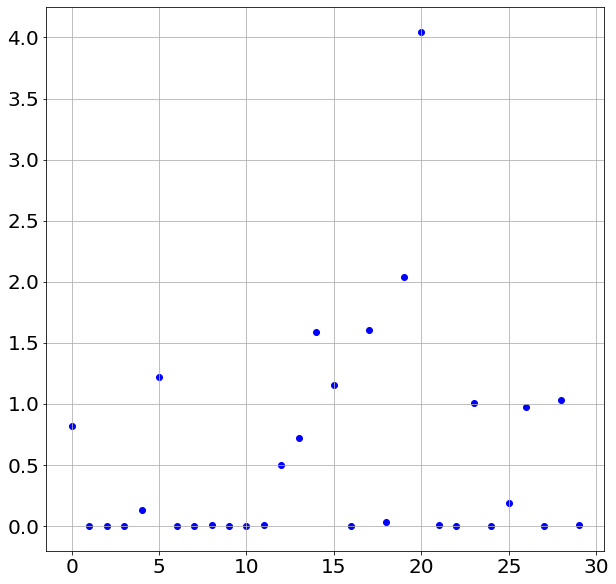

Epoch: 345
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8197,  0.0000,  0.0000],
        [ 0.0000, -0.1283,  1.2203]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000, -0.0023, -0.0075],
        [ 0.0048,  0.0000, -0.0062]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.6017, -0.0365,  2.0412]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.0456]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0099]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000e+00, 1.0063e+00, 8.7715e-04]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1869]], requires_grad=True)

Training progress...:  69%|██████▉   | 345/500 [04:49<06:45,  2.62s/it]

layer_idx = 1
index of pruned edge = 2
Pruned edges:  9
Unpruned edges:  21
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  71%|███████   | 355/500 [04:56<01:35,  1.52it/s]

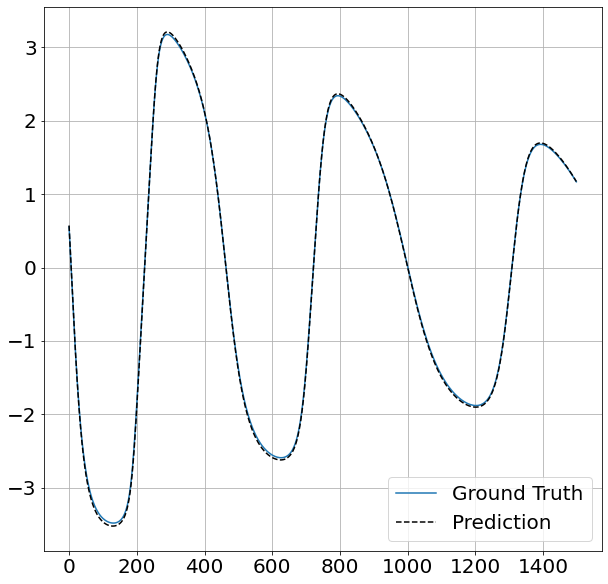

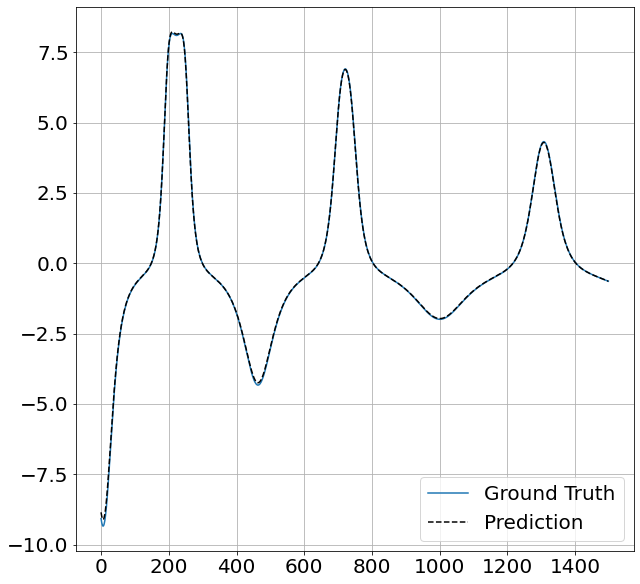

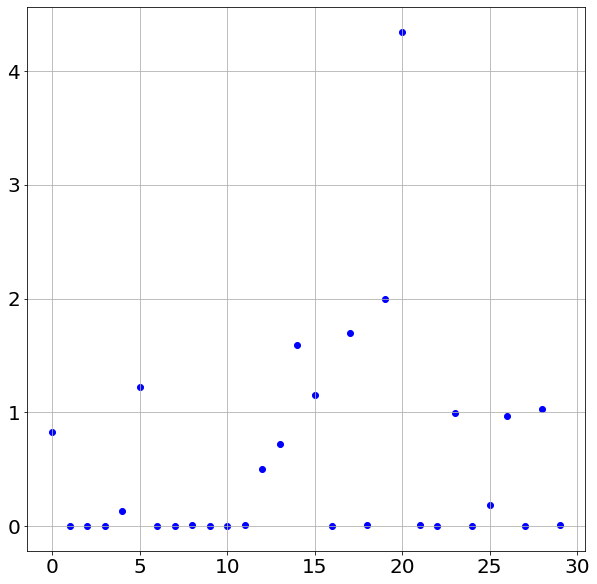

Epoch: 356
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8248,  0.0000,  0.0000],
        [ 0.0000, -0.1328,  1.2255]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0.0000, 0.0013, 0.0102],
        [0.0000, 0.0000, 0.0090]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[-0.0081]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9958, 0.0045]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1889]], requires_grad=True)
Layer: 10
Weights

Training progress...:  71%|███████   | 356/500 [05:03<06:26,  2.69s/it]

layer_idx = 7
index of pruned edge = 0
Pruned edges:  10
Unpruned edges:  20
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  73%|███████▎  | 363/500 [05:07<01:46,  1.29it/s]

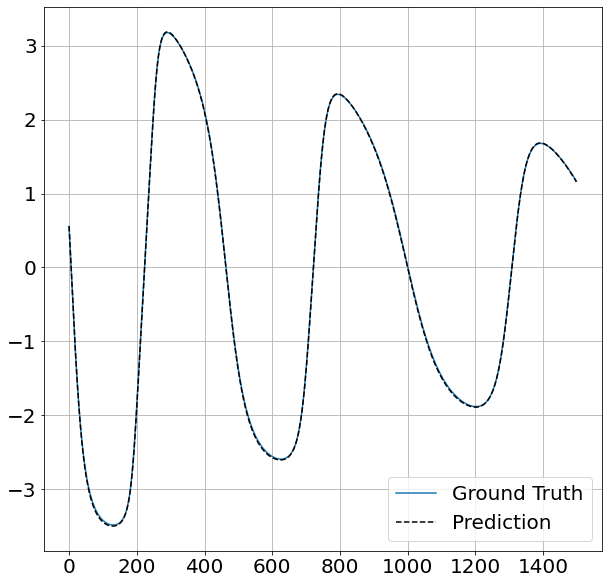

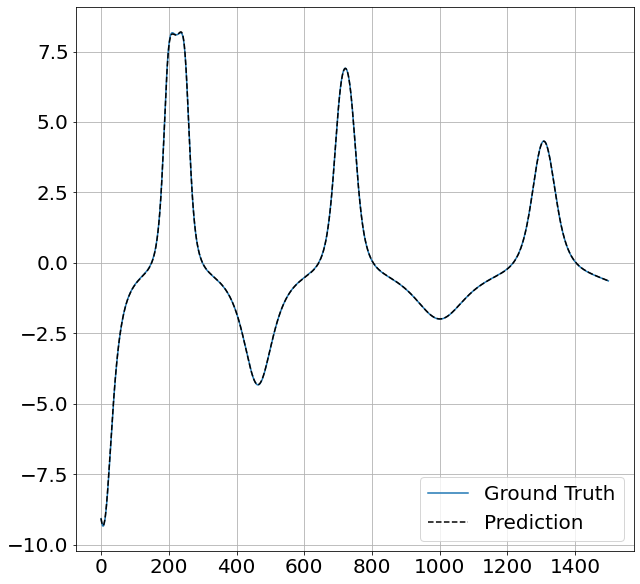

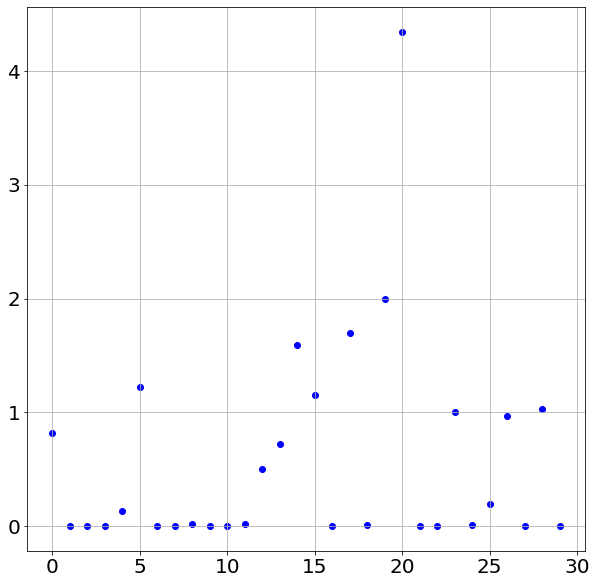

Epoch: 364
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8209,  0.0000,  0.0000],
        [ 0.0000, -0.1347,  1.2217]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000, -0.0008, -0.0188],
        [ 0.0000,  0.0000,  0.0168]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9990, 0.0077]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1899]], requires_grad=True)
Layer: 10
Weight

Training progress...:  73%|███████▎  | 364/500 [05:15<06:30,  2.87s/it]

layer_idx = 1
index of pruned edge = 1
Pruned edges:  11
Unpruned edges:  19
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  74%|███████▍  | 371/500 [05:20<01:42,  1.25it/s]

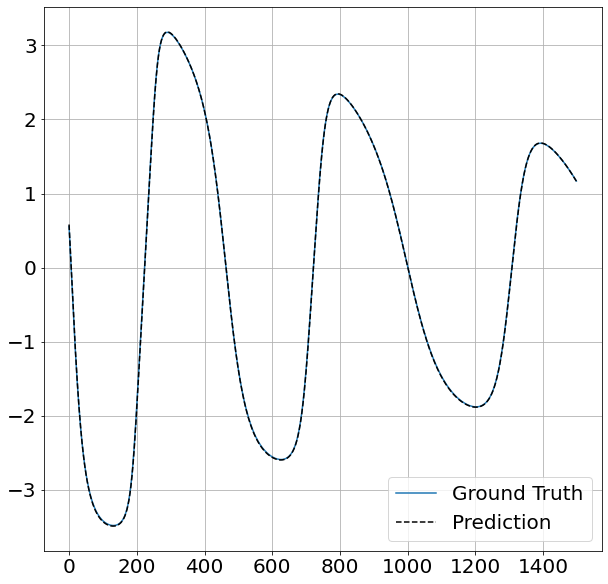

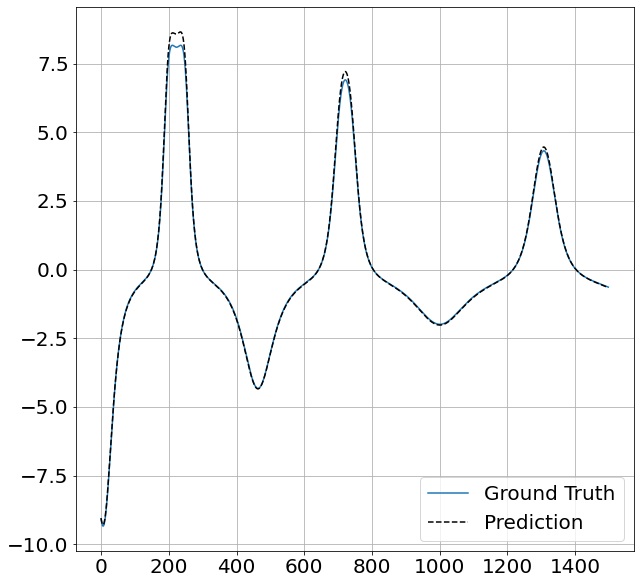

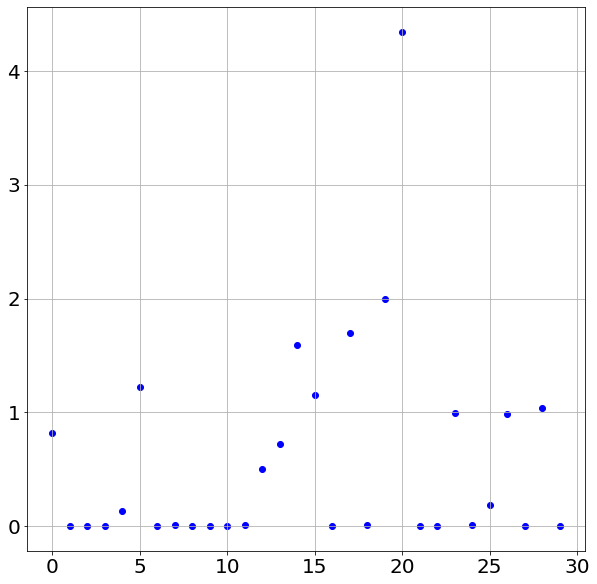

Epoch: 372
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8199,  0.0000,  0.0000],
        [ 0.0000, -0.1283,  1.2221]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0.0000, 0.0105, 0.0000],
        [0.0000, 0.0000, 0.0129]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9924, 0.0077]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1847]], requires_grad=True)
Layer: 10
Weights: Par

Training progress...:  74%|███████▍  | 372/500 [05:26<05:25,  2.54s/it]

layer_idx = 8
index of pruned edge = 1
Pruned edges:  12
Unpruned edges:  18
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  76%|███████▌  | 379/500 [05:31<01:34,  1.28it/s]

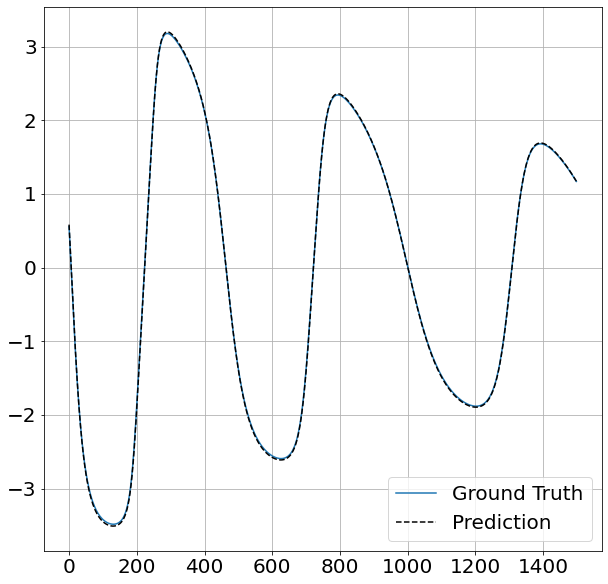

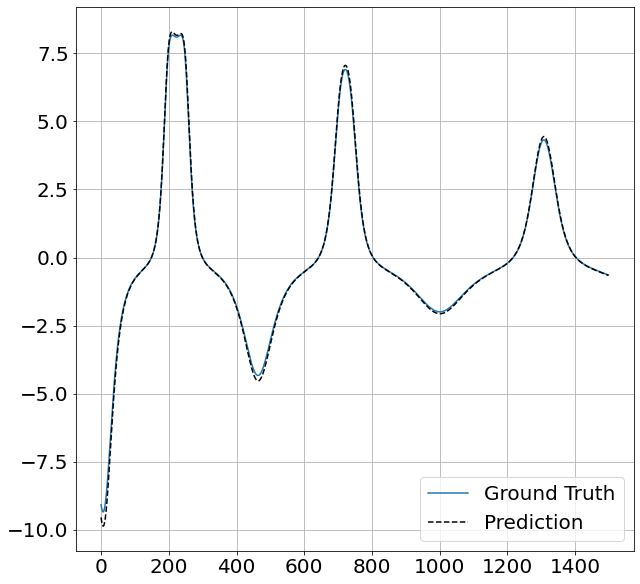

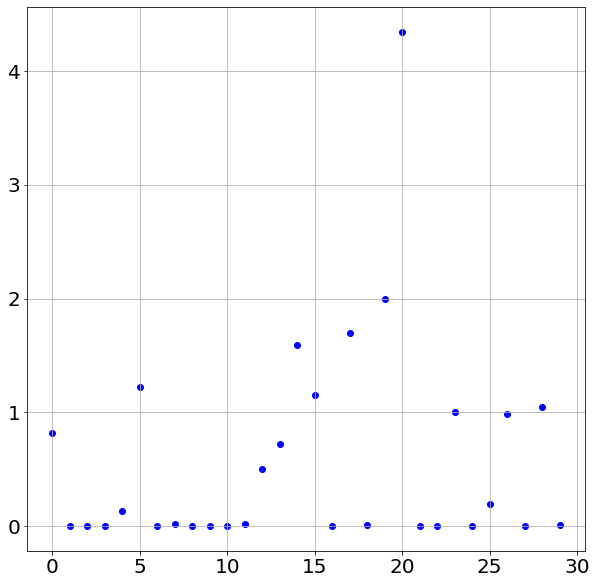

Epoch: 380
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8221,  0.0000,  0.0000],
        [ 0.0000, -0.1291,  1.2249]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000, -0.0169,  0.0000],
        [ 0.0000,  0.0000,  0.0177]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.5020, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 1.0057, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1917]], requires_grad=True)
Layer: 10
Weight

Training progress...:  76%|███████▌  | 380/500 [05:37<05:03,  2.53s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  13
Unpruned edges:  17
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  77%|███████▋  | 387/500 [05:42<01:25,  1.32it/s]

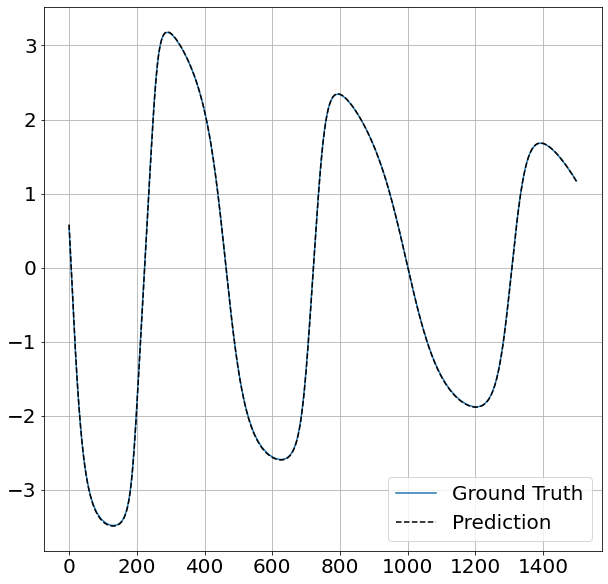

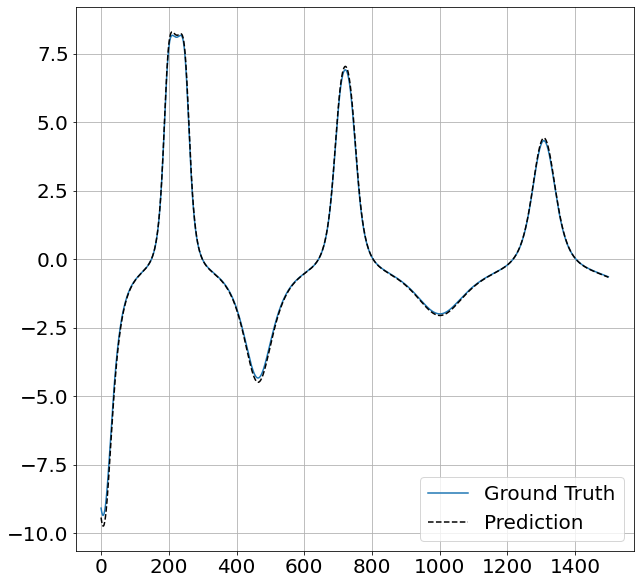

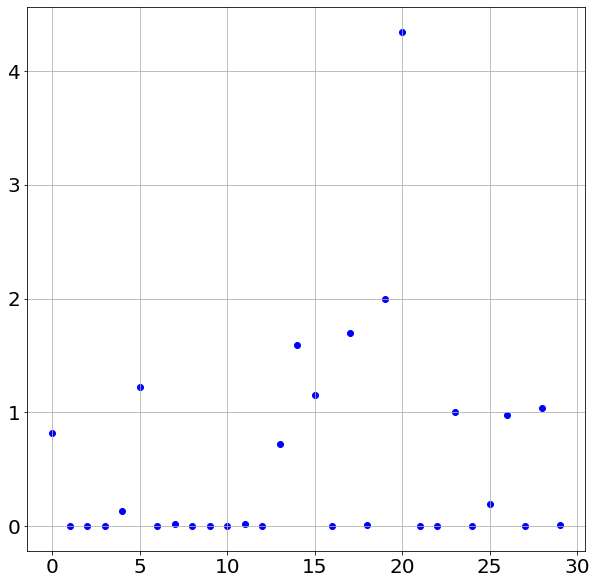

Epoch: 388
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8197,  0.0000,  0.0000],
        [ 0.0000, -0.1284,  1.2227]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000, -0.0151,  0.0000],
        [ 0.0000,  0.0000,  0.0153]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.0000, 0.7243, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 1.0038, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1916]], requires_grad=True)
Layer: 10
Weight

Training progress...:  78%|███████▊  | 388/500 [05:47<04:08,  2.22s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  14
Unpruned edges:  16
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  79%|███████▉  | 395/500 [05:52<01:19,  1.31it/s]

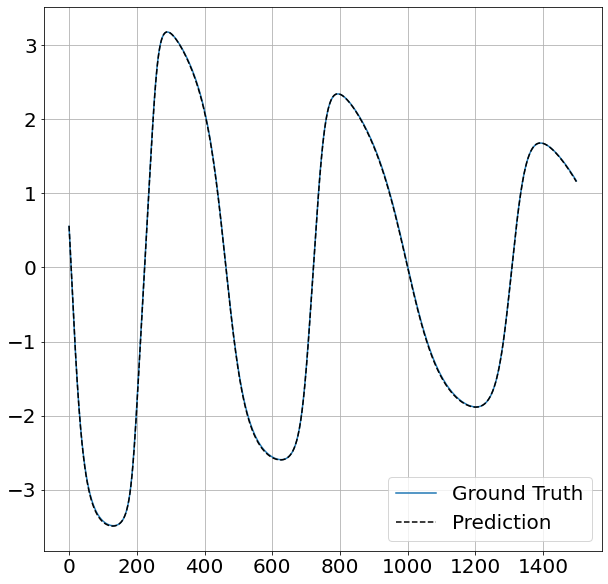

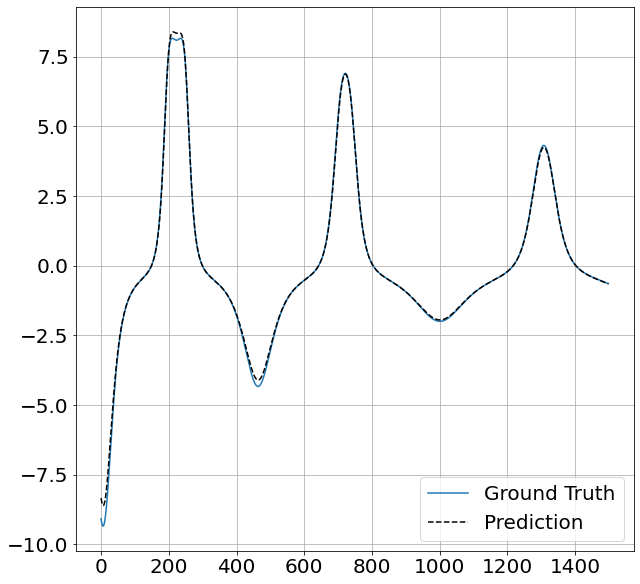

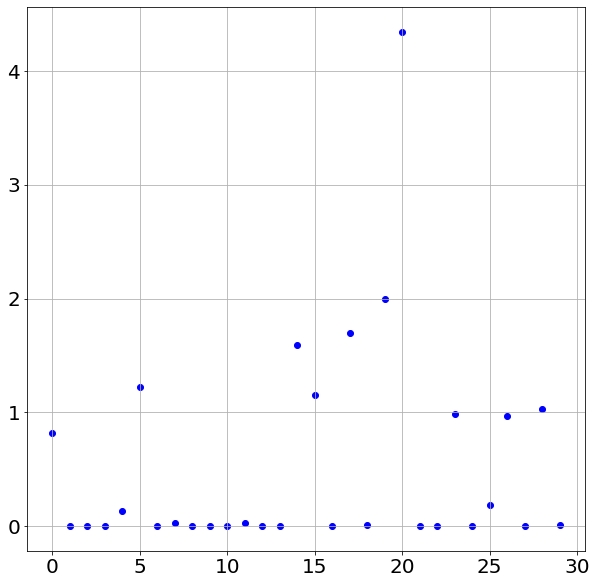

Epoch: 396
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8188,  0.0000,  0.0000],
        [ 0.0000, -0.1339,  1.2217]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000, -0.0307,  0.0000],
        [ 0.0000,  0.0000,  0.0308]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9852, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1880]], requires_grad=True)
Layer: 10
Weight

Training progress...:  79%|███████▉  | 396/500 [05:58<03:53,  2.25s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  15
Unpruned edges:  15
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  81%|████████  | 403/500 [06:03<01:22,  1.17it/s]

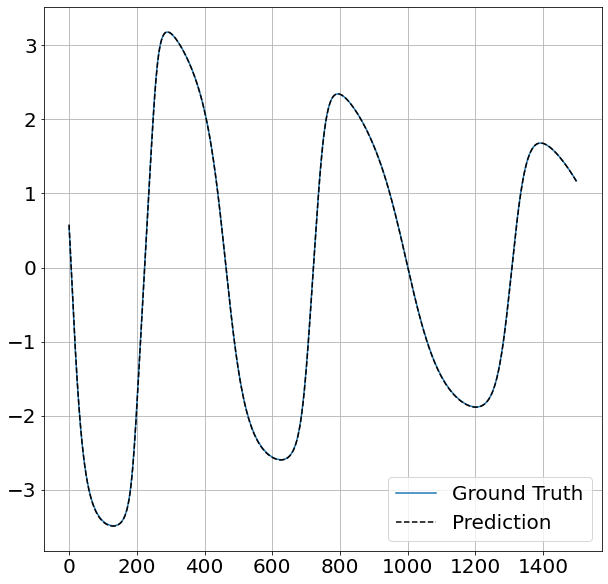

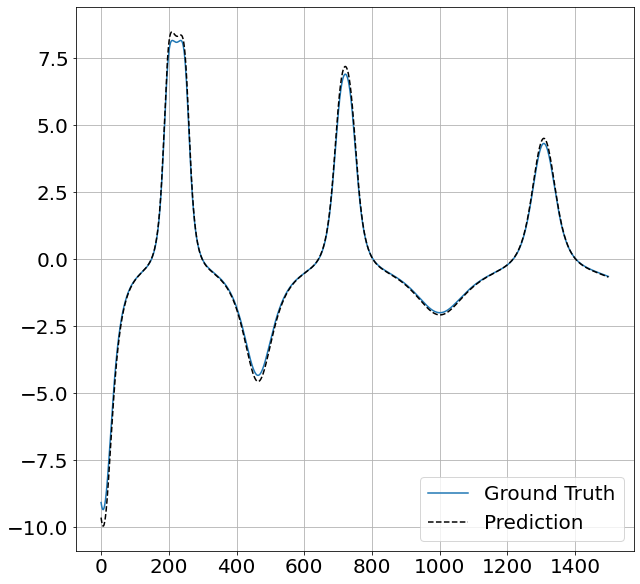

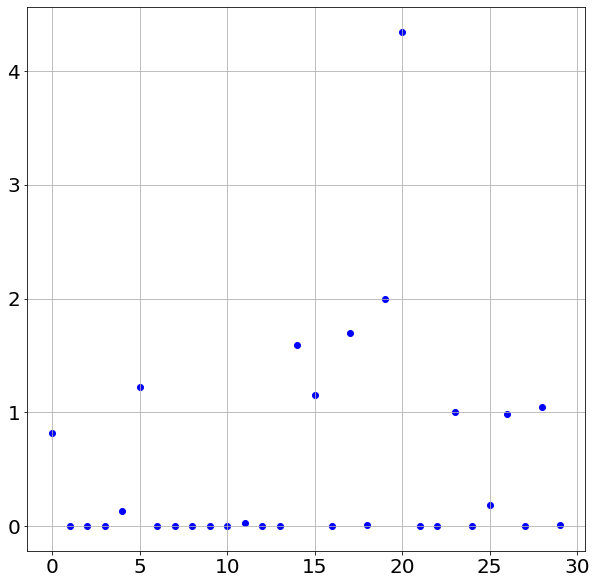

Epoch: 404
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8187,  0.0000,  0.0000],
        [ 0.0000, -0.1286,  1.2226]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0308]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 1.0052, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1886]], requires_grad=True)
Layer: 10
Weights: Par

Training progress...:  81%|████████  | 404/500 [06:08<03:25,  2.14s/it]

layer_idx = 11
index of pruned edge = 1
Pruned edges:  16
Unpruned edges:  14
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  82%|████████▏ | 411/500 [06:13<01:19,  1.12it/s]

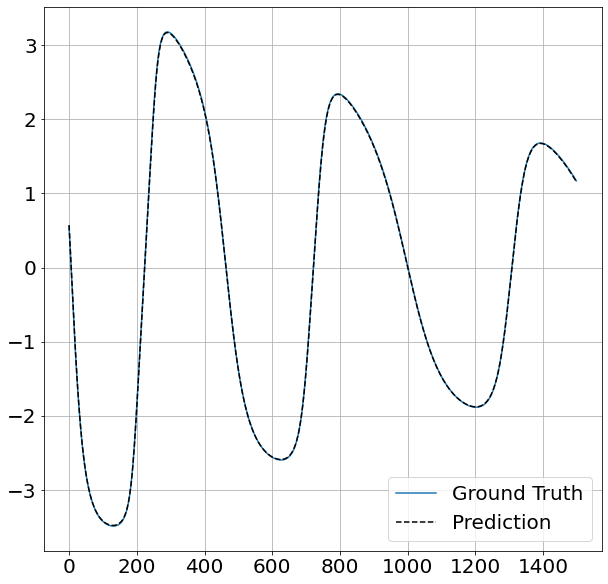

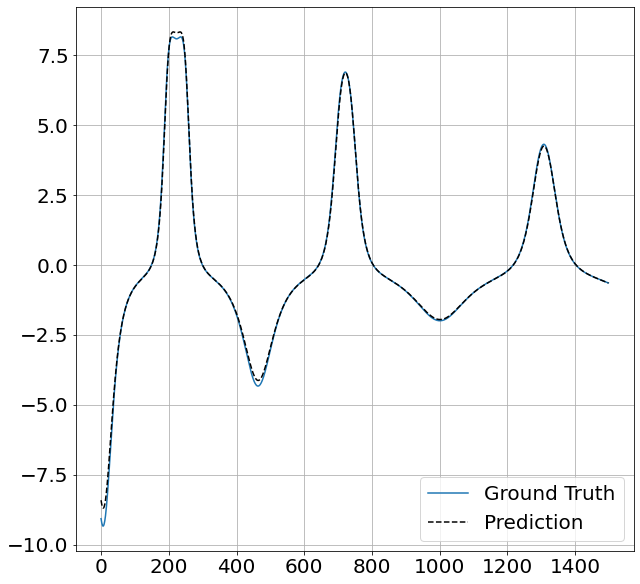

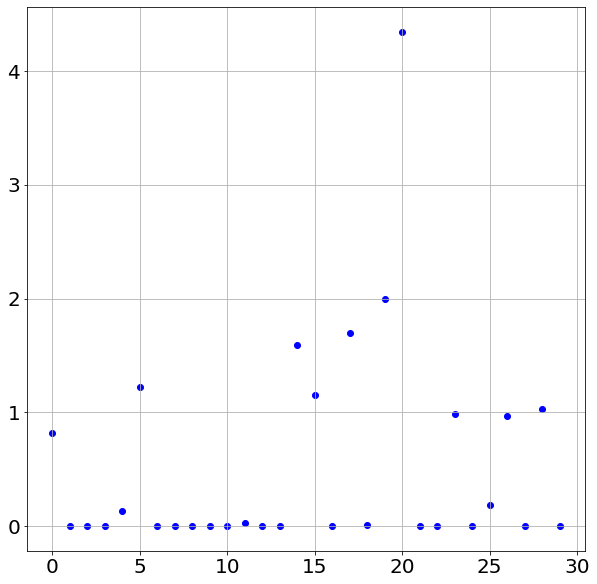

Epoch: 412
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8167,  0.0000,  0.0000],
        [ 0.0000, -0.1298,  1.2208]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0308]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9872, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1885]], requires_grad=True)
Layer: 10
Weights: Par

Training progress...:  82%|████████▏ | 412/500 [06:19<03:11,  2.18s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  17
Unpruned edges:  13
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  84%|████████▍ | 419/500 [06:23<00:59,  1.37it/s]

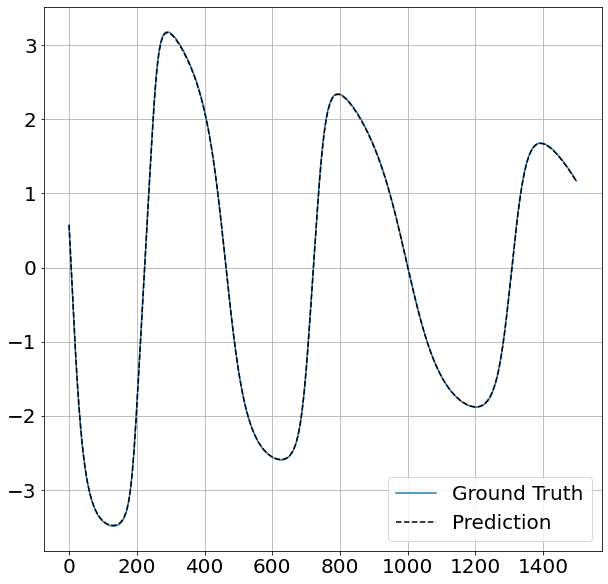

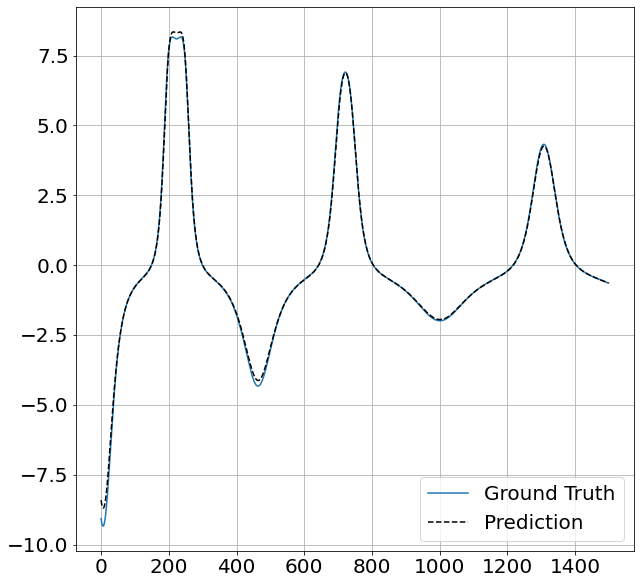

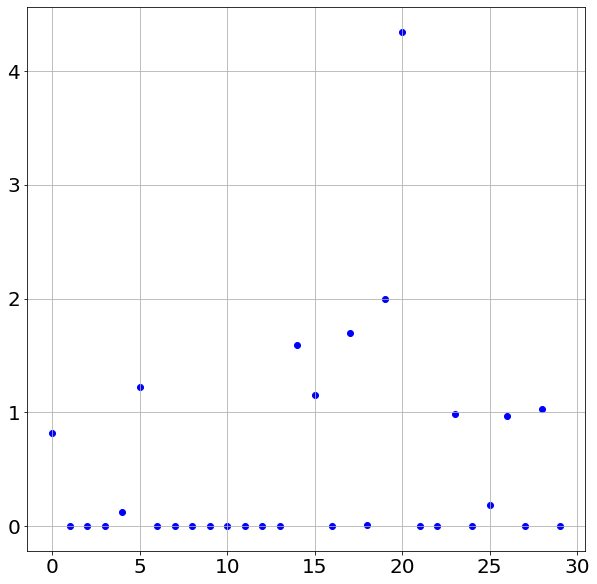

Epoch: 420
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8163,  0.0000,  0.0000],
        [ 0.0000, -0.1281,  1.2215]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 1.5929]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9871, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1884]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tenso

Training progress...:  84%|████████▍ | 420/500 [06:28<02:50,  2.13s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  18
Unpruned edges:  12
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  85%|████████▌ | 427/500 [06:32<00:52,  1.40it/s]

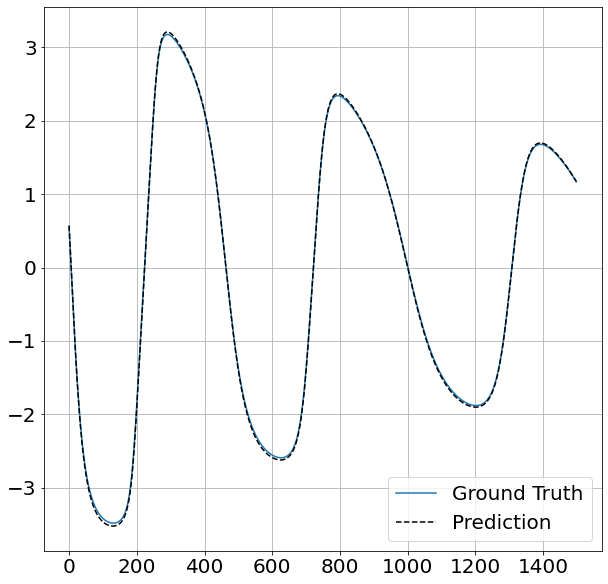

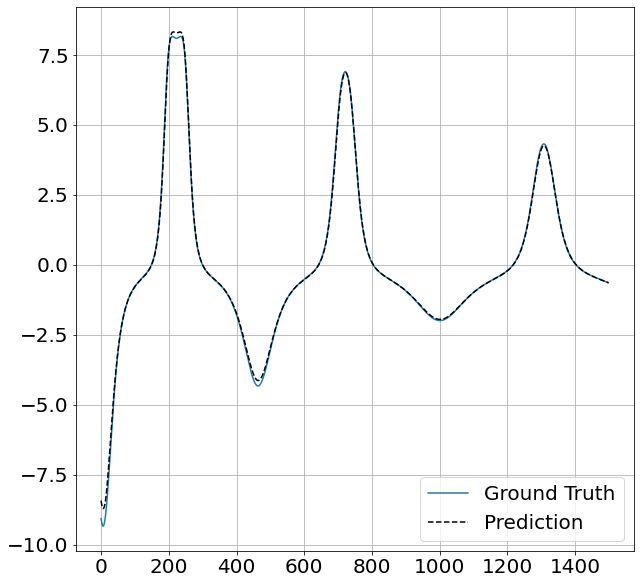

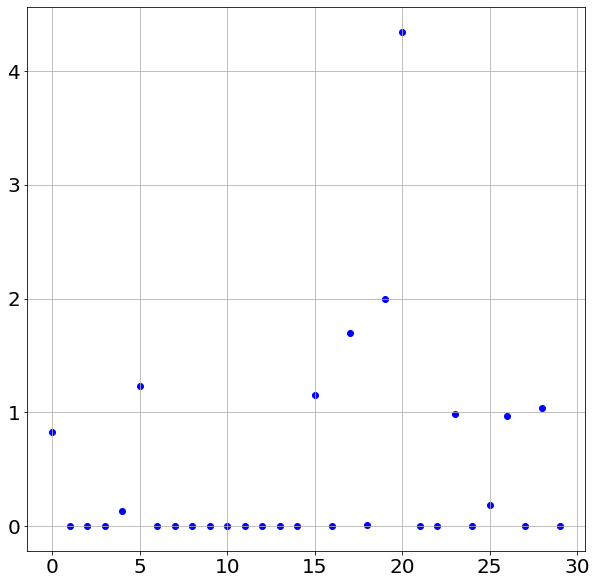

Epoch: 428
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8229,  0.0000,  0.0000],
        [ 0.0000, -0.1332,  1.2282]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[1.1550]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9876, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1890]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9699]]

Training progress...:  86%|████████▌ | 428/500 [06:37<02:19,  1.94s/it]

layer_idx = 3
index of pruned edge = 0
Pruned edges:  19
Unpruned edges:  11
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  87%|████████▋ | 435/500 [06:41<00:46,  1.41it/s]

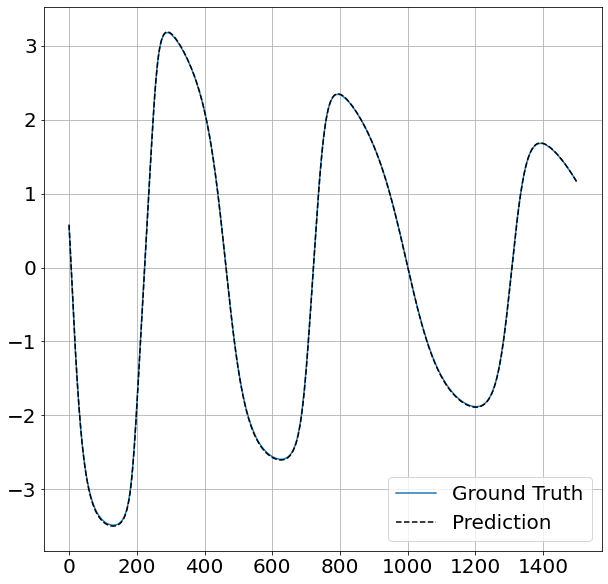

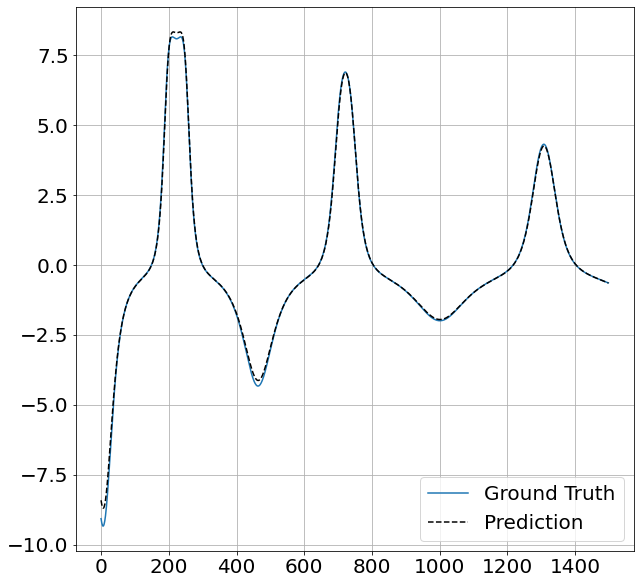

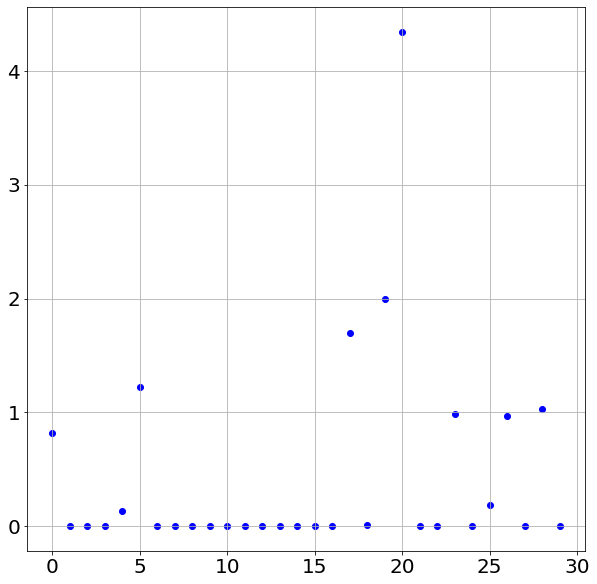

Epoch: 436
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8190,  0.0000,  0.0000],
        [ 0.0000, -0.1290,  1.2248]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 1.7001, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9872, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1885]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9695]], re

Training progress...:  87%|████████▋ | 436/500 [06:45<01:49,  1.71s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  20
Unpruned edges:  10
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  89%|████████▊ | 443/500 [06:50<00:41,  1.36it/s]

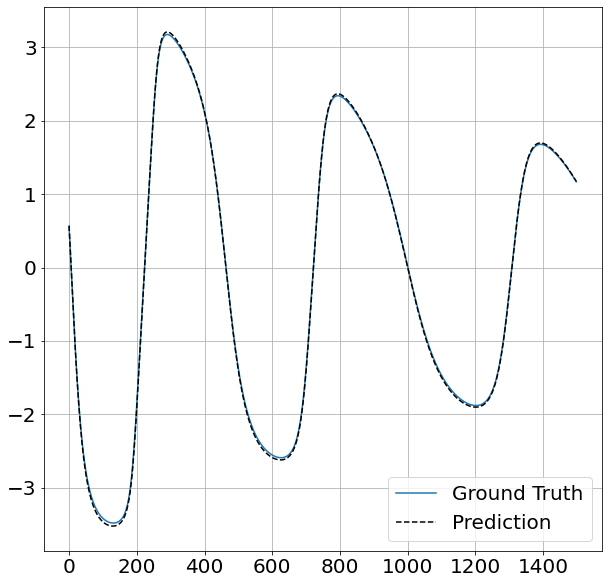

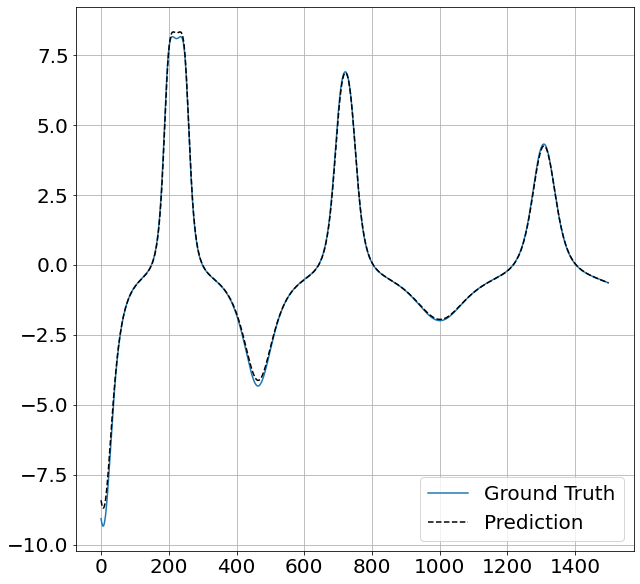

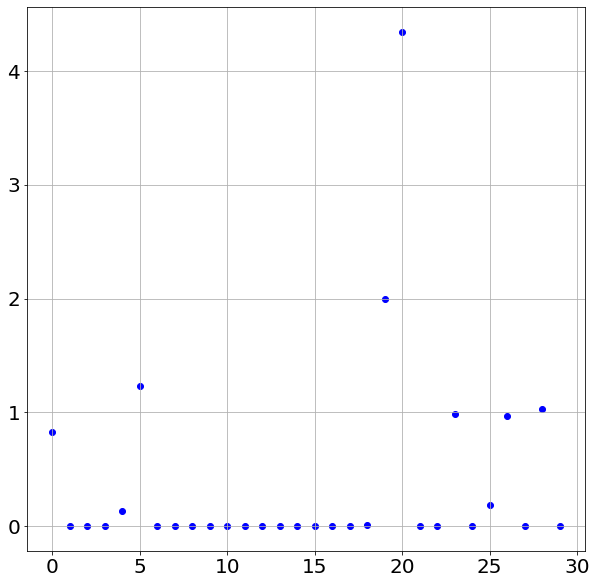

Epoch: 444
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8229,  0.0000,  0.0000],
        [ 0.0000, -0.1332,  1.2284]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000, -0.0053,  1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9873, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1887]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9695]], re

Training progress...:  89%|████████▉ | 444/500 [06:54<01:37,  1.74s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  21
Unpruned edges:  9
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  90%|█████████ | 451/500 [06:59<00:36,  1.33it/s]

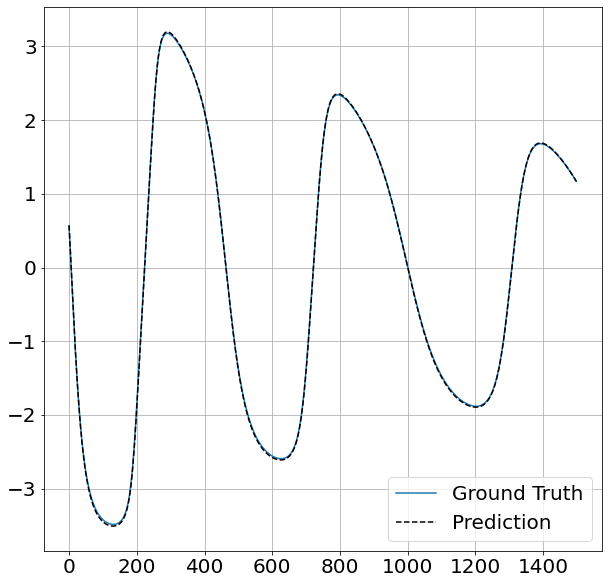

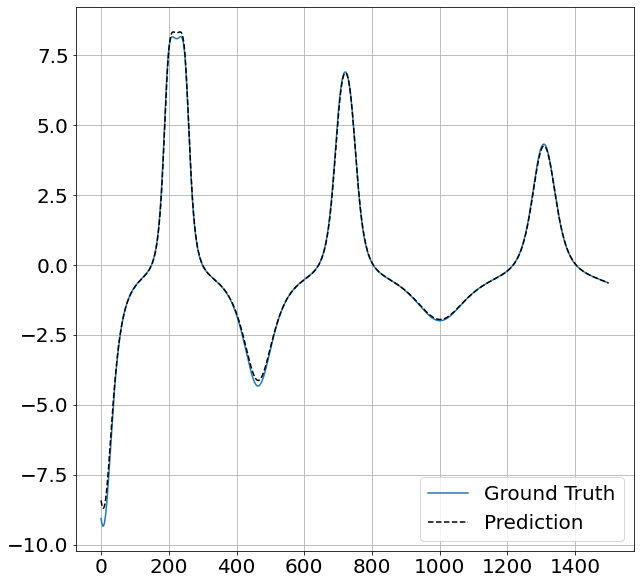

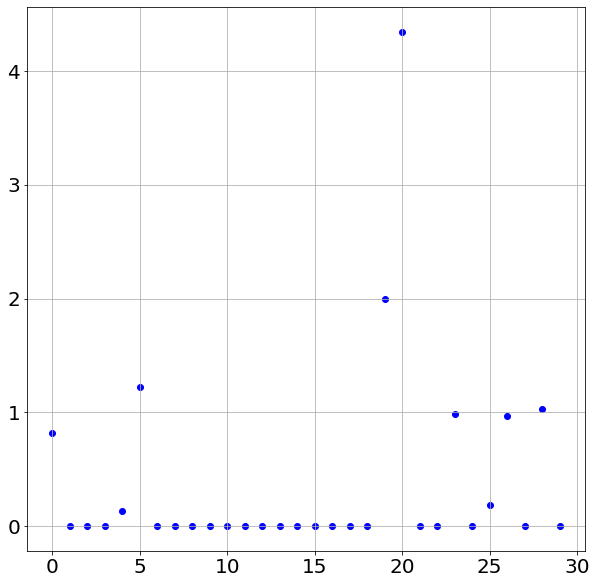

Epoch: 452
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8204,  0.0000,  0.0000],
        [ 0.0000, -0.1314,  1.2262]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 1.9975]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9873, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1885]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9695]], requi

Training progress...:  90%|█████████ | 452/500 [07:03<01:22,  1.71s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  22
Unpruned edges:  8
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  92%|█████████▏| 459/500 [07:07<00:28,  1.45it/s]

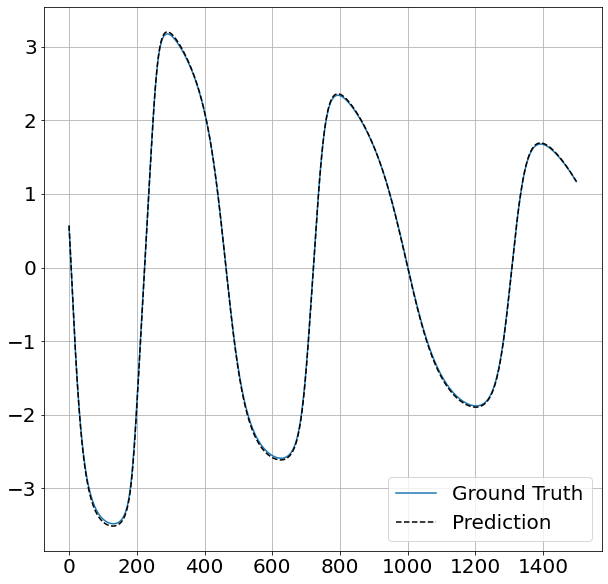

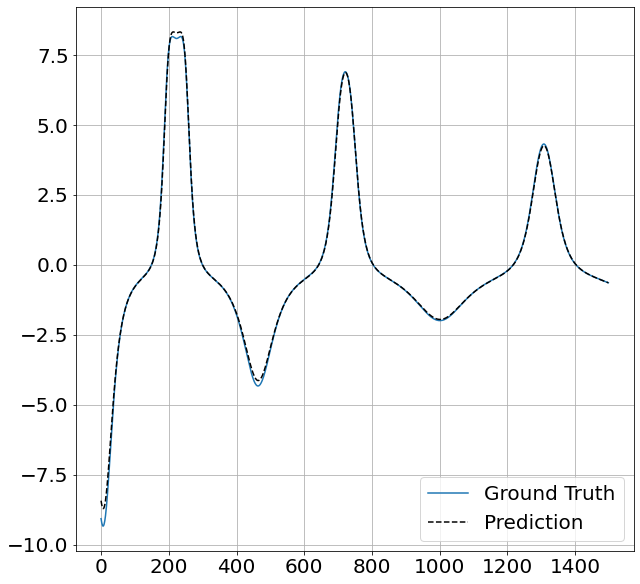

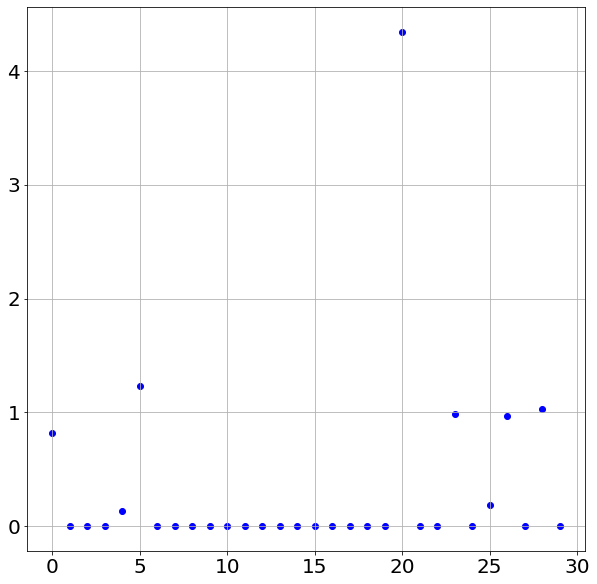

Epoch: 460
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8216,  0.0000,  0.0000],
        [ 0.0000, -0.1325,  1.2273]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[4.3443]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9875, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1889]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9700]], requires_grad=Tru

Training progress...:  92%|█████████▏| 460/500 [07:10<01:01,  1.55s/it]

layer_idx = 6
index of pruned edge = 0
Pruned edges:  23
Unpruned edges:  7
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  93%|█████████▎| 467/500 [07:15<00:22,  1.45it/s]

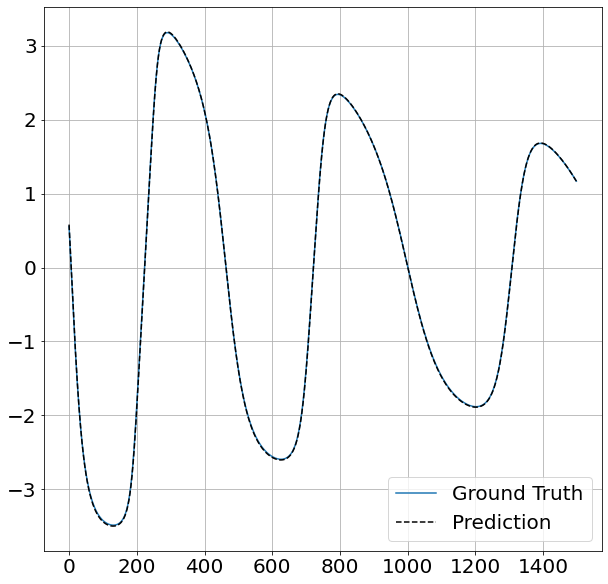

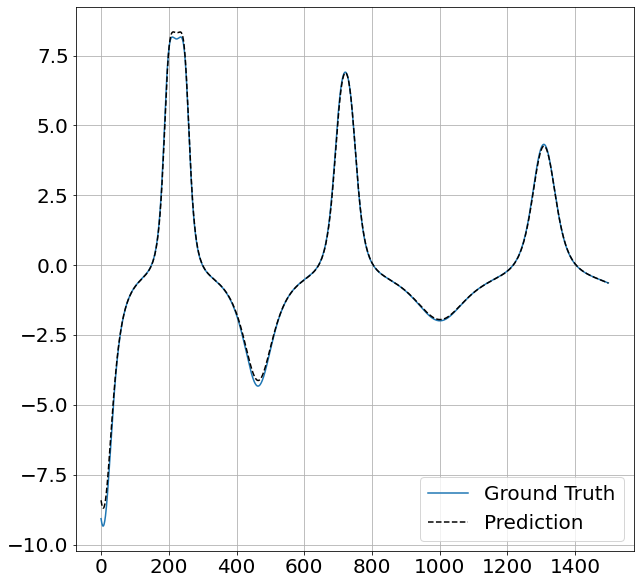

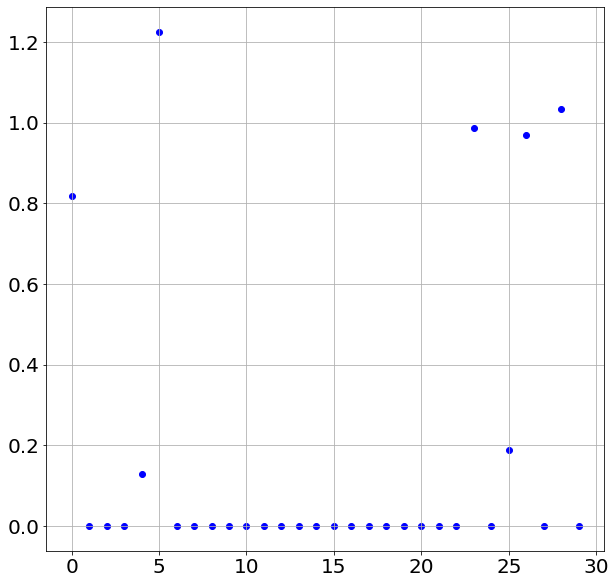

Epoch: 468
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.8189,  0.0000,  0.0000],
        [ 0.0000, -0.1290,  1.2251]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9872, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1883]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9696]], requires_grad=True)
L

Training progress...:  94%|█████████▎| 468/500 [07:18<00:45,  1.42s/it]

layer_idx = 0
index of pruned edge = 1
Pruned edges:  24
Unpruned edges:  6
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  95%|█████████▌| 475/500 [07:23<00:19,  1.26it/s]

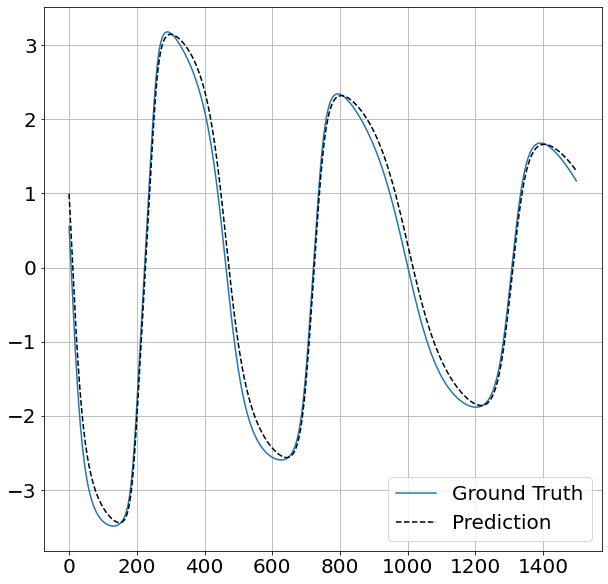

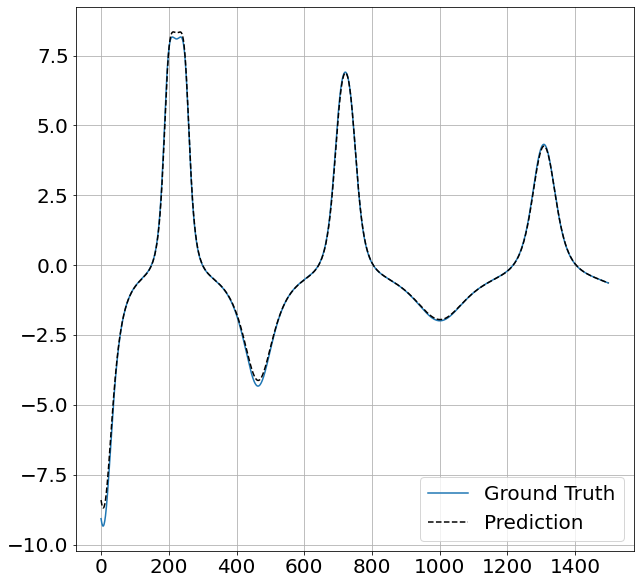

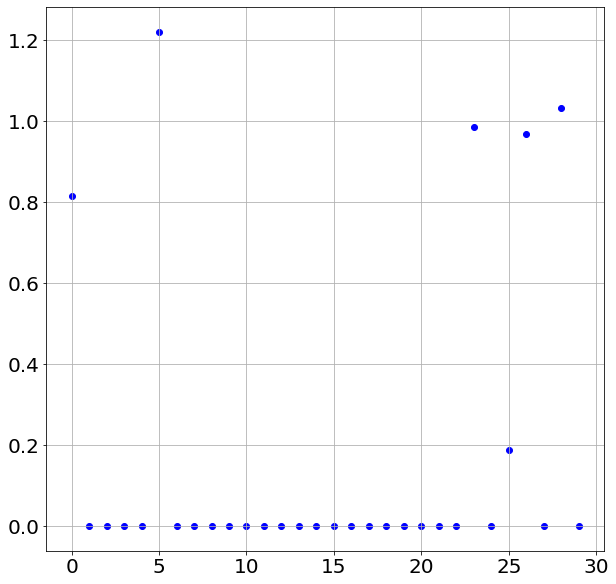

Epoch: 476
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[0.8152, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.2210]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0.0000, 0.9870, 0.0000]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1885]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9698]], requires_grad=True)
Layer: 

Training progress...:  95%|█████████▌| 476/500 [07:26<00:35,  1.48s/it]

layer_idx = 8
index of pruned edge = 0
Pruned edges:  25
Unpruned edges:  5
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  97%|█████████▋| 483/500 [07:30<00:11,  1.49it/s]

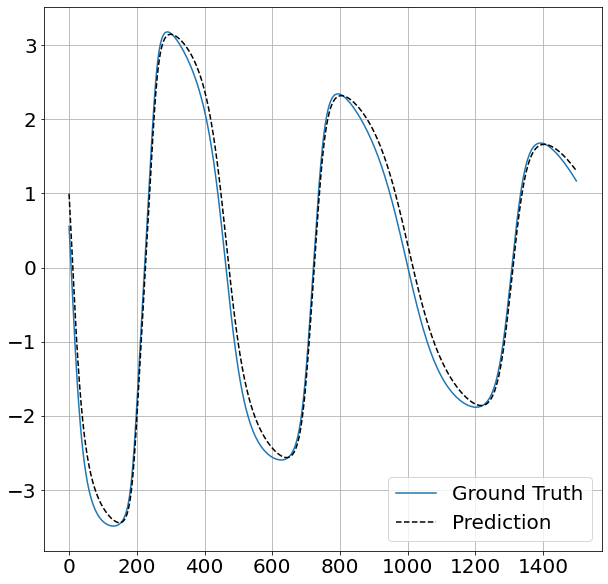

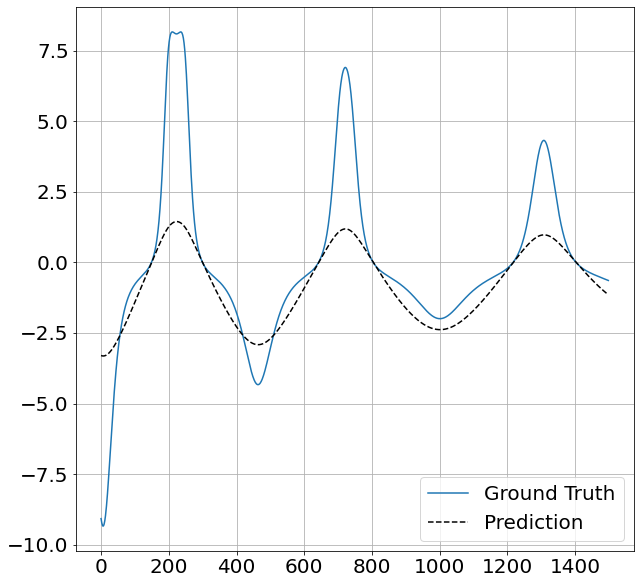

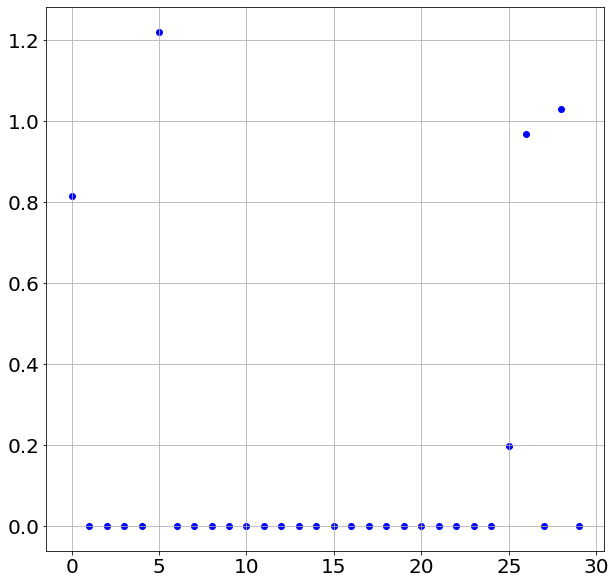

Epoch: 484
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[0.8154, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.2207]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.1990]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9674]], requires_grad=True)
Layer: 11
Weights: 

Training progress...:  97%|█████████▋| 484/500 [07:33<00:21,  1.32s/it]

layer_idx = 9
index of pruned edge = 0
Pruned edges:  26
Unpruned edges:  4
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  98%|█████████▊| 491/500 [07:38<00:06,  1.41it/s]

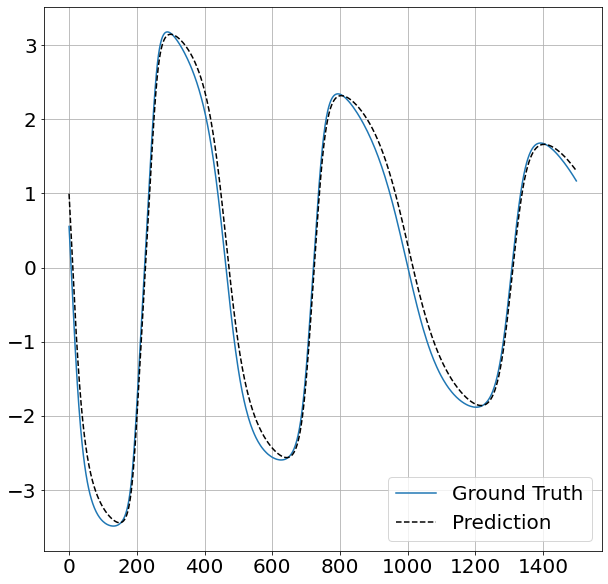

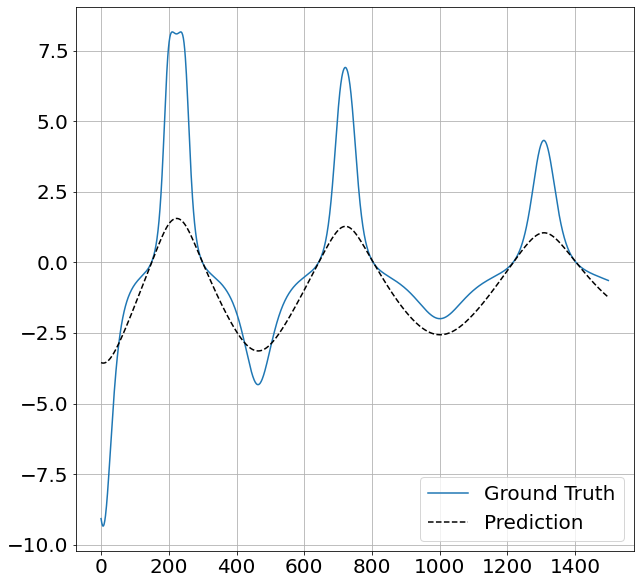

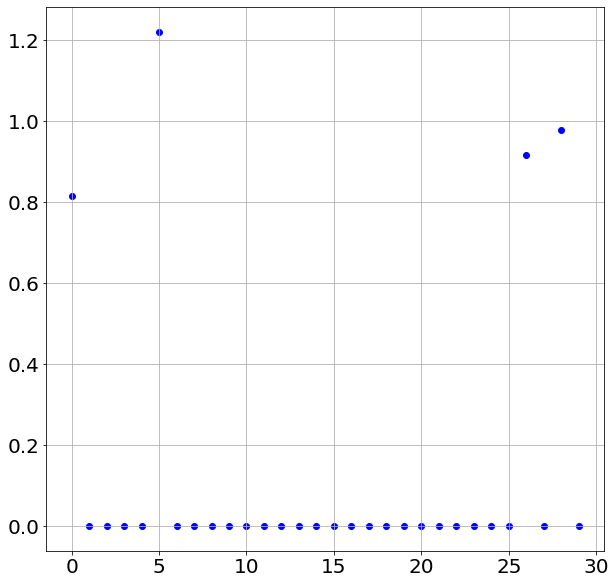

Epoch: 492
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[0.8156, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.2205]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.9157]], requires_grad=True)
Layer: 11
Weights: Para

Training progress...:  98%|█████████▊| 492/500 [07:40<00:09,  1.22s/it]

layer_idx = 10
index of pruned edge = 0
Pruned edges:  27
Unpruned edges:  3
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...: 100%|█████████▉| 499/500 [07:45<00:00,  1.54it/s]

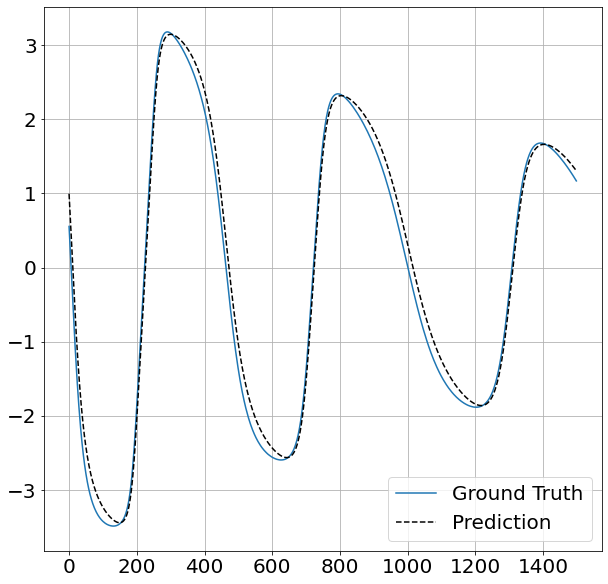

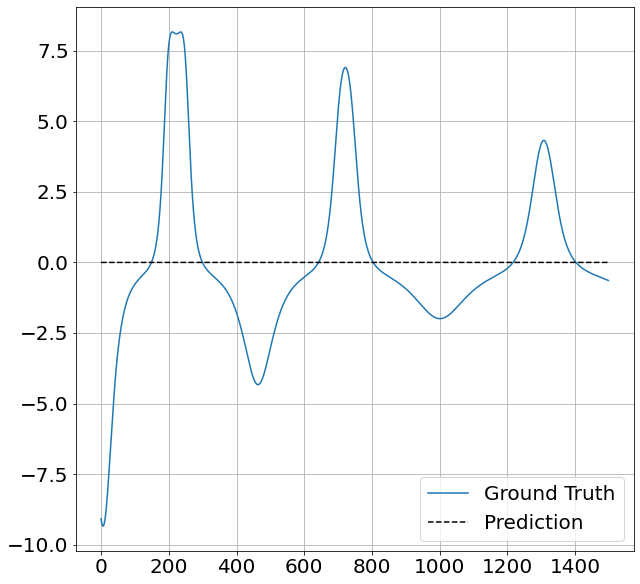

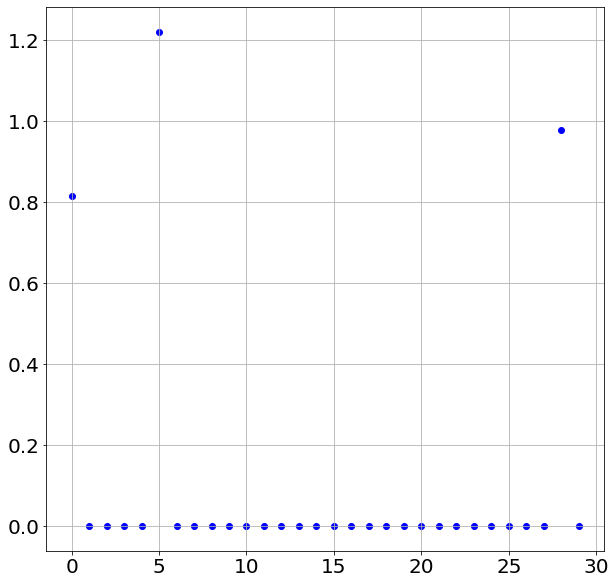

Epoch: 500
 
 
WEIGHTS:
Linear Layers:
Layer: 0
Weights: Parameter containing:
tensor([[0.8158, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.2202]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0.],
        [0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 6
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 7
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 8
Weights: Parameter containing:
tensor([[0., 0., 0.]], requires_grad=True)
Layer: 9
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 10
Weights: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 11
Weights: Paramete

Training progress...: 100%|██████████| 500/500 [07:48<00:00,  1.07it/s]

layer_idx = 11
index of pruned edge = 0
Pruned edges:  28
Unpruned edges:  2
Training mode: 0
----------------------------------------------
----------------------------------------------


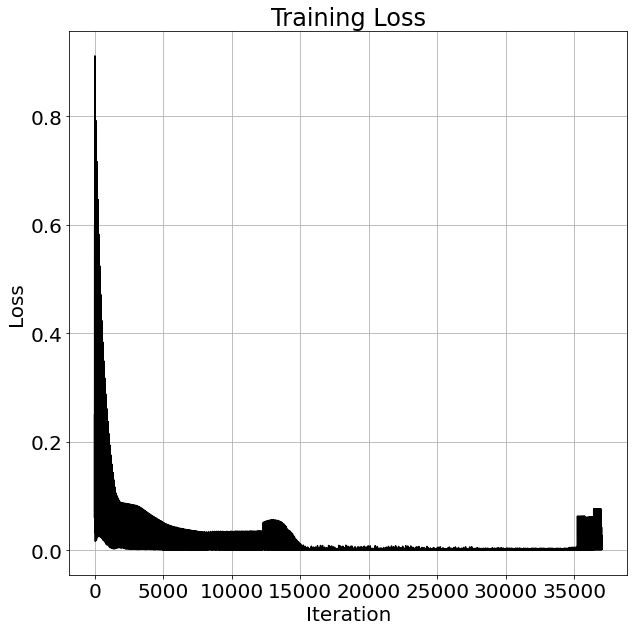

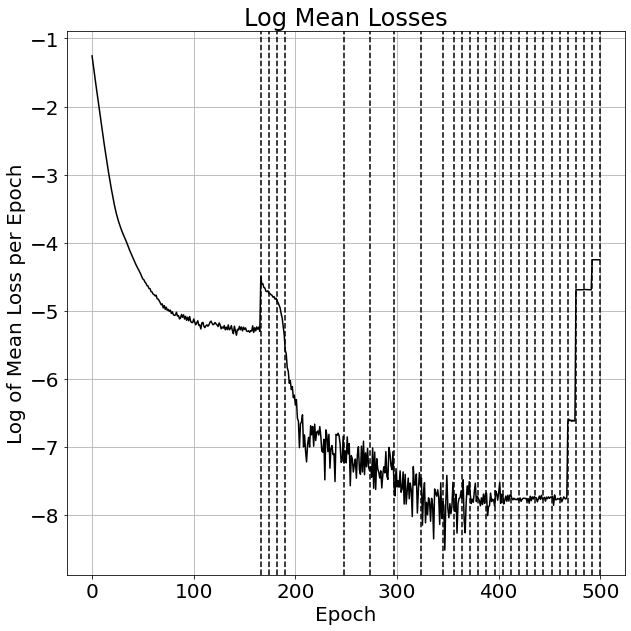

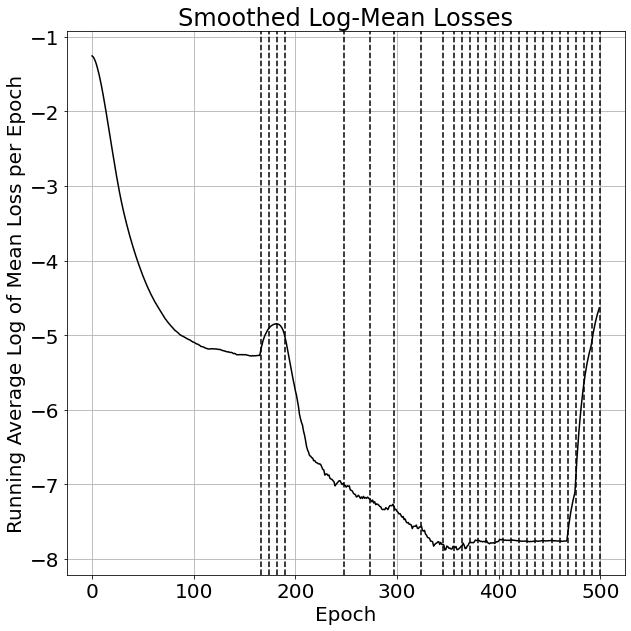

In [ ]:
# Train the model on the 2D system

# rand_seed = np.random.randint(low=1,high=10000)
# rand_seed = 3024, 9654
rand_seed = 9654
print("rand seed =", rand_seed)
torch.manual_seed(rand_seed)

args.training_mode = 0 # Training mode (0 for one-step, 1 for Neural ODE)
args.batch_mode = 1 # Batch mode (0 for random, 1 for full trajectory)

num_dim = len(y0.T) # Number of dimensions of state space

num_in = num_dim+1 # Number of in dimensions
num_out = num_in # Number of out dimensions
lr = 2e-3 # Learning rate
w1 = 2 # Size of hidden layers
max_epochs = 500 # Maximum number of training epochs
n_epochs_stop = 8

# model = HLM_Net_2D(num_in, num_out, w1).to(args.device) # 2D AC Network
model = HLMSD_Net_2D(num_in, num_out, w1).to(args.device) # 2D AC Network

# loss = nn.MSELoss(reduction='mean') # Mean squared error loss
# loss = nn.HuberLoss(reduction='mean') # Mean squared error loss
loss = nn.L1Loss() # L1 loss
opt = torch.optim.Adam(model.parameters(), lr=lr) # Optimizer

# Train model:
losses, mean_losses, smoothed_log_mean_losses, prune_epochs = f_train_model(y_true=y_true,y_valid=y_valid,t=t,model=model,loss=loss,opt=opt,w=w1,args=args,max_epochs=max_epochs,lr=lr,n_epochs_stop=n_epochs_stop)

# Plots:
f_plot(losses) # Plot loss per iteration
plt.show()

f_plot(np.log(mean_losses),xlabel='Epoch',ylabel='Log of Mean Loss per Epoch',title='Log Mean Losses') # Plot log-mean loss per epoch
for x_e in prune_epochs:
  plt.axvline(x = x_e,color='k',ls='--',label='axvline - full height')
plt.show()

f_plot(smoothed_log_mean_losses,xlabel='Epoch',ylabel='Running Average Log of Mean Loss per Epoch',title='Smoothed Log-Mean Losses') # Plot smoothed log-mean loss per epoch
for x_e in prune_epochs:
  plt.axvline(x = x_e,color='k',ls='--',label='axvline - full height')
plt.show()

# [-0.1*y[0] + y[1], -2*y[0] - 0.1*y[1] - 0.5*y[0]*y[1] - 0.025*y[1]**2]

### Lorenz System

In [ ]:
class Lorenz(nn.Module):
  """
  Lorenz System
  Given current position, outputs current velocity
  """

  def __init__(self,params):
    super().__init__()
    self.params = params

  def forward(self, t, X):
    # System parameters:
    sigma = self.params[0]
    beta = self.params[1]
    rho = self.params[2]
    A = self.params[3]
    omega = self.params[4]

    # u = 0
    # u = A*np.sin(omega*t)
    u = A*torch.sin(omega*X[0][0]) # Control
    # beta += A*np.sin(omega*t)

    # return torch.tensor([sigma*(X[1]-X[0]), X[0]*(rho-X[2])-X[1], X[0]*X[1]-beta*X[2]])
    return torch.tensor([sigma*(X[0][1]-X[0][0]), X[0][0]*(rho-X[0][2])-X[0][1], X[0][0]*X[0][1]-beta*X[0][2]]) # Equations of motion

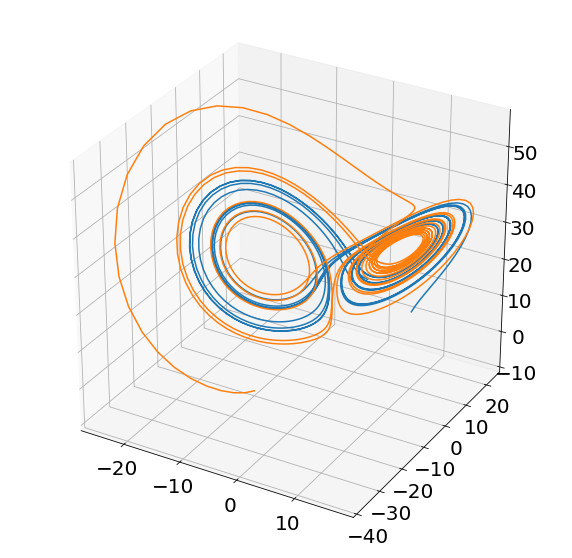

In [ ]:
# System parameters
sigma = 10.
beta = 8/3
rho = 28.
A = 0.
omega = 1.
params = np.array([sigma,beta,rho,A,omega])

# Initial conditions
t0 = 0 # Start time
tf = 15 # End time
x0 = torch.tensor([[10.,10.,10.]]).to(args.device) # Initial position
x0_2 = torch.tensor([[-10.,-10.,-10.]]).to(args.device) # Initial position
t = torch.linspace(t0, tf, args.data_size).to(args.device) # Array of timesteps

Lorenz1 = Lorenz(params).to(args.device)

with torch.no_grad():
  x_true = odeint(Lorenz1, x0, t, method='dopri5').to(args.device) # Simulate trajectory
  x_valid = odeint(Lorenz1, x0_2, t, method='dopri5').to(args.device) # Simulate trajectory

# x_true += torch.from_numpy(np.random.normal(0, 0.05, (args.data_size,1,3)))

# Plot
x_true_plot = x_true.cpu().detach().numpy().squeeze().T
x_valid_plot = x_valid.cpu().detach().numpy().squeeze().T

fig = plt.figure()
ax = plt.axes(projection ='3d')
ax.plot3D(x_true_plot[0], x_true_plot[1], x_true_plot[2])
ax.plot3D(x_valid_plot[0], x_valid_plot[1], x_valid_plot[2])
plt.xticks(fontsize = 20)
plt.yticks(fontsize = 20)
plt.grid()
plt.show()

Training progress...:  11%|█         | 108/1000 [01:13<10:06,  1.47it/s]

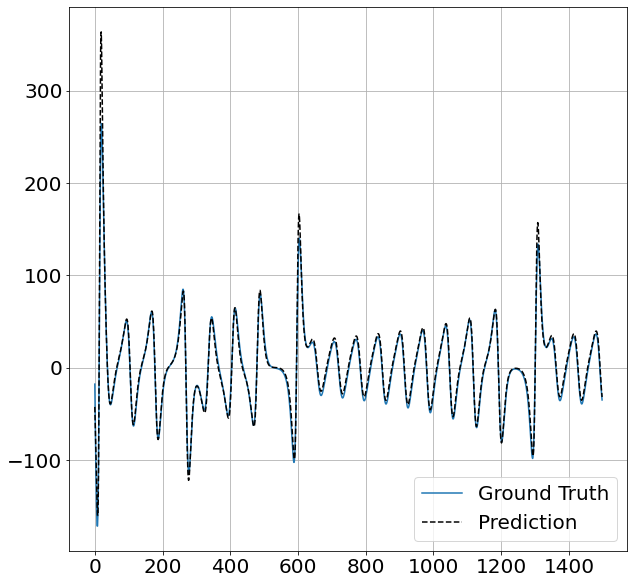

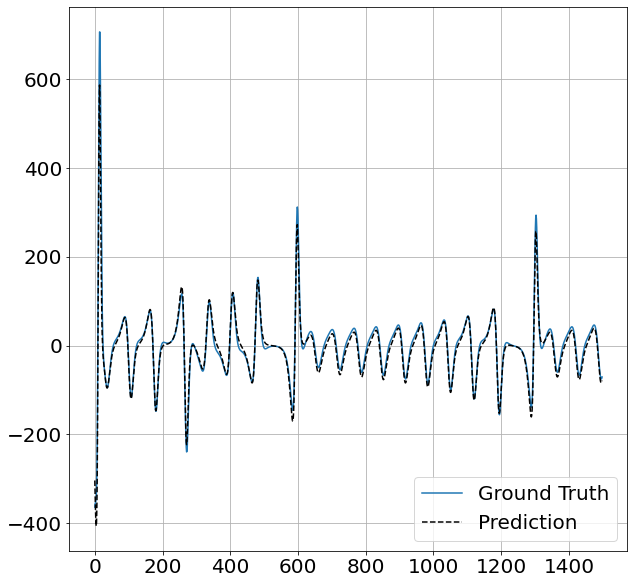

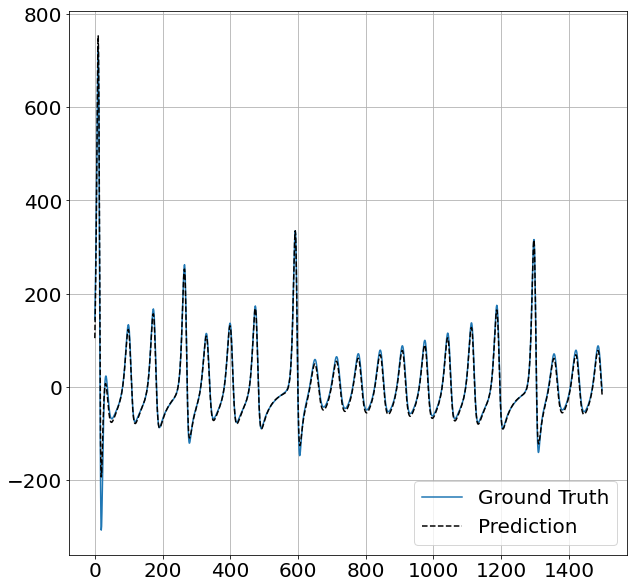

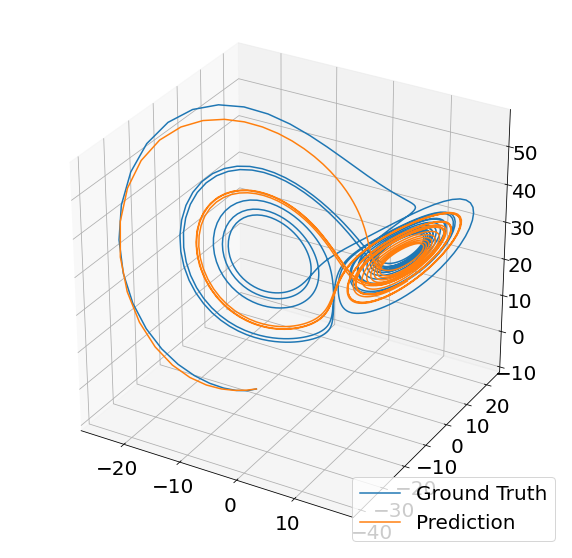

 
Epoch: 109
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.8994,  0.9223, -0.5049,  0.0068],
        [-2.6047,  0.0717, -0.0263, -0.2611]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0907,  1.5180,  0.9894, -0.0277],
        [ 4.8291, -0.0438,  0.0253, -0.3437]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.4773, -0.6360, -0.6277, -0.2512],
        [ 1.0376, -0.4213, -0.3604,  0.1601]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.3689,  1.0119,  3.7338, -0.3157]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.4039,  4.3596,  5.0305,  0.0618]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[-4.1074, -0.0906,  0.2680, -1.0987]], requires_grad=True)


Training progress...:  11%|█         | 109/1000 [01:27<1:10:29,  4.75s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  1
Unpruned edges:  35
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  16%|█▌        | 157/1000 [01:58<09:28,  1.48it/s]

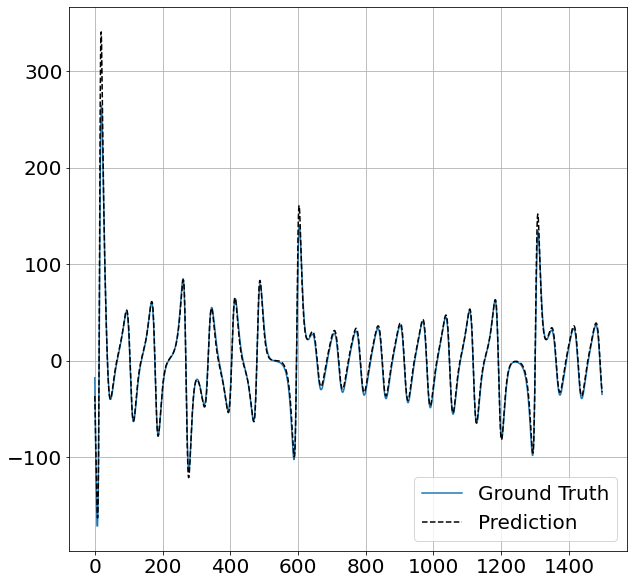

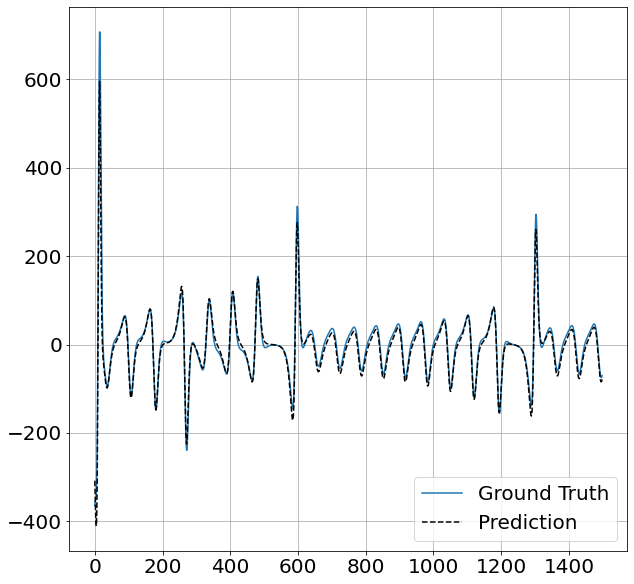

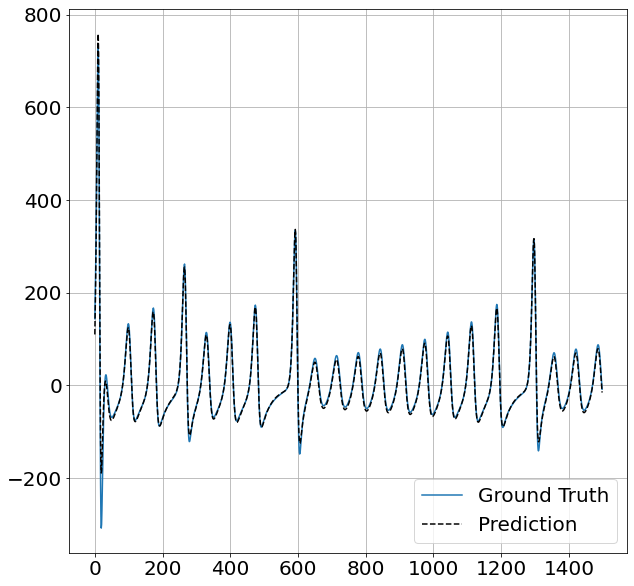

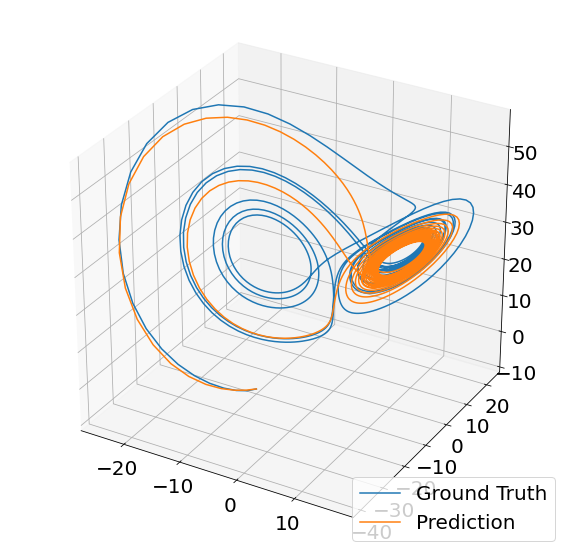

 
Epoch: 158
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-8.4734e-01,  1.0476e+00, -5.2772e-01, -2.1104e-03],
        [-3.4630e+00,  4.2969e-02, -1.1940e-02, -1.9272e-01]],
       requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.1507,  1.5562,  0.9752, -0.0225],
        [ 4.9143, -0.0330,  0.0163, -0.3454]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.8219, -0.6155, -0.6295, -0.2215],
        [ 1.2595, -0.4277, -0.3670,  0.1483]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.5443,  0.8299,  4.2181, -0.3297]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.3096,  4.7430,  4.6881,  0.0637]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000, -0.0456,  0.3176, -1.3591]], requires_grad=True)


Training progress...:  16%|█▌        | 158/1000 [02:14<1:10:53,  5.05s/it]

layer_idx = 1
index of pruned edge = 5
Pruned edges:  2
Unpruned edges:  34
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  17%|█▋        | 171/1000 [02:22<09:47,  1.41it/s]

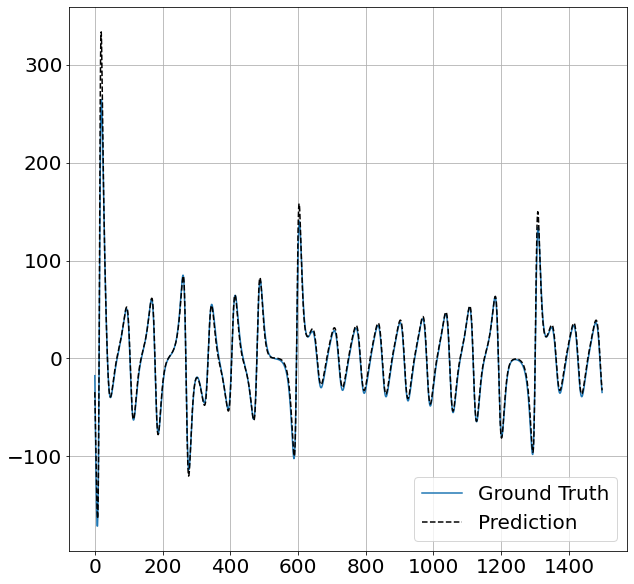

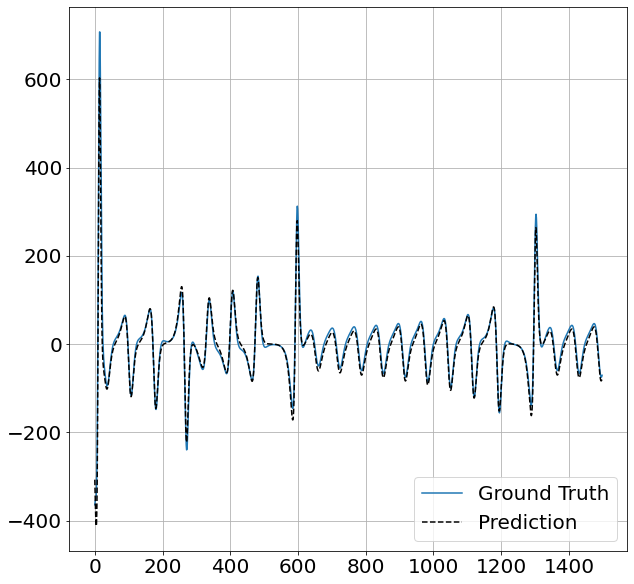

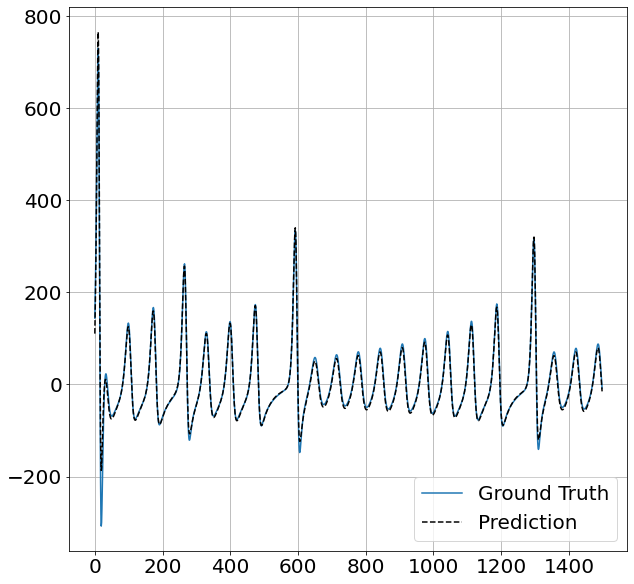

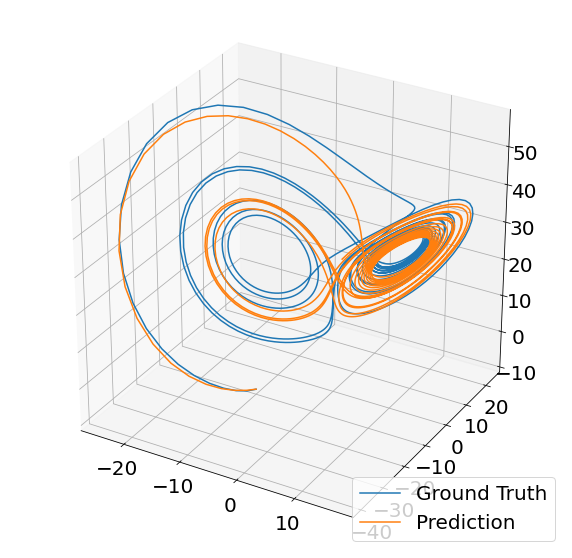

 
Epoch: 172
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.8229,  1.0872, -0.5405, -0.0057],
        [-3.6777,  0.0354, -0.0103, -0.1734]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 1.6815e-01,  1.5667e+00,  9.6382e-01, -5.8879e-04],
        [ 4.9298e+00,  0.0000e+00, -3.4703e-03, -3.4565e-01]],
       requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.8553, -0.6080, -0.6364, -0.2163],
        [ 1.2924, -0.4231, -0.3722,  0.1458]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.6011,  0.7677,  4.3240, -0.3352]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.2731,  4.8420,  4.5765,  0.0781]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000, -0.0498,  0.3189, -1.3731]], requires_grad=True)


Training progress...:  17%|█▋        | 172/1000 [02:36<1:03:47,  4.62s/it]

layer_idx = 0
index of pruned edge = 3
Pruned edges:  3
Unpruned edges:  33
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  18%|█▊        | 178/1000 [02:40<15:10,  1.11s/it]

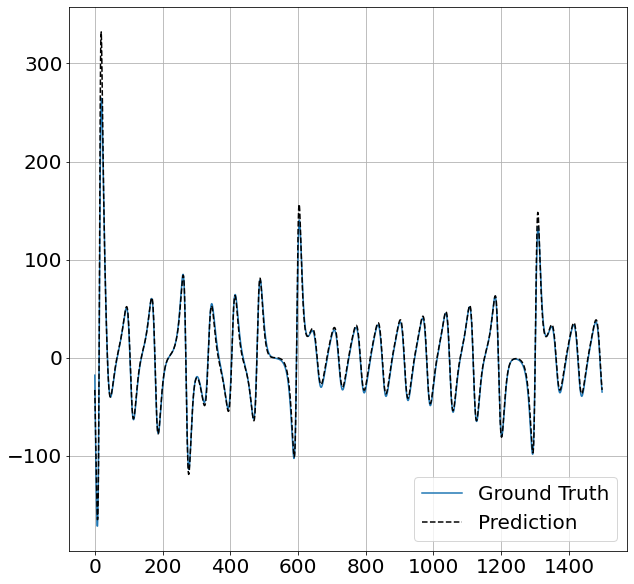

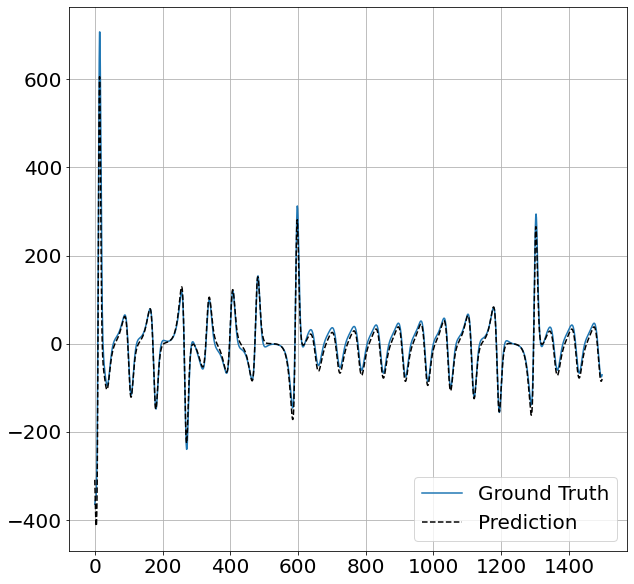

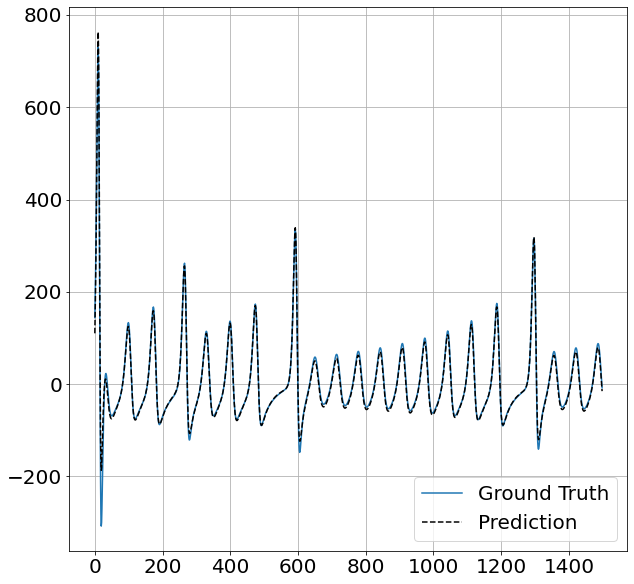

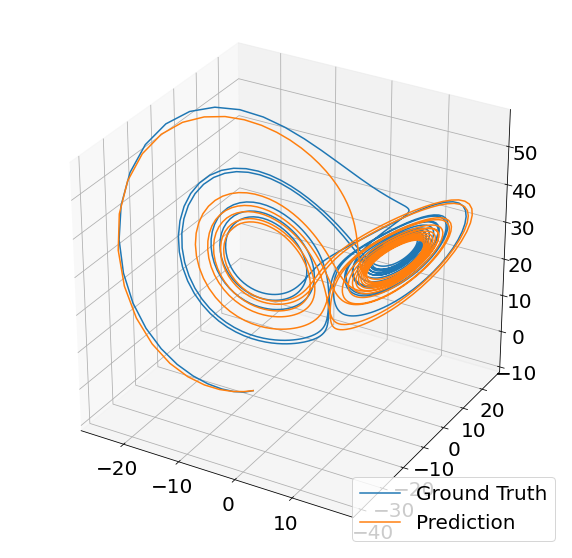

 
Epoch: 179
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.8300,  1.1065, -0.5473,  0.0000],
        [-3.7904,  0.0482, -0.0174, -0.1622]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 1.6752e-01,  1.5768e+00,  9.5929e-01,  1.0576e-03],
        [ 4.9398e+00,  0.0000e+00, -4.6712e-03, -3.4685e-01]],
       requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.8781, -0.6058, -0.6383, -0.2152],
        [ 1.3065, -0.4214, -0.3712,  0.1445]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.6088,  0.7359,  4.3791, -0.3170]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.2649,  4.8912,  4.5299,  0.0810]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000, -0.0475,  0.3245, -1.3820]], requires_grad=True)


Training progress...:  18%|█▊        | 179/1000 [02:53<1:05:38,  4.80s/it]

layer_idx = 1
index of pruned edge = 5
Pruned edges:  4
Unpruned edges:  32
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  24%|██▎       | 237/1000 [03:31<08:24,  1.51it/s]

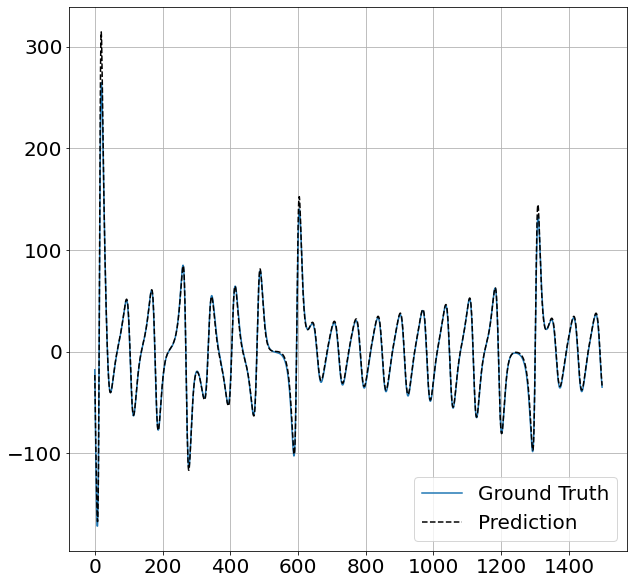

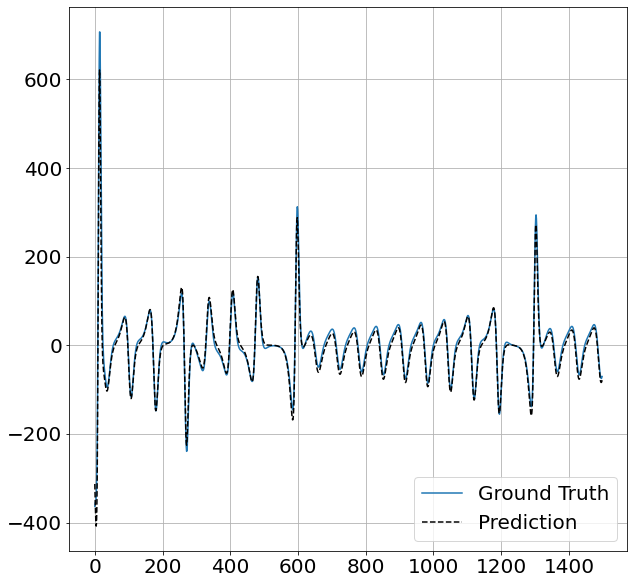

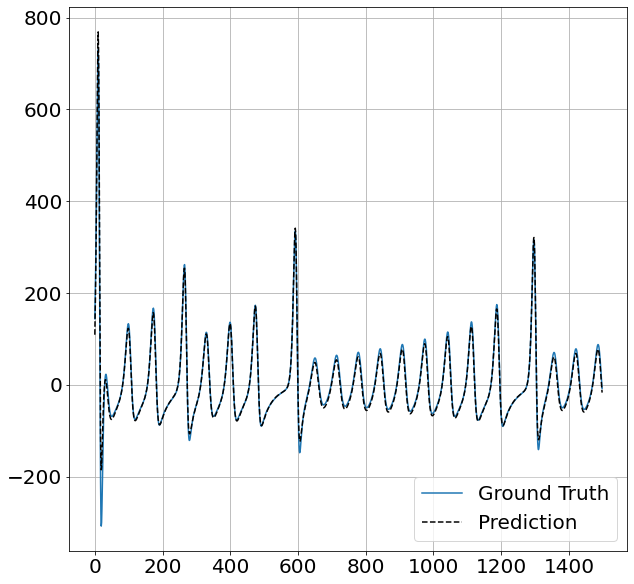

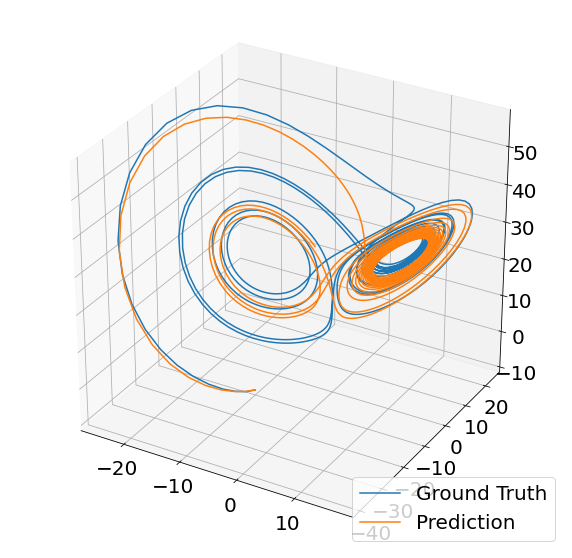

 
Epoch: 238
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.7407,  1.2808, -0.5938,  0.0000],
        [-4.5972,  0.0381, -0.0157, -0.1000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 1.3316e-01,  1.6610e+00,  9.3345e-01,  3.6689e-06],
        [ 5.0160e+00,  0.0000e+00,  0.0000e+00, -3.4451e-01]],
       requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.9771, -0.5753, -0.6390, -0.2016],
        [ 1.4174, -0.4211, -0.3837,  0.1438]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.8506,  0.5272,  4.8251, -0.2373]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.3208,  5.2810,  4.0721,  0.0732]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000, -0.0705,  0.3327, -1.3990]], requires_grad=True)


Training progress...:  24%|██▍       | 238/1000 [03:45<57:19,  4.51s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  5
Unpruned edges:  31
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  26%|██▌       | 257/1000 [03:57<08:00,  1.55it/s]

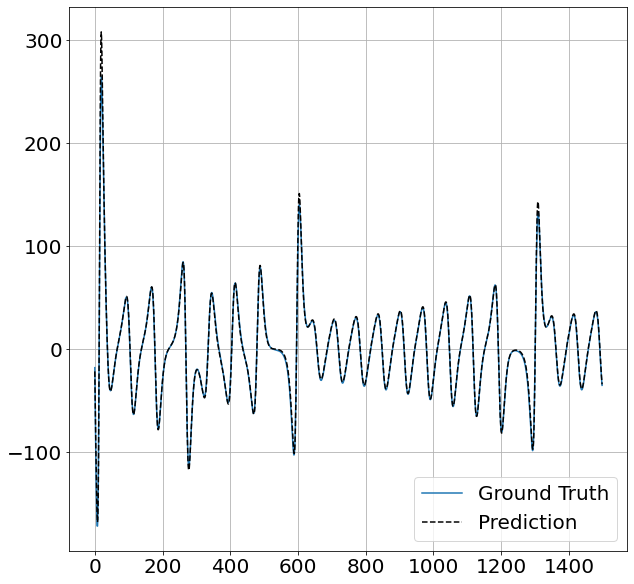

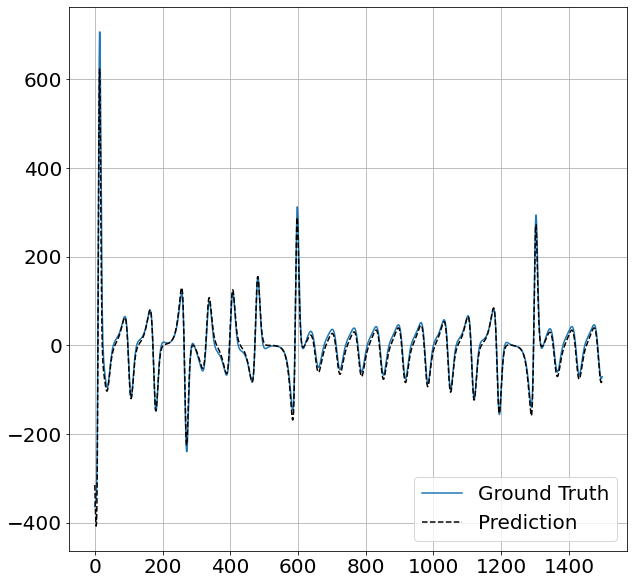

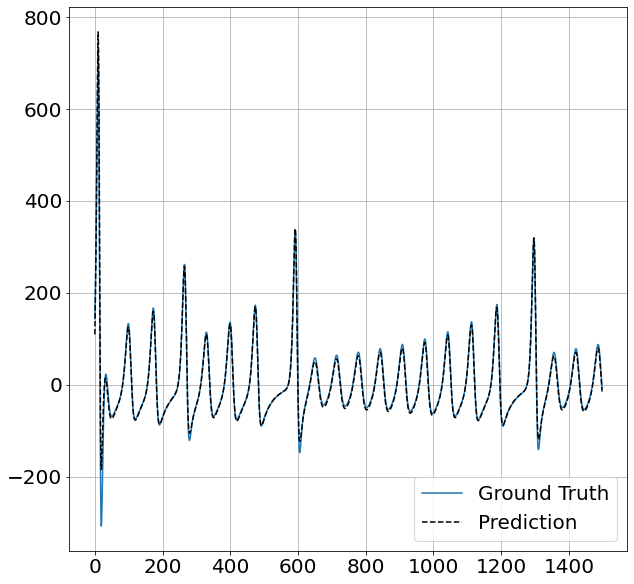

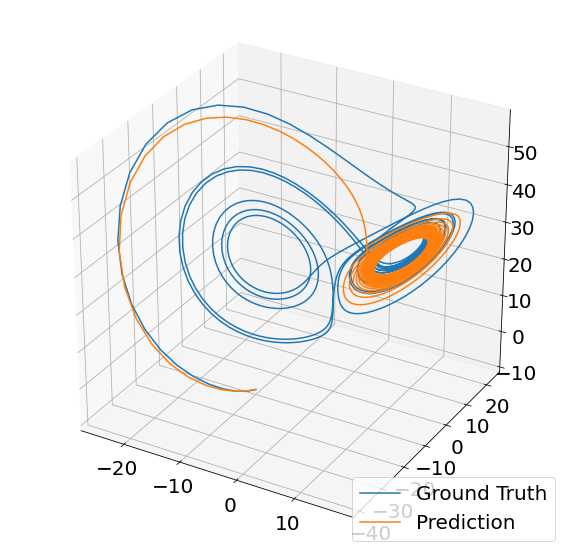

 
Epoch: 258
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.6659,  1.3349, -0.6027,  0.0000],
        [-4.7653,  0.0288, -0.0129, -0.0866]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 1.2323e-01,  1.6917e+00,  9.1984e-01, -5.3857e-04],
        [ 5.0429e+00,  0.0000e+00,  0.0000e+00, -3.4342e-01]],
       requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.9846, -0.5770, -0.6397, -0.2026],
        [ 1.4599, -0.4175, -0.3868,  0.1406]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.9940,  0.4927,  4.9739, -0.1940]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.3338,  5.4072,  3.9165,  0.0728]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3204, -1.3928]], requires_grad=True)


Training progress...:  26%|██▌       | 258/1000 [04:09<49:54,  4.04s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  6
Unpruned edges:  30
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  27%|██▋       | 268/1000 [04:16<08:52,  1.37it/s]

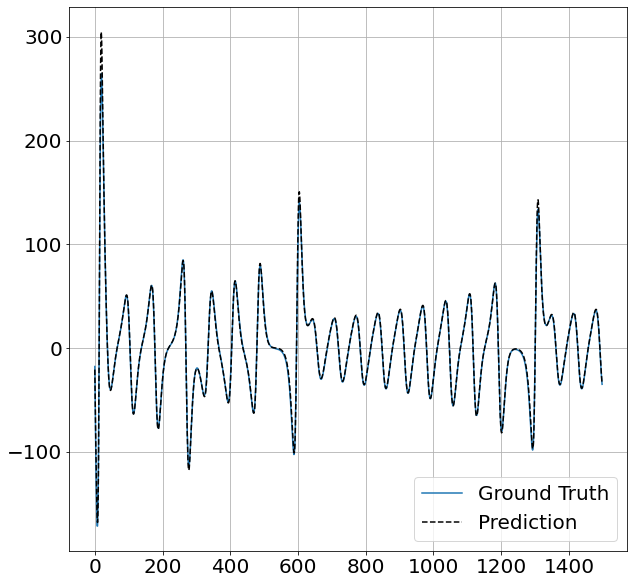

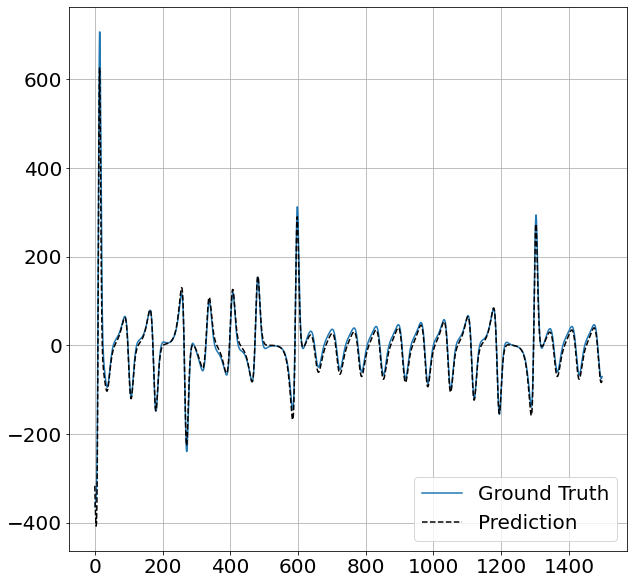

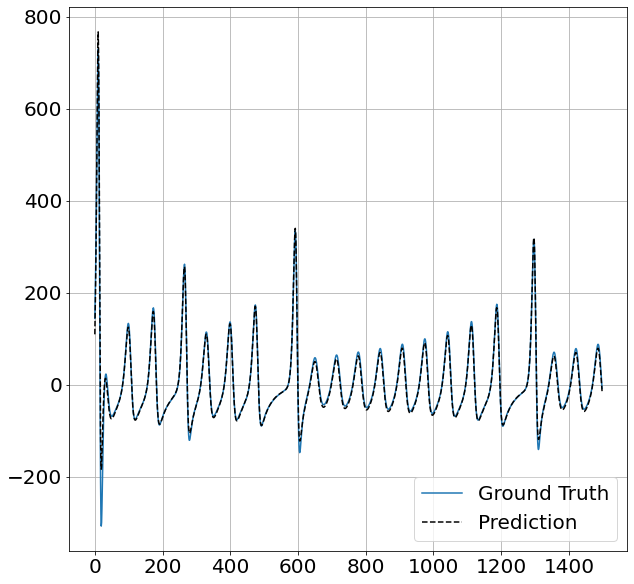

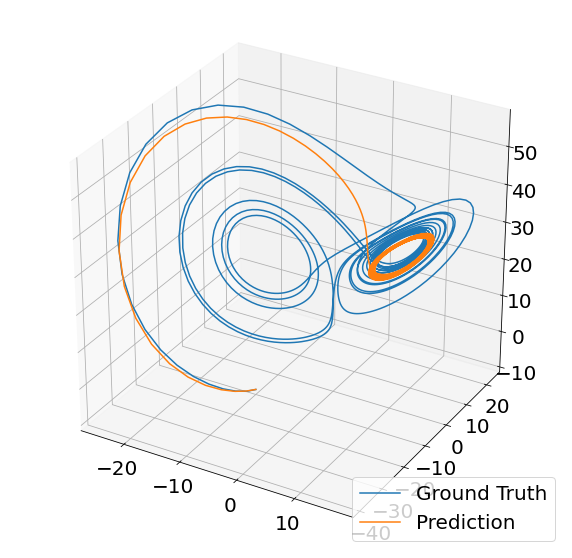

 
Epoch: 269
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.6190,  1.3621, -0.6052,  0.0000],
        [-4.8391,  0.0237, -0.0106, -0.0807]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000e+00,  1.7086e+00,  9.1316e-01,  2.2960e-03],
        [ 5.0573e+00,  0.0000e+00,  0.0000e+00, -3.4334e-01]],
       requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-1.9965, -0.5779, -0.6401, -0.2025],
        [ 1.4758, -0.4159, -0.3859,  0.1403]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-1.0763,  0.4809,  5.0546, -0.1697]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[-0.3383,  5.4752,  3.8301,  0.0717]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3213, -1.3884]], requires_grad=True)


Training progress...:  27%|██▋       | 269/1000 [04:27<48:13,  3.96s/it]

layer_idx = 4
index of pruned edge = 0
Pruned edges:  7
Unpruned edges:  29
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  30%|██▉       | 295/1000 [04:43<07:12,  1.63it/s]

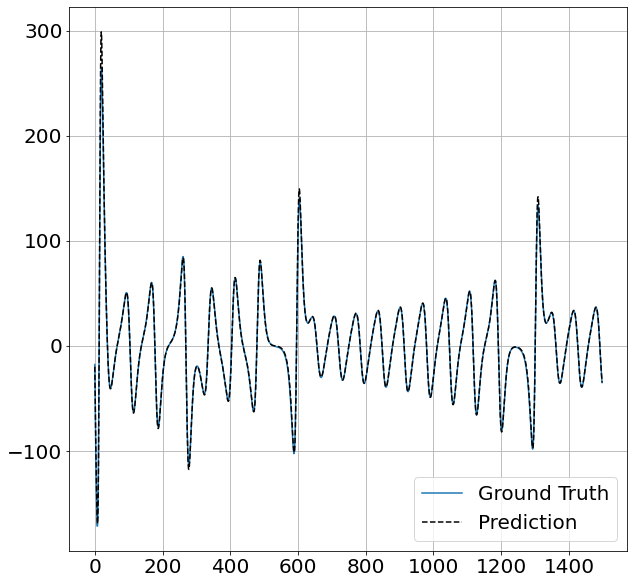

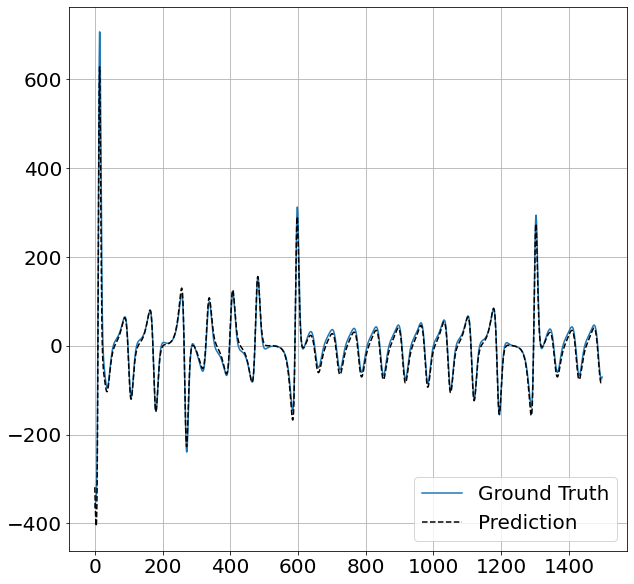

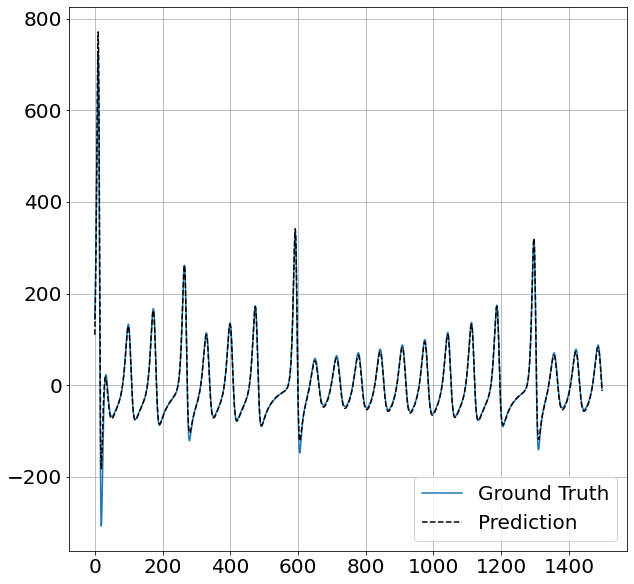

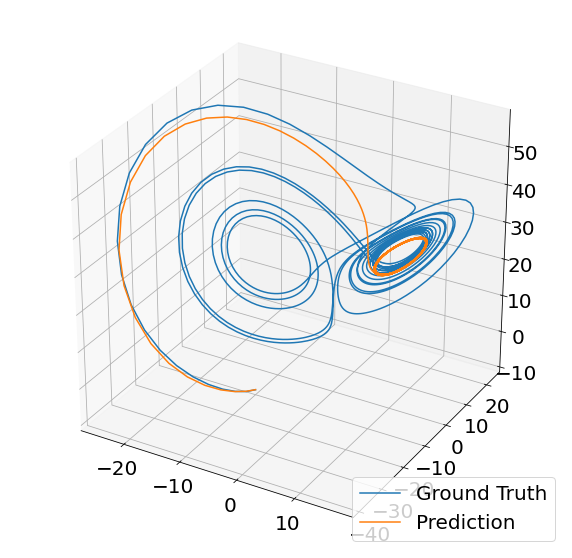

 
Epoch: 296
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.5023,  1.4208, -0.6043,  0.0000],
        [-4.9841,  0.0158, -0.0106, -0.0682]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000e+00,  1.7533e+00,  8.9222e-01,  1.4274e-03],
        [ 5.0957e+00,  0.0000e+00,  0.0000e+00, -3.4207e-01]],
       requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0266, -0.5732, -0.6389, -0.2009],
        [ 1.5067, -0.4189, -0.3921,  0.1388]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-1.2647,  0.4768,  5.2592, -0.1137]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 5.6407, 3.6227, 0.0500]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3305, -1.3733]], requires_grad=True)


Training progress...:  30%|██▉       | 296/1000 [04:55<46:38,  3.98s/it]

layer_idx = 1
index of pruned edge = 2
Pruned edges:  8
Unpruned edges:  28
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  30%|███       | 302/1000 [04:59<11:44,  1.01s/it]

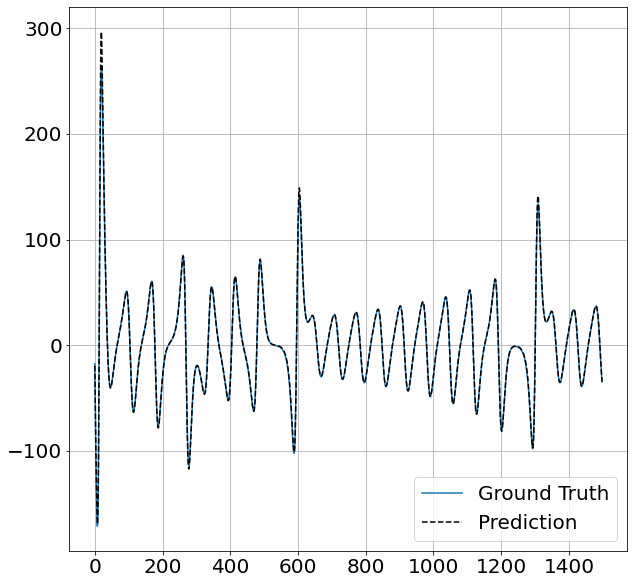

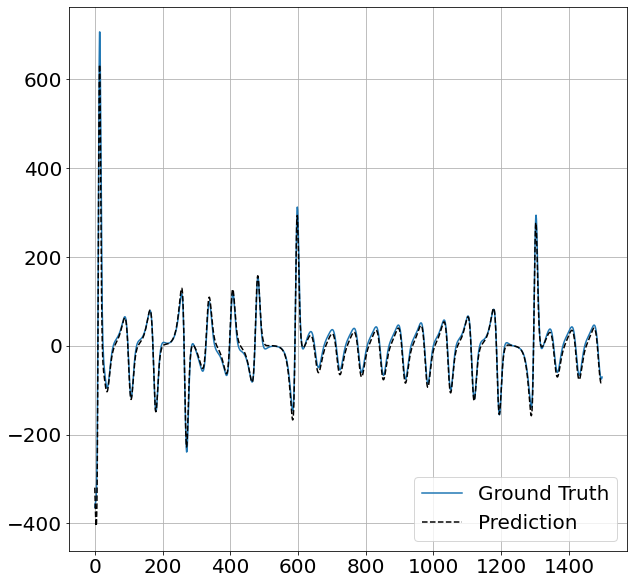

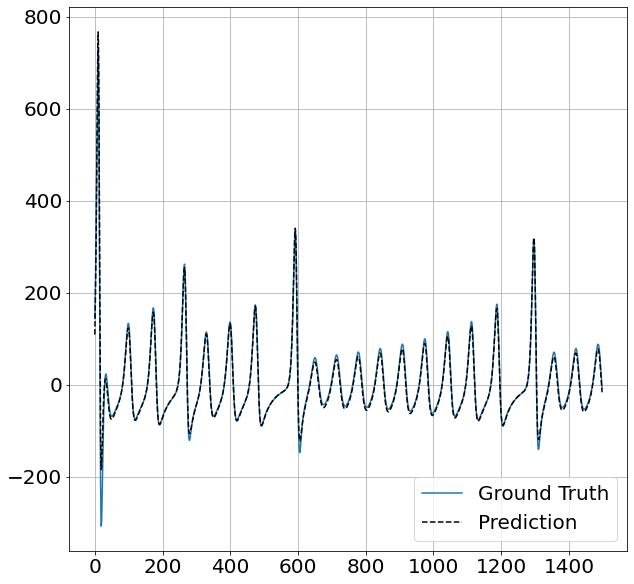

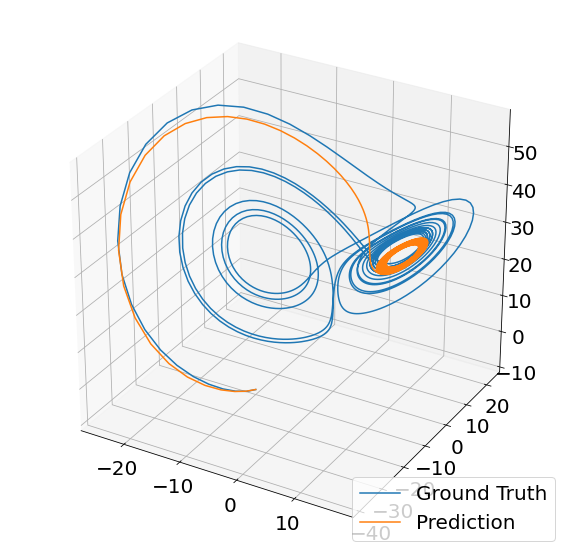

 
Epoch: 303
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.4755,  1.4322, -0.6029,  0.0000],
        [-5.0121,  0.0139, -0.0089, -0.0656]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.7699,  0.8837,  0.0000],
        [ 5.1090,  0.0000,  0.0000, -0.3425]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0328, -0.5737, -0.6392, -0.2016],
        [ 1.5198, -0.4151, -0.3873,  0.1419]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-1.3067,  0.4804,  5.3099, -0.1002]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 5.6886, 3.5737, 0.0541]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3272, -1.3727]], requires_grad=True)


Training progress...:  30%|███       | 303/1000 [05:11<49:20,  4.25s/it]

layer_idx = 0
index of pruned edge = 4
Pruned edges:  9
Unpruned edges:  27
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  31%|███       | 309/1000 [05:15<12:16,  1.07s/it]

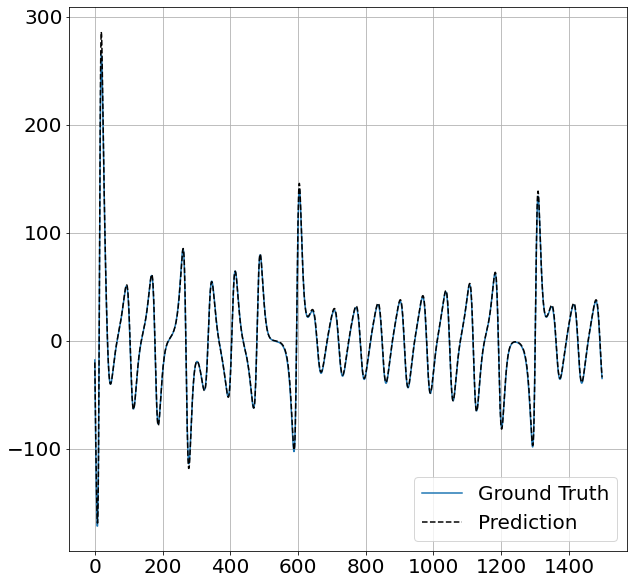

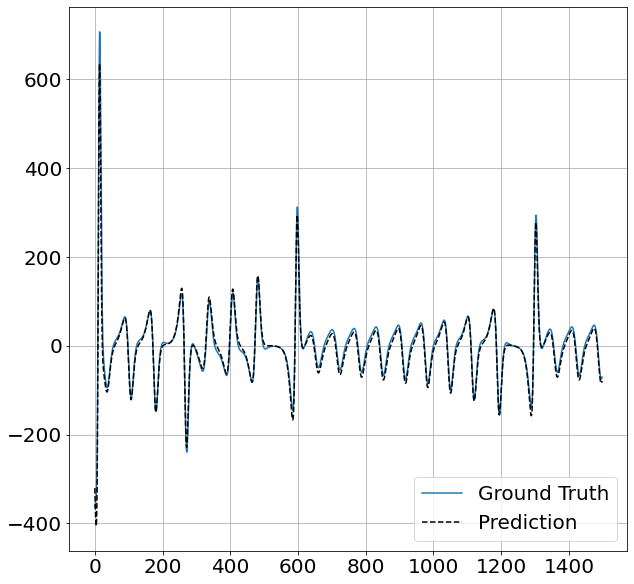

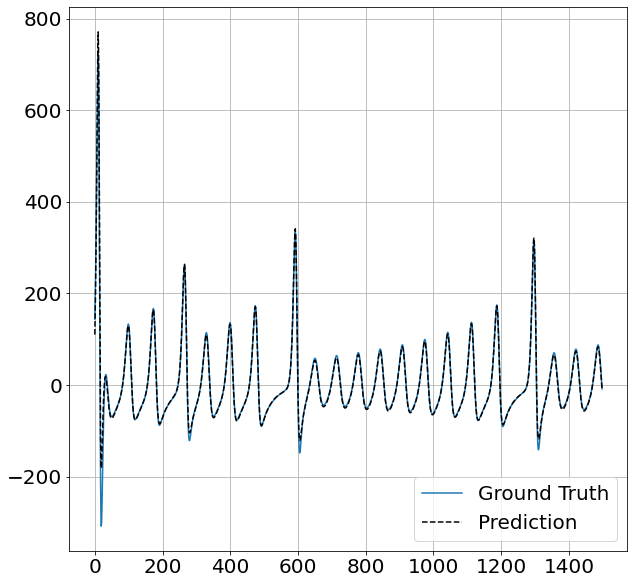

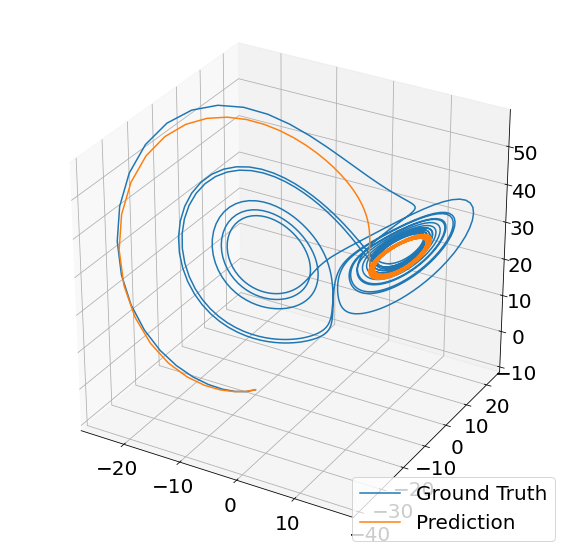

 
Epoch: 310
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-4.1666e-01,  1.4431e+00, -6.0200e-01,  0.0000e+00],
        [-5.0333e+00,  0.0000e+00,  3.9842e-03, -6.2689e-02]],
       requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.7825,  0.8774,  0.0000],
        [ 5.1207,  0.0000,  0.0000, -0.3427]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0474, -0.5777, -0.6398, -0.2018],
        [ 1.5192, -0.4183, -0.3907,  0.1371]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-1.3936,  0.4847,  5.3590, -0.0594]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 5.7363, 3.5197, 0.0532]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3407, -1.3652]], requires_grad=True)


Training progress...:  31%|███       | 310/1000 [05:27<51:12,  4.45s/it]

layer_idx = 0
index of pruned edge = 4
Pruned edges:  10
Unpruned edges:  26
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  32%|███▏      | 316/1000 [05:31<13:02,  1.14s/it]

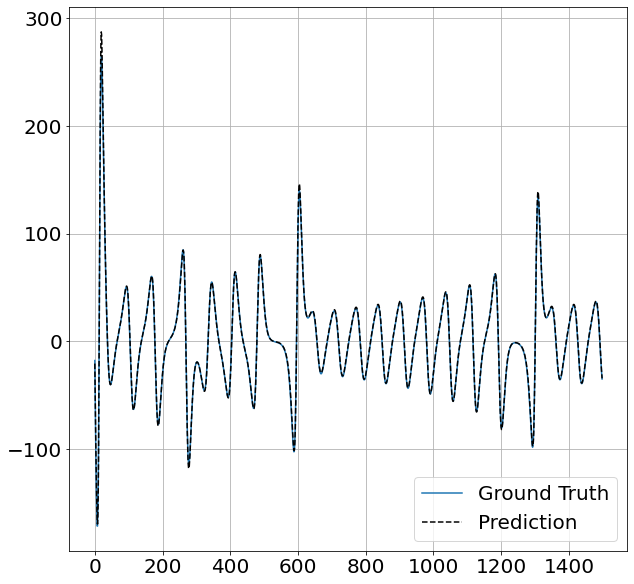

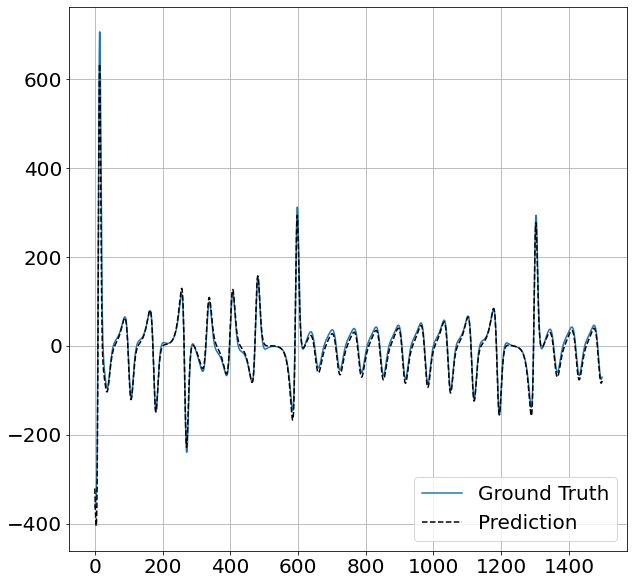

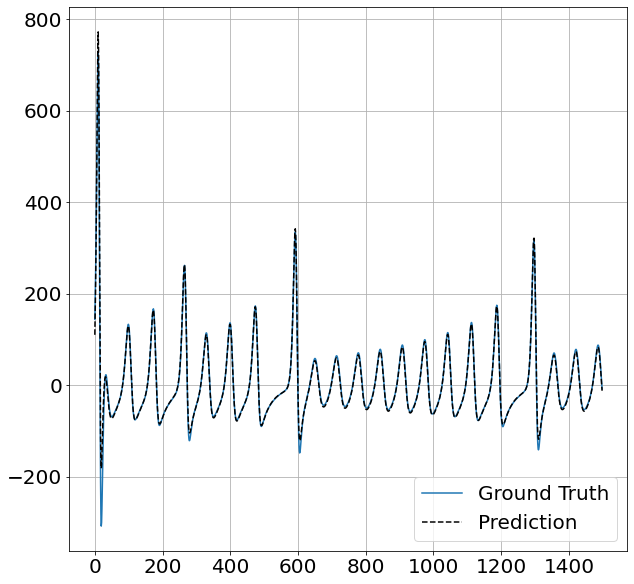

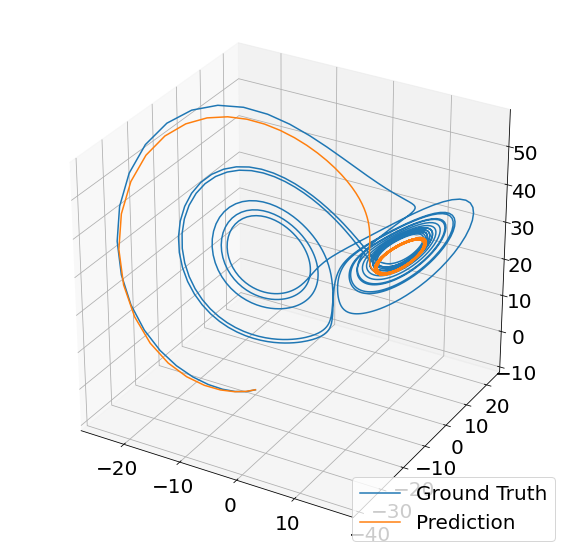

 
Epoch: 317
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.3559,  1.4555, -0.5982,  0.0000],
        [-5.0534,  0.0000,  0.0000, -0.0611]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.7934,  0.8707,  0.0000],
        [ 5.1327,  0.0000,  0.0000, -0.3422]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0579, -0.5782, -0.6428, -0.2020],
        [ 1.5227, -0.4169, -0.3897,  0.1370]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-1.4757,  0.4946,  5.4149, -0.0377]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 5.7847, 3.4641, 0.0525]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3434, -1.3613]], requires_grad=True)


Training progress...:  32%|███▏      | 317/1000 [05:43<48:14,  4.24s/it]

layer_idx = 3
index of pruned edge = 3
Pruned edges:  11
Unpruned edges:  25
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  32%|███▏      | 323/1000 [05:47<12:25,  1.10s/it]

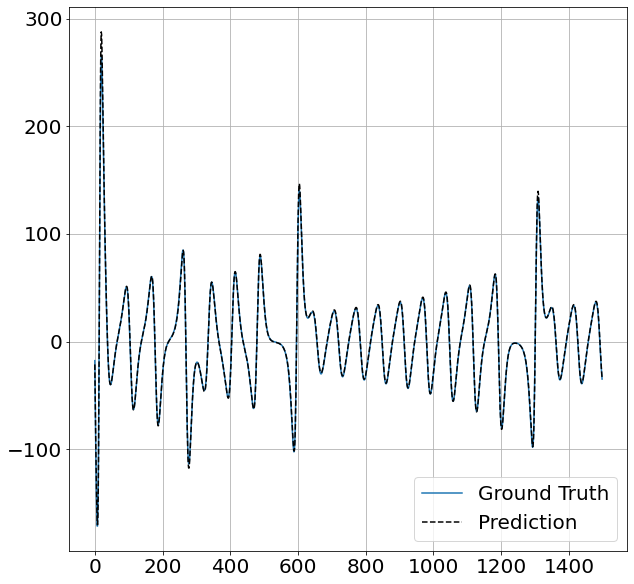

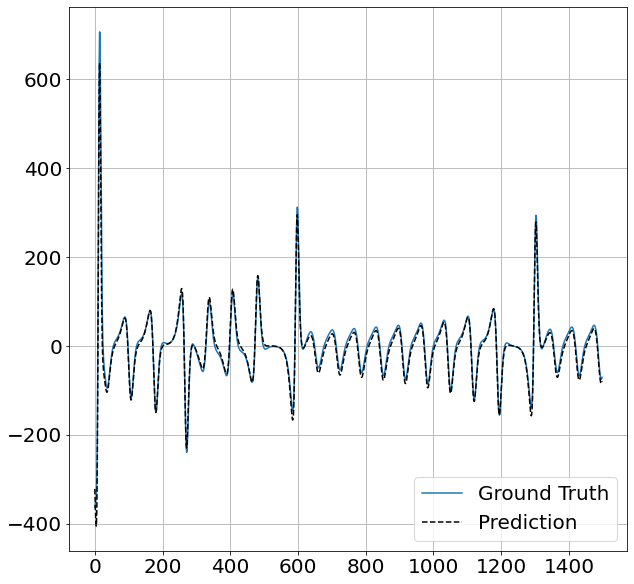

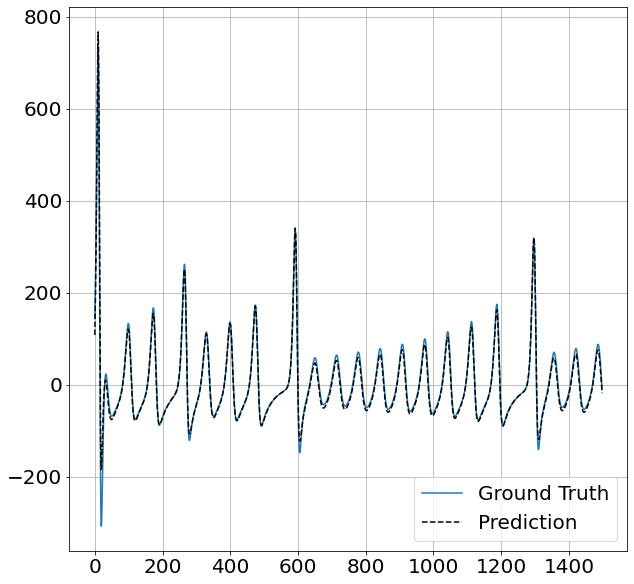

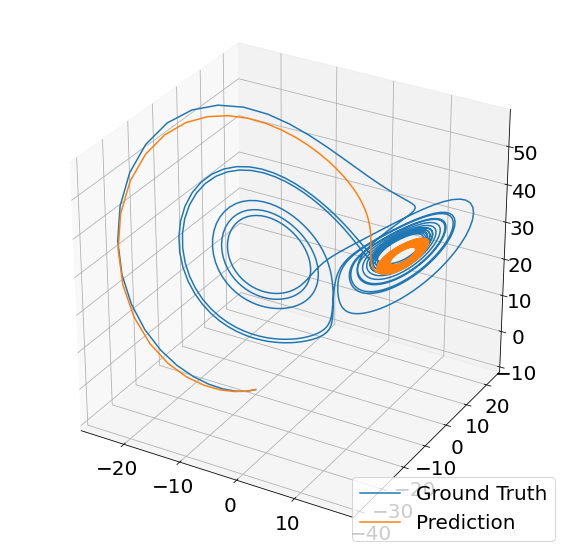

 
Epoch: 324
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[-0.2298,  1.4672, -0.5967,  0.0000],
        [-5.0732,  0.0000,  0.0000, -0.0592]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.8051,  0.8649,  0.0000],
        [ 5.1438,  0.0000,  0.0000, -0.3425]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0682, -0.5781, -0.6433, -0.2014],
        [ 1.5325, -0.4114, -0.3830,  0.1428]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-1.5945,  0.5011,  5.4651,  0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 5.8315, 3.4082, 0.0524]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3446, -1.3624]], requires_grad=True)


Training progress...:  32%|███▏      | 324/1000 [05:58<46:22,  4.12s/it]

layer_idx = 0
index of pruned edge = 0
Pruned edges:  12
Unpruned edges:  24
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  34%|███▍      | 342/1000 [06:10<07:12,  1.52it/s]

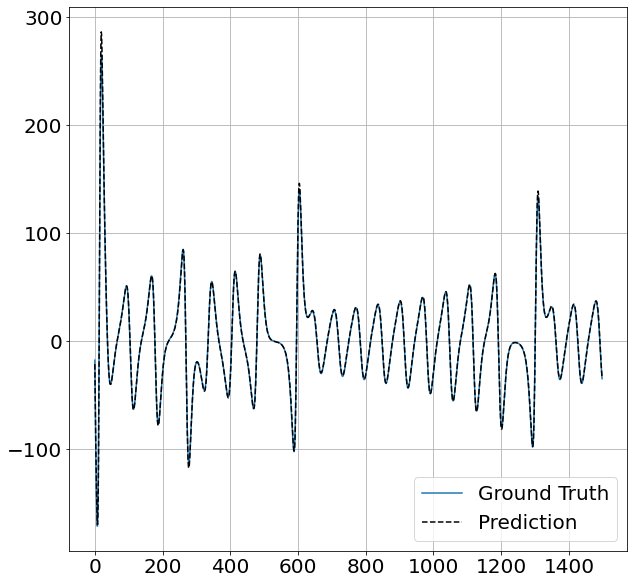

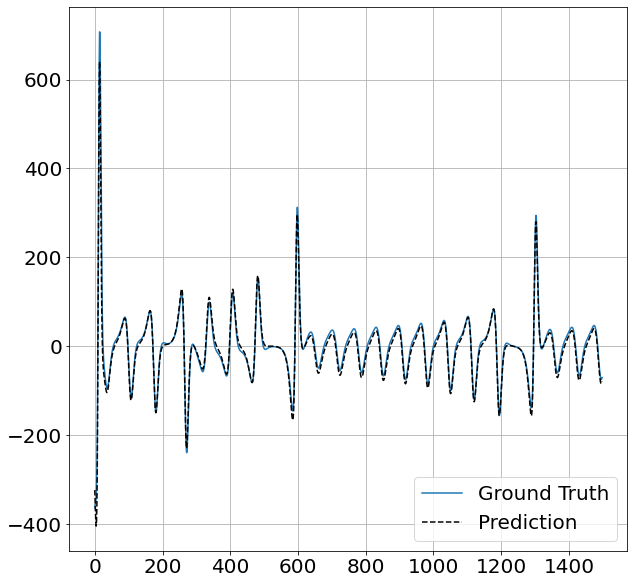

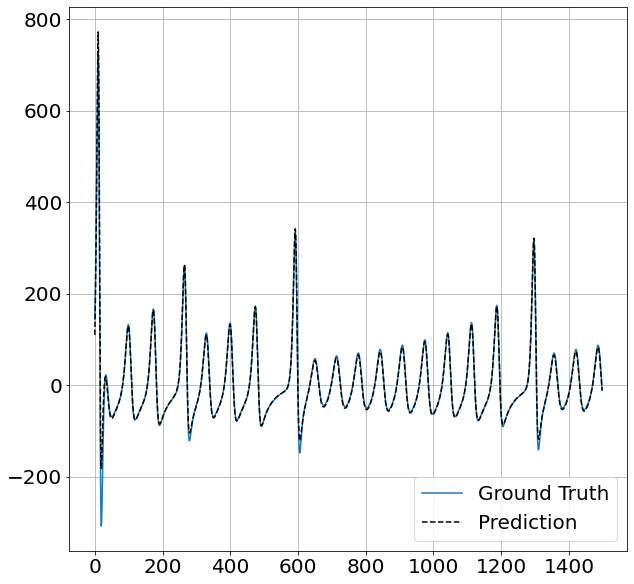

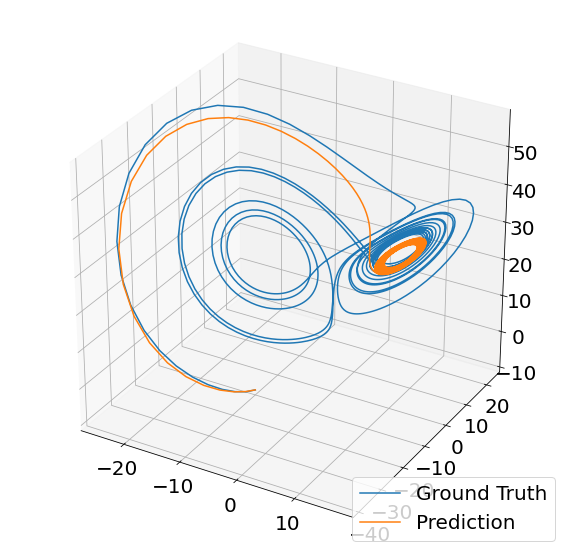

 
Epoch: 343
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.4690, -0.5775,  0.0000],
        [-5.0686,  0.0000,  0.0000, -0.0595]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.8348,  0.8492,  0.0000],
        [ 5.1756,  0.0000,  0.0000, -0.3422]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0844, -0.5762, -0.6452, -0.2022],
        [ 1.5485, -0.4159, -0.3900,  0.1367]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[-0.1856,  0.5429,  5.5617,  0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 5.9596, 3.2552, 0.0532]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3510, -1.3448]], requires_grad=True)


Training progress...:  34%|███▍      | 343/1000 [06:21<40:25,  3.69s/it]

layer_idx = 3
index of pruned edge = 0
Pruned edges:  13
Unpruned edges:  23
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  35%|███▍      | 349/1000 [06:26<13:04,  1.21s/it]

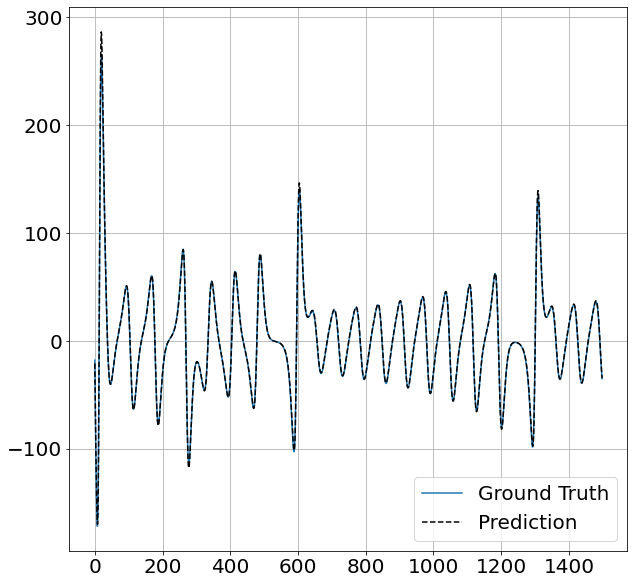

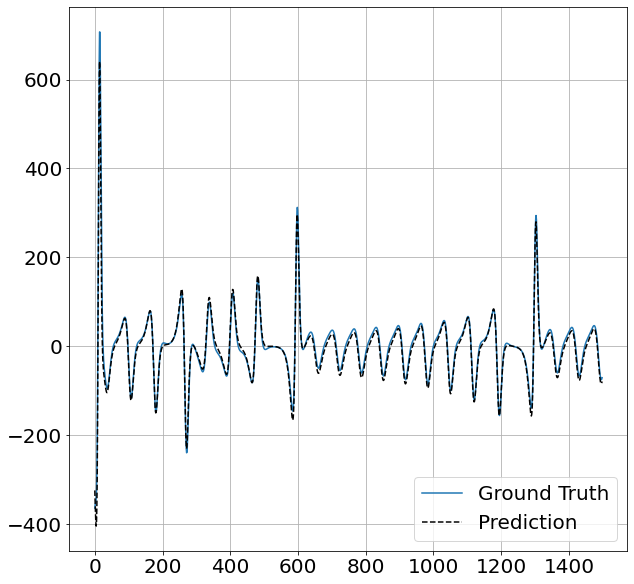

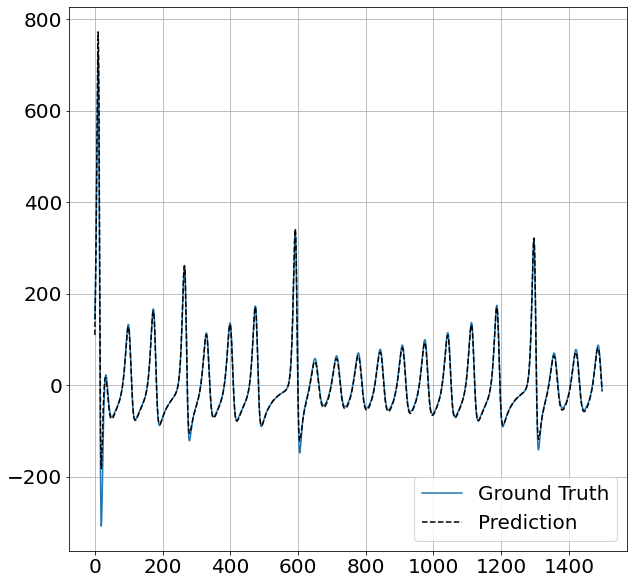

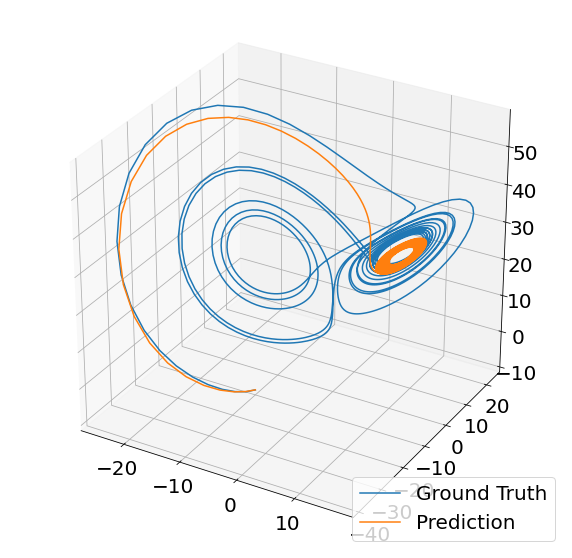

 
Epoch: 350
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.4805, -0.5751,  0.0000],
        [-5.0935,  0.0000,  0.0000, -0.0578]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.8468,  0.8418,  0.0000],
        [ 5.1876,  0.0000,  0.0000, -0.3420]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.0959, -0.5814, -0.6468, -0.2037],
        [ 1.5564, -0.4127, -0.3874,  0.1376]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.5476, 5.6085, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 6.0052, 3.2006, 0.0523]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3534, -1.3451]], requires_grad=True)


Training progress...:  35%|███▌      | 350/1000 [06:36<42:42,  3.94s/it]

layer_idx = 4
index of pruned edge = 2
Pruned edges:  14
Unpruned edges:  22
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  36%|███▋      | 364/1000 [06:46<07:37,  1.39it/s]

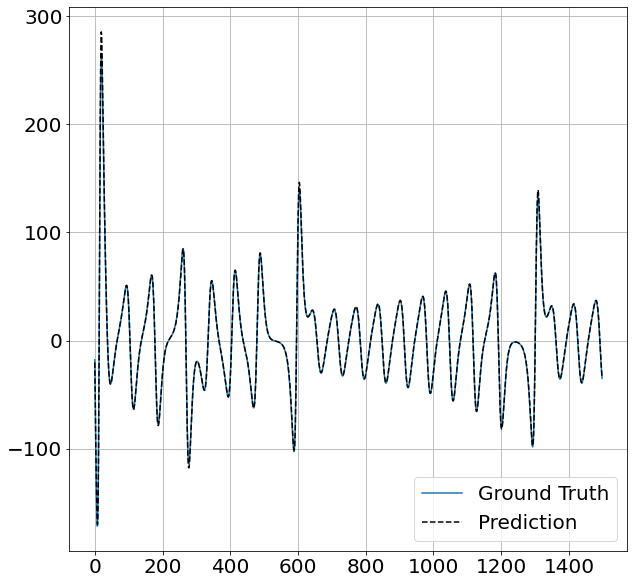

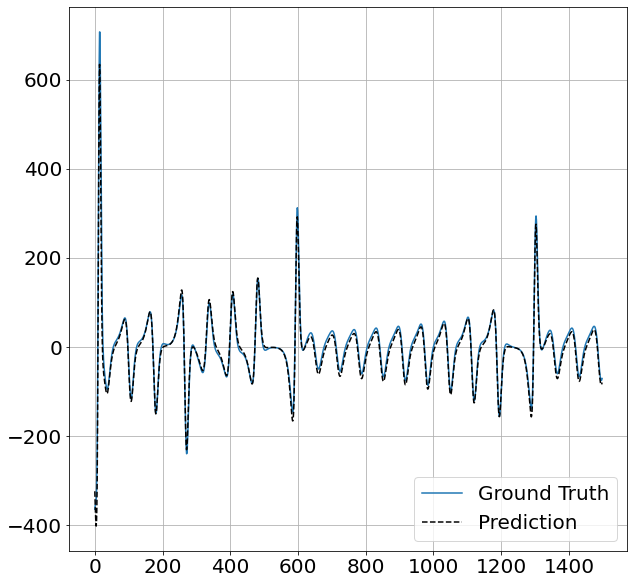

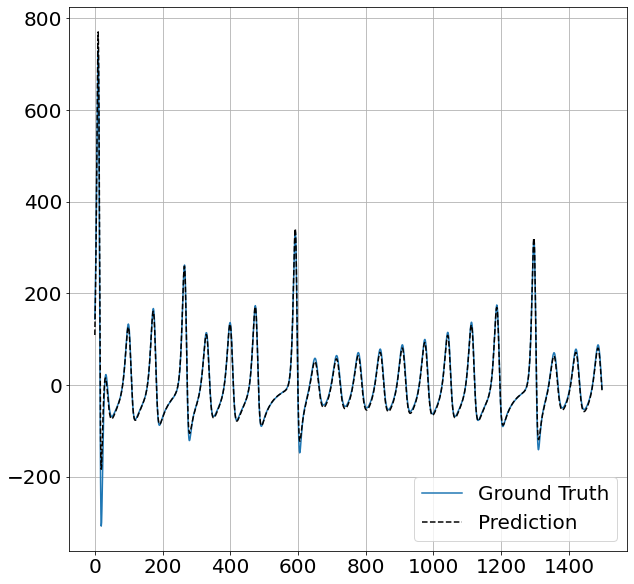

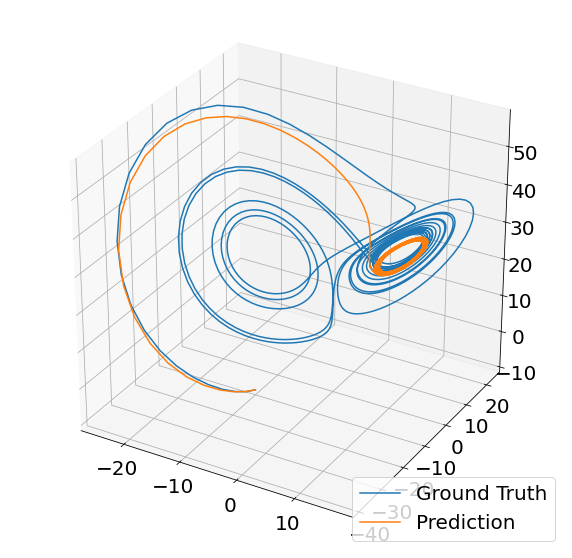

 
Epoch: 365
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.4984, -0.5656,  0.0000],
        [-5.1283,  0.0000,  0.0000, -0.0550]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.8692,  0.8205,  0.0000],
        [ 5.2096,  0.0000,  0.0000, -0.3408]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.1165, -0.5782, -0.6459, -0.2035],
        [ 1.5689, -0.4151, -0.3860,  0.1392]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.5697, 5.7120, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 6.1037, 3.0671, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.3618, -1.3366]], requires_grad=True)


Training progress...:  36%|███▋      | 365/1000 [06:56<37:02,  3.50s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  15
Unpruned edges:  21
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  38%|███▊      | 381/1000 [07:06<06:32,  1.58it/s]

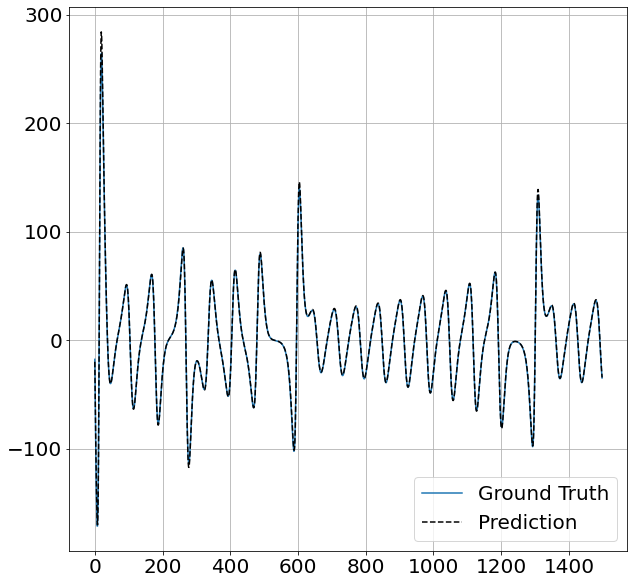

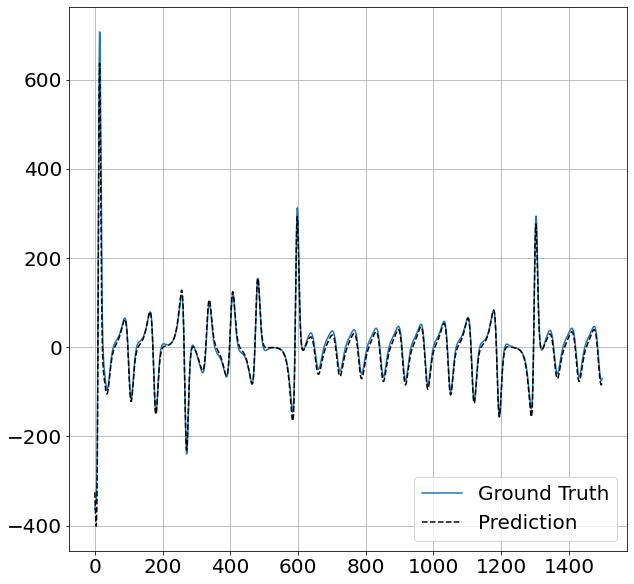

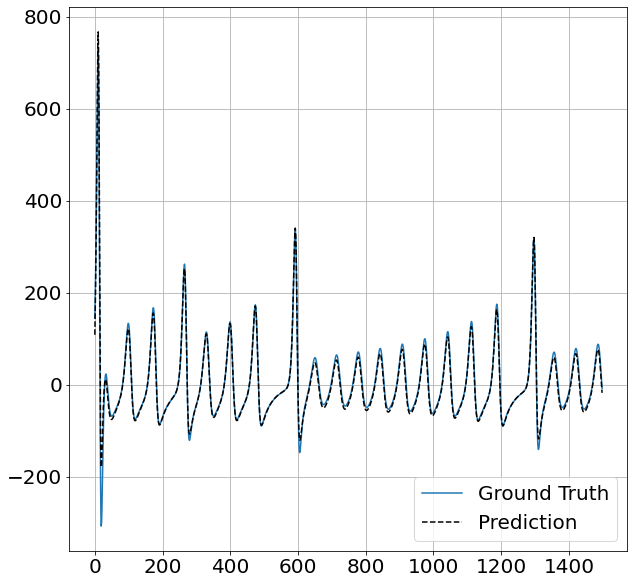

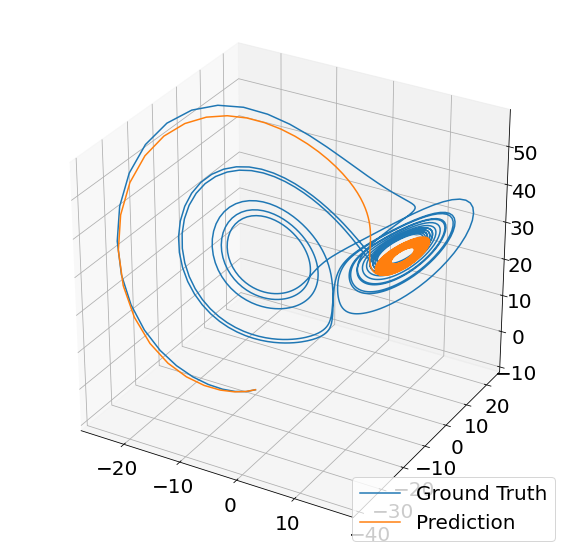

 
Epoch: 382
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.5110, -0.5518,  0.0000],
        [-5.1510,  0.0000,  0.0000, -0.0530]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.8962,  0.8090,  0.0000],
        [ 5.2395,  0.0000,  0.0000, -0.3402]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.2673, -0.5771, -0.6041, -0.1953],
        [ 1.4970, -0.4122, -0.4097,  0.1465]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.6026, 5.8247, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 6.2165, 2.9238, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -1.3348]], requires_grad=True)


Training progress...:  38%|███▊      | 382/1000 [07:15<34:05,  3.31s/it]

layer_idx = 3
index of pruned edge = 0
Pruned edges:  16
Unpruned edges:  20
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  40%|████      | 405/1000 [07:30<06:18,  1.57it/s]

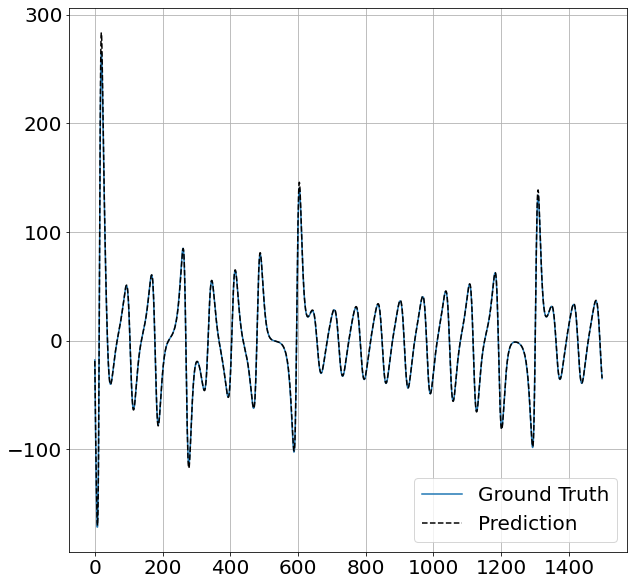

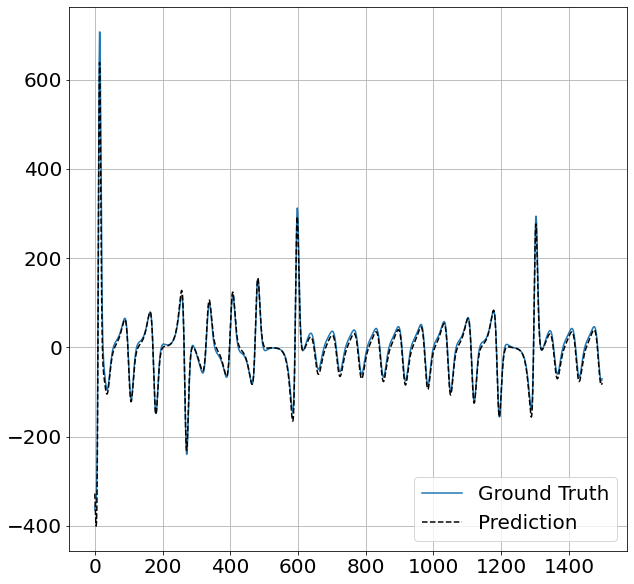

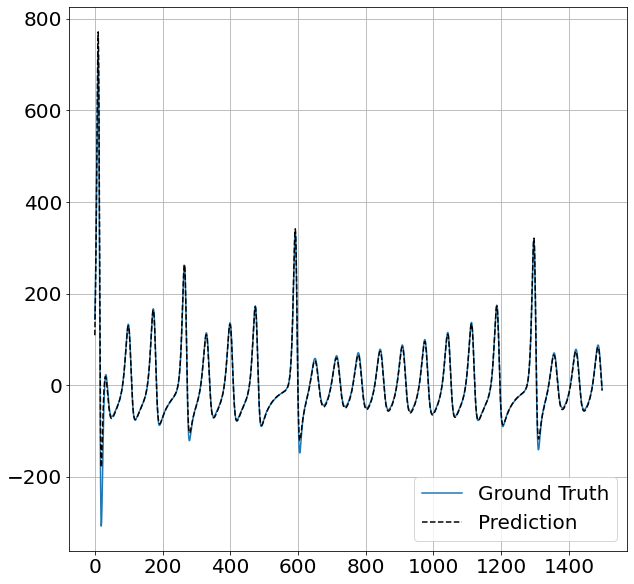

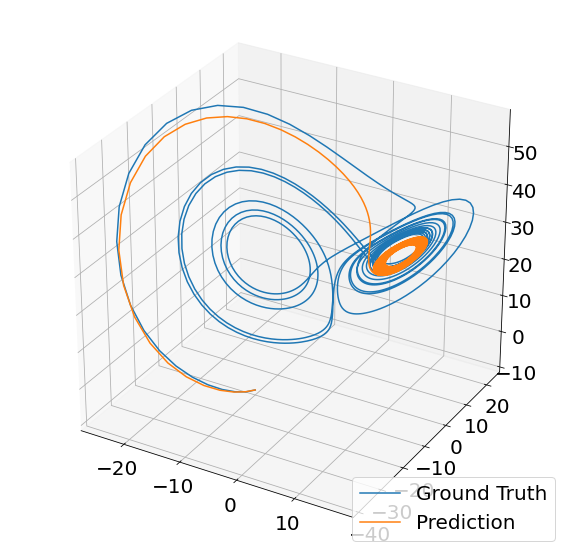

 
Epoch: 406
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.4551, -0.5380,  0.0000],
        [-5.0442,  0.0000,  0.0000, -0.0521]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.9370,  0.7890,  0.0000],
        [ 5.2832,  0.0000,  0.0000, -0.3393]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.3096, -0.5683, -0.6021, -0.1938],
        [ 1.5012, -0.4239, -0.4171,  0.1438]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.0164, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 6.3717, 2.7247, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -1.3111]], requires_grad=True)


Training progress...:  41%|████      | 406/1000 [07:39<31:32,  3.19s/it]

layer_idx = 0
index of pruned edge = 3
Pruned edges:  17
Unpruned edges:  19
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  43%|████▎     | 427/1000 [07:53<06:00,  1.59it/s]

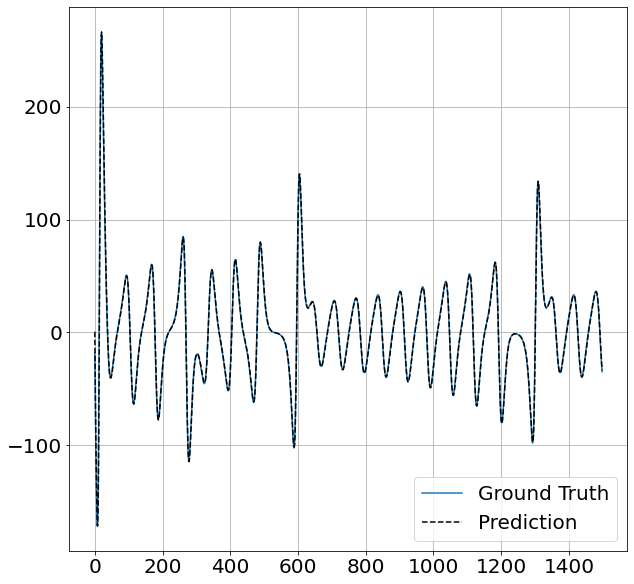

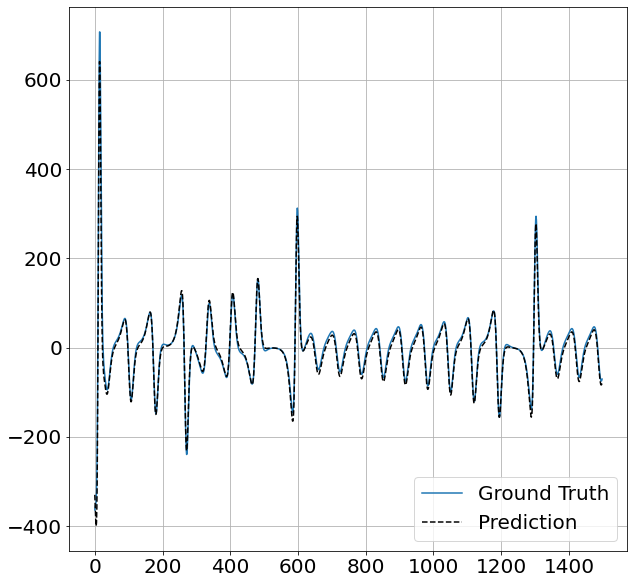

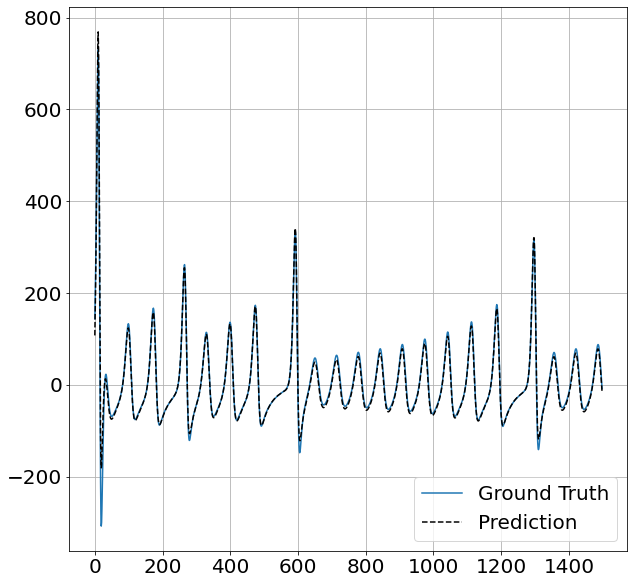

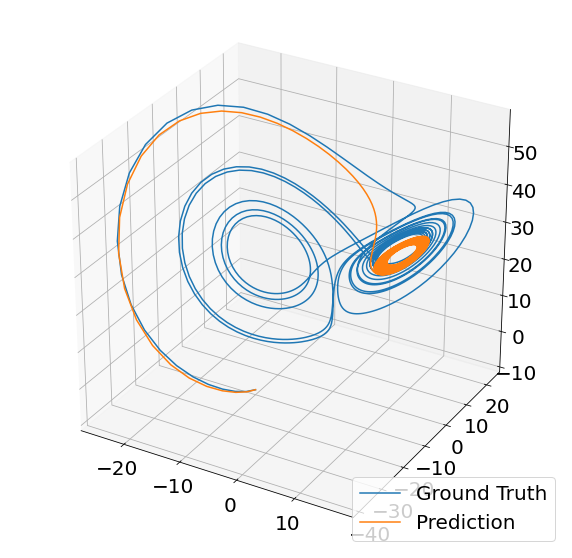

 
Epoch: 428
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8008, -0.6873,  0.0000],
        [-5.5841,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  1.9739,  0.7727,  0.0000],
        [ 5.3237,  0.0000,  0.0000, -0.3384]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.3257, -0.5657, -0.5999, -0.1929],
        [ 1.5327, -0.4224, -0.4140,  0.1485]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1605, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 6.5082, 2.5452, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -1.2974]], requires_grad=True)


Training progress...:  43%|████▎     | 428/1000 [08:01<29:53,  3.14s/it]

layer_idx = 1
index of pruned edge = 1
Pruned edges:  18
Unpruned edges:  18
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  55%|█████▍    | 547/1000 [09:19<04:51,  1.55it/s]

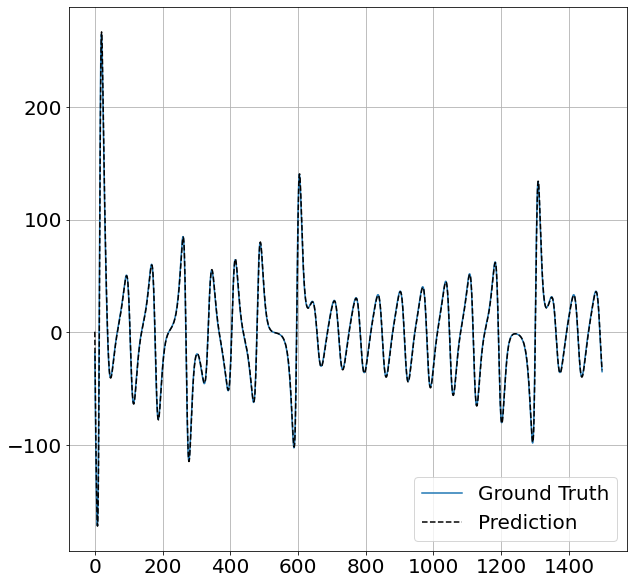

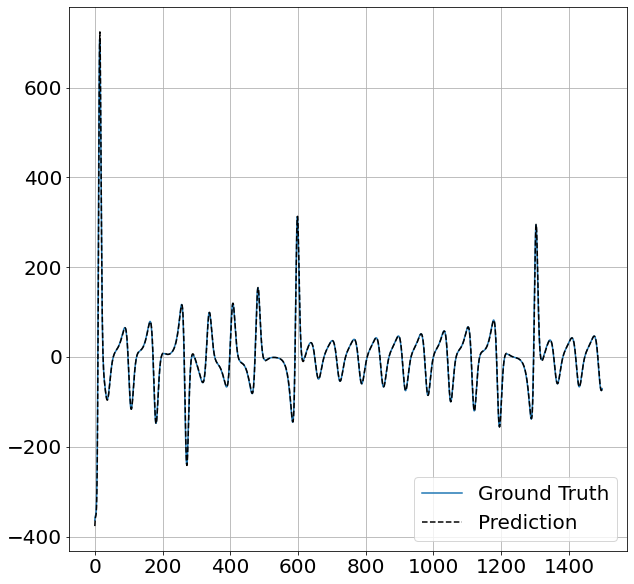

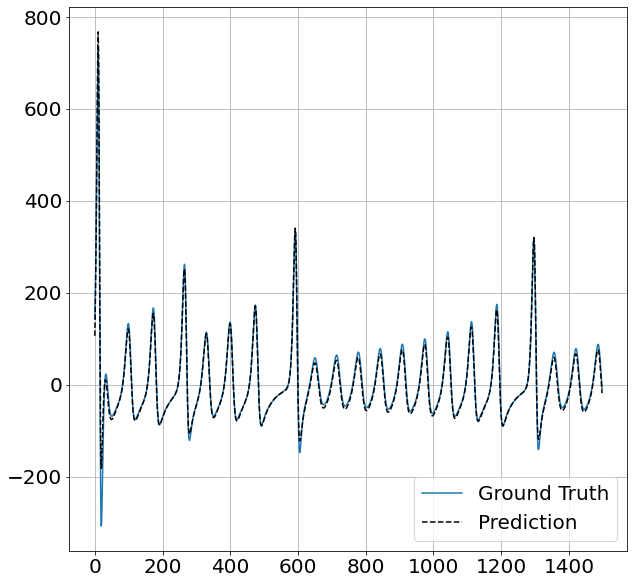

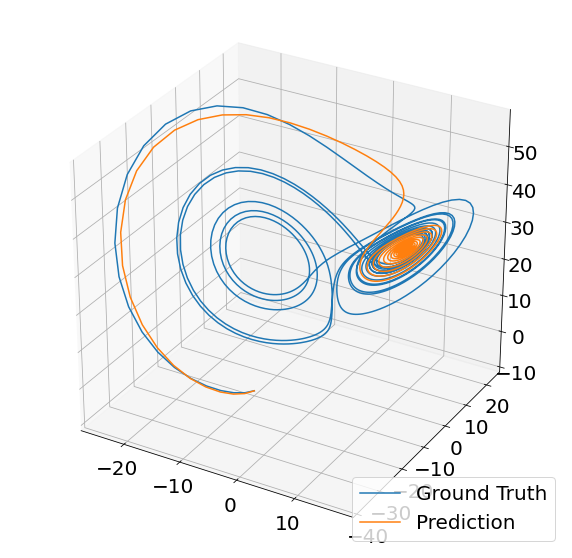

 
Epoch: 548
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8014, -0.6879,  0.0000],
        [-5.5829,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  3.2951,  0.0000,  0.0000],
        [ 6.4763,  0.0000,  0.0000, -0.3087]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.3986, -0.5493, -0.5802, -0.1899],
        [ 1.7037, -0.4331, -0.4265,  0.1571]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1607, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[ 0.0000,  7.6135, -1.4486,  0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -1.2028]], requires_grad=True)


Training progress...:  55%|█████▍    | 548/1000 [09:27<22:07,  2.94s/it]

layer_idx = 4
index of pruned edge = 1
Pruned edges:  19
Unpruned edges:  17
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  56%|█████▌    | 562/1000 [09:36<04:38,  1.57it/s]

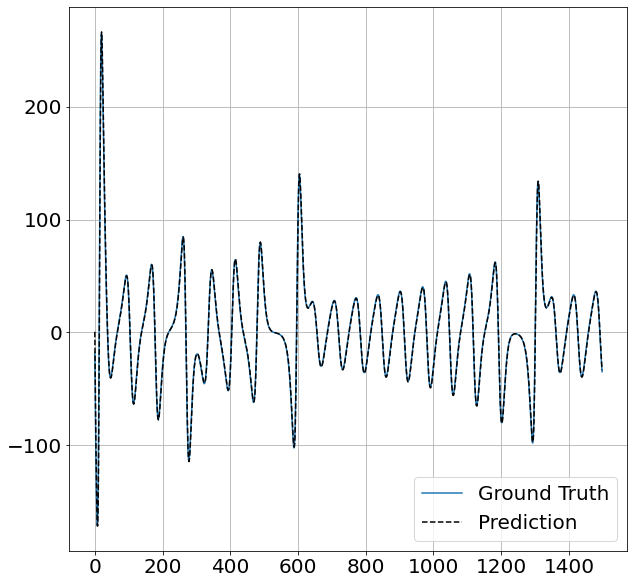

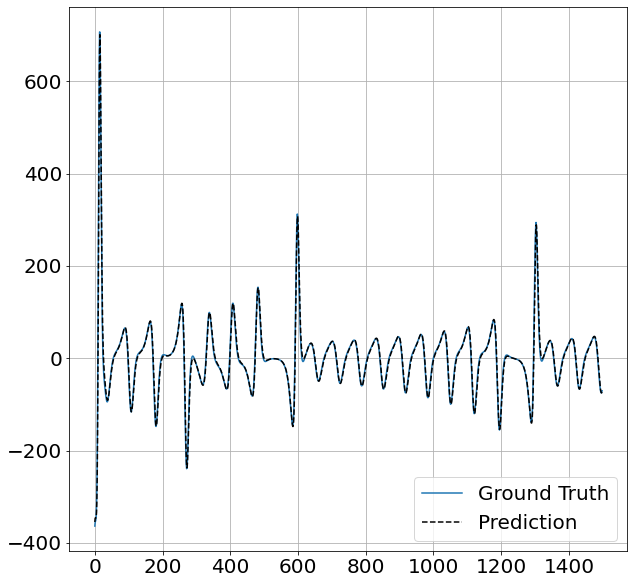

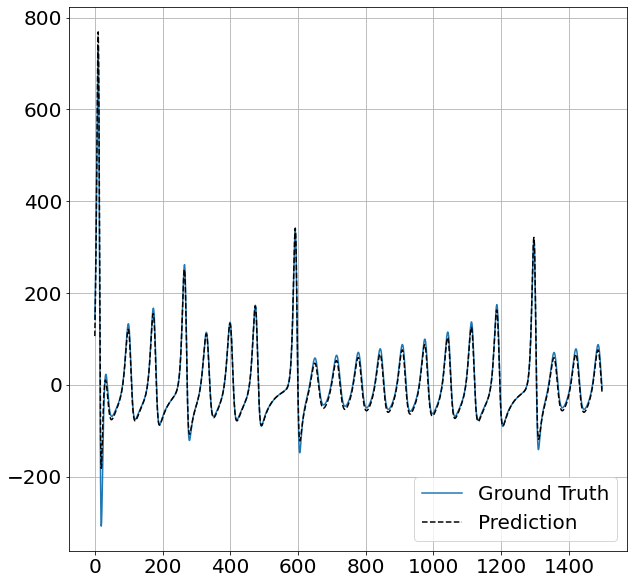

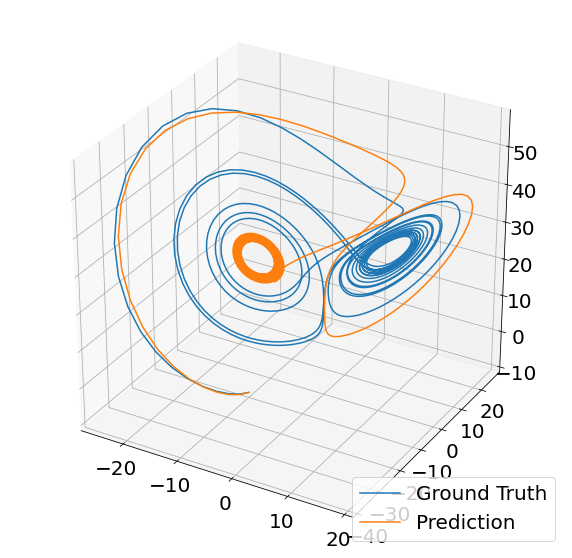

 
Epoch: 563
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8012, -0.6875,  0.0000],
        [-5.5826,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9345,  0.0000,  0.0000],
        [ 6.2875,  0.0000,  0.0000, -0.3273]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[-2.4087, -0.5501, -0.5806, -0.1901],
        [ 1.7209, -0.4332, -0.4261,  0.1574]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1603, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4203, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -1.1888]], requires_grad=True)


Training progress...:  56%|█████▋    | 563/1000 [09:45<22:31,  3.09s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  20
Unpruned edges:  16
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  70%|██████▉   | 698/1000 [11:11<03:09,  1.59it/s]

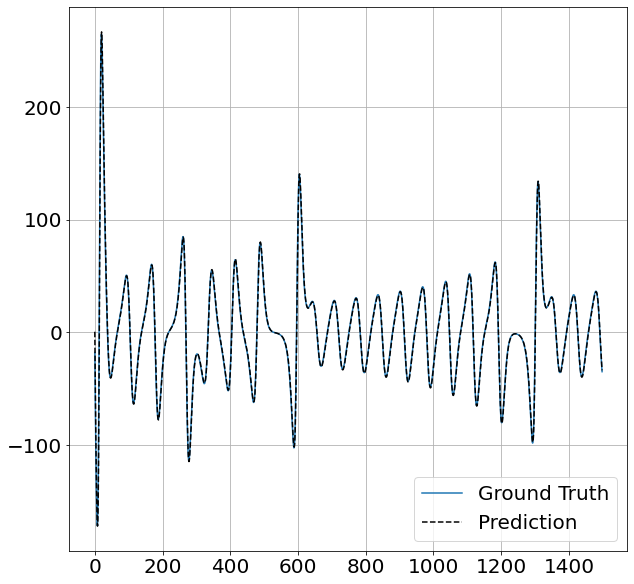

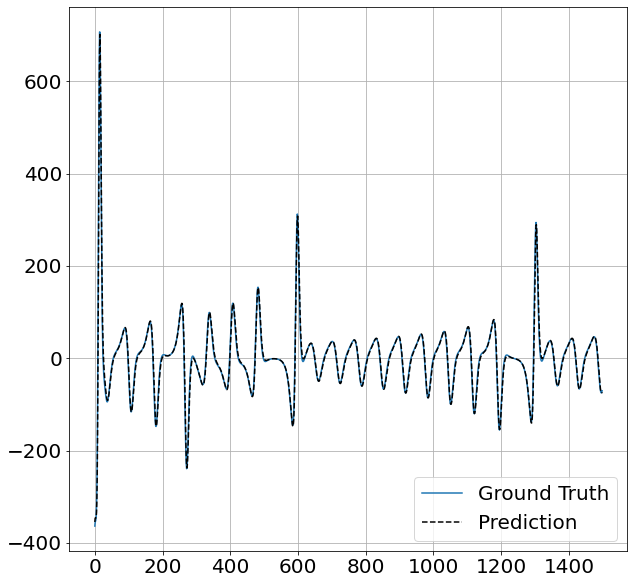

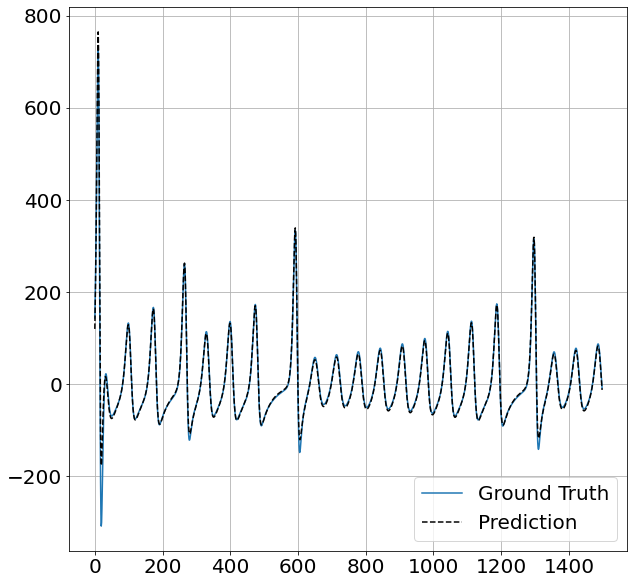

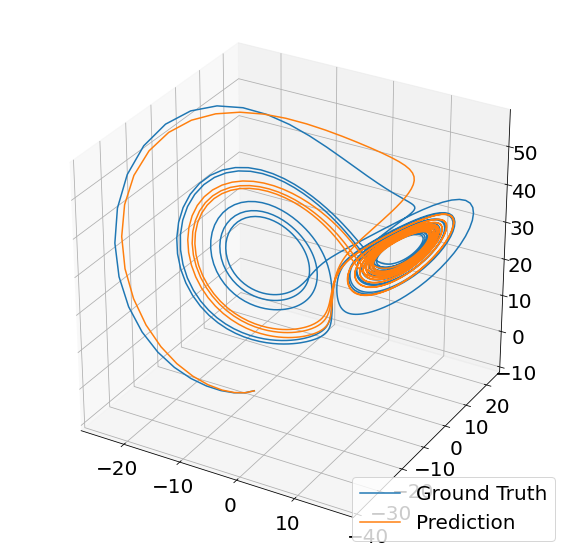

 
Epoch: 699
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8020, -0.6879,  0.0000],
        [-5.5810,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9305,  0.0000,  0.0000],
        [ 6.2925,  0.0000,  0.0000, -0.3279]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000, -0.4825, -0.4566, -0.1598],
        [ 0.1822, -0.5408, -0.5216,  0.1742]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1603, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4248, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.0717]], requires_grad=True)


Training progress...:  70%|██████▉   | 699/1000 [11:20<15:37,  3.12s/it]

layer_idx = 2
index of pruned edge = 3
Pruned edges:  21
Unpruned edges:  15
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  71%|███████   | 710/1000 [11:27<03:14,  1.49it/s]

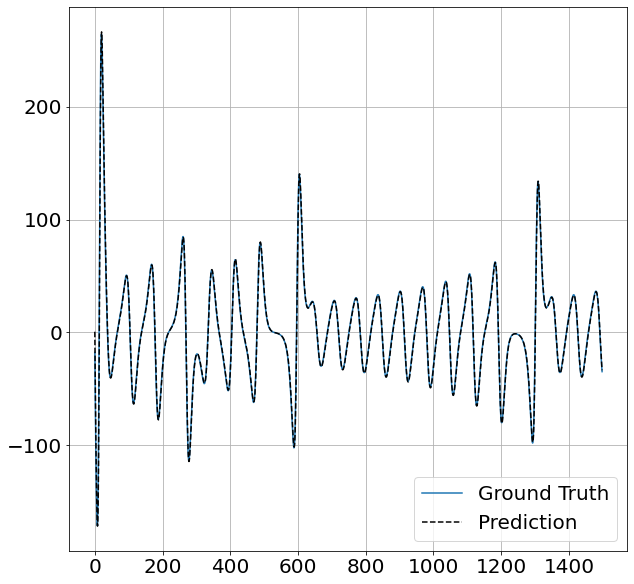

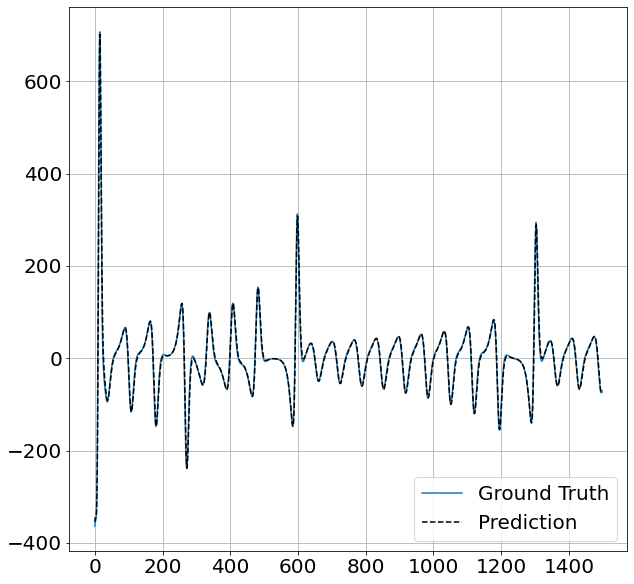

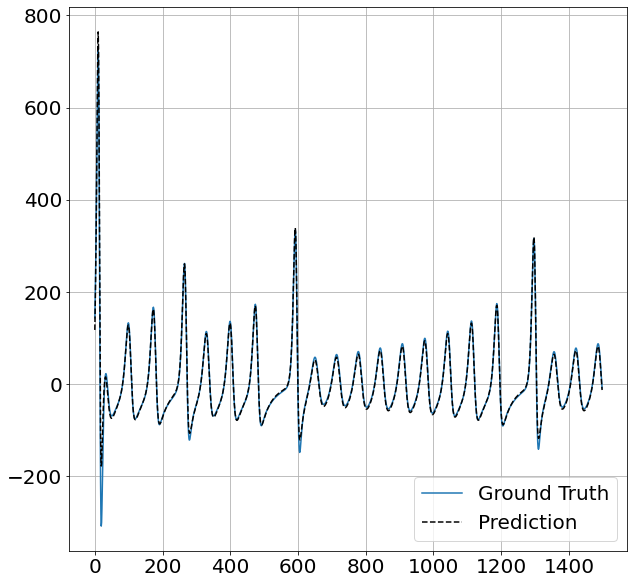

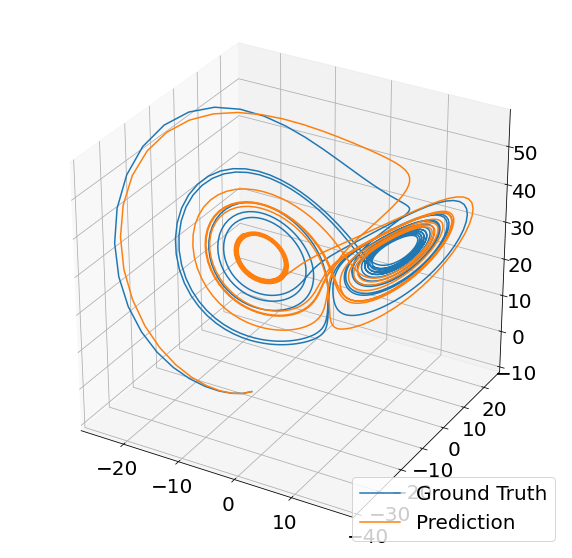

 
Epoch: 711
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8016, -0.6878,  0.0000],
        [-5.5807,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9290,  0.0000,  0.0000],
        [ 6.2922,  0.0000,  0.0000, -0.3280]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000, -0.4704, -0.4623, -0.1528],
        [ 0.0000, -0.5465, -0.5170,  0.1746]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1601, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4244, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.1282]], requires_grad=True)


Training progress...:  71%|███████   | 711/1000 [11:36<15:18,  3.18s/it]

layer_idx = 2
index of pruned edge = 2
Pruned edges:  22
Unpruned edges:  14
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  73%|███████▎  | 731/1000 [11:48<02:48,  1.59it/s]

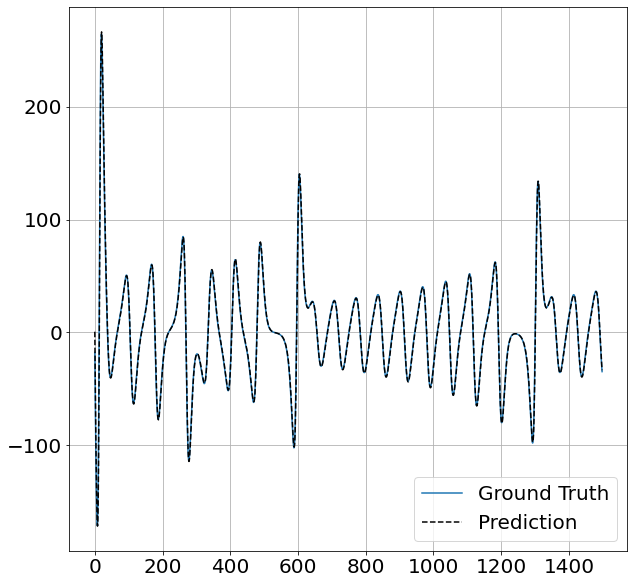

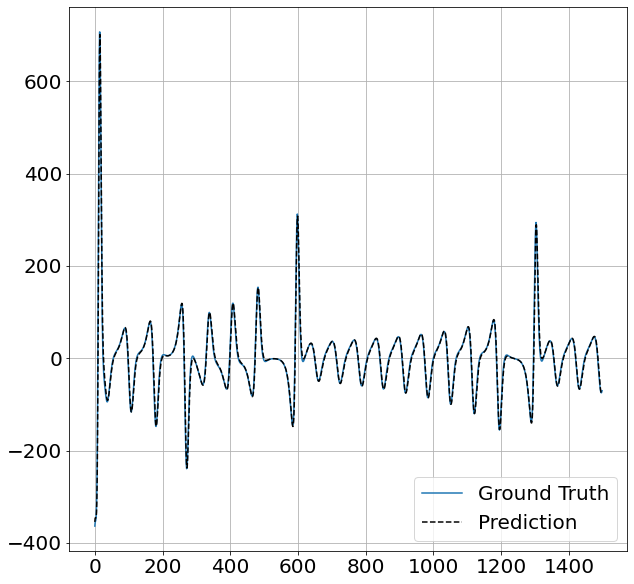

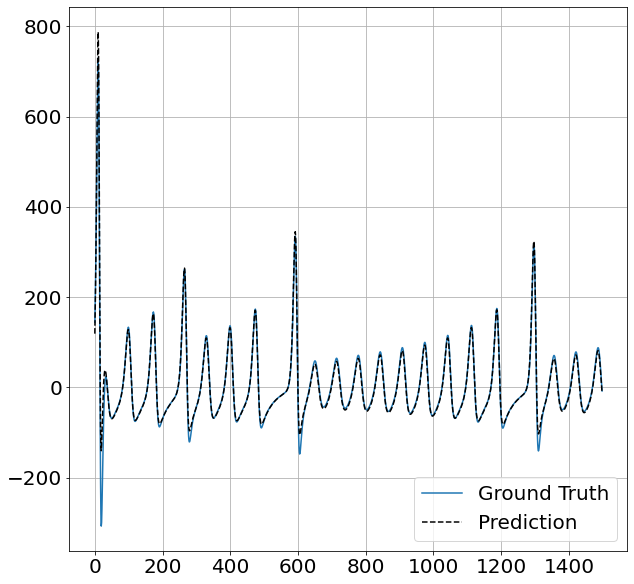

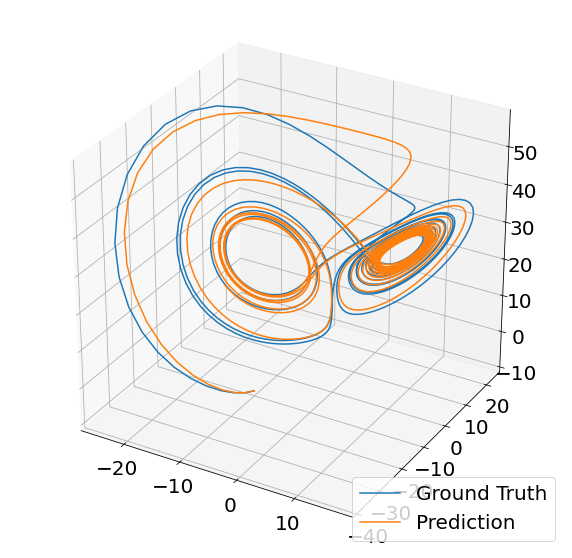

 
Epoch: 732
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8012, -0.6877,  0.0000],
        [-5.5803,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9287,  0.0000,  0.0000],
        [ 6.2932,  0.0000,  0.0000, -0.3280]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000, -0.3421, -0.5196,  0.0000],
        [ 0.0000, -0.4646, -0.6040,  0.0009]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1600, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4254, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6896]], requires_grad=True)


Training progress...:  73%|███████▎  | 732/1000 [11:57<13:25,  3.01s/it]

layer_idx = 2
index of pruned edge = 4
Pruned edges:  23
Unpruned edges:  13
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  75%|███████▍  | 746/1000 [12:06<02:42,  1.57it/s]

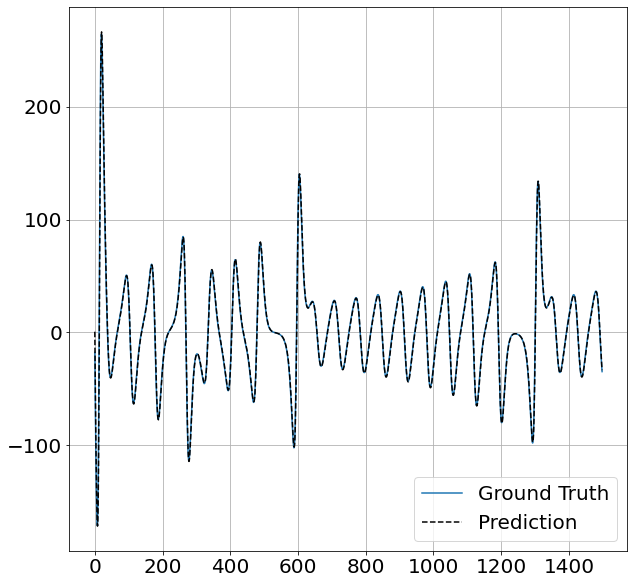

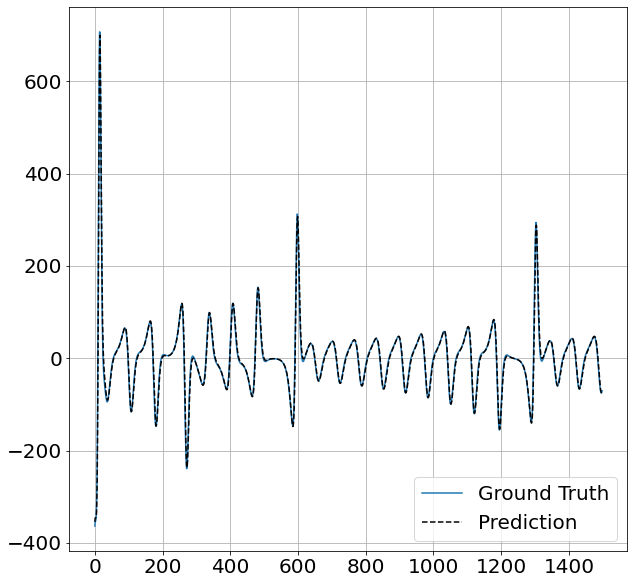

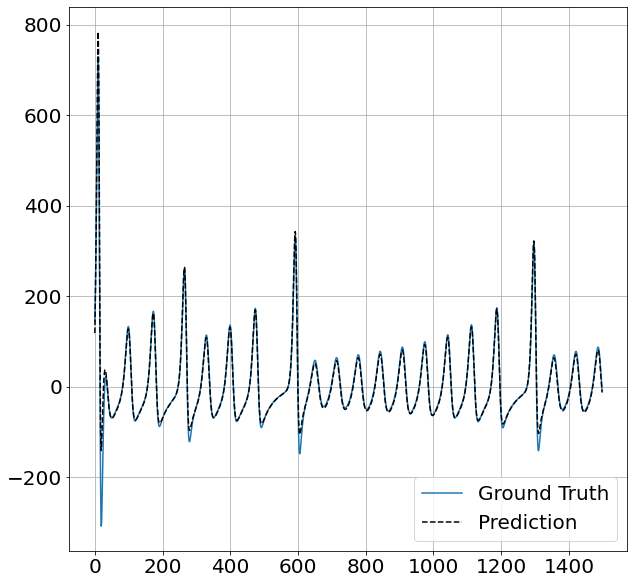

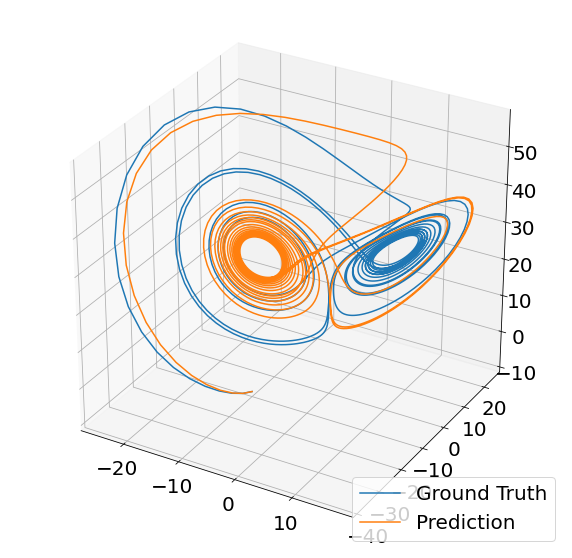

 
Epoch: 747
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8012, -0.6878,  0.0000],
        [-5.5807,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9286,  0.0000,  0.0000],
        [ 6.2944,  0.0000,  0.0000, -0.3276]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000, -0.3410, -0.5193,  0.0000],
        [ 0.0000, -0.4741, -0.5965,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1600, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4266, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6877]], requires_grad=True)


Training progress...:  75%|███████▍  | 747/1000 [12:14<12:35,  2.99s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  24
Unpruned edges:  12
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  79%|███████▉  | 791/1000 [12:42<02:15,  1.54it/s]

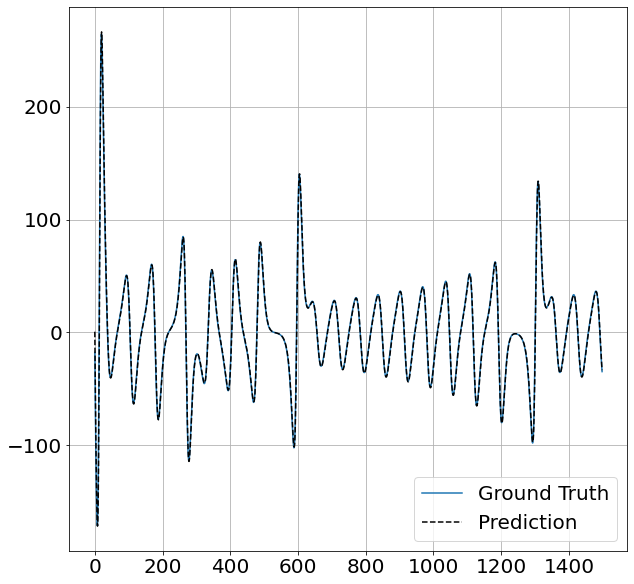

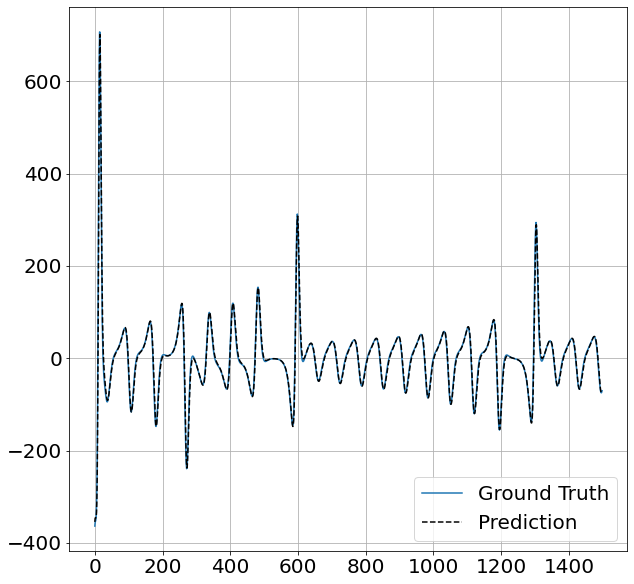

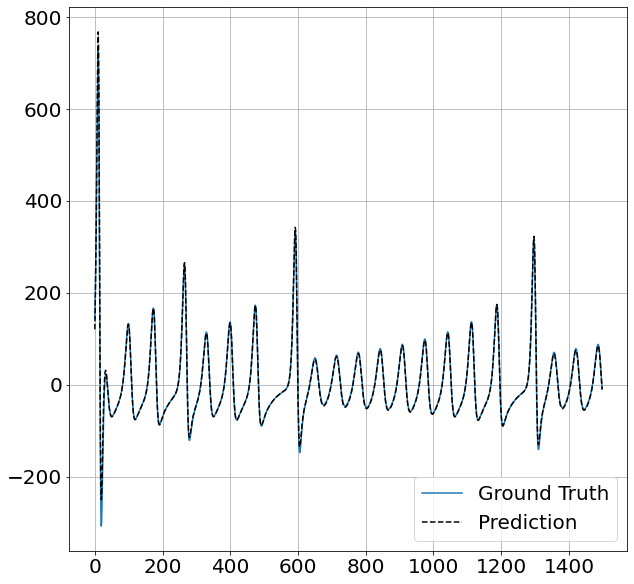

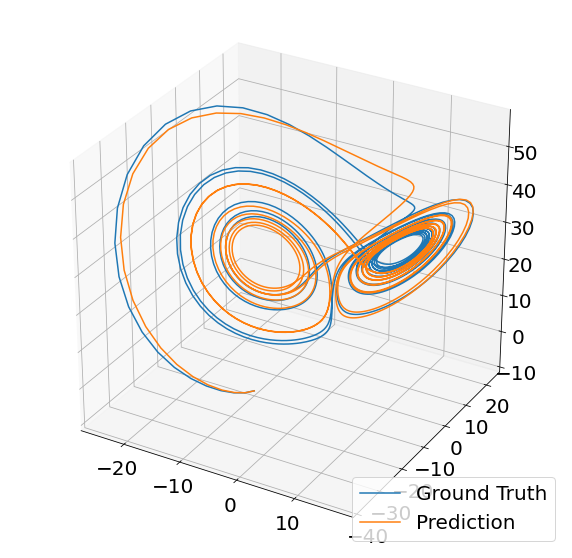

 
Epoch: 792
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8012, -0.6878,  0.0000],
        [-5.5802,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9270,  0.0000,  0.0000],
        [ 6.2954,  0.0000,  0.0000, -0.3282]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.7191,  0.0000],
        [ 0.0000, -1.1003, -0.2099,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1599, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4273, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6352]], requires_grad=True)


Training progress...:  79%|███████▉  | 792/1000 [12:51<10:30,  3.03s/it]

layer_idx = 2
index of pruned edge = 2
Pruned edges:  25
Unpruned edges:  11
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  80%|████████  | 801/1000 [12:57<02:24,  1.38it/s]

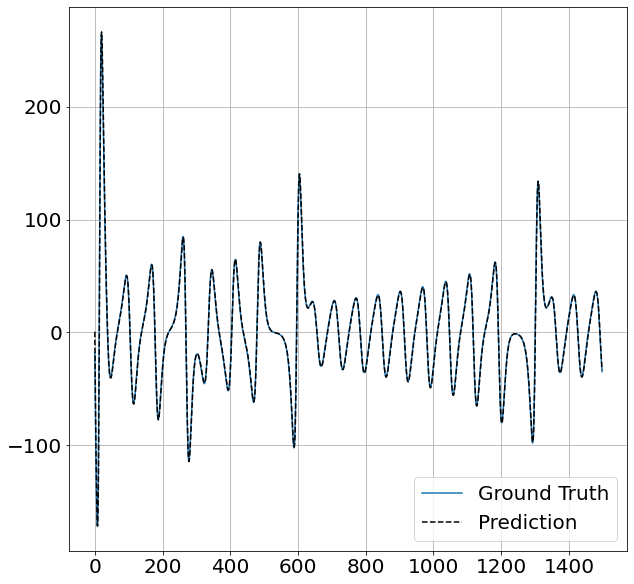

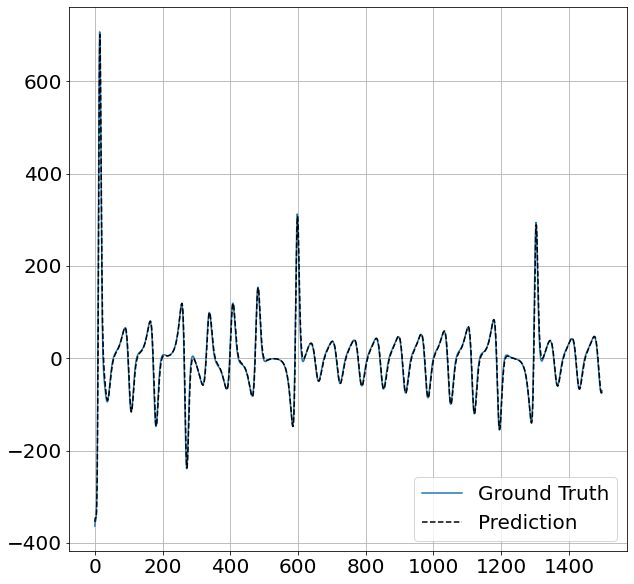

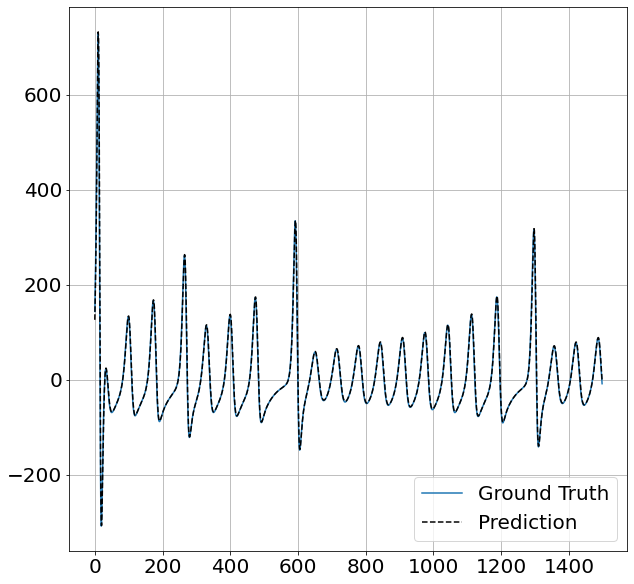

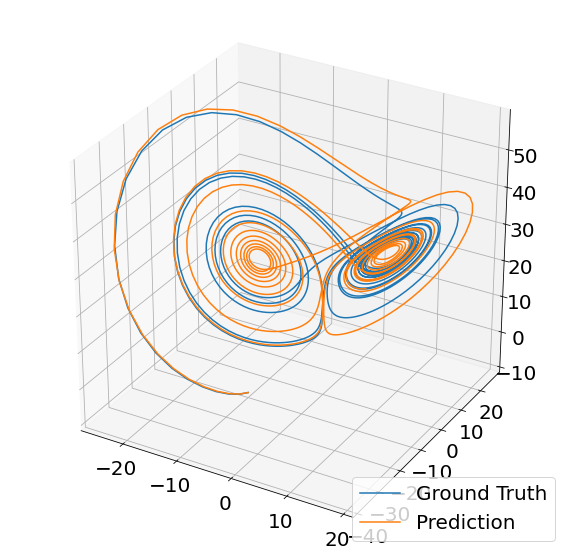

 
Epoch: 802
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.8016, -0.6880,  0.0000],
        [-5.5815,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9278,  0.0000,  0.0000],
        [ 6.2964,  0.0000,  0.0000, -0.3280]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.8277,  0.0000],
        [ 0.0000, -1.2098,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 6.1601, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4283, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6290]], requires_grad=True)


Training progress...:  80%|████████  | 802/1000 [13:04<09:22,  2.84s/it]

layer_idx = 0
index of pruned edge = 1
Pruned edges:  26
Unpruned edges:  10
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  88%|████████▊ | 881/1000 [13:56<01:16,  1.55it/s]

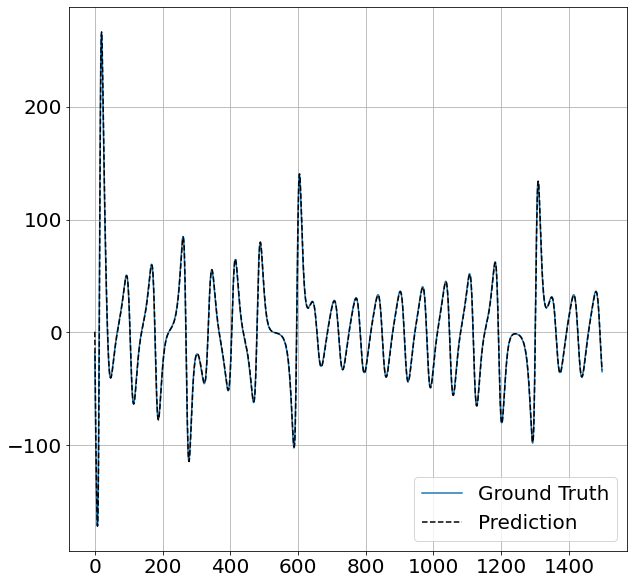

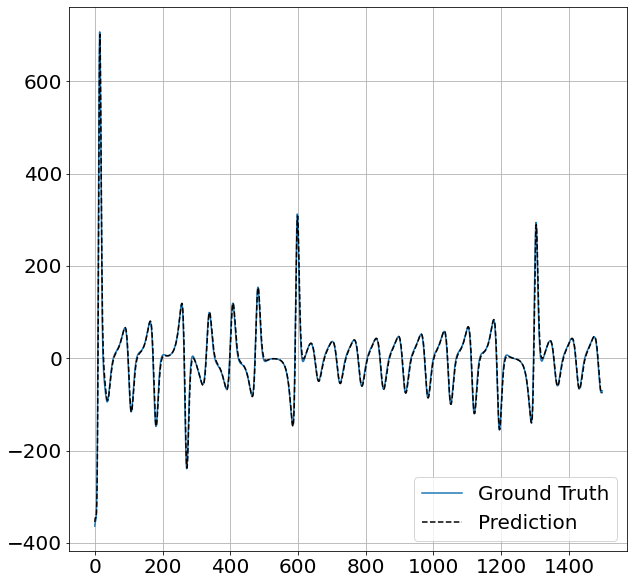

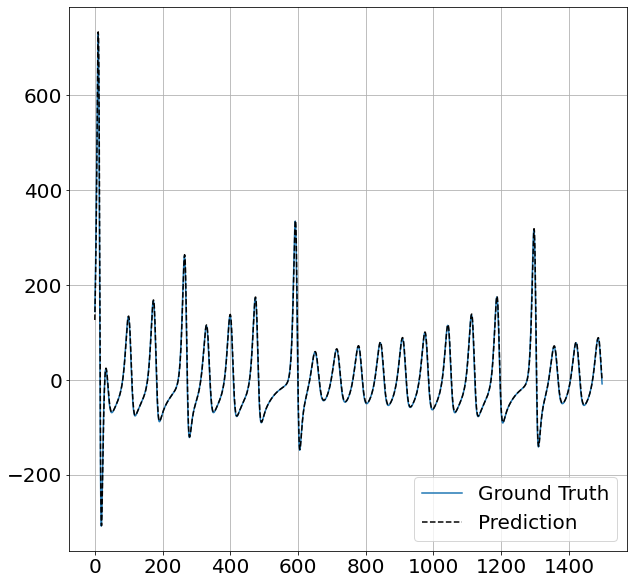

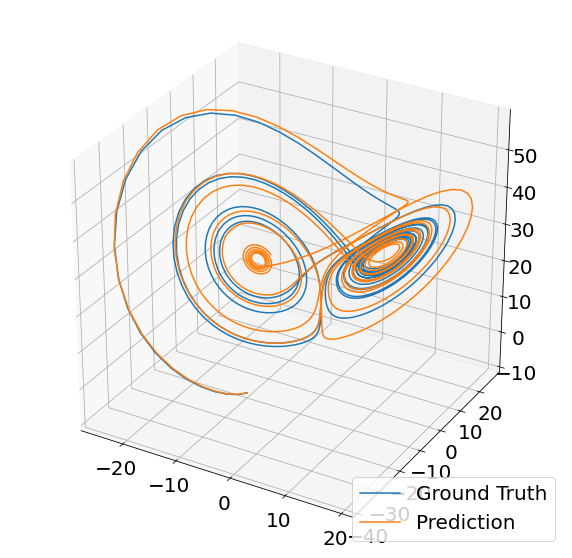

 
Epoch: 882
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7937,  0.0000,  0.0000],
        [-5.6028,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  2.9252,  0.0000,  0.0000],
        [ 6.2992,  0.0000,  0.0000, -0.3284]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.8285,  0.0000],
        [ 0.0000, -1.2102,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9932, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0.0000, 7.4308, 0.0000, 0.0000]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6289]], requires_grad=True)


Training progress...:  88%|████████▊ | 882/1000 [14:04<05:35,  2.84s/it]

layer_idx = 4
index of pruned edge = 0
Pruned edges:  27
Unpruned edges:  9
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  91%|█████████▏| 914/1000 [14:25<00:55,  1.56it/s]

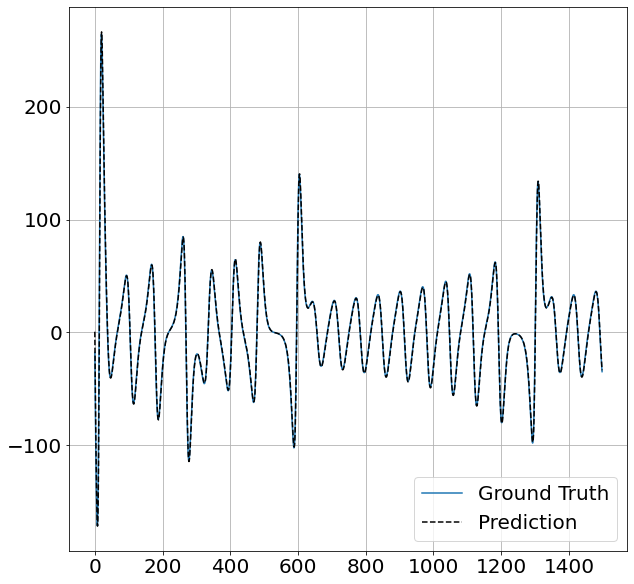

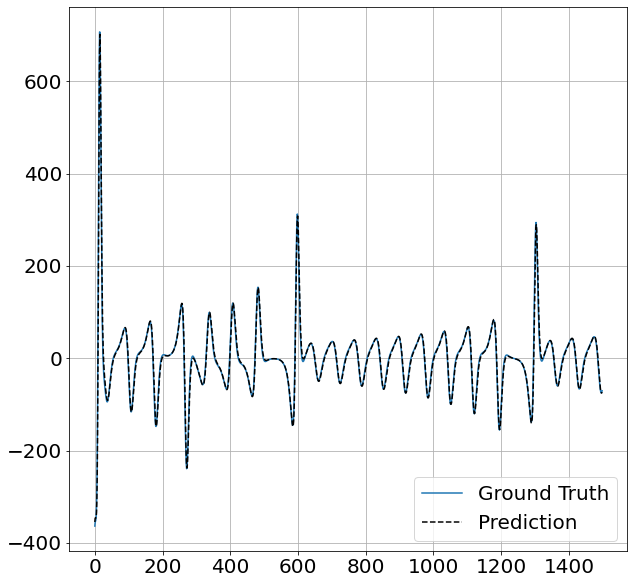

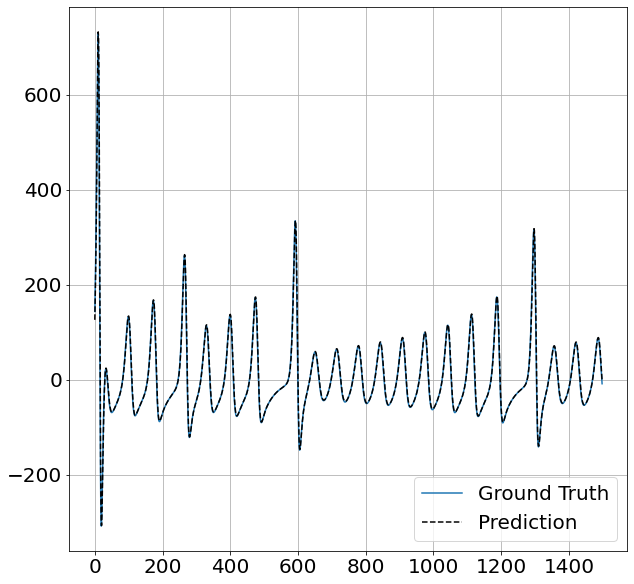

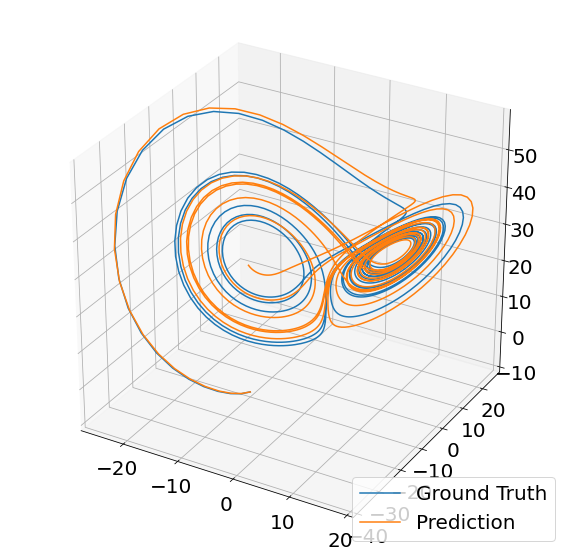

 
Epoch: 915
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7944,  0.0000,  0.0000],
        [-5.6033,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  3.7875,  0.0000,  0.0000],
        [ 6.8292,  0.0000,  0.0000, -0.2537]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.8280,  0.0000],
        [ 0.0000, -1.2095,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9985, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6290]], requires_grad=True)


Training progress...:  92%|█████████▏| 915/1000 [14:33<04:03,  2.87s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  28
Unpruned edges:  8
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  92%|█████████▏| 922/1000 [14:38<01:08,  1.14it/s]

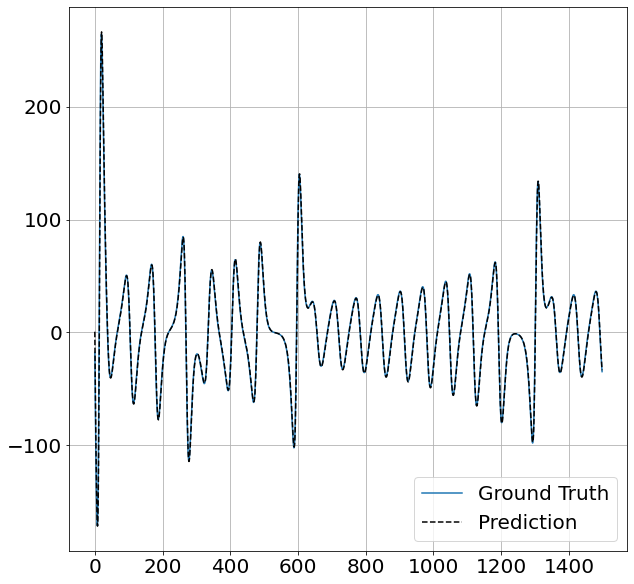

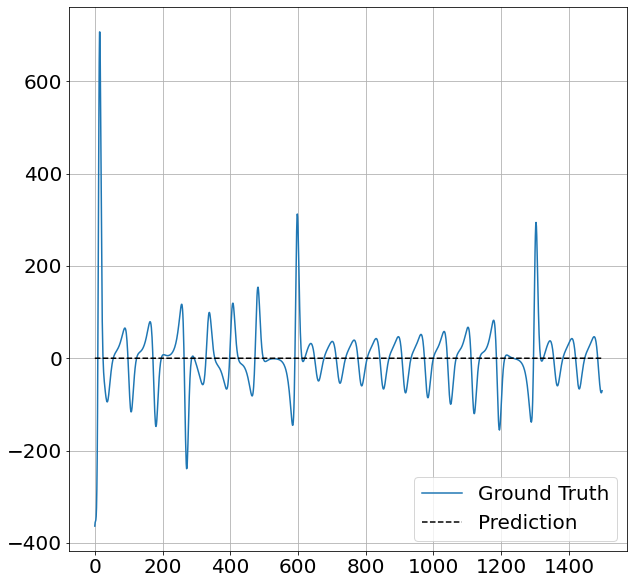

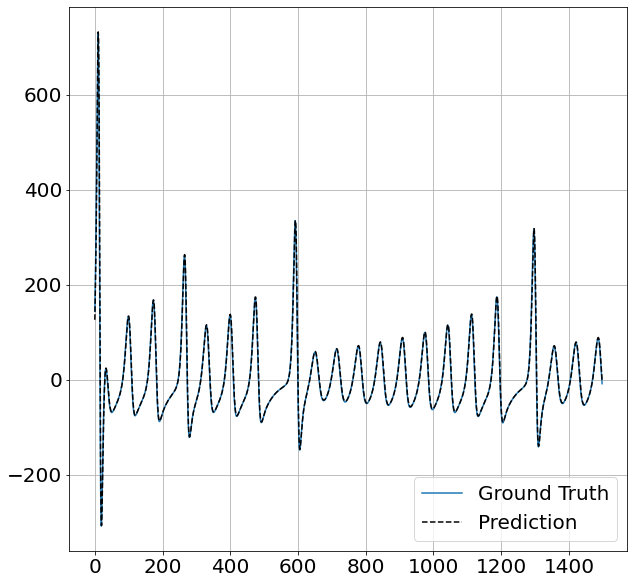

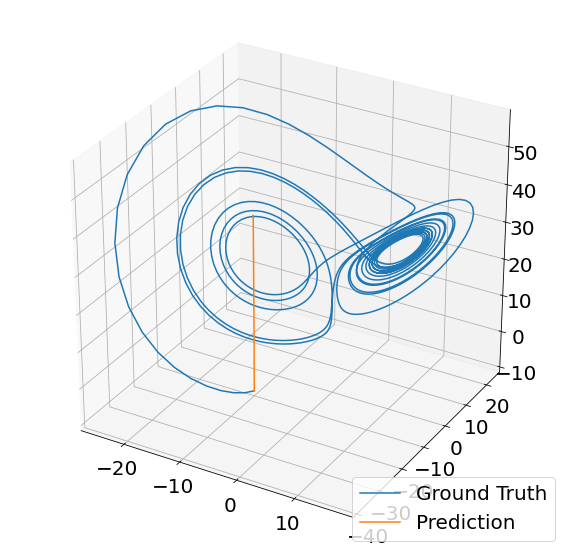

 
Epoch: 923
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7943,  0.0000,  0.0000],
        [-5.6030,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000,  0.0000],
        [ 6.8292,  0.0000,  0.0000, -0.2537]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.8278,  0.0000],
        [ 0.0000, -1.2093,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9987, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6291]], requires_grad=True)


Training progress...:  92%|█████████▏| 923/1000 [14:42<02:22,  1.85s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  29
Unpruned edges:  7
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  93%|█████████▎| 930/1000 [14:47<00:55,  1.27it/s]

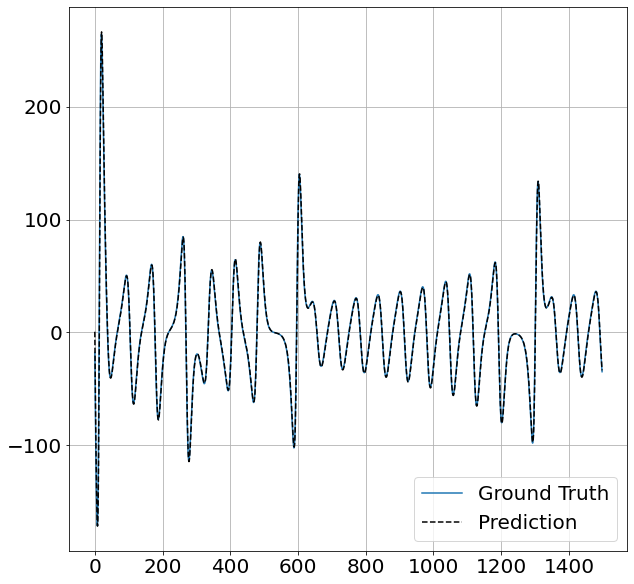

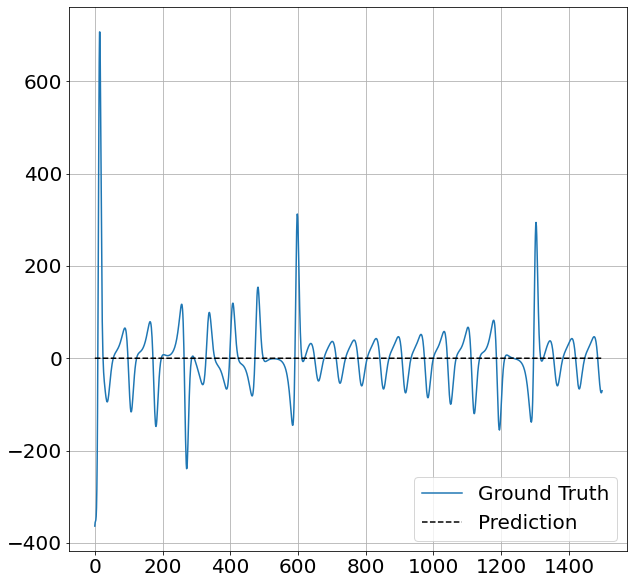

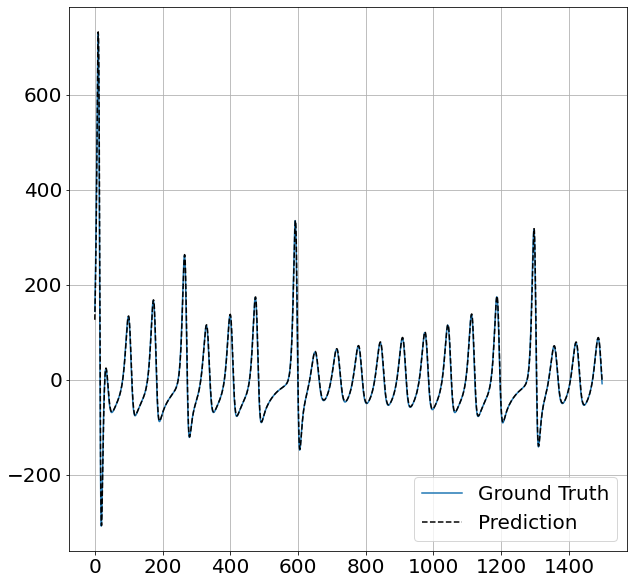

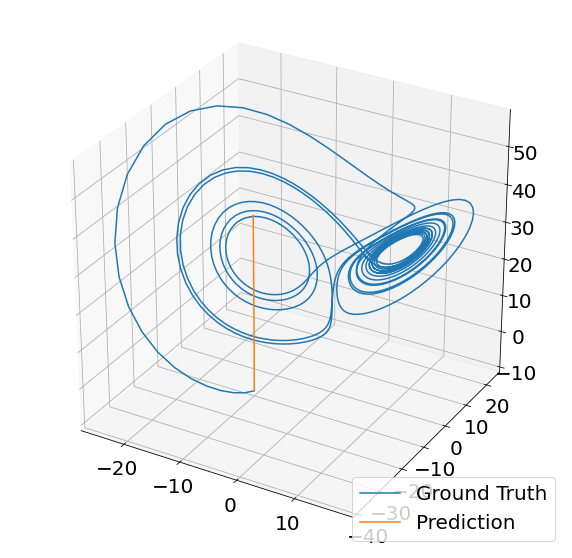

 
Epoch: 931
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7947,  0.0000,  0.0000],
        [-5.6034,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000,  0.0000],
        [ 0.0000,  0.0000,  0.0000, -0.2537]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.8278,  0.0000],
        [ 0.0000, -1.2092,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9981, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6290]], requires_grad=True)


Training progress...:  93%|█████████▎| 931/1000 [14:51<01:54,  1.66s/it]

layer_idx = 1
index of pruned edge = 0
Pruned edges:  30
Unpruned edges:  6
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  94%|█████████▍| 942/1000 [14:58<00:37,  1.54it/s]

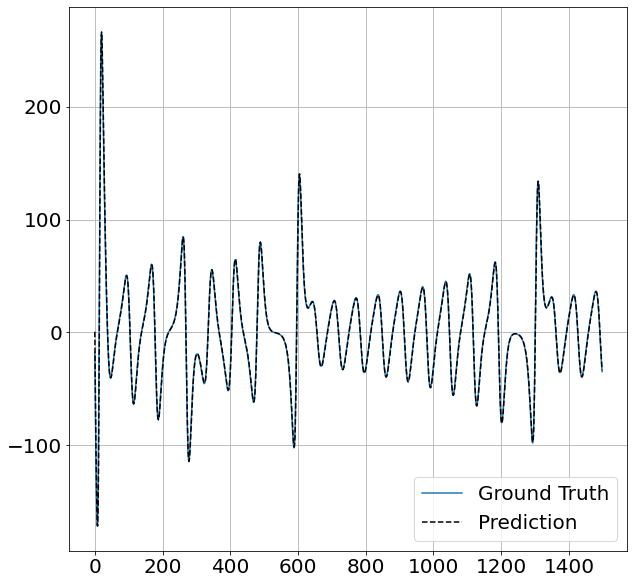

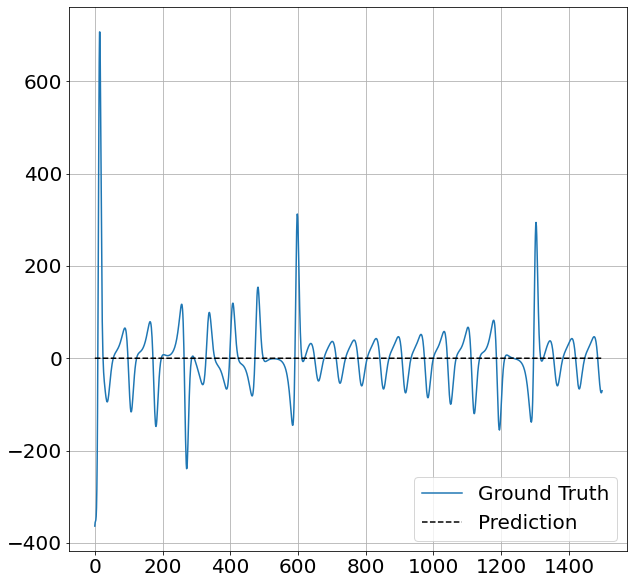

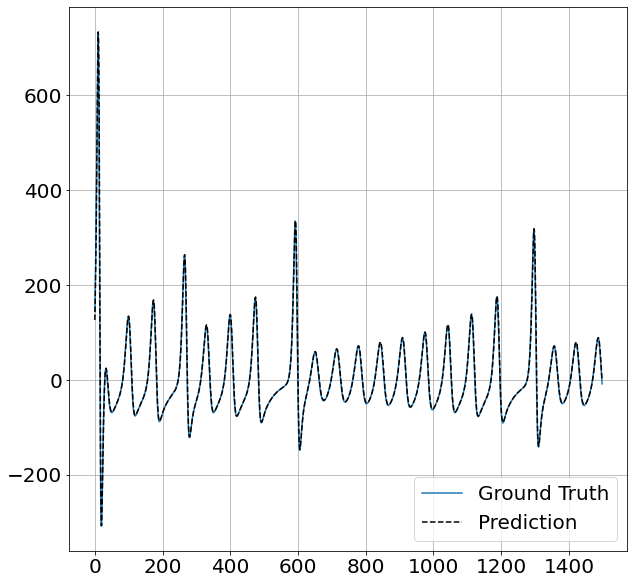

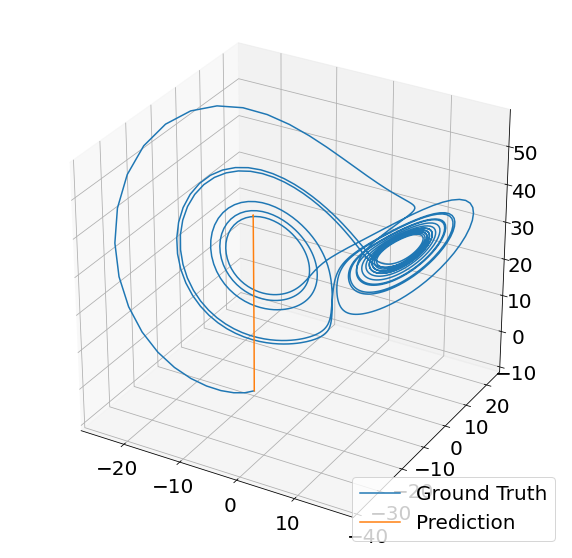

 
Epoch: 943
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7942,  0.0000,  0.0000],
        [-5.6029,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.8286,  0.0000],
        [ 0.0000, -1.2100,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9986, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000, -2.6289]], requires_grad=True)


Training progress...:  94%|█████████▍| 943/1000 [15:01<01:28,  1.56s/it]

layer_idx = 5
index of pruned edge = 0
Pruned edges:  31
Unpruned edges:  5
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  96%|█████████▌| 955/1000 [15:09<00:28,  1.56it/s]

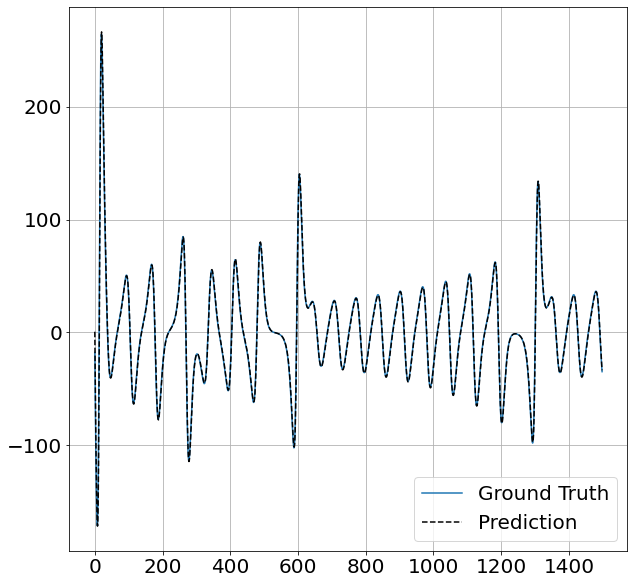

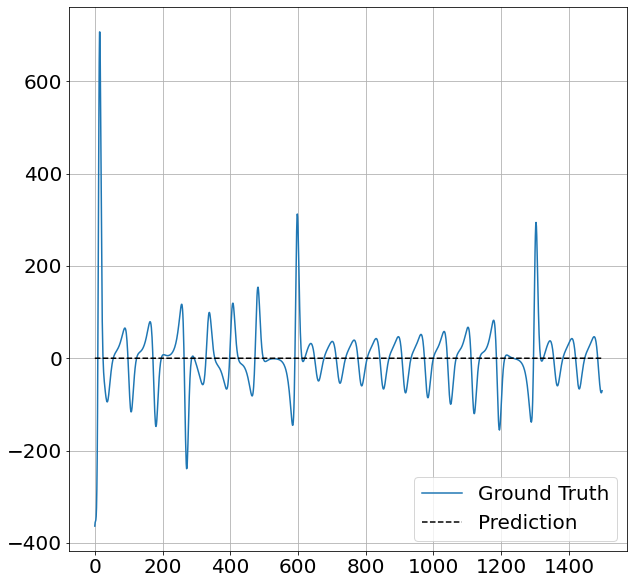

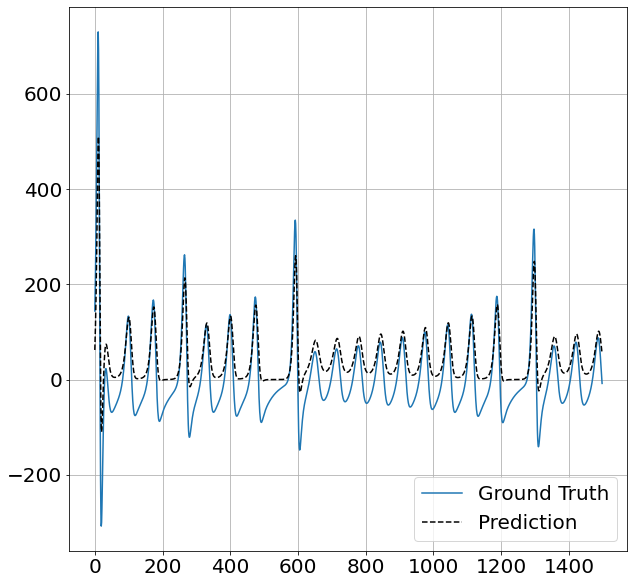

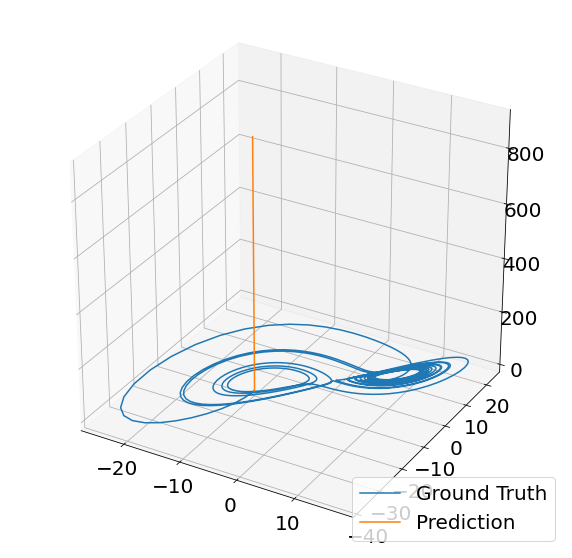

 
Epoch: 956
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7945,  0.0000,  0.0000],
        [-5.6030,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000, -0.6189,  0.0000],
        [ 0.0000, -1.0045,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9986, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)


Training progress...:  96%|█████████▌| 956/1000 [15:12<01:01,  1.39s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  32
Unpruned edges:  4
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  97%|█████████▋| 973/1000 [15:24<00:18,  1.44it/s]

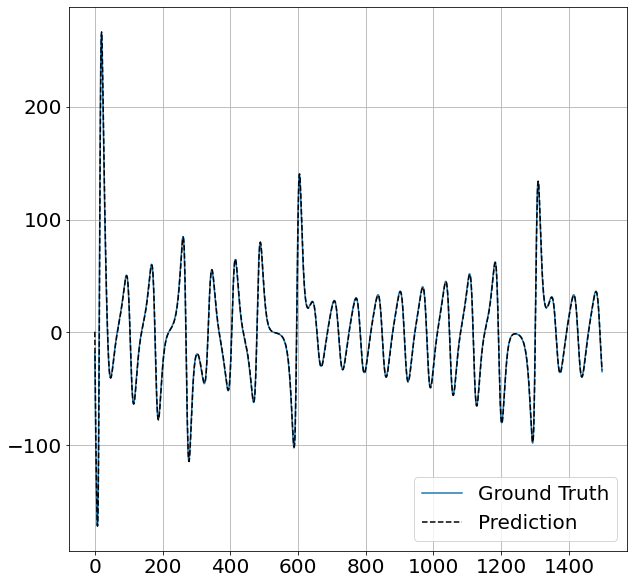

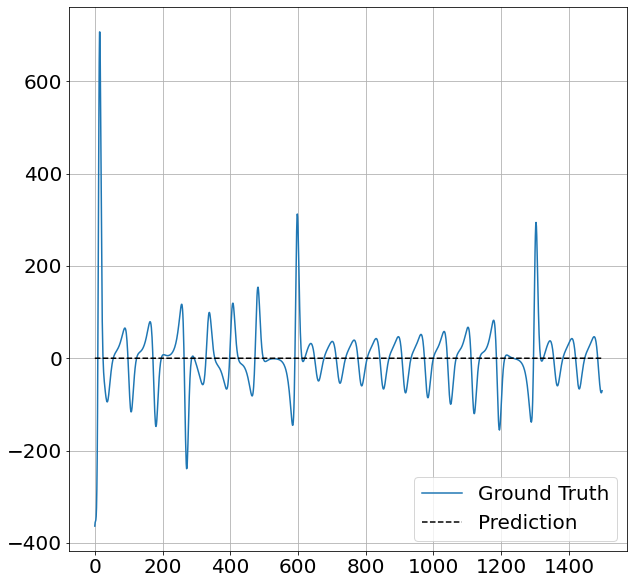

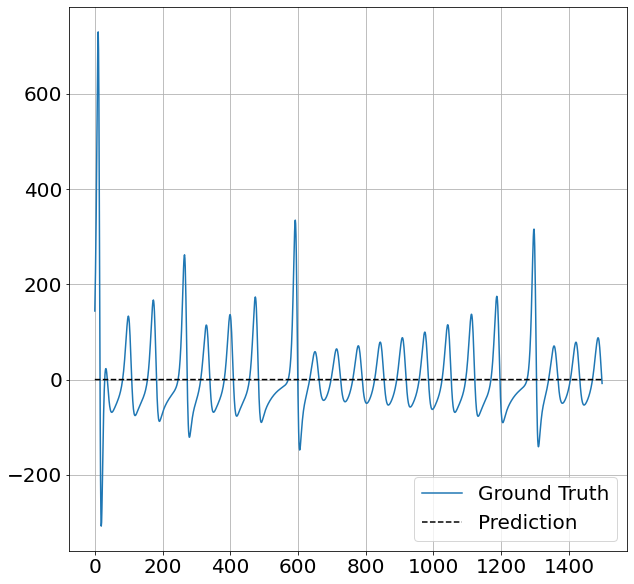

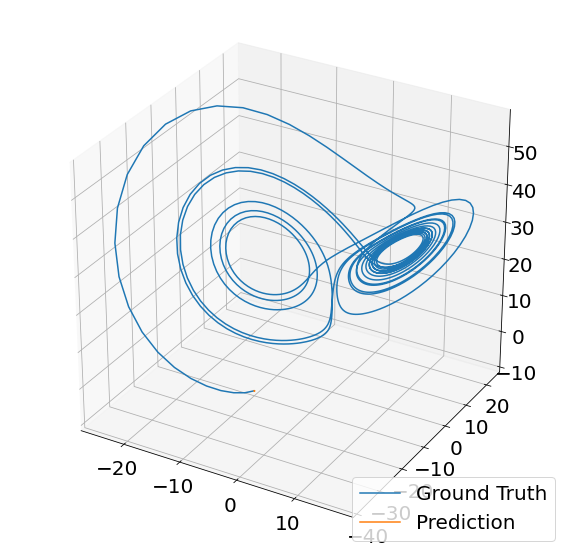

 
Epoch: 974
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7946,  0.0000,  0.0000],
        [-5.6030,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.0045,  0.0000,  0.0000]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9984, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)


Training progress...:  97%|█████████▋| 974/1000 [15:27<00:38,  1.46s/it]

layer_idx = 2
index of pruned edge = 0
Pruned edges:  33
Unpruned edges:  3
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...:  99%|█████████▉| 990/1000 [15:38<00:06,  1.54it/s]

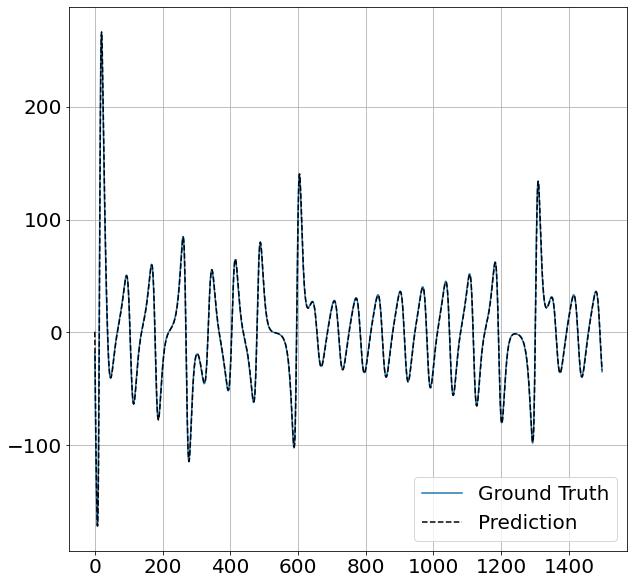

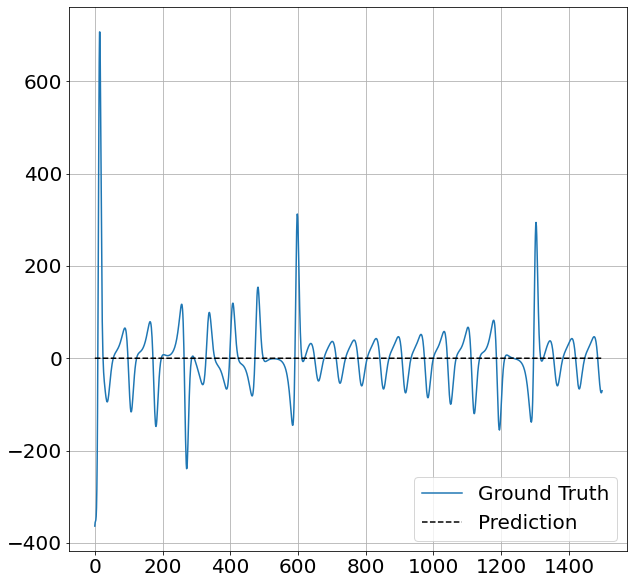

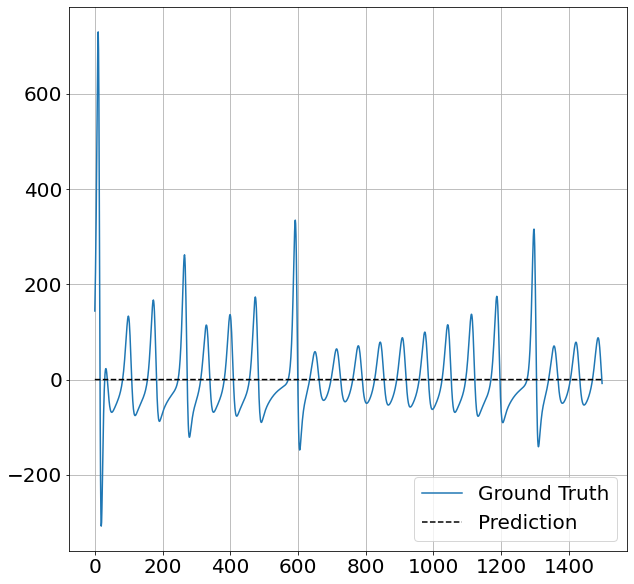

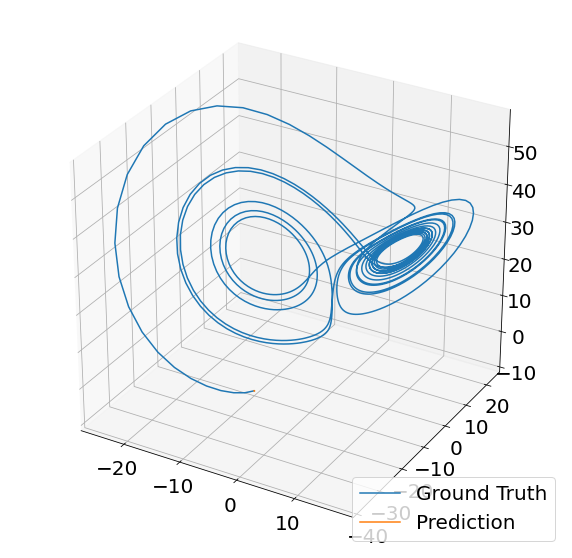

 
Epoch: 991
 
 
WEIGHTS:
Layer: 0
Weights: Parameter containing:
tensor([[ 0.0000,  1.7947,  0.0000,  0.0000],
        [-5.6030,  0.0000,  0.0000,  0.0000]], requires_grad=True)
Layer: 1
Weights: Parameter containing:
tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]], requires_grad=True)
Layer: 2
Weights: Parameter containing:
tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]], requires_grad=True)
Layer: 3
Weights: Parameter containing:
tensor([[0.0000, 0.0000, 9.9983, 0.0000]], requires_grad=True)
Layer: 4
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 5
Weights: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)


Training progress...:  99%|█████████▉| 991/1000 [15:41<00:12,  1.39s/it]

layer_idx = 0
index of pruned edge = 0
Pruned edges:  34
Unpruned edges:  2
Training mode: 0
----------------------------------------------
----------------------------------------------


Training progress...: 100%|██████████| 1000/1000 [15:47<00:00,  1.06it/s]


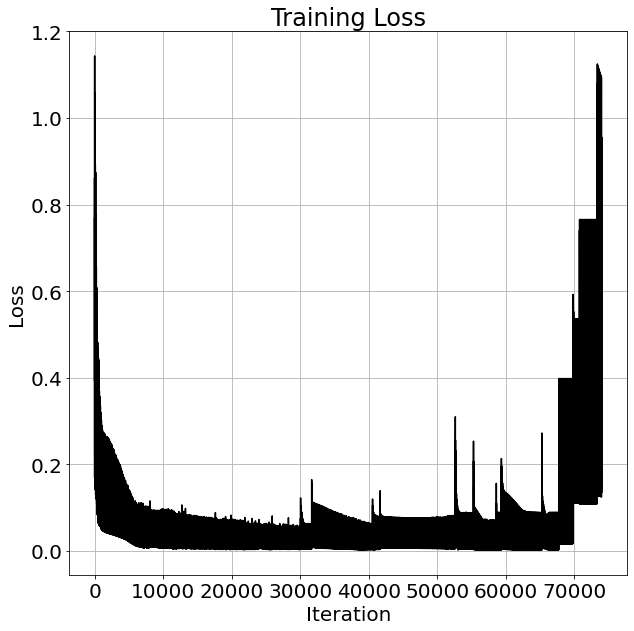

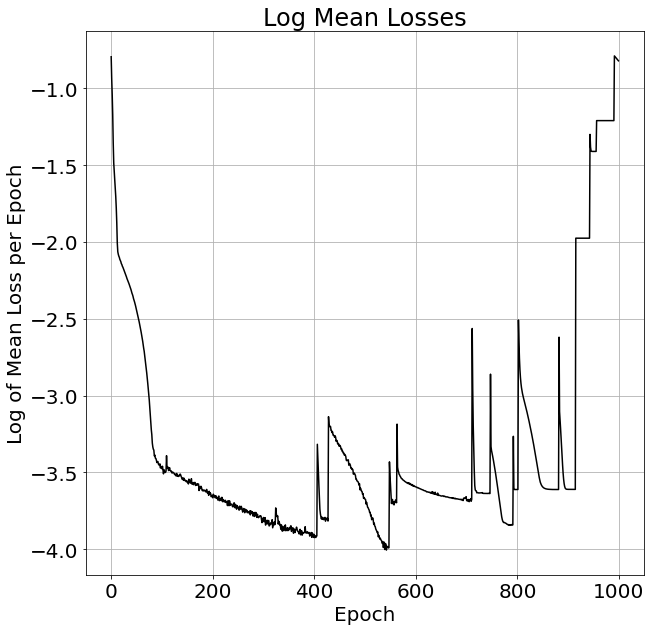

In [ ]:
args.training_mode = 0 # Training mode
args.batch_mode = 1 # Batch mode

num_dim = len(x0.T) # Number of dimensions of state space
X_true = f_col_ones(x_true,args)
X_valid = f_col_ones(x_valid,args)

num_in = num_dim+1 # Number of in dimensions
num_out = num_in # Number of out dimensions
lr = 2e-3 # Learning rate
w1 = 2 # Size of hidden layers
max_epochs = 1000 # Maximum number of training epochs
n_epochs_stop = 5

model = AC_Net_3D(num_in, num_out, w1).to(args.device) # 3D AC Network
# model.initialize_rand_normal # Initialize weights from random normal distribution

# loss = nn.MSELoss(reduction='mean') # Mean squared error loss
# loss = nn.HuberLoss(reduction='mean') # Mean squared error loss
loss = nn.L1Loss() # L1 loss
opt = torch.optim.Adam(model.parameters(), lr=lr) # Optimizer

# Train model:
losses, mean_losses, smoothed_log_mean_losses, prune_epochs = f_train_model(y_true=X_true,y_valid=X_valid,t=t,model=model,loss=loss,opt=opt,w=w1,args=args,max_epochs=max_epochs,lr=lr,n_epochs_stop=n_epochs_stop)

# Plots:
f_plot(losses) # Plot loss per iteration
plt.show()

f_plot(np.log(mean_losses),xlabel='Epoch',ylabel='Log of Mean Loss per Epoch',title='Log Mean Losses') # Plot log-mean loss per epoch
for x_e in prune_epochs:
  plt.axvline(x = x_e,color='k',ls='--',label='axvline - full height')
plt.show()

f_plot(smoothed_log_mean_losses,xlabel='Epoch',ylabel='Running Average Log of Mean Loss per Epoch',title='Smoothed Log-Mean Losses') # Plot smoothed log-mean loss per epoch
for x_e in prune_epochs:
  plt.axvline(x = x_e,color='k',ls='--',label='axvline - full height')
plt.show()

In [ ]:
print("Best epoch:", model.best_epoch)
model.best_weights

# best_model = AC_Net_2D(num_in, num_out, w1).to(args.device) # 2D AC Network
# best_model.weights = model.best_weights

# f_plot_velocities(best_model,X_true)
# f_plot_trajectories(best_model,X_true,t)
# f_display_weights(best_model)

# model.state_dict()

Best epoch: 543


OrderedDict([('h1.weight', tensor([[ 0.0000,  1.8014, -0.6878,  0.0000],
                      [-5.5829,  0.0000,  0.0000,  0.0000]])),
             ('h1.mask', tensor([[False,  True,  True, False],
                      [ True, False, False, False]])),
             ('h2.weight', tensor([[ 0.0000,  3.2752,  0.0000,  0.0000],
                      [ 6.4651,  0.0000,  0.0000, -0.3094]])),
             ('h2.mask', tensor([[False,  True, False, False],
                      [ True, False, False,  True]])),
             ('h3.weight', tensor([[-2.3974, -0.5504, -0.5818, -0.1903],
                      [ 1.6927, -0.4355, -0.4285,  0.1537]])),
             ('h3.mask', tensor([[True, True, True, True],
                      [True, True, True, True]])),
             ('h4.weight', tensor([[0.0000, 0.0000, 6.1607, 0.0000]])),
             ('h4.mask', tensor([[False, False,  True, False]])),
             ('h5.weight', tensor([[ 0.0000,  7.6026, -1.3661,  0.0000]])),
             ('h5.mask', tensor(

### First-order Sinusoidal + Multiplicative Network:

torch.Size([10, 4])
torch.Size([10, 1])
Epoch: 100
Epoch: 198
Layer: 0
weight: Parameter containing:
tensor([[ 6.6878e+00, -1.2452e-03,  2.8174e-04,  3.5479e-04],
        [ 5.4297e-03, -1.4903e+00,  1.4907e+00, -2.3320e-04]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.1377, -0.1548, -0.2551, -0.2187]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.8005, -0.7557, -0.2103,  0.4182]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[-3.6531e-03,  9.9934e-01, -1.1136e-03, -9.2337e-05]],
       requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0382]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0159]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9461]], requires_grad=True)


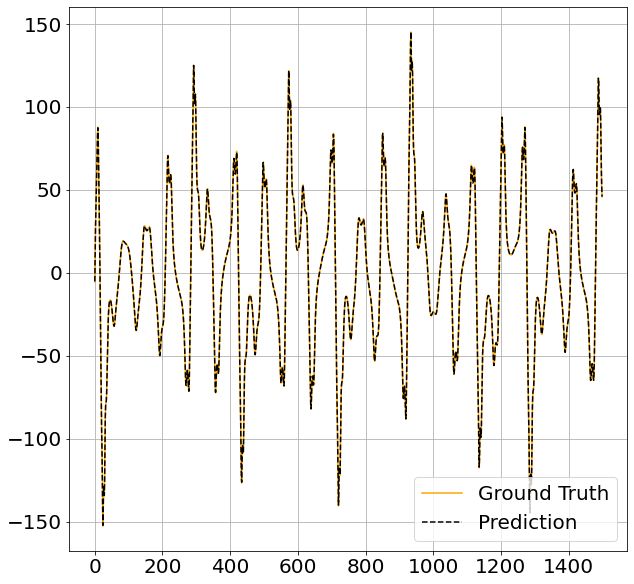

layer_idx= 3
nonzero_idx= 2
min loss= 0.013764465
mask= [[ True  True  True  True]]
indices= (array([0, 0, 0, 0]), array([0, 1, 2, 3]))
Epoch: 200
Epoch: 220
Layer: 0
weight: Parameter containing:
tensor([[ 6.7018e+00,  8.5592e-05, -8.6542e-04,  7.3153e-04],
        [-7.0809e-03, -1.4847e+00,  1.4859e+00,  2.0893e-04]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.1065, -0.2971, -0.3668, -0.1757]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.7505, -0.7884, -0.2709,  0.5093]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[-2.8382e-03,  9.9929e-01,  0.0000e+00, -3.0219e-04]],
       requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0158]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.0271]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9613]], requires_grad=True)


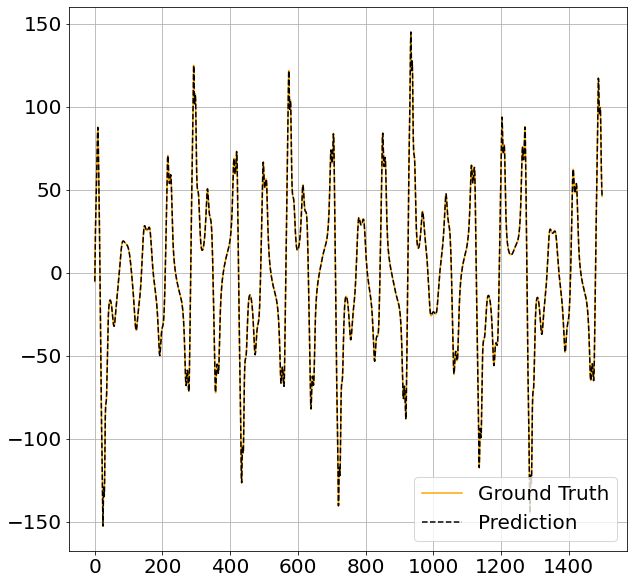

layer_idx= 3
nonzero_idx= 2
min loss= 0.0120688025
mask= [[ True  True False  True]]
indices= (array([0, 0, 0]), array([0, 1, 3]))
Epoch: 252
Layer: 0
weight: Parameter containing:
tensor([[ 6.7137e+00, -1.3189e-03, -1.5722e-03,  1.1269e-04],
        [ 8.7826e-03, -1.4877e+00,  1.4845e+00, -7.1112e-04]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.0775, -0.2981, -0.2264, -0.0997]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.4879, -0.6194, -0.2372,  0.7575]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[-7.4439e-04,  1.0004e+00,  0.0000e+00,  0.0000e+00]],
       requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0050]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0065]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9813]], requires_grad=True)


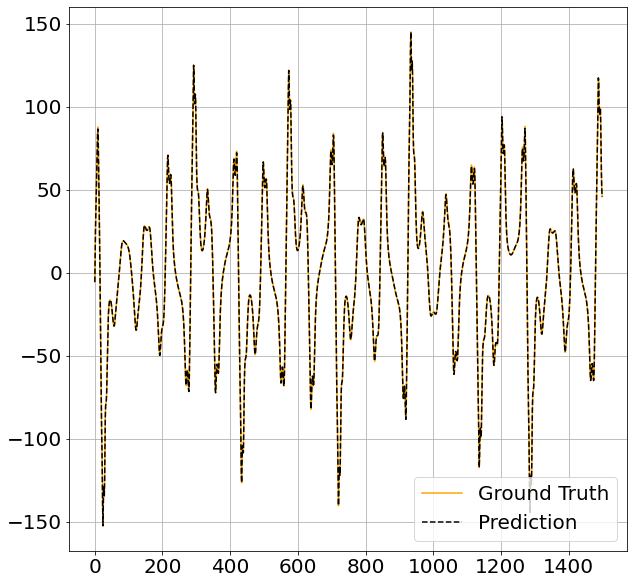

layer_idx= 0
nonzero_idx= 2
min loss= 0.0533368
mask= [[ True  True  True  True]
 [ True  True  True  True]]
indices= (array([0, 0, 0, 0, 1, 1, 1, 1]), array([0, 1, 2, 3, 0, 1, 2, 3]))
Epoch: 280
Layer: 0
weight: Parameter containing:
tensor([[ 6.7162e+00, -2.1748e-04,  0.0000e+00,  4.4989e-04],
        [ 2.6292e-03, -1.4866e+00,  1.4861e+00, -4.6229e-04]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.0426, -0.3863, -0.2578, -0.0662]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.4617, -0.7005, -0.3030,  0.8006]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[3.6007e-04, 1.0000e+00, 0.0000e+00, 0.0000e+00]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0057]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0049]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9944]], requires_grad=True)


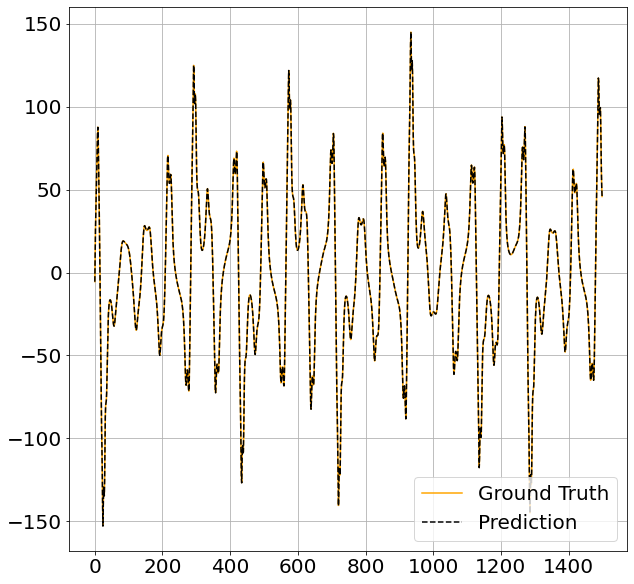

layer_idx= 0
nonzero_idx= 6
min loss= 0.0036002847
mask= [[ True  True False  True]
 [ True  True  True  True]]
indices= (array([0, 0, 0, 1, 1, 1, 1]), array([0, 1, 3, 0, 1, 2, 3]))
Epoch: 294
Layer: 0
weight: Parameter containing:
tensor([[ 6.7371e+00, -2.0574e-02,  0.0000e+00, -5.9763e-03],
        [-7.0581e-03, -1.4802e+00,  1.4775e+00,  0.0000e+00]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.1661, -0.4095, -0.2786, -0.2025]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.4719, -0.6251, -0.2703,  0.7712]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0011, 1.0009, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0004]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0046]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9843]], requires_grad=True)


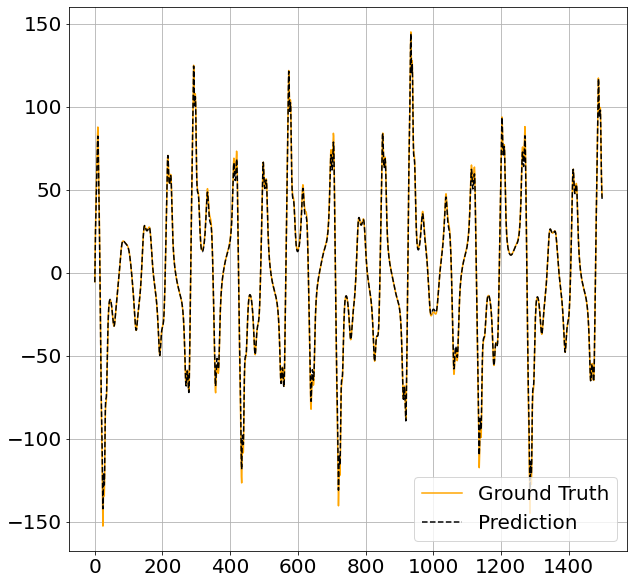

layer_idx= 0
nonzero_idx= 2
min loss= 1.8614683
mask= [[ True  True False  True]
 [ True  True  True False]]
indices= (array([0, 0, 0, 1, 1, 1]), array([0, 1, 3, 0, 1, 2]))
Epoch: 300
Epoch: 306
Layer: 0
weight: Parameter containing:
tensor([[ 6.7332e+00, -1.0992e-03,  0.0000e+00,  0.0000e+00],
        [-1.7307e-02, -1.4820e+00,  1.4785e+00,  0.0000e+00]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.3027, -0.4875, -0.3004, -0.3393]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.4755, -0.4879, -0.1533,  0.7774]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0145, 1.0011, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0026]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.0280]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9958]], requires_grad=True)


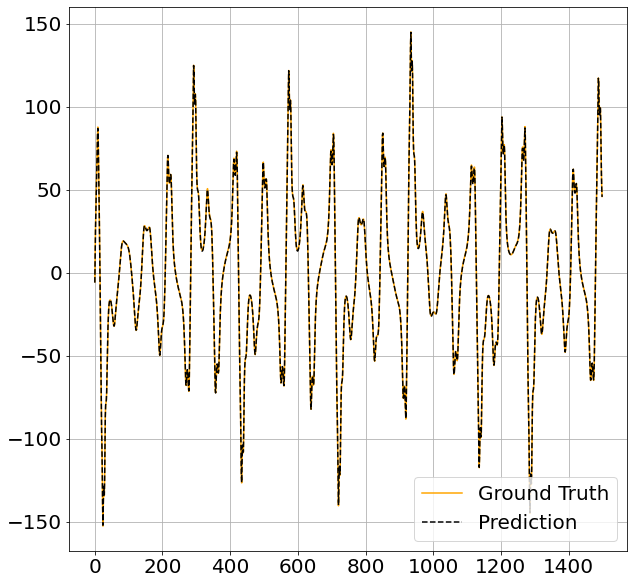

layer_idx= 3
nonzero_idx= 0
min loss= 0.0965227
mask= [[ True  True False False]]
indices= (array([0, 0]), array([0, 1]))
Epoch: 330
Layer: 0
weight: Parameter containing:
tensor([[ 6.7428e+00, -4.9373e-04,  0.0000e+00,  0.0000e+00],
        [-1.0441e-02, -1.4822e+00,  1.4820e+00,  0.0000e+00]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.3771, -0.5852, -0.1495, -0.4135]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.4972, -0.5624, -0.3120,  0.8023]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0001, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0011]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0047]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9983]], requires_grad=True)


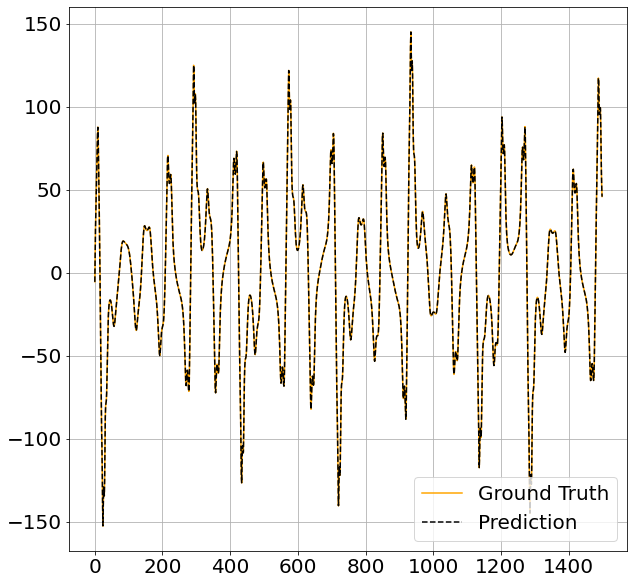

layer_idx= 0
nonzero_idx= 2
min loss= 0.0024994204
mask= [[ True  True False False]
 [ True  True  True False]]
indices= (array([0, 0, 1, 1, 1]), array([0, 1, 0, 1, 2]))
Epoch: 346
Layer: 0
weight: Parameter containing:
tensor([[ 6.7495e+00, -6.3314e-04,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00, -1.4803e+00,  1.4802e+00,  0.0000e+00]],
       requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.3516, -0.7446, -0.2389, -0.3817]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.5816, -0.5937, -0.2119,  0.7137]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0000, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0029]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0007]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0005]], requires_grad=True)


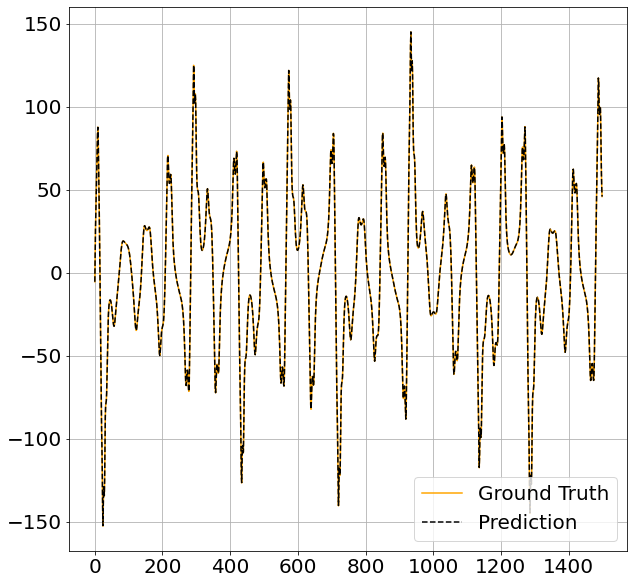

layer_idx= 0
nonzero_idx= 1
min loss= 0.002016022
mask= [[ True  True False False]
 [False  True  True False]]
indices= (array([0, 0, 1, 1]), array([0, 1, 1, 2]))
Epoch: 364
Layer: 0
weight: Parameter containing:
tensor([[ 6.7481,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4806,  1.4823,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.2653, -0.8027, -0.3044, -0.2954]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.5372, -0.5422, -0.1475,  0.7379]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 0.9999, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0011]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.0046]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9944]], requires_grad=True)


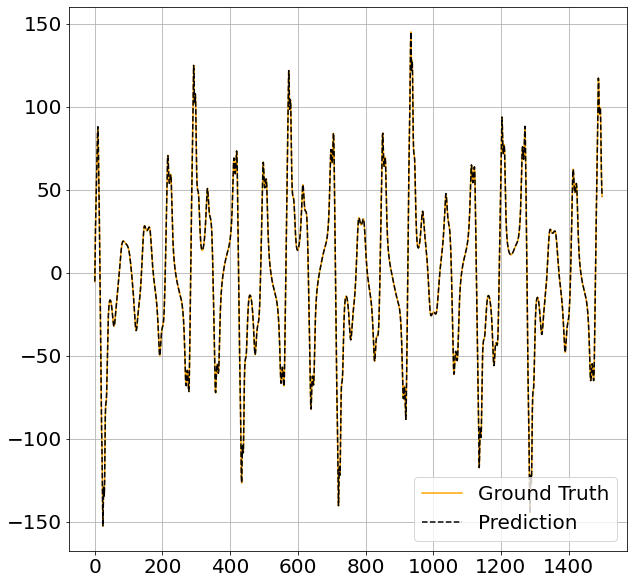

layer_idx= 2
nonzero_idx= 2
min loss= 0.009070503
mask= [[ True  True  True  True]]
indices= (array([0, 0, 0, 0]), array([0, 1, 2, 3]))
Epoch: 380
Layer: 0
weight: Parameter containing:
tensor([[ 6.7429,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4831,  1.4832,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.0225, -0.8583, -0.3706, -0.0680]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.4844, -0.6068,  0.0000,  0.7383]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 0.9999, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0026]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[5.1558e-05]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0039]], requires_grad=True)


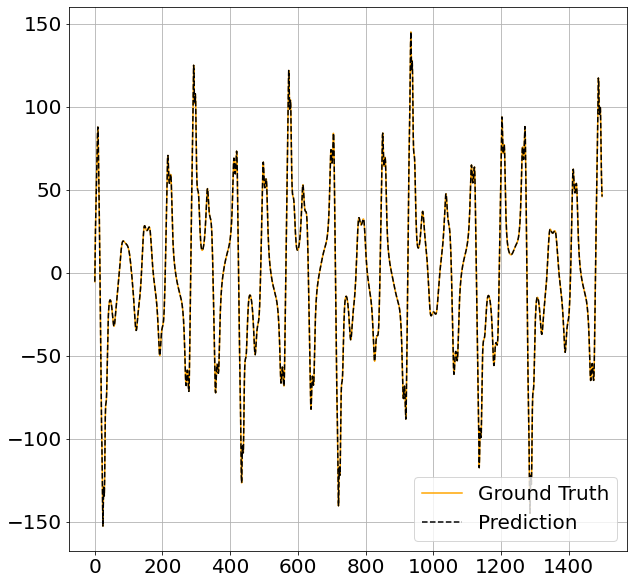

layer_idx= 1
nonzero_idx= 2
min loss= 0.00011944021
mask= [[ True  True  True  True]]
indices= (array([0, 0, 0, 0]), array([0, 1, 2, 3]))
Epoch: 397
Layer: 0
weight: Parameter containing:
tensor([[ 6.7352,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4841,  1.4844,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.0491, -0.9762,  0.0000, -0.0478]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.5542, -0.7250,  0.0000,  0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0000, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0063]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[-0.0208]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0040]], requires_grad=True)


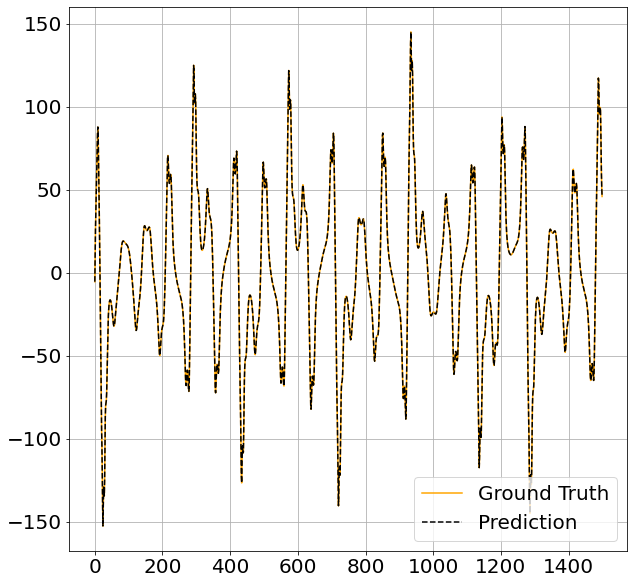

layer_idx= 5
nonzero_idx= 0
min loss= 0.0005171129
mask= [[ True]]
indices= (array([0]), array([0]))
Epoch: 400
Epoch: 413
Layer: 0
weight: Parameter containing:
tensor([[ 6.7311,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4856,  1.4854,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.0455, -0.9447,  0.0000, -0.0692]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[-0.5542, -0.7250,  0.0000,  0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 0.9999, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[-0.0157]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0091]], requires_grad=True)


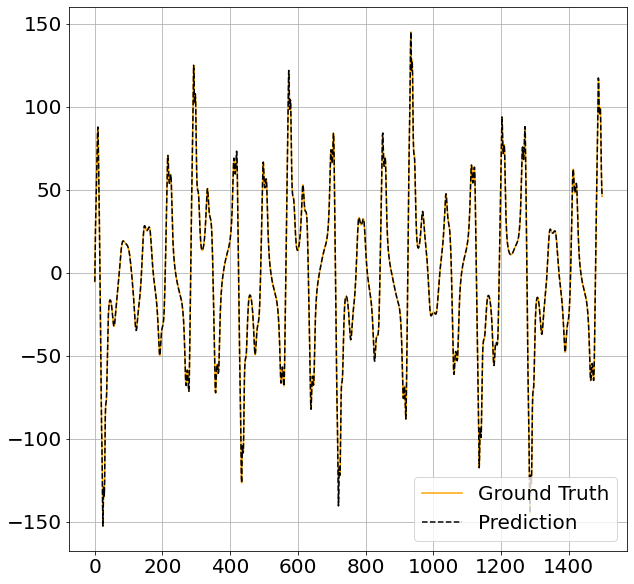

layer_idx= 2
nonzero_idx= 0
min loss= 0.00024129331
mask= [[ True  True False  True]]
indices= (array([0, 0, 0]), array([0, 1, 3]))
Epoch: 437
Layer: 0
weight: Parameter containing:
tensor([[ 6.7228,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4873,  1.4875,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.0588, -0.8388,  0.0000, -0.1590]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[ 0.0000, -0.7250,  0.0000,  0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0001, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0017]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9992]], requires_grad=True)


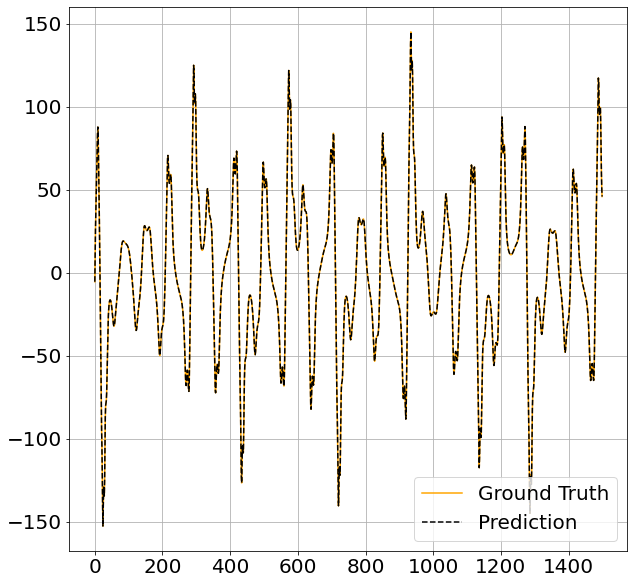

layer_idx= 1
nonzero_idx= 2
min loss= 9.2047696e-05
mask= [[ True  True False  True]]
indices= (array([0, 0, 0]), array([0, 1, 3]))
Epoch: 468
Layer: 0
weight: Parameter containing:
tensor([[ 6.7137,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4895,  1.4895,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.1856, -0.7681,  0.0000,  0.0000]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[ 0.0000, -0.7250,  0.0000,  0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0000, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[4.4121e-07]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0000]], requires_grad=True)


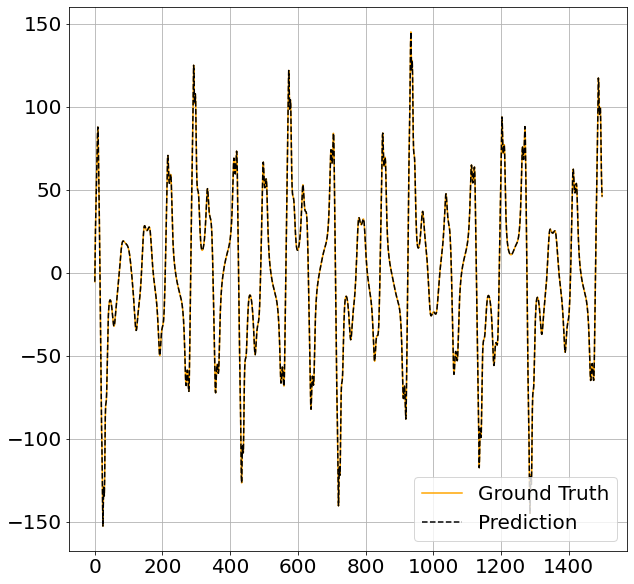

layer_idx= 2
nonzero_idx= 0
min loss= 8.930336e-10
mask= [[False  True False  True]]
indices= (array([0, 0]), array([1, 3]))
Epoch: 481
Layer: 0
weight: Parameter containing:
tensor([[ 6.7118,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4907,  1.4906,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[-2.2748, -0.7872,  0.0000,  0.0000]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0.0000, 0.0000, 0.0000, 0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 0.9997, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0126]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[9.9942]], requires_grad=True)


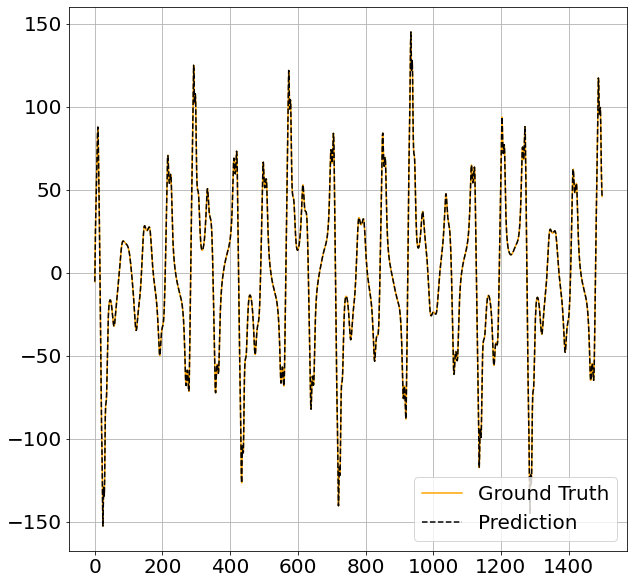

layer_idx= 1
nonzero_idx= 0
min loss= 0.00084178266
mask= [[ True  True False False]]
indices= (array([0, 0]), array([0, 1]))
Epoch: 499
Layer: 0
weight: Parameter containing:
tensor([[ 6.7017,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4915,  1.4912,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[ 0.0000, -0.7854,  0.0000,  0.0000]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0.0000, 0.0000, 0.0000, 0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0005, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0094]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0012]], requires_grad=True)


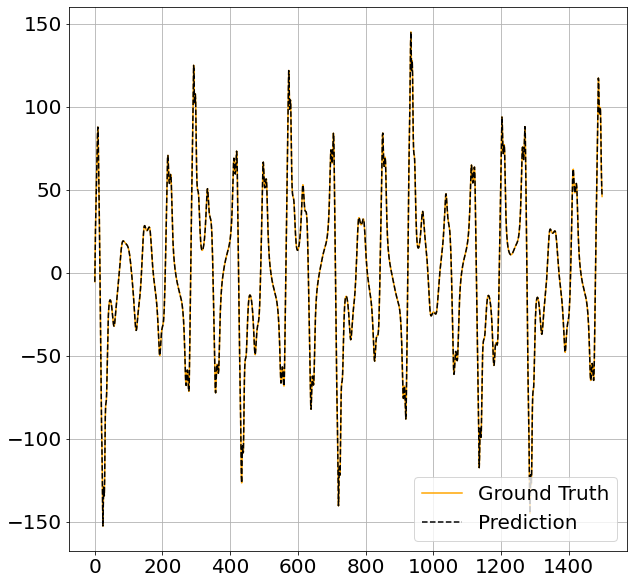

layer_idx= 1
nonzero_idx= 0
min loss= 0.0017793463
mask= [[False  True False False]]
indices= (array([0]), array([1]))
Epoch: 500
Epoch: 535
Layer: 0
weight: Parameter containing:
tensor([[ 6.6935,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4940,  1.4939,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0.0000, 0.0000, 0.0000, 0.6435]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0000, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0094]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0009]], requires_grad=True)


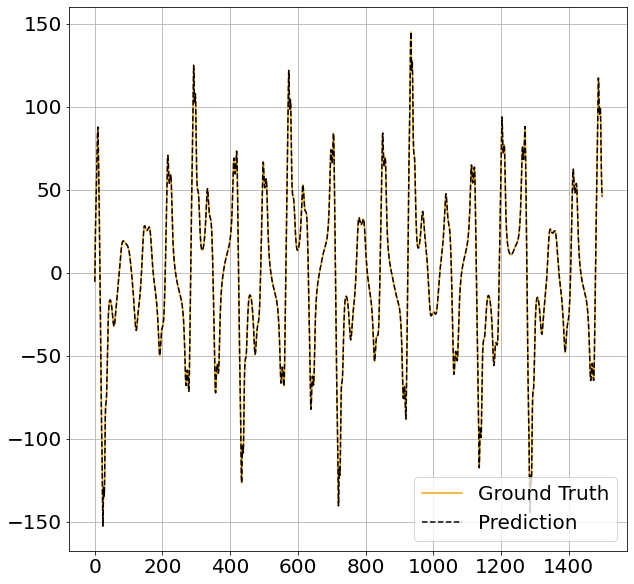

layer_idx= 2
nonzero_idx= 0
min loss= 5.4191853e-05
mask= [[False False False  True]]
indices= (array([0]), array([3]))
Epoch: 569
Layer: 0
weight: Parameter containing:
tensor([[ 6.6835,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4962,  1.4962,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0000, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.0094]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0000]], requires_grad=True)


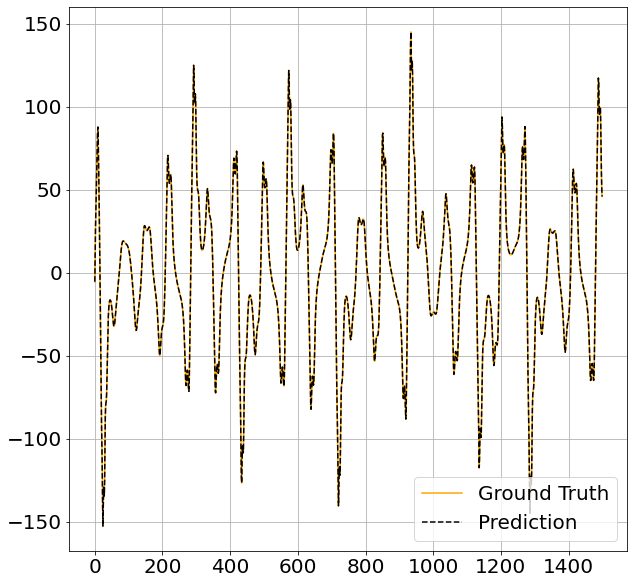

layer_idx= 4
nonzero_idx= 0
min loss= 1.6469331e-09
mask= [[ True]]
indices= (array([0]), array([0]))
Epoch: 590
Layer: 0
weight: Parameter containing:
tensor([[ 6.6745,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4976,  1.4973,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0.0000, 1.0004, 0.0000, 0.0000]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0015]], requires_grad=True)


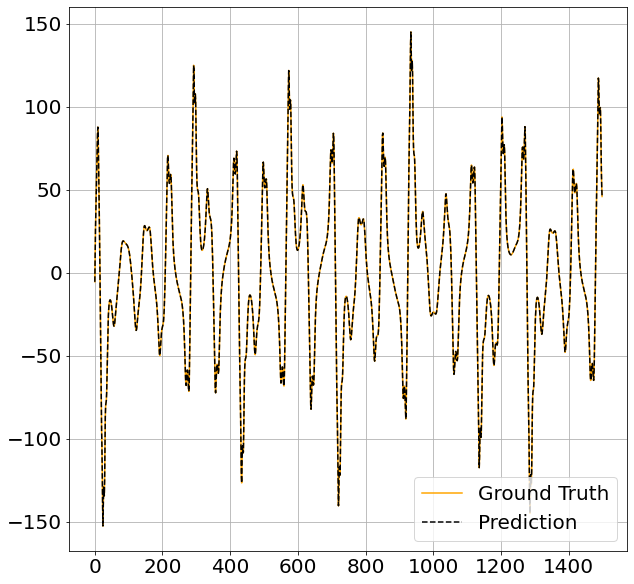

layer_idx= 3
nonzero_idx= 0
min loss= 51.46291
mask= [[False  True False False]]
indices= (array([0]), array([1]))
Epoch: 600
Epoch: 601
Layer: 0
weight: Parameter containing:
tensor([[ 6.5877,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4959,  1.4784,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[10.0015]], requires_grad=True)


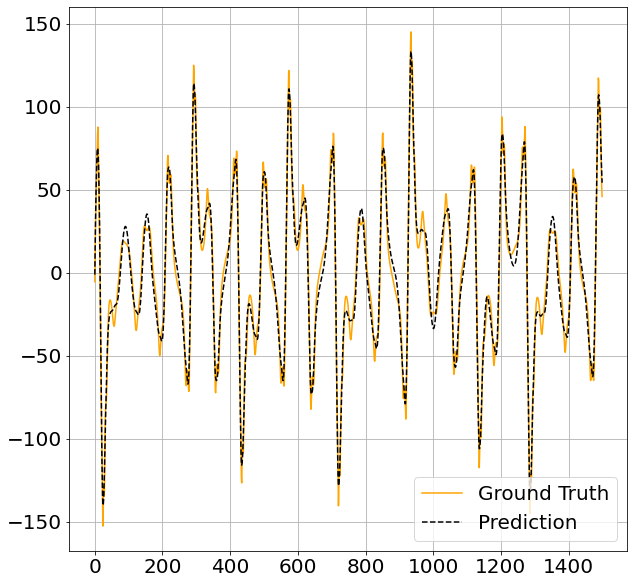

layer_idx= 6
nonzero_idx= 0
min loss= 49.694664
mask= [[ True]]
indices= (array([0]), array([0]))
Epoch: 612
Layer: 0
weight: Parameter containing:
tensor([[ 6.5838,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4967,  1.4792,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[0.]], requires_grad=True)


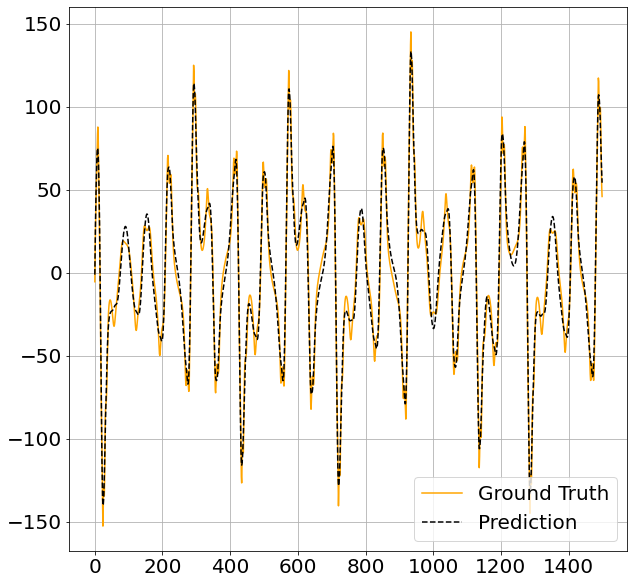

layer_idx= 0
nonzero_idx= 0
min loss= 2122.816
mask= [[ True False False False]
 [False  True  True False]]
indices= (array([0, 1, 1]), array([0, 1, 2]))
Epoch: 623
Layer: 0
weight: Parameter containing:
tensor([[ 0.0000,  0.0000,  0.0000,  0.0000],
        [ 0.0000, -1.4967,  1.4792,  0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[0.]], requires_grad=True)


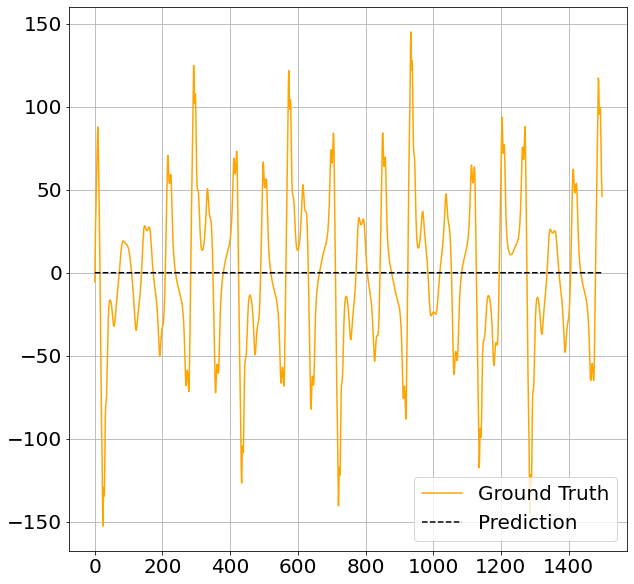

layer_idx= 0
nonzero_idx= 0
min loss= 2122.816
mask= [[False False False False]
 [False  True  True False]]
indices= (array([1, 1]), array([1, 2]))
Epoch: 634
Layer: 0
weight: Parameter containing:
tensor([[0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 1.4792, 0.0000]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[0.]], requires_grad=True)


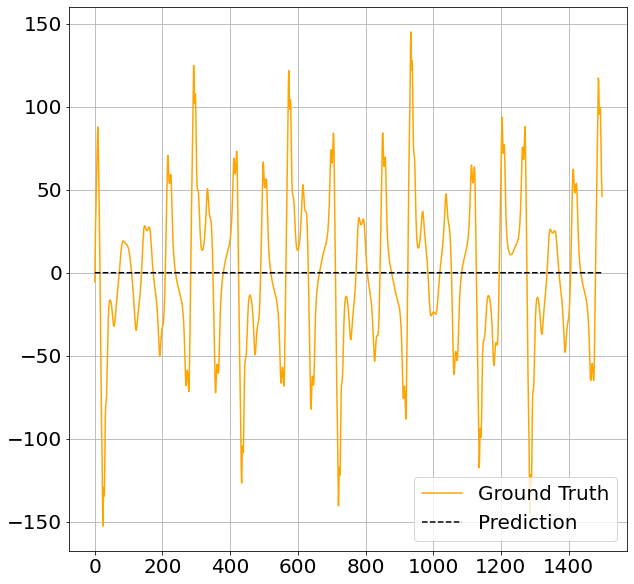

layer_idx= 0
nonzero_idx= 0
min loss= 2122.81591796875
mask= [[False False False False]
 [False False  True False]]
indices= (array([1]), array([2]))
Epoch: 645
Layer: 0
weight: Parameter containing:
tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]], requires_grad=True)
Layer: 1
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 2
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 3
weight: Parameter containing:
tensor([[0., 0., 0., 0.]], requires_grad=True)
Layer: 4
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 5
weight: Parameter containing:
tensor([[0.]], requires_grad=True)
Layer: 6
weight: Parameter containing:
tensor([[0.]], requires_grad=True)


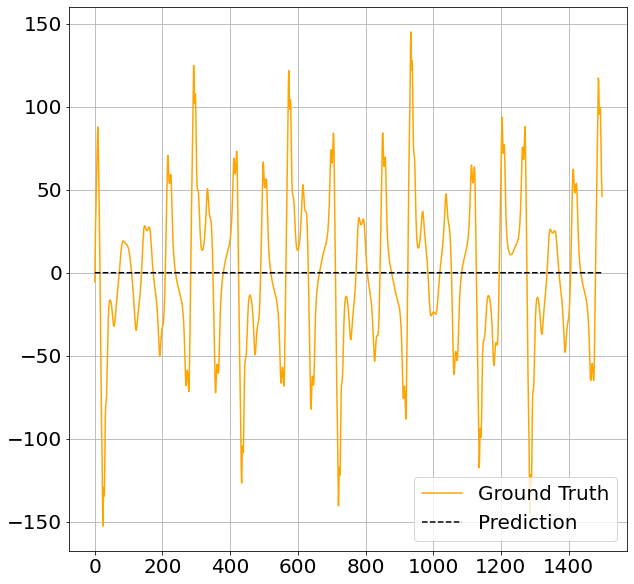

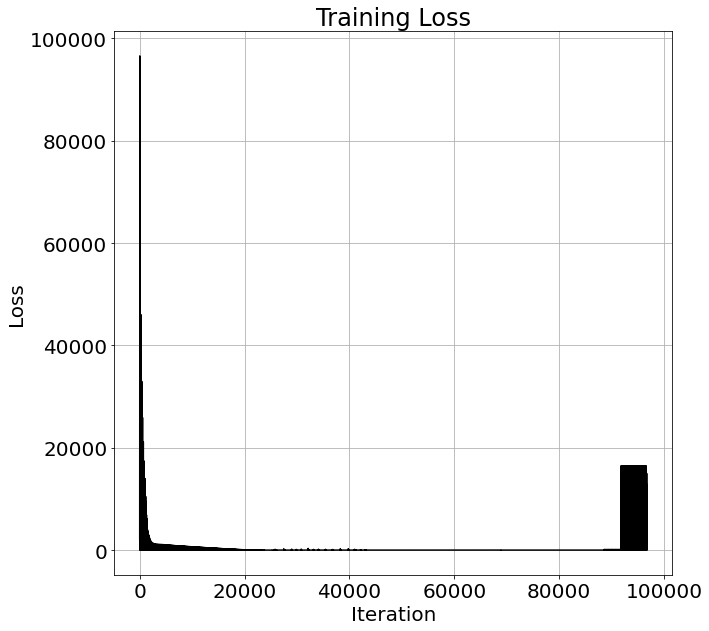

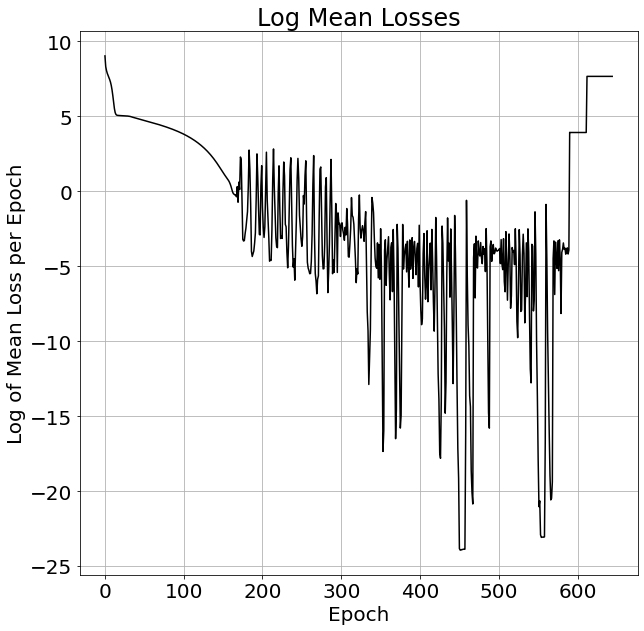

In [ ]:
X_first_order = np.column_stack((XN[0]*0+1,XN[0],XN[1],XN[2])).T
# X_first_order_2 = np.column_stack((XN_2[0]*0+1,XN_2[0],XN_2[1],XN_2[2])).T
X_first_order_2 = X_first_order
XP_2 = XP

dim = 0 # Dimension of XP to learn
num_in = len(X_first_order) # Number of in dimension
num_out = 1 # Number of out dimensions
lr = 2e-3 # Learning rate
w1 = 2 # Size of hidden layers
w2 = 1
W = np.array([w1,w2])
max_epochs = 1000 # Maximum number of training epochs

device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = second_ord_sin_mult_net(num_in, num_out, W).to(device) # Two-layer linear neural network

loss = nn.MSELoss(reduction='mean') # Mean squared error loss
opt = torch.optim.Adam(model.parameters(), lr=lr) # Optimizer

train_loader = f_training_data(X_first_order,XP,dim=dim) # Load data

losses, mean_losses = f_train_model(train_loader,X_first_order_2,XP_2,dim=dim,model=model,loss=loss,opt=opt,w=W,max_epochs=max_epochs,lr=lr) # Train model

f_plot(losses) # Plot loss per iteration
f_plot(np.log(mean_losses),xlabel='Epoch',ylabel='Log of Mean Loss per Epoch',title='Log Mean Losses') # Plot log-mean loss per epoch

In [ ]:
print(model.best_epoch)
model.best_weights

for batch_idx, (cur_x, cur_y) in enumerate(train_loader):
  print(cur_x)
  break

model.load_state_dict(model.best_weights)
# model.state_dict()

# XN_1 = np.vstack((np.ones(Nt),XN))
# np.shape(XN_1)
# torch.from_numpy(XN_1[:,1])
# output = model.forward(torch.from_numpy(XN_1[:,0]))

print(cur_x[0:1])
# x = torch.tensor([[1,10,10,10]])
output = model.forward(cur_x[0:1])
output
# output - cur_y[0]
# # loss(output, cur_y[0])

# fig = plt.figure()
# ax = plt.axes(projection ='3d')
# ax.plot3D(cur_y[1:3], 'k')
# ax.set_title('Lorenz System')
# plt.show()

# output = model.forward(cur_x)
# # plt.plot(output)

471
tensor([[ 1.0000, 10.0000, 10.0000, 10.0000],
        [ 1.0000,  9.9456, 11.7000, 10.7333],
        [ 1.0000, 10.0713, 13.3003, 11.6107],
        [ 1.0000, 10.3339, 14.8179, 12.6406],
        [ 1.0000, 10.7034, 16.2569, 13.8348],
        [ 1.0000, 11.1630, 17.6105, 15.2059],
        [ 1.0000, 11.7092, 18.8626, 16.7663],
        [ 1.0000, 12.3489, 19.9894, 18.5279],
        [ 1.0000, 13.0914, 20.9592, 20.5023],
        [ 1.0000, 13.9283, 21.7311, 22.6994]])
tensor([[ 1., 10., 10., 10.]])


tensor([[-5.4402]], grad_fn=<AddBackward0>)

## To Do:


* Implement batch-norm at every layer. Also need to divide by batchnorms to recover the correct weights. Build a new model that does not have batchnorm. Only has learned weights, to use at test time. \\
* Experiments:
  * Double pendulum and cart-pole. Coupled van der Pol oscillators, coupled Duffing oscillators, Hopfield net / Wilson-Cowan system \\


\\
* Use attention to learn couplings? The attention network has no other purpose other than to figure out what connects to what. Once we have the connectivity pattern, we run SINDy on this graph.
* Learn a sparse controller using a SINDy-NN. Force a polynomial system into another polynomial system. Stabilize an inverted pendulum? Policy RL? \\
* By constraining architecture to sum a fixed function over timesteps, we can learn integral control terms.
* Robotics applications: combine with rotation matrices, local coordinate frames defined with respect to other coordinate frames, to learn dynamical models of serial-linkages.
* Generalize: add term to loss to force neurons (sub-networks) to learn different outputs, so that pruning will work. For instance, could add loss term to force terms to be nearly othogonal: https://en.wikipedia.org/wiki/Orthogonal_polynomials
* Use to approximate Koopman operators; combine with physics-based deep learning: http://physicsbaseddeeplearning.org/others-timeseries.html
* Fully-connected networks as building blocks, conneted by learned sparse connections
* Combine with GNNs: \\
Interaction Networks for Learning about Objects, Relations and Physics: https://proceedings.neurips.cc/paper/2016/file/3147da8ab4a0437c15ef51a5cc7f2dc4-Paper.pdf
Graph Networks as Learnable Physics Engines for Inference and Control: http://proceedings.mlr.press/v80/sanchez-gonzalez18a/sanchez-gonzalez18a.pdf
Learning to Simulate Complex Physics with Graph Networks: http://proceedings.mlr.press/v119/sanchez-gonzalez20a/sanchez-gonzalez20a.pdf

* More ways to apply the same principle: constrained architectures that represent rotations/sheers, affine transformations; logical operations, kernels, etc.

## More Ideas:

* Chaos control: https://journals.aps.org/prl/abstract/10.1103/PhysRevLett.64.1196 \\
https://arxiv.org/abs/1906.07672 \\
https://arxiv.org/abs/2203.16201

* Use Shapley value to prune? https://christophm.github.io/interpretable-ml-book/shapley.html \\
* Simultaneously learn coordinates using auto-encoder or by learning rotation matrices / a library of common transformations (if you add $arcsin$ and $arccos$, you could potentially learn the transformations from rectilinear to polar coordinates and back). The former has already been done, but might be combined with this architecture to better effect: https://arxiv.org/abs/1904.02107 \\
* Add explicit time input to networks \\
* Generalize to PDEs \\
* Beam search and backtracking: branch on the $n$ nodes with the worst performance, using the pruning criterion as an estimate of how bad they are. The idea of stopping the training periodically and pruning edges leads to a natural way to combine search with smooth (gradient-based) methods. We can trade off how far we look ahead and how much compute we use. \\
* Half-inverse gradients for improved optimization: https://arxiv.org/abs/2203.10131 \\
* NEAT-like expansion. Every time we add a variable, we get every other term involving this variable for free. Leverage this to reduce number of parameters needed. \\
* Control applications: Learn a sparse controller using a SINDy-NN. Try to extract LQR and PID controllers. Interleave learning the model and using it for control. Linearize the model, then use it to do LQR.
* More pruning improvements:
  * Prune inside-out, i.e. don't kill the outer functions before their arguments (e.g. given $a*f(b*g(x)+c*h(x))$, prune $b,c$ before $a$). If the pruner chooses to prune the last nonzero edge leaving a neuron, and there are multiple nonzero weights entering this neuron (or vice-versa), we should not have pruned this edge (guarantee that this doesn't happen). \\
  * Learn simple residual connections first, then higher order terms layer by layer. Try to learn simple explanation first, and only introduce more complex terms when this fails. One could try stepwise selection: start by adding $N$ terms, starting with simpler terms. Then, alternate between pruning and adding connections. This is known to be an effective approach in variable selection in linear regression. (From Wu and Hamada textbook; for details, see Draper and Smith, 1998) \\
* An intermediate approach between one-step lookahead and Neural ODE is to run the Neural ODE on a single ODE at a time, clamping all but one of the state variables to their actual values.
* Method to extract and print ODE symbolically from weights. \\
* Learn $x^{1.5}$.
  * $ x^w = sign^w(x) \exp(w \log(|x|)) $ \\
$ = \exp(w \log(|x|)) \approx \exp(2 w \log(|x|+\epsilon)) $ if $2w$ even, \\
$ = sign(x) \exp(w \log(|x|)) \approx \tanh(\alpha x) \exp(w \log(|x|+\epsilon))$ if $w$ odd \\


## More Ideas 2:

* Use an "inverse simulator" (http://physicsbaseddeeplearning.org/physgrad.html) to improve the gradient descent optimization. "Auto-encoder": SINDY, combined with network that learns inverse (since time reversible, just make $t$ --> $-t$?). \\
* Train until convergence using an L2 loss, and then set $q_i = a_i$ and $a_i=1$ for all $i$ and $f(x,y) = a_1 (q_1 x) + a_2 (q_2 y) $. Now, change the loss function to include an $L1$ term. No, better than this, include L1 from the beginning, together with an auxiliary variable on which L1 applies. Every parameter is multiplied by a constant on which L1 applies. \\
* Should we use different losses when training different parts of the network? When different state variables scale much differently, some will have much more influence in training than others. \\
* Can we enforce conservation laws, other constraints? Can we compute the Hamiltonian and use it for learning and control (i.e. two-boundary value control)? \\
* Compute Jacobian symbolically. Now, we can use Jacobian to compute derivatives. \\
* Custom layers($x^b$, exp_sum_NLReLU).
* Look into other control applications: Adaptive control; model-predictive control; reinforcement learning; backstepping?. \\
* Can we do something similar to SINDy for other kinds of simple rules? For instance learn rules for generating fractals, or Boids, or cellular automata, or continuous cellular automata. This would require logical operations, kernels, CNNs, etc. \\
* Try L1 regularization on each whole term (on every layer?) \\
* Perhaps once we get to a small enough network we should try every possible combination of the remaining edges, since the exponential number of combinations is no longer a problem. \\
* Class for simulating PDEs; test on closed-form solutions of e.g. heat equation; see: http://physicsbaseddeeplearning.org/intro.html; Lattice Boltzmann Simulation of Fluid Flow Past a Cylinder? \\
* Consider using information criteria for model selection (e.g. AIC/BIC) - No, this is equivalent to seeing which model minimizes sum of squared errors. \\
* Other form of basis functions: Legendre polynomials, RBFs \\
* Weighted LASSO, revisit layer norm; L1 loss on whole term \\
* Pairwise AC-Net architecture implementation is slow \\
* Stochastic dynamics; Experiment with losses: L1, L2, Huber. \\
* Some activation functions (i.e. $1/x, log$) diverge for some values or produce large values and aren't typically seen in differential equations ($exp$). However, $exp$ and $log$ allow us to learn any power. We also don't need division (or even multipication). Can/should we implement these? We would need to prevent compositions of functions from diverging. We could implement clipping, or zero out connections for $exp(exp)$ or only include exp and log together. \\
* Add traditional network as auxiliary and bound its output; then bring in stability guarantees.
* Parameter sharing in the residual connections? \\
* Could one potentially use attention to figure out which pairs of components are relevant to each other?
* Layer normalization? (doesn't work) \\
* Arithmetic Circuits may be relevant: https://en.wikipedia.org/wiki/Arithmetic_circuit_complexity \\
* Experiment with different pruning methods? (pruning neurons; structured pruning) \\
* Modify the loss so that more complicated terms are more heavily penalized (modify L1 loss)? \\
* Compute derivative from data; total variation regularized derivative? \\
* So far, we have had a Markov assumption (the current derivative depends only on the current state vector). But we could remove this assumption and let the current derivative depend on any past states and derivatives. In order to represent a time integral, we would need to compute the sum of each term at each time step and then backpropagate through the dynamics. It might be possible to use the adjoint method again to compute this more cheaply. We could then extend SINDy to include not only functions but their time integrals. This would also be a good place to bring in attention (either across space or time). \\
* Try gradually increasing number of time steps in Neural ODE.

## Notes:

What are the major improvements?
  * Neural-network architecture (can automatically find constants and learn more complicated dynamics); parameter sharing allows us to represent an exponential number of candidate functions with a polynomial number of parameters; makes the optimization easier by giving more paths down to equilibrium. Makes high-dimensional systems and systems with highly-compositional dynamics tractable. Makes use of NN libraries and GPU computation. SINDy-PI requires guessing and checking LHS terms, which hugely increases run-time, whereas we can represent fractional dynamics directly. Adam appears to work well in practice, which is faster than second-order optimization. \\
  * Seq-to-seq model (Neural ODE). Takes advantage of higher-order information by backpropagating through time; does so in a scalable manner by making use of the adjoint sensitivity method; and allows us to make use of powerful ODE solvers. \\
  * Improved optimization: L1 is not a good criterion. Instead, remove the worst performer. Dummy variables allow us to apply L1 regularization. Using batch-norm improves optimization by alleviating scaling/dimensionality issues, while still allowing us to recover weights. Removing one variable at a time removes an unnecessary hyperparameter and provides natural way of combining search with gradient-based optimization. Using validation data to prune improves robustness. \\

L1 Loss appears to be biased against low-order terms. This must be because the higher-order terms can achieve higher outputs with lower inputs, since they multiply.

L1 regularization and L1 pruning criterion do opposite things. The first punishes weights for being large, the second for being too small. Instead of L1 pruning, try zeroing every weight and prune the one which has the least impact on the output when zeroed.

We might try learning the simplest residual connections first, from the lowest layer to the highest layer, so that we try to learn simple explanations first, and only introduce more complex terms when this fails.

If we have many terms or terms that need to be very close to zero, the network needs to be deeper, so that small weights are multiplied. In a one-layer network, the weights can only get as small as the learning rate, which may not be small enough.

We may need duplicates of each possibility and a large enough standard deviation in weight initializations, so that different initializations can explore different parts of the state space.

Huber loss is preferred to the L1 in certain cases for which there are both large outliers as well as small (ideally Gaussian) perturbations. MSE Loss may be better than L1 Loss, because we WANT to be sensitive to outliers (or maybe not once we add noise?)

Higher-order models can approximate the simpler dynamics quite accurately, over a subset of the state space. The number of local minima corresponding to higher-order models is probably much larger than 1, which means we will tend to get stuck in a wrong local minimum. The richer our set of possible models, the more state space we need to explore to differentiate between them. Many dynamical systems have attractors; if you collect the data when the system is near an attractor, the data will be confined to a potentially small subset of the state space, which means you won't have enough information to distinguish between competing models. One solution is to initialize the system from many random initial conditions in order to force more exploration.

Using random batches of training data appears to be faster than iterating through the entire training set, but makes knowing when to prune harder.